In [1]:
! pip install ccdproc

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 368.5/368.5 kB 6.7 MB/s eta 0:00:00a 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 355.4/355.4 kB 18.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.7/993.7 kB 17.0 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.6/87.6 kB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 23.3 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.0/172.0 kB 20.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 208.5/208.5 kB 16.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 18.9 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.1/56.1 kB 5.1 MB/s eta 0:00:00
  Created wheel for astroscrappy: filename=astroscrappy-1.1.0-cp312-cp3

In [1]:
from astropy import units as u
from astropy.nddata import CCDData
from ccdproc import Combiner
import numpy as np
from ccdproc import wcs_project
import glob
from astropy.io import fits
from astropy.wcs import WCS
import astropy.io.fits as pf
import astropy.wcs as awcs

import photutils as phot
from photutils.centroids import centroid_com, centroid_sources
from photutils.datasets import make_4gaussians_image
from photutils.utils import circular_footprint
from astropy.stats import SigmaClip
from photutils.background import Background2D, MedianBackground
from photutils.aperture import aperture_photometry
from photutils.aperture import CircularAperture
import matplotlib.pyplot as plt
from astropy.stats import sigma_clipped_stats
from photutils.aperture import ApertureStats, CircularAperture
from photutils.datasets import make_4gaussians_image
from photutils.aperture import CircularAnnulus
import glob 
import math
import sep
import pandas as pd
import zipfile
from astropy.io import fits
from astropy.utils.data import get_pkg_data_filename
from astropy.wcs import WCS
import matplotlib.pyplot as plt
from reproject import reproject_interp

## Method that didn't work

In [72]:
my_list_of_images_o = glob.glob('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/Diff_Images/Diff_Images_2016cbx/*o_diff.fits')
first_image = fits.open(my_list_of_images_o[0])

ihdr = pf.getheader(my_list_of_images_o[0], extname='image')
print(awcs.WCS(ihdr))
## Modify header for compatibility:
whdr = ihdr.copy(strip=True)                            # make a working copy
toss = ['RP_SCHIN', 'CDANAM', 'CDSKEW', 'RADECSYS']     # these prompt warnings
toss += ['CNPIX1', 'CNPIX2']
toss += [x for x in whdr if x.startswith('PV')]         # these are PV terms
for kk in toss:
    whdr.remove(kk, ignore_missing=True, remove_all=True)

## Update CTYPEx to prompt SIP interpretation:
whdr['CTYPE1'] = 'RA---TAN-SIP'                         # overwrite RA---TPV
whdr['CTYPE2'] = 'DEC--TAN-SIP'                         # overwrite DEC--TPV

## This should work correctly and without tons of warnings:
twcs = awcs.WCS(whdr).celestial



reprojected = []
for file in my_list_of_images_o:
    
    target_wcs = twcs

    ihdr = pf.getheader(file, extname='image')

    ## Modify header for compatibility:
    #whdr = ihdr.copy(strip=True)                            # make a working copy
    toss = ['RP_SCHIN', 'CDANAM', 'CDSKEW', 'RADECSYS']     # these prompt warnings
    toss += ['CNPIX1', 'CNPIX2']
    toss += [x for x in ihdr if x.startswith('PV')]         # these are PV terms
    for kk in toss:
        ihdr.remove(kk, ignore_missing=True, remove_all=True)

    ## Update CTYPEx to prompt SIP interpretation:
    ihdr['CTYPE1'] = 'RA---TAN-SIP'                         # overwrite RA---TPV
    ihdr['CTYPE2'] = 'DEC--TAN-SIP'     

    

    iwcs = awcs.WCS(ihdr).celestial

    print(iwcs)
    img = CCDData.read(file,unit = u.adu)
    new_image = wcs_project(img, target_wcs)
    reprojected.append(new_image)



INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]


 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


InvalidTransformError: ERROR 6 in wcsset() at line 2663 of file cextern/wcslib/C/wcs.c:
PV1_5 : Unrecognized coordinate transformation parameter.


In [63]:
img = CCDData.read(file,unit = u.adu)
#img.wcs.is_celestial
#twcs = awcs.WCS(whdr)
img.wcs

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: An exception h

## Second Attempt

In [22]:
pip install reproject

Note: you may need to restart the kernel to use updated packages.


In [5]:
path1 = '/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/Diff_Images2/'
diff_images = glob.glob(path1 + 'Diff_Images_*')
stacked_imgs = []

for folder in diff_images:
    name = folder.replace(path1 + 'Diff_Images_','')
    print(name)
    images_o = glob.glob(folder + '/*o_diff.fits')    
    images_c = glob.glob(folder + '/*c_diff.fits') 
    
    f = open('Stacking_Info/imgs4stack_{NAME}.csv'.format(NAME = name), 'w')
    
    reprojected_o = []
    for file in images_o:
        obs = file.replace(path1 + 'Diff_Images_'+name + '/','').replace('_diff.fits','')
        print(obs)
        df_tns = pd.read_csv('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/RAW_DATA/RAW_DATA_3/' + name +'.csv', sep = ',')
        x_val = float(df_tns['x'][df_tns.Obs == obs])
        y_val = float(df_tns['y'][df_tns.Obs == obs])
        print(x_val,y_val)
        if x_val < 800 or x_val > 10200 or y_val < 800 or y_val > 10200:
            print("Fails Pixel Cut")
            continue
        mag = float(df_tns['m'][df_tns.Obs == obs])
        dmag = float(df_tns['dm'][df_tns.Obs == obs])

        if mag == 0 or dmag == 0:
            continue

        SNR = mag/dmag
        if SNR < 100:
            print("Fails SNR Cut")
            continue

        sky_vals = df_tns['Sky']
        mean_sky = np.mean(sky_vals)
        std_sky = np.std(sky_vals)
        sky = float(df_tns['Sky'][df_tns.Obs == obs])
        if sky > mean_sky + 3*std_sky or sky < mean_sky - 3*std_sky:
            print("Fails Sky Cut")
            continue
        
        hdu1o = fits.open(get_pkg_data_filename(images_o[0]))[0]
        hdu2 = fits.open(get_pkg_data_filename(file))[0]
        hdu1o_header = hdu1o.header
        del hdu1o_header['CNPIX1']
        del hdu1o_header['CNPIX2']
        hdu2_header = hdu2.header
        del hdu2_header['CNPIX1']
        del hdu2_header['CNPIX2']
        array, footprint = reproject_interp(hdu2, hdu1o_header)  
        reprojected_o.append(array)
        f.write(str(obs) + ',' + str(SNR) + '\n')
        
    if not reprojected_o: 
        print('No Images to Stack')
    else:
        final_image_o = np.sum(reprojected_o, axis=0)
        #stacked_imgs.append(final_image_o)

        hdu_o = hdu1o
        hdu_o.data = final_image_o
        hdu1o.writeto('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/Stacked_Images3/{NAME}_stacked_o.fits'.format(NAME = name),overwrite=True,output_verify = 'ignore')

    reprojected_c = []
    for file in images_c:
        obs = file.replace(path1 + 'Diff_Images_'+name + '/','').replace('_diff.fits','')
        print(obs)
        df_tns = pd.read_csv('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/RAW_DATA/RAW_DATA_3/' + name +'.csv', sep = ',')
        x_val = float(df_tns['x'][df_tns.Obs == obs])
        y_val = float(df_tns['y'][df_tns.Obs == obs])
        if x_val < 800 or x_val > 10200 or y_val < 800 or y_val > 10200:
            continue

        mag = float(df_tns['m'][df_tns.Obs == obs])
        dmag = float(df_tns['dm'][df_tns.Obs == obs])

        if mag == 0 or dmag == 0:
            continue

        SNR = mag/dmag
        if SNR < 100:
            print("Fails SNR Cut")
            continue

        sky_vals = df_tns['Sky']
        mean_sky = np.mean(sky_vals)
        std_sky = np.std(sky_vals)
        sky = float(df_tns['Sky'][df_tns.Obs == obs])
        if sky > mean_sky + 3*std_sky or sky < mean_sky - 3*std_sky:
            print ("Fails Sky Cut")
            continue
        
        hdu1c = fits.open(get_pkg_data_filename(images_c[0]))[0]
        hdu2 = fits.open(get_pkg_data_filename(file))[0]
        hdu1c_header = hdu1c.header
        del hdu1c_header['CNPIX1']
        del hdu1c_header['CNPIX2']
        hdu2_header = hdu2.header
        del hdu2_header['CNPIX1']
        del hdu2_header['CNPIX2']
        array, footprint = reproject_interp(hdu2, hdu1c_header)  
        reprojected_c.append(array)
        f.write(str(obs) + ','+ str(SNR) + '\n')

    if not reprojected_c:
        print('No Images to Stack')
    else:
        
        final_image_c = np.sum(reprojected_c, axis=0)
        #stacked_imgs.append(final_image_o)

        hdu_c = hdu1c
        hdu_c.data = final_image_c
        hdu1c.writeto('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/Stacked_Images3/{NAME}_stacked_c.fits'.format(NAME = name),overwrite=True,output_verify = 'ignore')



2018idg
01a58557o0116o
8354.0 6800.94
Fails SNR Cut
01a58504o0338o
1859.19 5097.05
Fails SNR Cut
01a58397o0603o
1491.48 4104.82
Fails SNR Cut
01a58569o0082o
5140.31 8797.57
Fails SNR Cut
01a58561o0042o
10295.12 2869.06
Fails Pixel Cut
01a58565o0130o
2681.78 6874.16
Fails SNR Cut
01a58401o0377o
9380.77 3052.12
Fails SNR Cut
01a58393o0679o
7486.84 2829.55
Fails SNR Cut
01a58541o0013o
4593.15 4918.79
Fails SNR Cut
01a58561o0078o
10256.33 2837.61
Fails Pixel Cut
01a58561o0087o
664.1 2961.66
Fails Pixel Cut
01a58409o0551o
50.73 4557.01
Fails Pixel Cut
01a58485o0317o
8794.75 924.94


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


01a58565o0143o
2701.87 6913.28
Fails SNR Cut
01a58513o0211o
751.08 6931.29
Fails Pixel Cut
02a58495o0350o
6009.38 3625.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58449o0554o
9934.82 2376.21
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58451o0586o
9504.74 8242.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58497o0297o
1292.19 1122.82
Fails SNR Cut
01a58509o0245o
7066.54 8846.13
Fails SNR Cut
01a58409o0518o
9660.4 4408.92
Fails SNR Cut
02a58503o0339o
5977.34 7613.12
Fails SNR Cut
02a58507o0257o
2276.1 3623.68
Fails SNR Cut
01a58545o0082o
4565.4 6929.7
Fails SNR Cut
01a58505o0161o
1777.88 4934.29
Fails SNR Cut
02a58503o0356o
5997.38 7496.37
Fails SNR Cut
02a58495o0311o
5933.58 3664.55
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58407o0704o
2800.84 7255.62
Fails SNR Cut
01a58485o0334o
8837.88 1000.31
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58465o0415o
1842.15 6772.96
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58483o0355o
4066.38 7535.2
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58557o0138o
8318.72 6764.37
Fails SNR Cut
01a58489o0346o
9442.62 4990.94
Fails SNR Cut
02a58479o0417o
9387.51 1708.0
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58437o0558o
7471.93 4071.57
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58504o0321o
1905.28 5145.2
Fails SNR Cut
01a58513o0188o
10346.28 6788.98
Fails Pixel Cut
01a58509o0228o
7082.87 8728.89
Fails SNR Cut
01a58493o0322o
1875.86 3075.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58513o0194o
731.09 6892.77
Fails Pixel Cut
02a58483o0386o
4121.71 7611.17
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58507o0223o
2202.03 3663.93
Fails SNR Cut
02a58407o0675o
2823.15 7293.31
Fails SNR Cut
01a58561o0077o
10313.37 2913.97
Fails Pixel Cut
01a58413o0645o
8846.58 2078.27
Fails SNR Cut
01a58461o0465o
9434.01 2935.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58503o0322o
5921.37 7535.45
Fails SNR Cut
01a58532o0002o
6441.23 2990.71
Fails SNR Cut
01a58397o0627o
1474.68 4219.25
Fails SNR Cut
01a58557o0150o
8301.74 6882.65
Fails SNR Cut
01a58517o0181o
8393.12 2952.89
Fails SNR Cut
01a58501o0231o
7564.86 4954.18
Fails SNR Cut
02a58571o0068o
2841.06 9525.37
Fails SNR Cut
01a58489o0332o
9455.12 4844.68
Fails SNR Cut
01a58409o0564o
9622.93 4369.21
Fails SNR Cut
02a58423o0631o
2346.62 7057.17
Fails SNR Cut
01a58433o0623o
8442.75 2779.74
Fails SNR Cut
01a58453o0313o
4337.26 1066.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficient

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58393o0626o
7541.64 2753.68
Fails SNR Cut
01a58453o0371o
4298.99 1274.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58493o0348o
1829.26 3046.16
Fails SNR Cut
01a58513o0221o
10271.46 6828.84
Fails Pixel Cut
01a58401o0403o
9345.43 3169.51
Fails SNR Cut
01a58449o0553o
9991.09 2450.99
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58449o0587o
313.24 2524.61
Fails Pixel Cut
01a58545o0036o
4614.4 6852.81
Fails SNR Cut
01a58433o0578o
8467.43 2731.27
Fails SNR Cut
02a58504o0340o
5922.05 7533.06
Fails SNR Cut
01a58501o0261o
7504.23 5054.65
Fails SNR Cut
01a58461o0438o
9501.85 2838.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58489o0298o
9480.31 4813.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58497o0314o
1223.15 1079.45
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58545o0045o
4635.54 6890.82
Fails SNR Cut
01a58397o0592o
1548.23 4182.31
Fails SNR Cut
02a58419o0249o
9057.6 6650.4
Fails SNR Cut
01a58393o0637o
7560.22 2791.47
Fails SNR Cut
02a58504o0374o
5997.65 7495.09
Fails SNR Cut
01a58493o0360o
1815.58 3185.46
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58495o0294o
5952.72 3703.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58409o0562o
70.47 4595.39
Fails Pixel Cut
02a58479o0352o
9314.2 1785.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58423o0662o
2324.22 7020.7
Fails SNR Cut
01a58532o0033o
6372.25 3026.72
Fails SNR Cut
01a58465o0467o
1781.27 6955.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58449o0550o
336.84 2486.97
Fails Pixel Cut
02a58479o0379o
9292.96 1746.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58409o0549o
9679.83 4446.09
Fails SNR Cut
01a58517o0196o
8336.95 2877.27
Fails SNR Cut
02a58479o0397o
9367.4 1825.53
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58517o0169o
8372.56 2914.23
Fails SNR Cut
01a58505o0157o
1850.9 4886.46
Fails SNR Cut
01a58513o0204o
10287.98 6711.88
Fails Pixel Cut
01a58449o0595o
298.75 2657.14
Fails Pixel Cut
01a58561o0043o
696.3 3000.52
Fails Pixel Cut
01a58561o0102o
649.13 3078.31
Fails Pixel Cut
01a58497o0339o
1217.38 1244.48
Fails SNR Cut
01a58413o0629o
8903.51 2155.64
Fails SNR Cut
02a58504o0357o
5978.49 7610.8
Fails SNR Cut
02a58483o0351o
4083.96 7572.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58423o0700o
2398.15 6981.64
Fails SNR Cut
02a58423o0676o
2379.7 7095.78
Fails SNR Cut
01a58561o0086o
10242.5 2955.49
Fails Pixel Cut
01a58545o0065o
4580.47 6812.9
Fails SNR Cut
01a58504o0303o
1877.31 5074.74
Fails SNR Cut
02a58451o0564o
9449.76 8164.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58413o0599o
8883.5 2119.28
Fails SNR Cut
01a58504o0356o
1850.73 5243.23
Fails SNR Cut
02a58407o0758o
2873.91 7215.36
Fails SNR Cut
01a58509o0211o
7139.47 8805.43
Fails SNR Cut
01a58461o0466o
9452.92 2819.44
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58407o0744o
2854.78 7332.51
Fails SNR Cut
01a58513o0245o
676.62 6967.91
Fails Pixel Cut
02a58507o0206o
2219.59 3702.05
Fails SNR Cut
01a58517o0213o
8320.73 2994.43
Fails SNR Cut
01a58401o0335o
9419.88 3091.28
Fails SNR Cut
01a58453o0325o
4358.82 1134.67
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58495o0328o
5988.59 3742.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58461o0428o
9481.21 2778.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58505o0158o
1794.75 4811.4
Fails SNR Cut
02a58504o0323o
5939.24 7572.38
Fails SNR Cut
02a58451o0554o
9468.52 8202.61
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58449o0586o
9929.8 2561.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58433o0645o
8430.57 2937.58
Fails SNR Cut
01a58397o0561o
1529.23 4146.54
Fails SNR Cut
02a58419o0272o
9073.46 6533.57
Fails SNR Cut
01a58449o0568o
362.59 2560.61
Fails Pixel Cut
01a58501o0246o
7515.31 4908.2
Fails SNR Cut
01a58557o0127o
8375.43 6839.5
Fails SNR Cut
01a58453o0356o
4310.62 1121.96
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                co

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58497o0280o
1247.38 1046.82
Fails SNR Cut
01a58393o0663o
7505.11 2715.25
Fails SNR Cut
02a58451o0607o
9523.39 8127.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58449o0543o
9969.66 2392.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58413o0667o
8829.73 2194.72
Fails SNR Cut
01a58501o0216o
7540.54 4885.26
Fails SNR Cut
01a58513o0228o
693.88 6852.82
Fails Pixel Cut
01a58513o0176o
10325.14 6750.35
Fails Pixel Cut
01a58489o0315o
9505.39 4887.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58465o0446o
1813.0 6796.43
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58561o0076o
716.14 3040.83
Fails Pixel Cut
01a58485o0350o
8767.6 959.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58532o0012o
6384.97 2910.4
Fails SNR Cut
01a58509o0194o
7119.0 8765.89
Fails SNR Cut
02a58507o0240o
2258.14 3741.11
Fails SNR Cut
01a58465o0424o
1862.54 6829.74
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58503o0305o
5939.72 7575.45
Fails SNR Cut
01a58433o0609o
8493.49 2826.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58505o0123o
1824.87 4782.36
Fails SNR Cut
01a58401o0365o
9438.33 3128.41
Fails SNR Cut
01a58532o0003o
6421.98 2951.37
Fails SNR Cut
01a58485o0376o
8759.26 1125.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58409o0586o
9606.37 4485.57
Fails SNR Cut
01a58493o0305o
1850.12 3001.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58427o0515c
02a58431o0730c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58395o0830c
Fails SNR Cut
02a58403o0825c
Fails SNR Cut
02a58399o0179c
Fails SNR Cut
02a58431o0692c
02a58491o0370c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please appe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58427o0533c
02a58455o0418c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58427o0554c
02a58455o0410c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58431o0729c
02a58487o0391c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58431o0662c
02a58431o0708c
02a58523o0216c
Fails SNR Cut
02a58519o0221c
Fails SNR Cut
02a58519o0274c
Fails SNR Cut
02a58459o0530c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consiste

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58455o0461c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58395o0858c
Fails SNR Cut
02a58431o0695c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58403o0773c
Fails SNR Cut
02a58459o0491c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58427o0489c
02a58487o0379c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58491o0343c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58435o0730c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58399o0161c
Fails SNR Cut
02a58435o0692c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58487o0343c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58459o0510c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58487o0392c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58431o0706c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58523o0233c
Fails SNR Cut
02a58455o0441c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58523o0251c
Fails SNR Cut
02a58427o0532c
02a58491o0371c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58395o0875c
Fails SNR Cut
02a58523o0198c
Fails SNR Cut
02a58399o0127c
Fails SNR Cut
02a58435o0662c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58431o0745c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58435o0708c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58427o0479c
02a58427o0486c
02a58399o0136c
Fails SNR Cut
02a58459o0461c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58519o0256c
Fails SNR Cut
02a58427o0516c
Fails SNR Cut
02a58403o0849c
Fails SNR Cut
02a58395o0822c
Fails SNR Cut
02a58519o0239c
Fails SNR Cut
02a58403o0785c
Fails SNR Cut
02a58491o0390c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

2016grz
02a57765o0218o
212.71 6288.28
Fails Pixel Cut
02a57761o0142o
1516.5 9392.9
Fails SNR Cut
02a57801o0182o
2851.33 8776.76
Fails SNR Cut
02a57673o0563o
9940.7 7246.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57797o0033o
3154.85 8204.79
Fails SNR Cut
02a57761o0196o
1589.06 9312.2
Fails SNR Cut
02a57737o0276o
1106.04 6136.23
Fails SNR Cut
02a57653o0134o
2380.53 9572.57
Fails SNR Cut
01a57797o0173o
88.6 2867.64
Fails Pixel Cut
02a57705o0362o
7231.23 4383.46
Fails SNR Cut
02a57797o0015o
3092.96 8124.92
Fails SNR Cut
02a57673o0485o
9859.42 7280.34
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sho

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57769o0193o
3173.32 7588.62
Fails SNR Cut
02a57701o0354o
1446.91 9195.9
Fails SNR Cut
02a57673o0522o
9924.57 7362.24
Fails SNR Cut
01a57797o0189o
137.83 2808.49
Fails Pixel Cut
02a57765o0259o
9815.31 6368.78
02a57793o0095o
741.36 7863.81
Fails Pixel Cut
02a57737o0308o
1073.51 6194.38
Fails SNR Cut
02a57769o0169o
3219.87 7531.78
Fails SNR Cut
02a57701o0391o
1495.15 9272.66
Fails SNR Cut
02a57765o0201o
226.68 6328.66
Fails Pixel Cut
02a57793o0111o
791.22 7939.12
Fails Pixel Cut
02a57673o0561o
346.78 7297.88
Fails Pixel Cut
02a57618o0681o
7498.94 2934.18
Fails SNR Cut
02a57801o0101o
2842.8 8793.71
Fails SNR Cut
02a57793o0116o
10374.0 7863.33
Fails Pixel Cut
02a57789o0120o
2682.36 5998.1
Fails SNR Cut
02a57769o0136o
3151.85 7610.66
Fails SNR Cut
02a57653o0191o
2423.73 9611.38
Fails SNR Cut
02a57673o0528o
380.12 7241.48
Fails Pixel Cut
02a57653o0230o
2442.66 9492.95
Fails SNR Cut
02a57673o0487o
363.76 7357.73
Fails Pixel Cut
02a57769o0145o
3136.74 7572.48
Fails SNR Cut
02a57653o0154o
236

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57721o0349c
Fails SNR Cut
02a57781o0085c
02a57689o0446c
02a57781o0110c
02a57777o0237c
02a57637o0573c
Fails SNR Cut
02a57805o0092c
02a57745o0314c
Fails SNR Cut
02a57777o0178c
Fails SNR Cut
02a57685o0506c
Fails SNR Cut
02a57689o0483c
02a57809o0028c
Fails SNR Cut
02a57626o0634c
Fails SNR Cut
02a57805o0013c
Fails SNR Cut
02a57697o0224c
Fails SNR Cut
02a57721o0390c
02a57781o0166c
02a57805o0068c
02a57781o0104c
Fails SNR Cut
02a57661o0526c
Fails SNR Cut
02a57753o0161c
02a57689o0465c
Fails SNR Cut
02a57745o0219c
Fails SNR Cut
02a57637o0656c
Fails SNR Cut
02a57757o0236c
Fails SNR Cut
02a57689o0560c
Fails SNR Cut
02a57626o0703c
Fails SNR Cut
02a57685o0539c
Fails SNR Cut
02a57721o0384c
Fails SNR Cut
02a57745o0276c
Fails SNR Cut
02a57669o0531c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57693o0405c
Fails SNR Cut
02a57633o0609c
Fails SNR Cut
02a57661o0570c
Fails SNR Cut
02a57757o0199c
Fails SNR Cut
02a57781o0130c
Fails SNR Cut
02a57713o0364c
02a57689o0485c
Fails SNR Cut
02a57685o0500c
Fails SNR Cut
02a57777o0158c
02a57753o0067c
02a57637o0575c
02a57689o0488c
Fails SNR Cut
02a57693o0500c
Fails SNR Cut
02a57757o0202c
Fails SNR Cut
02a57661o0506c
Fails SNR Cut
02a57669o0525c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57745o0239c
Fails SNR Cut
02a57805o0115c
02a57781o0079c
Fails SNR Cut
02a57805o0027c
02a57697o0227c
Fails SNR Cut
02a57805o0045c
02a57777o0132c
02a57689o0522c
02a57697o0165c
Fails SNR Cut
02a57721o0325c
02a57777o0184c
02a57753o0167c
02a57721o0422c
02a57685o0443c
Fails SNR Cut
02a57781o0167c
Fails SNR Cut
02a57757o0178c
Fails SNR Cut
02a57633o0495c
02a57721o0385c
02a57693o0468c
Fails SNR Cut
02a57777o0204c
Fails SNR Cut
02a57689o0528c
Fails SNR Cut
02a57753o0124c
Fails SNR Cut
02a57753o0168c
02a57669o0572c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the F

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57637o0630c
Fails SNR Cut
02a57697o0261c
Fails SNR Cut
02a57637o0572c
02a57713o0345c
02a57721o0288c
Fails SNR Cut
02a57777o0210c
02a57661o0602c
Fails SNR Cut
02a57777o0152c
Fails SNR Cut
02a57669o0488c
Fails SNR Cut
02a57721o0391c
Fails SNR Cut
02a57697o0270c
Fails SNR Cut
02a57757o0276c
Fails SNR Cut
02a57626o0657c
Fails SNR Cut
2018edd
02a58318o0177o
3662.65 1645.21
Fails SNR Cut
01a58312o0258o
6512.74 9395.48
Fails SNR Cut
01a58328o0241o
5070.22 9500.11
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58326o0195o
2813.49 9795.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58508o0918o
4972.63 5673.75
Fails SNR Cut
01a58344o0139o
6463.1 636.9
Fails Pixel Cut
01a58300o0285o
4972.34 7147.48
Fails SNR Cut
01a58348o0135o
7278.11 737.7
Fails Pixel Cut
01a58364o0057o
5617.73 90.88
Fails Pixel Cut
01a58316o0240o
5356.18 501.9
Fails Pixel Cut
02a58370o0100o
4024.81 981.64
Fails SNR Cut
01a58360o0134o
6106.08 8028.98
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sho

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58344o0096o
6537.47 592.29
Fails Pixel Cut
01a58528o0609o
617.76 5463.69
Fails Pixel Cut
02a58482o0648o
4072.36 9002.8
Fails SNR Cut
01a58332o0113o
8353.02 7186.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58316o0218o
5373.23 384.11
Fails Pixel Cut
01a58316o0171o
5399.14 10195.95
Fails SNR Cut
01a58312o0281o
6452.62 9318.45
Fails SNR Cut
01a58344o0075o
6462.35 10288.21
Fails Pixel Cut
02a58326o0212o
2872.95 9873.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58350o0140o
3916.08 467.07
Fails Pixel Cut
01a58316o0197o
5433.26 461.7
Fails Pixel Cut
01a58299o0379o
8414.4 1160.98
Fails SNR Cut
01a58316o0236o
5339.7 10274.68
Fails Pixel Cut
01a58504o0981o
1052.47 9448.1
Fails SNR Cut
02a58350o0099o
3710.98 10356.43
Fails Pixel Cut
02a58282o0455o
3716.27 1418.8
Fails SNR Cut
01a58296o0365o
7358.32 8611.25
Fails SNR Cut
01a58540o0749o
8854.07 9393.98
Fails SNR Cut
02a58298o0086o
3562.15 2712.0
Fails SNR Cut
02a58506o0943o
5987.75 3271.69
Fails SNR Cut
02a58370o0119o
4005.66 941.86
Fails SNR Cut
01a58536o0633o
8374.69 3476.67
Fails SNR Cut
01a58327o0175o
6877.64 8414.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58512o0895o
2604.96 7406.19
Fails SNR Cut
01a58472o0988o
2995.81 5852.55
Fails SNR Cut
02a58346o0034o
3315.64 337.52
Fails Pixel Cut
02a58290o0303o
5214.99 9450.36
Fails SNR Cut
01a58528o0664o
10394.54 5313.61
Fails Pixel Cut
02a58346o0028o
3133.69 10115.5
Fails SNR Cut
01a58288o0332o
7633.64 387.82
Fails Pixel Cut
01a58516o0820o
4531.06 1612.84
Fails SNR Cut
02a58282o0430o
3693.91 1359.76
Fails SNR Cut
02a58506o0900o
6042.58 3190.02
Fails SNR Cut
01a58348o0084o
7317.55 10434.57
Fails Pixel Cut
02a58346o0039o
3110.31 10076.54
Fails SNR Cut
01a58312o0235o
6493.28 9356.2
Fails SNR Cut
01a58300o0328o
4932.08 7109.42
Fails SNR Cut
01a58364o0073o
5593.23 9863.28
Fails SNR Cut
01a58364o0105o
5561.16 174.1
Fails Pixel Cut
01a58348o0126o
7279.4 10397.48
Fails Pixel Cut
01a58376o0018o
7725.72 1113.63
Fails SNR Cut
01a58516o0779o
4492.68 1570.99
Fails SNR Cut
02a58318o0156o
3603.74 1565.55
Fails SNR Cut
01a58516o0803o
4472.69 1534.49
Fails SNR Cut
01a58512o0946o
2666.18 7332.43
Fails SNR Cut


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58282o0413o
3670.3 1382.27
Fails SNR Cut
02a58382o0072o
4421.62 3330.1
Fails SNR Cut
02a58326o0192o
3056.62 92.51
Fails Pixel Cut
02a58322o0262o
2467.01 9467.35
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58508o0934o
4992.59 5532.93
Fails SNR Cut
01a58508o0903o
4912.72 5621.69
Fails SNR Cut
01a58364o0084o
5611.48 9902.49
Fails SNR Cut
01a58288o0355o
7573.86 309.58
Fails Pixel Cut
01a58324o0228o
5346.68 953.61
Fails SNR Cut
01a58540o0783o
8896.16 9372.17
Fails SNR Cut
01a58336o0009o
5804.01 8059.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                c

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58510o0890o
7933.19 8965.64
Fails SNR Cut
01a58504o0963o
1069.78 9520.76
Fails SNR Cut
01a58360o0152o
6045.75 7952.78
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58294o0345o
2232.11 1801.98
Fails SNR Cut
01a58327o0130o
6915.02 8452.31
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58327o0152o
6936.43 8490.95
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58298o0103o
3542.02 2673.98
Fails SNR Cut
01a58372o0125o
6976.15 8600.87
Fails SNR Cut
01a58532o0881o
4129.74 9071.79
Fails SNR Cut
01a58316o0175o
5412.47 423.82
Fails Pixel Cut
01a58300o0350o
4914.37 7227.4
Fails SNR Cut
01a58528o0626o
677.61 5541.62
Fails Pixel Cut
01a58528o0611o
10335.78 5392.41
Fails Pixel Cut
01a58528o0644o
695.34 5425.78
Fails Pixel Cut
01a58299o0364o
8392.85 1121.9
Fails SNR Cut
02a58290o0281o
5234.07 9489.86
Fails SNR Cut
01a58364o0087o
5579.62 53.18
Fails Pixel Cut
01a58344o0035o
6503.55 10328.39
Fails Pixel Cut
01a58532o0919o
4057.47 9110.2
Fails SNR Cut
01a58324o0249o
5330.12 1072.35
Fails SNR Cut
01a58299o0442o
8412.84 1169.9
Fails SNR Cut
01a58360o0168o
6026.7 8070.87
Fails SNR Cut
02a58282o0445o
3634.67 1342.37
Fails SNR Cut
01a58536o0650o
8354.69 3437.5
Fails SNR Cut
01a58328o0210o
5113.31 9535.66
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58328o0227o
5130.63 9576.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58536o0667o
8413.8 3514.64
Fails SNR Cut
01a58327o0197o
6860.73 8532.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58470o1000o
4096.12 7051.0
Fails SNR Cut
02a58382o0092o
4402.93 3292.76
Fails SNR Cut
01a58332o0153o
8315.37 7150.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58536o0684o
8432.2 3398.03
Fails SNR Cut
01a58348o0106o
7337.71 10475.17
Fails Pixel Cut
01a58376o0038o
7746.8 1154.14
Fails SNR Cut
02a58510o0906o
7913.01 9083.25
Fails SNR Cut
01a58296o0403o
7316.52 8576.01
Fails SNR Cut
01a58540o0800o
8915.63 9223.91
Fails SNR Cut
01a58344o0052o
6522.54 10366.06
Fails Pixel Cut
01a58316o0214o
5358.52 10156.5
Fails SNR Cut
02a58510o0875o
7993.2 9042.55
Fails SNR Cut
02a58378o0080o
4212.39 10461.76
Fails Pixel Cut
02a58294o0366o
2296.29 1879.33
Fails SNR Cut
01a58540o0766o
8835.12 9324.08
Fails SNR Cut
01a58299o0393o
8353.87 1085.87
Fails SNR Cut
01a58312o0304o
6434.11 9437.04
Fails SNR Cut
01a58284o0321o
5880.48 7112.4
Fails SNR Cut
02a58326o0177o
2831.92 9835.58
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                ther

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58326o0229o
2892.67 9756.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58298o0120o
3598.94 2753.25
Fails SNR Cut
01a58332o0134o
8374.74 7226.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58532o0900o
4072.69 8993.78
Fails SNR Cut
02a58346o0055o
3166.21 10153.98
Fails SNR Cut
02a58350o0119o
3728.15 10239.13
Fails Pixel Cut
01a58316o0193o
5418.75 10235.0
Fails Pixel Cut
02a58378o0059o
4236.69 10498.7
Fails Pixel Cut
01a58532o0867o
4109.6 9033.32
Fails SNR Cut
01a58476o0999o
6897.36 9688.14
Fails SNR Cut
02a58350o0081o
3858.63 544.91
Fails Pixel Cut
01a58376o0079o
7667.31 1199.36
Fails SNR Cut
02a58506o0928o
6007.35 3153.94
Fails SNR Cut
01a58344o0097o
6445.12 10407.79
Fails Pixel Cut
02a58294o0394o
2321.52 1760.76
Fails SNR Cut
02a58322o0217o
2387.73 9506.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coeffic

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58344o0074o
6516.64 551.76
Fails Pixel Cut
02a58318o0198o
3682.25 1528.32
Fails SNR Cut
02a58362o0150o
2059.83 1207.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58512o0912o
2588.72 7370.29
Fails SNR Cut
02a58362o0135o
2000.22 1129.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58300o0307o
4992.35 7186.35
Fails SNR Cut
02a58318o0135o
3623.11 1603.18
Fails SNR Cut
01a58288o0310o
7612.91 349.17
Fails Pixel Cut
01a58528o0646o
10376.17 5430.35
Fails Pixel Cut
01a58344o0119o
6479.99 517.12
Fails Pixel Cut
02a58350o0079o
3651.95 10278.76
Fails Pixel Cut
01a58299o0409o
8335.63 1204.27
Fails SNR Cut
01a58528o0629o
10316.07 5353.45
Fails Pixel Cut
01a58516o0838o
4547.53 1497.84
Fails SNR Cut
01a58284o0344o
5900.08 7150.27
Fails SNR Cut
01a58348o0072o
7333.93 651.83
Fails Pixel Cut
01a58360o0114o
6086.02 7990.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58288o0363o
7559.25 10090.95
Fails SNR Cut
01a58284o0390o
5821.11 7191.09
Fails SNR Cut
02a58350o0102o
3839.22 505.31
Fails Pixel Cut
01a58324o0188o
5386.1 990.37
Fails SNR Cut
01a58288o0385o
7541.32 10209.52
Fails Pixel Cut
01a58324o0207o
5406.18 1030.32
Fails SNR Cut
01a58288o0318o
7600.66 10130.86
Fails SNR Cut
01a58528o0591o
637.31 5501.21
Fails Pixel Cut
01a58468o0993o
6877.11 5841.86
Fails SNR Cut
02a58362o0116o
2018.77 1170.93
Fails SNR Cut
01a58348o0094o
7356.33 692.36
Fails Pixel Cut
02a58350o0121o
3896.14 583.99
Fails Pixel Cut
02a58350o0057o
3673.34 10317.8
Fails Pixel Cut
02a58322o0240o
2445.97 9585.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do n

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58288o0377o
7555.86 427.81
Fails Pixel Cut
01a58288o0340o
7620.7 10169.97
Fails SNR Cut
01a58328o0253o
5052.84 9619.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58364o0118o
5530.95 9945.08
Fails SNR Cut
01a58332o0172o
8297.77 7267.08
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58348o0145o
7261.47 10519.19
Fails Pixel Cut
02a58290o0346o
5294.8 9412.82
Fails SNR Cut
01a58284o0367o
5839.76 7073.69
Fails SNR Cut
01a58320o0184o
8618.49 9111.82
Fails SNR Cut
02a58290o0324o
5274.19 9528.3
Fails SNR Cut
02a58331o0217c
02a58286o0417c
Fails SNR Cut
02a58310o0305c
Fails SNR Cut
02a58331o0239c
02a58494o0995c
Fails SNR Cut
02a58342o0162c
02a58522o0025c
Fails SNR Cut
02a58518o0883c
Fails SNR Cut
02a58338o0173c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is alrea

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58310o0329c
Fails SNR Cut
02a58286o0440c
Fails SNR Cut
02a58286o0394c
Fails SNR Cut
02a58338o0150c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58310o0257c
Fails SNR Cut
02a58331o0260c
02a58494o0961c
Fails SNR Cut
02a58342o0200c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58338o0196c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58518o0936c
Fails SNR Cut
02a58518o0901c
Fails SNR Cut
02a58342o0131c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58310o0280c
Fails SNR Cut
02a58518o0918c
Fails SNR Cut
02a58338o0219c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58494o0978c
Fails SNR Cut
02a58342o0139c
02a58286o0371c
Fails SNR Cut
02a58522o0007c
Fails SNR Cut
02a58342o0177c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please appe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58331o0196c
02a58342o0185c
02a58342o0154c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

2018ean
01a58393o0024o
1822.8 2999.37
Fails SNR Cut
02a58323o0332o
6154.54 7414.0
Fails SNR Cut
02a58275o0590o
5833.33 5664.23
Fails SNR Cut
01a58285o0480o
5272.7 2719.52
Fails SNR Cut
02a58379o0021o
5787.22 8029.54
Fails SNR Cut
01a58413o0096o
3167.99 2430.17
Fails SNR Cut
01a58313o0371o
4114.0 2475.6
Fails SNR Cut
02a58351o0232o
5044.57 7117.32
Fails SNR Cut
01a58377o0080o
4648.82 3730.72
Fails SNR Cut
01a58325o0261o
2644.23 1414.61
Fails SNR Cut
02a58407o0118o
8537.92 7137.17
Fails SNR Cut
02a58379o0079o
5815.69 8063.11
Fails SNR Cut
01a58293o0509o
3993.13 5123.99
Fails SNR Cut
02a58327o0310o
8497.85 8805.96
Fails SNR Cut
01a58325o0282o
2591.05 1334.37
Fails SNR Cut
01a58409o0007o
3960.55 4731.33
Fails SNR Cut
01a58297o0450o
3414.52 4822.54
Fails SNR Cut
01a58341o0317o
4879.12 2538.59
Fails SNR Cut
02a58319o0376o
6866.04 8099.85
Fails SNR Cut
01a58329o0335o
4480.2 4659.1
Fails SNR Cut
02a58391o0090o
7448.82 5511.97
Fails SNR Cut
01a58377o0051o
4714.82 3690.44
Fails SNR Cut
01a58373o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58317o0413o
2353.03 2586.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58319o0399o
6936.41 8179.08
Fails SNR Cut
02a58291o0446o
6330.49 7542.29
Fails SNR Cut
01a58289o0494o
3166.56 4685.43
Fails SNR Cut
02a58299o0457o
5278.76 7234.52
Fails SNR Cut
02a58347o0215o
5493.01 7956.73
Fails SNR Cut
01a58313o0393o
4100.14 2590.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58299o0435o
5263.08 7349.56
Fails SNR Cut
01a58317o0368o
2420.82 2550.2
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58323o0399o
6204.34 7338.3
Fails SNR Cut
01a58297o0422o
3449.05 4862.12
Fails SNR Cut
02a58275o0559o
5850.09 5698.48
Fails SNR Cut
01a58281o0559o
2773.63 2536.95
Fails SNR Cut
01a58341o0274o
4946.21 2498.91
Fails SNR Cut
02a58351o0251o
5009.71 7078.34
Fails SNR Cut
01a58321o0403o
3360.92 2345.18
Fails SNR Cut
02a58391o0040o
7400.42 5477.82
Fails SNR Cut
02a58371o0117o
6435.63 8375.77
Fails SNR Cut
01a58281o0510o
2790.95 2481.5
Fails SNR Cut
01a58365o0015o
4056.9 1890.84
Fails SNR Cut
02a58371o0061o
6397.44 8457.89
Fails SNR Cut
02a58391o0110o
7464.24 5395.85
Fails SNR Cut
01a58285o0505o
5218.11 2639.54
Fails SNR Cut
02a58299o0392o
5230.76 7309.17
Fails SNR Cut
01a58341o0252o
4927.36 2461.49
Fails SNR Cut
01a58277o0325o
3925.68 1868.77
Fails SNR Cut
02a58351o0294o
5096.93 7041.17
Fails SNR Cut
02a58383o0073o
5762.86 7306.27
Fails SNR Cut
01a58297o0466o
3396.99 4937.15
Fails SNR Cut
01a58293o0523o
3977.59 5241.13
Fails SNR Cut
02a58327o0326o
8514.82 8686.27
Fails SNR Cut
02a58323o0377

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58395o0211c
Fails SNR Cut
02a58339o0328c
Fails SNR Cut
02a58331o0475c
Fails SNR Cut
02a58435o0020c
Fails SNR Cut
02a58315o0417c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58307o0429c
Fails SNR Cut
02a58431o0024c
Fails SNR Cut
02a58431o0035c
Fails SNR Cut
02a58435o0053c
Fails SNR Cut
02a58287o0459c
Fails SNR Cut
02a58311o0432c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58279o0545c
Fails SNR Cut
02a58403o0162c
Fails SNR Cut
02a58287o0525c
Fails SNR Cut
02a58307o0405c
Fails SNR Cut
02a58279o0599c
Fails SNR Cut
02a58395o0148c
Fails SNR Cut
02a58335o0358c
Fails SNR Cut
02a58403o0141c
Fails SNR Cut
02a58335o0337c
Fails SNR Cut
02a58335o0400c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be rem

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58311o0455c
Fails SNR Cut
02a58307o0358c
Fails SNR Cut
02a58403o0120c
Fails SNR Cut
02a58315o0443c
Fails SNR Cut
02a58331o0452c
Fails SNR Cut
02a58331o0521c
Fails SNR Cut
02a58311o0478c
Fails SNR Cut
02a58287o0511c
Fails SNR Cut
02a58307o0380c
Fails SNR Cut
02a58431o0072c
Fails SNR Cut
02a58287o0483c
Fails SNR Cut
02a58331o0498c
Fails SNR Cut
02a58315o0467c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distor

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58339o0373c
Fails SNR Cut
02a58395o0190c
Fails SNR Cut
02a58339o0395c
Fails SNR Cut
02a58279o0573c
Fails SNR Cut
02a58435o0037c
Fails SNR Cut
02a58431o0051c
Fails SNR Cut
02a58339o0350c
Fails SNR Cut
02a58435o0026c
Fails SNR Cut
02a58311o0501c
Fails SNR Cut
02a58279o0562c
Fails SNR Cut
2018cnz
01a58258o0641o
282.8 905.66
Fails Pixel Cut
01a58366o0154o
1993.28 10031.53
Fails SNR Cut
02a58408o0104o
7346.54 9808.52
Fails SNR Cut
01a58270o0479o
1889.33 927.33
Fails SNR Cut
01a58394o0129o
3061.5 754.97
Fails Pixel Cut
02a58328o0204o
7760.06 1010.91
Fails SNR Cut
02a58296o0412o
8139.41 1232.68
Fails SNR Cut
01a58294o0409o
1948.36 994.42
Fails SNR Cut
02a58412o0044o
8258.5 119.17
Fails Pixel Cut
01a58278o0371o
2803.3 9665.66
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58244o0554o
8258.08 9723.43
Fails SNR Cut
01a58402o0120o
4536.7 8207.65
Fails SNR Cut
01a58318o0247o
10244.04 455.18
Fails Pixel Cut
02a58324o0276o
6633.41 239.98
Fails Pixel Cut
02a58368o0168o
6306.65 1034.19
Fails SNR Cut
02a58324o0300o
6656.61 117.46
Fails Pixel Cut
02a58392o0094o
7077.25 8967.77
Fails SNR Cut
01a58342o0163o
1237.98 212.59
Fails Pixel Cut
02a58300o0390o
9566.8 343.86
Fails Pixel Cut
02a58304o0309o
1250.35 10483.25
Fails Pixel Cut
01a58394o0146o
3046.23 871.47
Fails SNR Cut
02a58328o0157o
7709.71 1092.3
Fails SNR Cut
02a58380o0150o
6191.42 121.47
Fails Pixel Cut
01a58334o0181o
4469.03 8608.69
Fails SNR Cut
01a58374o0150o
3774.71 9336.46
Fails SNR Cut
01a58266o0452o
2442.96 8749.28
Fails SNR Cut
02a58372o0153o
7916.57 427.28
Fails Pixel Cut
02a58304o0315o
9257.48 802.18
Fails SNR Cut
01a58366o0172o
9627.0 163.2
Fails Pixel Cut
02a58272o0473o
7810.88 10423.58
Fails Pixel Cut
02a58264o0467o
7657.51 1439.98
Fails SNR Cut
01a58302o0252o
10364.26 109.42
Fails Pixel Cut


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58384o0128o
9421.11 270.28
Fails Pixel Cut
01a58366o0170o
2014.06 10070.15
Fails SNR Cut
01a58282o0396o
1445.03 9188.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency pleas

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58412o0029o
9295.45 9978.55
Fails SNR Cut
02a58352o0100o
7987.25 2439.1
Fails SNR Cut
01a58302o0255o
1490.43 392.61
Fails Pixel Cut
01a58374o0165o
3752.04 9457.31
Fails SNR Cut
02a58384o0134o
1489.4 9926.59
Fails SNR Cut
01a58366o0205o
1927.33 10088.59
Fails SNR Cut
01a58246o0183o
729.78 8754.66
Fails Pixel Cut
01a58366o0120o
9674.36 68.67
Fails Pixel Cut
02a58260o0655o
8670.26 2352.04
Fails SNR Cut
01a58258o0602o
9186.08 861.44
Fails SNR Cut
01a58402o0088o
4608.51 8167.62
Fails SNR Cut
01a58362o0171o
4342.3 9375.36
Fails SNR Cut
01a58310o0227o
4274.39 9233.56
Fails SNR Cut
01a58386o0022o
837.46 979.32
Fails SNR Cut
01a58322o0201o
9368.03 1225.33
Fails SNR Cut
02a58384o0164o
9505.22 231.82
Fails Pixel Cut
02a58296o0418o
8201.08 1312.54
Fails SNR Cut
01a58362o0204o
4267.76 9417.33
Fails SNR Cut
01a58290o0407o
2647.79 1652.48
Fails SNR Cut
02a58384o0106o
1469.86 10043.18
Fails SNR Cut
02a58304o0278o
1262.57 10523.75
Fails Pixel Cut
01a58254o0584o
2526.68 1996.11
Fails SNR Cut
02a58264

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58302o0312o
1439.96 464.9
Fails Pixel Cut
01a58262o0479o
738.1 9752.75
Fails Pixel Cut
01a58322o0257o
509.29 1364.61
Fails Pixel Cut
02a58300o0388o
10444.24 10221.25
Fails Pixel Cut
01a58386o0043o
824.71 1094.65
Fails SNR Cut
01a58270o0439o
1930.19 935.71
Fails SNR Cut
01a58318o0286o
1404.21 756.0
Fails Pixel Cut
02a58392o0141o
7115.03 9009.27
Fails SNR Cut
02a58320o0284o
7880.06 9924.55
Fails SNR Cut
01a58382o0153o
1773.94 1723.93
Fails SNR Cut
02a58260o0717o
8752.71 2319.29
Fails SNR Cut
01a58342o0195o
1208.91 170.21
Fails Pixel Cut
02a58372o0135o
8993.56 10273.12
Fails Pixel Cut
02a58348o0201o
7943.98 2713.61
Fails SNR Cut
01a58310o0235o
4209.38 9156.25
Fails SNR Cut
01a58262o0443o
713.84 9645.2
Fails Pixel Cut
02a58372o0171o
7894.9 387.53
Fails Pixel Cut
01a58382o0120o
1842.25 1688.1
Fails SNR Cut
01a58302o0296o
2770.36 10281.34
Fails Pixel Cut
01a58278o0420o
2743.97 9792.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58286o0399o
2975.46 1753.46
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58412o0040o
9275.94 9936.27
Fails SNR Cut
01a58322o0271o
455.86 1282.92
Fails Pixel Cut
01a58298o0277o
3310.34 1960.69
Fails SNR Cut
01a58390o0097o
2828.11 1121.95
Fails SNR Cut
01a58378o0137o
2866.53 9045.12
Fails SNR Cut
02a58380o0172o
6174.95 66.0
Fails Pixel Cut
02a58372o0138o
68.92 10249.68
Fails Pixel Cut
02a58360o0164o
6927.4 1280.52
Fails SNR Cut
01a58322o0238o
9340.72 1190.89
Fails SNR Cut
01a58318o0302o
1332.71 791.23
Fails Pixel Cut
02a58320o0276o
6663.68 144.31
Fails Pixel Cut
02a58328o0193o
7741.38 1129.0
Fails SNR Cut
02a58360o0182o
6906.83 1240.65
Fails SNR Cut
01a58366o0162o
737.29 150.4
Fails Pixel Cut
01a58258o0677o
302.35 1075.86
Fails Pixel Cut
01a58366o0155o
9644.05 40.7
Fails Pixel Cut
02a58304o0350o
9298.1 844.71
Fails SNR Cut
02a58372o0116o
89.97 10289.47
Fails Pixel Cut
01a58266o0417o
2501.03 8611.1
Fails SNR Cut
01a58266o0420o
2459.71 8577.16
Fails SNR Cut
01a58338o0220o
3233.85 9082.28
Fails SNR Cut
01a58310o0265o
4189.29 9291.41
Fails SNR Cut
02a58248o055

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58294o0389o
1964.56 879.33
Fails SNR Cut
02a58408o0090o
6055.19 46.17
Fails Pixel Cut
01a58334o0159o
4533.39 8686.2
Fails SNR Cut
02a58352o0064o
7906.24 2481.34
Fails SNR Cut
01a58246o0230o
676.59 8916.87
Fails Pixel Cut
01a58330o0256o
3291.56 929.17
Fails SNR Cut
01a58290o0372o
2719.01 1618.48
Fails SNR Cut
02a58384o0111o
9441.34 319.21
Fails Pixel Cut
02a58348o0218o
7992.09 2790.99
Fails SNR Cut
02a58264o0504o
7699.04 1482.14
Fails SNR Cut
02a58248o0572o
931.73 9291.21
Fails SNR Cut
02a58264o0472o
7635.24 1401.28
Fails SNR Cut
02a58384o0144o
10381.58 10117.42
Fails Pixel Cut
01a58390o0130o
2758.2 1181.54
Fails SNR Cut
01a58302o0270o
10345.27 232.25
Fails Pixel Cut
01a58302o0256o
2857.76 10245.18
Fails Pixel Cut
01a58374o0133o
3839.44 9413.36
Fails SNR Cut
02a58300o0359o
9590.8 384.22
Fails Pixel Cut
02a58248o0563o
9762.35 9477.27
Fails SNR Cut
01a58290o0336o
2706.43 1582.87
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS obj

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58392o0158o
7125.58 8894.01
Fails SNR Cut
01a58394o0112o
3112.02 834.61
Fails SNR Cut
02a58324o0233o
7845.73 10015.92
Fails SNR Cut
01a58246o0221o
694.27 8783.04
Fails Pixel Cut
02a58372o0152o
8981.03 10234.3
Fails Pixel Cut
01a58318o0283o
1348.66 674.69
Fails Pixel Cut
02a58408o0141o
7416.99 9776.84
Fails SNR Cut
01a58382o0103o
1816.99 1648.72
Fails SNR Cut
01a58302o0228o
10416.15 184.26
Fails Pixel Cut
02a58408o0123o
7408.0 9891.37
Fails SNR Cut
01a58286o0327o
3023.95 1682.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58348o0183o
7965.83 2753.88
01a58322o0230o
485.39 1326.65
Fails Pixel Cut
02a58320o0308o
7933.66 10002.08
Fails SNR Cut
01a58362o0188o
4277.61 9298.91
Fails SNR Cut
01a58378o0171o
2834.64 9004.25
Fails SNR Cut
01a58250o0489o
8155.18 31.51
Fails Pixel Cut
02a58372o0155o
131.24 10319.23
Fails Pixel Cut
02a58304o0346o
1320.66 10440.09
Fails Pixel Cut
02a58296o0450o
8223.0 1198.72
Fails SNR Cut
01a58262o0484o
676.45 9680.56
Fails Pixel Cut
01a58318o0267o
10226.64 578.0
Fails Pixel Cut
01a58330o0222o
3360.2 892.27
Fails SNR Cut
02a58408o0086o
7368.6 9856.32
Fails SNR Cut
02a58320o0324o
6724.97 61.52
Fails Pixel Cut
02a58384o0071o
1441.41 10011.52
Fails SNR Cut
01a58302o0266o
1514.48 432.86
Fails Pixel Cut
01a58258o0628o
9190.11 1015.91
Fails SNR Cut
02a58260o0648o
8692.4 2396.4
Fails SNR Cut
01a58338o0248o
3151.17 9119.82
Fails SNR Cut
02a58272o0469o
6535.04 726.61
Fails Pixel Cut
01a58298o0287o
3239.28 1998.94
Fails SNR Cut
01a58302o0222o
2836.53 10210.58
Fails Pixel Cut
01a58366o0179o


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58274o0419o
359.83 8731.36
Fails Pixel Cut
02a58304o0360o
9319.15 725.91
Fails Pixel Cut
02a58372o0173o
143.28 10196.05
Fails Pixel Cut
02a58248o0569o
9749.82 9438.14
Fails SNR Cut
02a58272o0406o
7762.94 10505.5
Fails Pixel Cut
02a58248o0600o
9802.76 9523.11
Fails SNR Cut
02a58384o0083o
10340.11 10188.96
Fails Pixel Cut
02a58412o0075o
8299.11 159.9
Fails Pixel Cut
01a58342o0210o
2502.23 9995.23
Fails SNR Cut
02a58352o0048o
7927.4 2523.44
Fails SNR Cut
01a58298o0275o
3245.59 1882.38
Fails SNR Cut
01a58342o0227o
2482.55 10111.58
Fails SNR Cut
01a58298o0242o
3287.67 1925.15
Fails SNR Cut
01a58342o0179o
1262.3 252.1
Fails Pixel Cut
01a58330o0236o
3297.64 811.78
Fails SNR Cut
02a58292o0394o
8145.45 1095.05
Fails SNR Cut
02a58384o0146o
9484.22 349.22
Fails Pixel Cut
02a58272o0428o
6473.15 647.06
Fails Pixel Cut
02a58372o0189o
7958.31 463.3
Fails Pixel Cut
01a58278o0410o
2757.73 9655.61
Fails SNR Cut
02a58260o0688o
8732.19 2436.68
Fails SNR Cut
01a58394o0094o
3088.78 793.86
Fails Pixel Cut

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58286o0361o
3046.52 1719.05
Fails SNR Cut
02a58328o0159o
7689.03 1052.57
Fails SNR Cut
01a58258o0558o
9197.89 866.34
Fails SNR Cut
01a58262o0514o
662.44 9851.49
Fails Pixel Cut
01a58258o0631o
326.41 970.07
Fails Pixel Cut
01a58338o0204o
3212.69 9043.65
Fails SNR Cut
02a58248o0528o
871.51 9375.59
Fails SNR Cut
01a58342o0192o
2568.47 10073.22
Fails SNR Cut
01a58366o0146o
790.01 232.93
Fails Pixel Cut
02a58292o0399o
8207.54 1176.26
Fails SNR Cut
02a58244o0618o
8307.32 9648.96
Fails SNR Cut
02a58368o0133o
6267.78 999.1
Fails SNR Cut
01a58390o0081o
2803.61 1102.87
Fails SNR Cut
02a58412o0056o
9328.38 10013.64
Fails SNR Cut
01a58402o0073o
4587.76 8128.26
Fails SNR Cut
02a58324o0278o
7872.28 10056.79
Fails SNR Cut
01a58366o0138o
9698.43 108.8
Fails Pixel Cut
01a58390o0114o
2776.03 1063.75
Fails SNR Cut
01a58258o0544o
9163.14 801.32
Fails SNR Cut
02a58368o0185o
6328.93 913.37
Fails SNR Cut
02a58248o0561o
859.88 9338.55
Fails SNR Cut
02a58364o0037o
8613.65 8842.53
Fails SNR Cut
02a58364o0055

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58312o0324c
Fails SNR Cut
02a58308o0100c
Fails SNR Cut
02a58284o0372c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58376o0118c
Fails SNR Cut
02a58256o0420c
Fails SNR Cut
02a58396o0120c
Fails SNR Cut
02a58344o0252c
Fails SNR Cut
02a58376o0094c
Fails SNR Cut
02a58396o0082c
Fails SNR Cut
02a58280o0473c
Fails SNR Cut
02a58316o0275c
02a58316o0312c
Fails SNR Cut
02a58376o0099c
Fails SNR Cut
02a58308o0113c
Fails SNR Cut
02a58316o0280c
Fails SNR Cut
02a58396o0101c
Fails SNR Cut
02a58312o0298c
Fails SNR Cut
02a58284o0434c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58344o0196c
Fails SNR Cut
02a58280o0443c
Fails SNR Cut
02a58308o0068c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58284o0393c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58400o0058c
Fails SNR Cut
02a58256o0409c
Fails SNR Cut
02a58400o0041c
Fails SNR Cut
02a58396o0063c
Fails SNR Cut
02a58400o0095c
Fails SNR Cut
02a58376o0156c
Fails SNR Cut
02a58376o0075c
Fails SNR Cut
02a58284o0464c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficien

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58256o0354c
Fails SNR Cut
2018gsv
01a58491o0400o
6038.68 63.89
Fails Pixel Cut
02a58385o0843o
9437.56 8658.91
Fails SNR Cut
02a58565o0142o
2436.4 8343.36
Fails SNR Cut
02a58465o0523o
2340.25 8380.43
Fails SNR Cut
01a58559o0067o
6110.08 2171.78
Fails SNR Cut
01a58527o0188o
4209.98 2124.5
Fails SNR Cut
01a58503o0374o
657.62 9954.0
Fails Pixel Cut
02a58417o0886o
3030.53 1287.62
Fails SNR Cut
01a58427o0826o
10249.82 9785.32
Fails Pixel Cut
01a58435o0818o
1291.85 6849.79
Fails SNR Cut
01a58475o0564o
9905.89 4112.68
Fails SNR Cut
01a58475o0553o
9940.27 3975.17
Fails SNR Cut
01a58483o0057o
2427.32 5992.17
Fails SNR Cut
01a58559o0032o
6177.24 2132.71
Fails SNR Cut
01a58383o0744o
243.28 1099.84
Fails Pixel Cut
01a58543o0145o
298.59 290.94
Fails Pixel Cut
01a58427o0858o
704.5 9933.07
Fails Pixel Cut
02a58473o0567o
4340.17 4490.04
Fails SNR Cut
01a58519o0282o
810.0 8036.02
Fails SNR Cut
02a58497o0403o
8097.81 8477.66
Fails SNR Cut
02a58417o0865o
3011.56 1404.7
Fails SNR Cut
01a58391o0766o
812.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58487o0498o
8016.48 6064.99
Fails SNR Cut
01a58479o0416o
8124.54 9672.21
Fails SNR Cut
01a58475o0593o
437.68 4127.45
Fails Pixel Cut
02a58569o0065o
9797.35 2575.97
Fails SNR Cut
01a58459o0564o
5973.64 1971.69
Fails SNR Cut
02a58413o0724o
7165.71 8495.99
Fails SNR Cut
01a58503o0360o
4030.85 121.01
Fails Pixel Cut
01a58427o0805o
4253.77 86.2
Fails Pixel Cut
01a58467o0579o
289.64 2173.06
Fails Pixel Cut
01a58427o0850o
4165.81 126.18
Fails Pixel Cut
01a58435o0776o
1319.42 6812.01
Fails SNR Cut
01a58531o0252o
2521.61 4179.31
Fails SNR Cut
02a58469o0630o
9888.41 2522.51
Fails SNR Cut
02a58369o0818o
10328.21 6875.33
Fails Pixel Cut
02a58393o0764o
9992.37 6418.87
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58431o0754o
8322.66 6336.94
Fails SNR Cut
01a58531o0216o
2606.03 4139.4
Fails SNR Cut
02a58361o0719o
9242.5 9439.37
Fails SNR Cut
01a58427o0759o
10321.81 9710.23
Fails Pixel Cut
02a58409o0886o
9212.64 1694.23
Fails SNR Cut
01a58427o0791o
760.48 9853.85
Fails Pixel Cut
01a58515o0136o
8153.28 2078.59
Fails SNR Cut
02a58473o0549o
4321.6 4605.28
Fails SNR Cut
01a58519o0278o
10185.37 7949.2
Fails SNR Cut
01a58543o0109o
10138.0 109.83
Fails Pixel Cut
01a58363o0783o
9949.59 3574.66
Fails SNR Cut
02a58501o0237o
5996.76 6462.04
Fails SNR Cut
01a58559o0049o
6124.98 2054.68
Fails SNR Cut
01a58383o0810o
288.66 1024.13
Fails Pixel Cut
01a58451o0695o
8982.37 9265.12
Fails SNR Cut
01a58571o0059o
6131.93 4111.76
Fails SNR Cut
01a58363o0784o
442.82 3548.33
Fails Pixel Cut
01a58491o0429o
2561.51 9804.28
Fails SNR Cut
01a58503o0408o
625.48 9977.45
Fails Pixel Cut
02a58473o0530o
4270.63 4525.59
Fails SNR Cut
01a58543o0139o
10085.3 71.48
Fails Pixel Cut
01a58503o0395o
9997.85 9995.98
Fails SNR Cut
02a58

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58437o0662o
1068.07 1663.53
Fails SNR Cut
02a58469o0542o
455.37 2555.44
Fails Pixel Cut
02a58417o0823o
2975.56 1364.12
Fails SNR Cut
02a58453o0478o
6600.47 9121.08
Fails SNR Cut
02a58389o0684o
706.48 9896.81
Fails Pixel Cut
02a58369o0834o
10274.0 6795.7
Fails Pixel Cut
01a58435o0839o
1275.82 7004.79
Fails SNR Cut
01a58475o0545o
465.69 4080.15
Fails Pixel Cut
01a58475o0572o
488.63 4166.95
Fails Pixel Cut
02a58389o0714o
633.1 9936.4
Fails Pixel Cut
01a58371o0862o
9811.17 3519.86
Fails SNR Cut
01a58519o0301o
827.88 8073.84
Fails SNR Cut
01a58387o0734o
1422.17 1848.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58499o0329o
10037.31 5879.64
Fails SNR Cut
02a58393o0777o
488.5 6407.71
Fails Pixel Cut
02a58389o0649o
10257.85 9884.1
Fails Pixel Cut
02a58569o0098o
9888.68 2534.76
Fails SNR Cut
01a58383o0786o
9763.98 977.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients ar

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58449o0715o
2294.39 1749.56
Fails SNR Cut
01a58435o0797o
1341.42 6888.43
Fails SNR Cut
02a58369o0853o
751.21 6772.84
Fails Pixel Cut
01a58391o0712o
761.5 2591.65
Fails Pixel Cut
02a58393o0709o
10032.58 6456.42
Fails SNR Cut
02a58569o0032o
456.1 2570.72
Fails Pixel Cut
02a58417o0844o
2958.98 1324.92
Fails SNR Cut
01a58391o0770o
10329.31 2520.06
Fails Pixel Cut
01a58451o0738o
8951.03 9305.42
Fails SNR Cut
01a58375o0369o
3133.9 2155.82
Fails SNR Cut
01a58447o0760o
9050.15 8464.48
Fails SNR Cut
01a58395o0716o
10489.16 3758.8
Fails Pixel Cut
01a58395o0707o
981.4 3763.54
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58569o0076o
515.33 2488.04
Fails Pixel Cut
01a58503o0390o
676.72 10022.09
Fails Pixel Cut
01a58551o0135o
4537.94 4093.01
01a58363o0749o
9896.03 3539.19
Fails SNR Cut
01a58423o0448o
828.33 9612.38
Fails SNR Cut
01a58499o0346o
9969.24 5831.92
Fails SNR Cut
02a58437o0641o
1085.47 1704.0
Fails SNR Cut
01a58347o0755o
2305.42 4328.69
Fails SNR Cut
01a58423o0515o
752.05 9691.47
Fails Pixel Cut
01a58543o0175o
230.04 330.15
Fails Pixel Cut
01a58451o0760o
8935.96 9461.55
Fails SNR Cut
02a58413o0689o
7239.78 8459.16
Fails SNR Cut
01a58447o0738o
9065.89 8308.82
Fails SNR Cut
01a58511o0046o
8099.72 4101.61
Fails SNR Cut
01a58395o0692o
965.25 3879.41
Fails SNR Cut
02a58441o0808o
10182.0 2431.57
Fails SNR Cut
01a58507o0315o
4456.62 9756.09
Fails SNR Cut
01a58471o0505o
6010.78 4071.68
Fails SNR Cut
01a58491o0394o
2588.72 9779.18
Fails SNR Cut
02a58369o0850o
10237.29 6911.82
Fails Pixel Cut
01a58499o0363o
9954.83 5979.06
Fails SNR Cut
01a58423o0438o
10383.85 9512.69
Fails Pixel Cut
02a58497o0421o
81

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58463o0460o
2488.54 7868.66
Fails SNR Cut
01a58467o0512o
10015.36 1926.95
Fails SNR Cut
01a58347o0753o
2357.65 4406.25
Fails SNR Cut
02a58501o0266o
6084.71 6426.75
Fails SNR Cut
01a58467o0547o
9935.23 2029.96
Fails SNR Cut
02a58389o0669o
690.59 9859.27
Fails Pixel Cut
01a58367o0853o
3286.15 3107.9
Fails SNR Cut
02a58501o0251o
6049.65 6540.01
Fails SNR Cut
01a58391o0798o
10346.86 2400.6
Fails Pixel Cut
01a58531o0198o
2585.45 4099.92
Fails SNR Cut
01a58503o0378o
10012.72 9847.12
Fails SNR Cut
02a58469o0589o
9798.25 2561.87
Fails SNR Cut
01a58415o0162o
2613.5 2847.5
Fails SNR Cut
01a58499o0351o
533.36 5999.38
Fails Pixel Cut
01a58555o0144o
6481.99 7978.71
Fails SNR Cut
02a58369o0837o
804.79 6849.67
Fails SNR Cut
01a58443o0737o
8918.47 8006.15
Fails SNR Cut
02a58569o0082o
9868.62 2652.31
Fails SNR Cut
02a58565o0107o
2346.09 8382.12
Fails SNR Cut
02a58389o0664o
10274.93 9924.35
Fails Pixel Cut
01a58511o0004o
8157.19 4025.94
Fails SNR Cut
01a58555o0084o
6552.97 7900.36
Fails SNR Cut
01a58

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58465o0504o
2355.04 8420.96
Fails SNR Cut
02a58385o0864o
9418.31 8775.7
Fails SNR Cut
01a58459o0535o
5986.48 1801.94
Fails SNR Cut
02a58441o0765o
10147.41 2390.25
Fails SNR Cut
01a58375o0326o
3082.55 2231.14
Fails SNR Cut
01a58447o0718o
9135.6 8350.85
Fails SNR Cut
02a58469o0603o
513.18 2478.75
Fails Pixel Cut
01a58431o0776o
8361.85 6417.5
Fails SNR Cut
02a58565o0089o
2362.36 8421.2
Fails SNR Cut
02a58441o0755o
596.08 2334.19
Fails Pixel Cut
01a58531o0233o
2536.14 4063.25
Fails SNR Cut
01a58543o0130o
279.78 252.56
Fails Pixel Cut
02a58385o0801o
9478.83 8700.28
Fails SNR Cut
01a58459o0550o
4557.74 8371.8
Fails SNR Cut
01a58447o0696o
9115.07 8270.92
Fails SNR Cut
01a58483o0040o
2494.31 6036.68
Fails SNR Cut
01a58507o0332o
4441.87 9903.93
Fails SNR Cut
01a58483o0022o
2456.18 5965.77
Fails SNR Cut
01a58427o0783o
4236.17 48.12
Fails Pixel Cut
01a58487o0478o
8032.87 5912.71
Fails SNR Cut
01a58547o0128o
2440.9 2156.7
Fails SNR Cut
01a58539o0186o
4523.74 5950.84
Fails SNR Cut
01a58499o0334o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58431o0820o
8278.04 6533.61
Fails SNR Cut
01a58467o0522o
9965.19 1865.88
Fails SNR Cut
01a58367o0836o
3232.02 3029.57
Fails SNR Cut
01a58539o0201o
4489.36 6068.36
Fails SNR Cut
01a58463o0432o
2491.77 7697.69
Fails SNR Cut
02a58389o0691o
4292.71 76.09
Fails Pixel Cut
01a58395o0731o
10505.19 3640.61
Fails Pixel Cut
02a58369o0821o
789.17 6812.68
Fails Pixel Cut
01a58499o0312o
10015.67 5808.97
Fails SNR Cut
01a58443o0716o
8968.35 8046.55
Fails SNR Cut
01a58479o0451o
8099.66 9697.35
Fails SNR Cut
01a58527o0204o
4228.26 2162.97
Fails SNR Cut
01a58459o0514o
4577.05 8475.49
Fails SNR Cut
02a58469o0583o
492.57 2596.36
Fails Pixel Cut
01a58371o0845o
9794.1 3637.7
Fails SNR Cut
01a58495o0402o
4465.09 7854.85
Fails SNR Cut
01a58503o0410o
3964.12 292.72
Fails Pixel Cut
01a58575o0020o
592.9 4152.92
Fails Pixel Cut
02a58413o0701o
7187.69 8382.63
Fails SNR Cut
01a58503o0345o
10063.74 9825.93
Fails SNR Cut
02a58393o0750o
527.01 6446.06
Fails Pixel Cut
01a58543o0116o
6595.37 9848.3
Fails SNR Cut
01a5

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58575o0039o
562.91 4116.39
Fails Pixel Cut
01a58547o0175o
2393.09 2234.59
Fails SNR Cut
01a58391o0779o
828.34 2517.35
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58363o0766o
9878.44 3499.71
Fails SNR Cut
02a58469o0610o
9868.42 2639.29
Fails SNR Cut
02a58441o0776o
665.96 2416.01
Fails Pixel Cut
01a58543o0146o
6559.41 9810.27
Fails SNR Cut
01a58519o0314o
10114.34 7988.46
Fails SNR Cut
02a58413o0672o
7224.18 8420.05
Fails SNR Cut
01a58571o0021o
6178.82 4033.38
Fails SNR Cut
01a58539o0171o
4575.12 6027.35
Fails SNR Cut
02a58385o0822o
9493.8 8739.26
Fails SNR Cut
01a58475o0550o
9992.04 4048.41
Fails SNR Cut
01a58487o0439o
8063.24 5881.48
Fails SNR Cut
01a58491o0447o
2528.32 9955.61
Fails SNR Cut
02a58465o0531o
2410.02 8459.65
Fails SNR Cut
01a58403o0765o
8260.67 6441.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58441o0798o
685.01 2299.87
Fails Pixel Cut
01a58491o0412o
2610.28 9851.4
Fails SNR Cut
02a58449o0758o
2346.15 1792.2
Fails SNR Cut
01a58575o0056o
548.0 4232.33
Fails Pixel Cut
01a58543o0160o
6526.78 9926.52
Fails SNR Cut
01a58507o0289o
8024.93 50.52
Fails Pixel Cut
01a58387o0671o
1372.85 1922.49
Fails SNR Cut
01a58391o0768o
10276.77 2443.98
Fails Pixel Cut
01a58451o0717o
9003.41 9345.54
Fails SNR Cut
01a58383o0756o
9798.91 1016.95
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58467o0494o
9991.99 1854.82
Fails SNR Cut
02a58389o0699o
654.12 9818.58
Fails Pixel Cut
01a58383o0782o
274.28 1140.38
Fails Pixel Cut
01a58475o0603o
421.85 4263.27
Fails Pixel Cut
01a58387o0692o
1353.44 1882.71
Fails SNR Cut
01a58555o0124o
6516.51 7861.99
Fails SNR Cut
01a58519o0319o
757.2 7997.56
Fails Pixel Cut
02a58369o0802o
10313.62 6833.92
Fails Pixel Cut
01a58551o0117o
4519.3 4054.44
Fails SNR Cut
02a58485o0498c
Fails SNR Cut
02a58573o0045c
Fails SNR Cut
02a58405o0845c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58485o0458c
Fails SNR Cut
02a58405o0888c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58493o0381c
02a58405o0910c
Fails SNR Cut
02a58401o0704c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58429o0896c
Fails SNR Cut
02a58573o0034c
Fails SNR Cut
02a58493o0416c
02a58573o0025c
Fails SNR Cut
02a58577o0021c
Fails SNR Cut
02a58493o0357c
02a58581o0019c
Fails SNR Cut
02a58577o0060c
Fails SNR Cut
02a58493o0392c
02a58397o0071c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP disto

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58577o0029c
Fails SNR Cut
02a58429o0799c
02a58485o0518c
Fails SNR Cut
02a58405o0867c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58493o0410c
02a58345o0874c
Fails SNR Cut
02a58401o0755c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58493o0422c
02a58493o0404c
02a58493o0399c
02a58581o0025c
Fails SNR Cut
02a58433o0828c
Fails SNR Cut
02a58493o0434c
02a58401o0721c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consist

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58573o0060c
Fails SNR Cut
02a58485o0478c
Fails SNR Cut
02a58493o0375c
02a58429o0821c
02a58429o0874c
Fails SNR Cut
02a58429o0843c
02a58581o0036c
Fails SNR Cut
02a58493o0369c
02a58401o0738c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58429o0852c
Fails SNR Cut
02a58429o0865c
02a58493o0387c
02a58429o0830c
Fails SNR Cut
02a58577o0042c
Fails SNR Cut
2018azu
02a58248o0047o
1330.64 5982.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
    

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58262o0019o
8379.37 3760.56
Fails SNR Cut
02a58384o0800o
8702.94 3990.88
Fails SNR Cut
02a58220o0138o
1433.25 5299.17
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58188o0336o
10002.79 5807.85
Fails SNR Cut
02a58412o0963o
255.1 4072.24
Fails Pixel Cut
02a58412o0877o
9785.43 4067.3
Fails SNR Cut
02a58415o0296o
2585.7 3572.02
Fails SNR Cut
01a58438o0764o
507.45 7120.93
Fails Pixel Cut
02a58220o0157o
1404.2 5260.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58208o0064o
934.38 8061.72
Fails SNR Cut
02a58244o0024o
9259.22 6321.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58206o0150o
414.76 4814.46
Fails Pixel Cut
02a58416o0800o
8805.05 3003.11
Fails SNR Cut
02a58412o0945o
224.44 4030.71
Fails Pixel Cut
02a58232o0056o
1608.79 7393.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58415o0264o
2593.92 3451.73
Fails SNR Cut
02a58416o0766o
8847.92 3057.84
Fails SNR Cut
01a58262o0008o
8426.68 3824.92
Fails SNR Cut
01a58414o0830o
678.87 7407.45
Fails Pixel Cut
01a58270o0054o
1237.72 4924.86
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58264o0020o
231.58 7809.42
Fails Pixel Cut
01a58206o0100o
9961.75 4636.6
Fails SNR Cut
01a58270o0018o
1266.34 4860.04
Fails SNR Cut
02a58260o0068o
1222.71 8710.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58244o0043o
9286.72 6357.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58254o0066o
1783.47 5658.76
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58426o0576o
715.95 8532.29
Fails Pixel Cut
01a58426o0541o
690.85 8494.14
Fails Pixel Cut
01a58254o0085o
1792.68 5793.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency pleas

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58244o0068o
9316.1 6239.24
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58206o0084o
10011.42 4683.35
Fails SNR Cut
01a58414o0813o
620.8 7326.31
Fails Pixel Cut
01a58430o0720o
309.65 5929.32
Fails Pixel Cut
02a58260o0113o
1259.16 8749.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58414o0796o
635.78 7361.35
Fails Pixel Cut
02a58260o0086o
1205.47 8671.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58260o0138o
1274.45 8635.42
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58206o0116o
9958.22 4781.43
Fails SNR Cut
02a58188o0296o
384.39 5709.14
Fails Pixel Cut
01a58426o0583o
10238.56 8366.95
Fails Pixel Cut
01a58434o0776o
2461.04 8930.77
Fails SNR Cut
02a58264o0051o
302.55 7764.8
Fails Pixel Cut
02a58208o0094o
977.46 8131.29
Fails SNR Cut
02a58384o0835o
8636.32 4028.12
Fails SNR Cut
02a58412o0982o
198.88 3995.19
Fails Pixel Cut
01a58426o0618o
10309.35 8331.02
Fails Pixel Cut
02a58264o0022o
9784.52 7820.86
Fails SNR Cut
01a58438o0841o
10147.88 6875.83
Fails SNR Cut
01a58418o0041o
9694.08 7528.42
Fails SNR Cut
01a58206o0129o
445.06 4818.13
Fails Pixel Cut
01a58438o0823o
10125.34 7023.42
Fails SNR Cut
01a58418o0023o
765.24 3022.67
Fails Pixel Cut
02a58248o0033o
1302.71 5947.13
Fails SNR Cut
01a58414o0800o
10204.3 7282.45
Fails Pixel Cut
02a58208o0109o
10496.38 8117.52
Fails Pixel Cut
01a58206o0157o
406.15 4941.96
Fails Pixel Cut
02a58208o0115o
1007.09 8011.29
Fails SNR Cut
01a58254o0020o
1776.14 5647.88
INFO: 
                Inconsistent SIP distortion i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58220o0176o
1462.49 5334.34
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58258o0138o
9021.09 4641.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58262o0002o
8392.23 3778.29
Fails SNR Cut
02a58415o0245o
2650.44 3527.76
Fails SNR Cut
02a58188o0306o
442.13 5783.71
Fails Pixel Cut
02a58415o0227o
2635.86 3486.6
Fails SNR Cut
02a58384o0782o
8692.09 3952.7
Fails SNR Cut
01a58250o0038o
7890.01 3832.24
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58220o0195o
1492.87 5214.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58270o0017o
1205.44 4780.72
Fails SNR Cut
01a58426o0565o
10270.59 8409.37
Fails Pixel Cut
02a58188o0308o
9957.2 5767.88
Fails SNR Cut
01a58426o0594o
743.17 8414.57
Fails Pixel Cut
01a58270o0019o
1252.66 4821.56
Fails SNR Cut
01a58430o0779o
9926.42 5822.71
Fails SNR Cut
02a58412o0914o
9758.16 4033.77
Fails SNR Cut
02a58264o0038o
9843.5 7896.18
Fails SNR Cut
01a58258o0088o
9035.47 4552.77
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58250o0048o
7884.1 3964.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58232o0030o
1567.66 7317.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58438o0817o
590.13 6949.16
Fails Pixel Cut
01a58414o0834o
10250.51 7328.69
Fails Pixel Cut
01a58414o0847o
691.61 7290.45
Fails Pixel Cut
02a58232o0016o
1584.01 7357.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58412o0932o
9728.96 4151.1
Fails SNR Cut
01a58430o0797o
9950.27 5675.94
Fails SNR Cut
02a58232o0068o
1637.87 7274.77
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58412o0895o
9799.79 4107.38
Fails SNR Cut
02a58188o0337o
473.66 5665.09
Fails Pixel Cut
01a58258o0115o
9006.09 4505.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58414o0817o
10189.1 7244.74
Fails SNR Cut
01a58258o0063o
8988.93 4485.98
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58244o0034o
9228.55 6281.27
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58254o0044o
1815.51 5715.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58250o0015o
7924.84 3897.2
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58430o0738o
306.27 5862.26
Fails Pixel Cut
01a58426o0559o
658.16 8457.47
Fails Pixel Cut
01a58262o0040o
8376.54 3899.3
Fails SNR Cut
02a58264o0021o
245.81 7847.81
Fails Pixel Cut
02a58208o0079o
947.97 8096.39
Fails SNR Cut
01a58434o0829o
2547.34 8760.54
Fails SNR Cut
02a58384o0817o
8648.77 3909.25
Fails SNR Cut
01a58418o0022o
10276.92 2902.75
Fails Pixel Cut
01a58426o0600o
10298.45 8447.39
Fails Pixel Cut
02a58416o0783o
8863.0 3098.59
Fails SNR Cut
02a58416o0817o
8790.58 3121.52
Fails SNR Cut
01a58206o0147o
472.06 4888.94
Fails Pixel Cut
01a58418o0004o
180.69 7742.72
Fails Pixel Cut
02a58188o0268o
415.94 5749.2
Fails Pixel Cut
01a58434o0811o
2525.2 8909.17
Fails SNR Cut
01a58434o0794o
2456.94 8862.15
Fails SNR Cut
02a58264o0019o
290.34 7885.29
Fails Pixel Cut
02a58188o0335o
9943.93 5727.76
Fails SNR Cut
02a58408o0982o
2266.71 4141.42
Fails SNR Cut
01a58430o0773o
399.34 5761.95
Fails Pixel Cut
01a58430o0744o
9858.71 5840.0
Fails SNR Cut
01a58430o0755o
374.78 5909.04
Fails Pixel Cut
0

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58264o0023o
9814.26 7861.02
Fails SNR Cut
02a58188o0346o
10016.26 5691.53
Fails SNR Cut
02a58412o1000o
172.28 4112.18
Fails Pixel Cut
01a58206o0070o
9988.32 4620.12
Fails SNR Cut
01a58250o0006o
7901.77 3844.44
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients ar

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58428o0752c
02a58396o0934c
02a58400o0778c
Fails SNR Cut
02a58428o0746c
Fails SNR Cut
02a58224o0033c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58396o0953c
02a58432o0821c
Fails SNR Cut
02a58252o0137c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58252o0100c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58436o0856c
02a58252o0032c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58252o0050c
02a58252o0029c
02a58196o0315c
02a58196o0263c
Fails SNR Cut
02a58196o0351c
02a58196o0304c
02a58432o0858c
Fails SNR Cut
02a58194o0252c
Fails SNR Cut
02a58224o0003c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58396o0954c
Fails SNR Cut
02a58432o0876c
Fails SNR Cut
02a58436o0795c
02a58252o0030c
02a58436o0801c
02a58194o0292c
Fails SNR Cut
02a58436o0838c
02a58428o0770c
02a58400o0760c
Fails SNR Cut
02a58424o0864c
Fails SNR Cut
02a58196o0274c
Fails SNR Cut
02a58428o0728c
Fails SNR Cut
02a58252o0066c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficie

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58252o0048c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58196o0238c
Fails SNR Cut
02a58252o0091c
02a58432o0839c
Fails SNR Cut
02a58424o0882c
Fails SNR Cut
02a58196o0276c
02a58252o0128c
02a58436o0777c
Fails SNR Cut
02a58428o0733c
02a58424o0845c
Fails SNR Cut
02a58436o0819c
02a58424o0827c
Fails SNR Cut
02a58436o0832c
Fails SNR Cut
02a58428o0691c
Fails SNR Cut
02a58196o0305c
Fails SNR Cut
02a58436o0814c
Fails SNR Cut
02a58428o0709c
Fails SNR Cut
02a58194o0231c
Fails SNR Cut
02a58428o0715c
2017lc
01a57834o0130o
8897.76 6341.59
Fails SNR Cut
01a57806o0548o
9778.09 7276.9
Fails SNR Cut
01a57832o0320o
9293.78 8090.44
Fails SNR Cut
02a57911o0036o
2024.12 3046.89
Fails SNR Cut
01a57838o0262o
976.61 6634.55
Fails SNR Cut
01a57866o0308o
9038.4 6578.19
Fails SNR Cut
01a57818o0472o
2064.96 7393.99
Fails SNR Cut
01a57830o0362o
794.31 6598.21
Fails Pixel Cut
01a57854o0350o
1053.15 5801.01
Fails SNR Cut
01a57816o0442o
2119.28 8151.04
Fails SNR Cut
02a57735o0755o
750.6 3183.14
Fails Pixel Cut
02a57859o0286o
8541.07 1984.21
Fails SNR Cut
01a57869o0211o
90

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57845o0308o
708.46 9251.95
Fails Pixel Cut
01a57865o0359o
1633.68 7443.82
Fails SNR Cut
01a57861o0061o
8993.52 8305.05
Fails SNR Cut
02a57855o0364o
528.79 4145.58
Fails Pixel Cut
01a57816o0531o
2063.25 8228.07
Fails SNR Cut
01a57800o0569o
8372.23 5845.04
Fails SNR Cut
02a57831o0461o
9432.63 3577.67
Fails SNR Cut
02a57831o0433o
9409.39 3696.57
Fails SNR Cut
01a57842o0229o
9204.08 9083.92
Fails SNR Cut
02a57763o0594o
8570.02 2717.71
Fails SNR Cut
02a57907o0070o
8704.45 3141.28
Fails SNR Cut
02a57771o0734o
8701.84 1154.15
Fails SNR Cut
01a57828o0389o
2032.45 8252.46
Fails SNR Cut
01a57849o0206o
9306.07 7428.65
Fails SNR Cut
01a57833o0312o
8552.99 5607.56
Fails SNR Cut
01a57804o0390o
1484.82 5728.25
Fails SNR Cut
02a57767o0617o
1210.21 2544.97
Fails SNR Cut
02a57855o0310o
485.54 4109.77
Fails Pixel Cut
01a57854o0321o
1109.07 5877.73
Fails SNR Cut
01a57869o0235o
924.81 8825.42
Fails SNR Cut
01a57845o0216o
763.9 9172.54
Fails Pixel Cut
01a57832o0385o
9220.14 8130.62
Fails SNR Cut
01a57869

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
02a57735o0800o
10357

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57845o0183o
10353.27 9034.37
Fails Pixel Cut
02a57799o0499o
746.0 2218.48
Fails Pixel Cut
01a57830o0391o
10292.24 6499.64
Fails Pixel Cut
02a57883o0176o
1913.93 2952.41
Fails SNR Cut
01a57849o0235o
9288.1 7544.49
Fails SNR Cut
01a57857o0085o
9143.93 6537.4
Fails SNR Cut
01a57820o0394o
9719.13 7759.87
Fails SNR Cut
01a57833o0343o
8495.42 5530.82
Fails SNR Cut
01a57850o0177o
9110.3 5530.27
Fails SNR Cut
01a57832o0289o
9274.38 8051.15
Fails SNR Cut
01a57833o0374o
8478.35 5646.62
Fails SNR Cut
02a57767o0707o
1271.95 2469.82
Fails SNR Cut
01a57834o0191o
8859.05 6305.12
Fails SNR Cut
02a57763o0675o
8614.5 2740.05
Fails SNR Cut
01a57849o0177o
9364.17 7505.89
Fails SNR Cut
02a57851o0299o
8933.82 4814.57
Fails SNR Cut
01a57845o0247o
784.63 9210.85
Fails Pixel Cut
02a57855o0423o
10142.09 4043.86
Fails SNR Cut
02a57735o0720o
10296.91 3142.51
Fails Pixel Cut
01a57804o0418o
1503.88 5766.62
Fails SNR Cut
01a57834o0221o
8840.71 6419.76
Fails SNR Cut
02a57855o0450o
10103.31 4102.0
Fails SNR Cut
02a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
02a57895o0062c
Fails

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57835o0336c
Fails SNR Cut
02a57779o0594c
Fails SNR Cut
02a57903o0075c
Fails SNR Cut
02a57903o0103c
Fails SNR Cut
02a57847o0254c
Fails SNR Cut
02a57867o0284c
Fails SNR Cut
02a57863o0248c
Fails SNR Cut
02a57807o0469c
Fails SNR Cut
02a57839o0416c
Fails SNR Cut
02a57755o0690c
Fails SNR Cut
02a57843o0316c
Fails SNR Cut
02a57843o0257c
Fails SNR Cut
02a57871o0122c
Fails SNR Cut
02a57803o0543c
Fails SNR Cut
02a57783o0661c
Fails SNR Cut
02a57779o0556c
02a57755o0795c
Fails SNR Cut
02a57783o0541c
Fails SNR Cut
02a57839o0365c
02a57835o0396c
Fails SNR Cut
02a57787o0572c
Fails SNR Cut
02a57747o0785c
Fails SNR Cut
02a57835o0253c
02a57787o0480c
Fails SNR Cut
02a57787o0515c
Fails SNR Cut
02a57839o0357c
Fails SNR Cut
02a57779o0564c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
    

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57899o0064c
Fails SNR Cut
02a57847o0375c
Fails SNR Cut
02a57843o0346c
Fails SNR Cut
02a57839o0446c
Fails SNR Cut
02a57839o0424c
02a57835o0275c
Fails SNR Cut
2018esa
01a58369o0392o
1391.4 4124.35
Fails SNR Cut
02a58479o0050o
4055.23 842.47
Fails SNR Cut
01a58493o0141o
4668.79 4246.35
Fails SNR Cut
01a58321o0722o
2818.64 2958.55
Fails SNR Cut
01a58473o0043o
3652.15 9686.84
Fails SNR Cut
01a58325o0605o
1999.83 2025.94
Fails SNR Cut
02a58379o0509o
6340.78 7350.64
Fails SNR Cut
01a58474o0038o
3708.83 9770.54
Fails SNR Cut
02a58319o0717o
7523.54 7499.69
Fails SNR Cut
01a58327o0598o
3099.61 3334.92
Fails SNR Cut
01a58497o0172o
2770.61 2370.8
Fails SNR Cut
01a58327o0612o
3117.05 3371.15
Fails SNR Cut
02a58387o0412o
6160.69 5377.67
Fails SNR Cut
02a58367o0545o
8221.77 6452.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astr

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58453o0070o
7044.42 2158.18
Fails SNR Cut
01a58474o0046o
3639.58 9825.26
Fails SNR Cut
01a58437o0295o
1068.4 5064.56
Fails SNR Cut
02a58407o0452o
9211.82 6437.88
Fails SNR Cut
01a58333o0539o
3972.42 2261.27
Fails SNR Cut
01a58485o0141o
10211.67 2208.47
Fails Pixel Cut
01a58389o0423o
3890.66 4671.51
Fails SNR Cut
01a58413o0326o
2536.54 3036.88
Fails SNR Cut
01a58361o0529o
2824.02 2957.13
Fails SNR Cut
02a58383o0486o
6322.18 6637.85
Fails SNR Cut
01a58337o0709o
3036.42 3551.12
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58489o0104o
3224.72 6108.23
Fails SNR Cut
01a58365o0470o
3400.05 2616.44
Fails SNR Cut
02a58379o0488o
6359.39 7390.18
Fails SNR Cut
01a58297o0742o
2849.67 5550.75
Fails SNR Cut
01a58329o0715o
3821.56 5230.9
Fails SNR Cut
01a58413o0389o
2484.48 3112.93
Fails SNR Cut
02a58467o0008o
8999.76 6690.16
Fails SNR Cut
01a58474o0030o
2619.02 36.54
Fails Pixel Cut
01a58417o0310o
4085.52 2612.69
Fails SNR Cut
02a58479o0090o
4138.45 803.38
Fails SNR Cut
01a58417o0327o
4105.22 2650.92
Fails SNR Cut
01a58433o0285o
2107.42 3771.99
Fails SNR Cut
02a58423o0357o
8666.14 6229.9
Fails SNR Cut
02a58391o0417o
8014.2 4849.0
Fails SNR Cut
01a58401o0097o
3033.21 4090.51
Fails SNR Cut
01a58433o0327o
2090.74 3814.05
Fails SNR Cut
01a58489o0136o
3213.35 6115.55
Fails SNR Cut
01a58341o0623o
4329.91 3113.54
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58397o0281o
4767.53 4888.77
Fails SNR Cut
01a58325o0626o
2019.71 2064.67
Fails SNR Cut
01a58327o0687o
3044.31 3402.98
Fails SNR Cut
01a58321o0736o
2762.81 2878.76
Fails SNR Cut
01a58321o0701o
2798.85 2920.49
Fails SNR Cut
02a58319o0761o
7554.08 7540.53
Fails SNR Cut
01a58449o0222o
3569.53 3414.83
Fails SNR Cut
02a58351o0617o
5637.29 6445.83
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components s

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58389o0381o
3926.74 4712.32
Fails SNR Cut
01a58473o0038o
3705.5 9755.75
Fails SNR Cut
01a58313o0694o
3546.96 3165.49
Fails SNR Cut
02a58323o0720o
6764.66 6738.08
Fails SNR Cut
01a58465o0057o
5044.86 7653.14
Fails SNR Cut
02a58319o0739o
7502.94 7461.95
Fails SNR Cut
02a58371o0518o
6974.41 7818.98
Fails SNR Cut
02a58423o0338o
8685.24 6268.98
Fails SNR Cut
02a58479o0049o
4073.61 881.43
Fails SNR Cut
01a58329o0733o
3804.41 5344.68
Fails SNR Cut
01a58433o0348o
2067.09 3968.48
Fails SNR Cut
01a58337o0688o
3051.99 3433.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58445o0139o
1698.18 6015.12
Fails SNR Cut
02a58383o0507o
6303.59 6598.37
Fails SNR Cut
01a58329o0675o
3858.23 5272.96
Fails SNR Cut
01a58393o0331o
1239.21 3679.26
Fails SNR Cut
02a58407o0389o
9162.53 6514.59
Fails SNR Cut
01a58397o0302o
4750.99 5004.4
Fails SNR Cut
01a58341o0683o
4276.49 3184.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                co

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58423o0395o
8737.73 6192.42
Fails SNR Cut
01a58401o0055o
3104.72 4052.13
Fails SNR Cut
02a58391o0480o
8064.26 4773.38
Fails SNR Cut
02a58379o0520o
6413.69 7429.05
Fails SNR Cut
01a58433o0306o
2135.46 3851.85
Fails SNR Cut
01a58437o0274o
1113.74 5103.35
Fails SNR Cut
02a58326o0554o
3782.59 5254.13
Fails SNR Cut
01a58489o0120o
3273.09 6170.44
Fails SNR Cut
02a58383o0549o
6374.28 6560.98
Fails SNR Cut
02a58423o0376o
8720.4 6309.29
Fails SNR Cut
01a58453o0059o
7092.56 2215.01
Fails SNR Cut
01a58445o0122o
1702.63 5871.69
Fails SNR Cut
02a58323o0759o
6833.03 6701.73
Fails SNR Cut
02a58387o0380o
6124.0 5341.36
Fails SNR Cut
01a58341o0646o
4348.45 3147.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incor

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58333o0499o
4043.95 2224.26
Fails SNR Cut
01a58365o0427o
3473.35 2579.63
Fails SNR Cut
02a58326o0572o
3766.23 5371.41
Fails SNR Cut
01a58389o0443o
3873.16 4785.07
Fails SNR Cut
02a58467o0038o
9053.81 6768.41
Fails SNR Cut
01a58474o0055o
2557.27 121.19
Fails Pixel Cut
01a58461o0133o
2548.52 4003.7
Fails SNR Cut
02a58483o0080o
1483.43 6717.55
Fails SNR Cut
02a58371o0539o
6954.1 7779.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58391o0459o
8045.94 4888.81
Fails SNR Cut
01a58437o0316o
1062.16 5218.9
Fails SNR Cut
02a58367o0587o
8280.66 6534.15
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58327o0608o
9150.03 8175.48
Fails SNR Cut
01a58413o0368o
2500.17 2995.4
Fails SNR Cut
01a58445o0088o
1718.96 5850.88
Fails SNR Cut
01a58453o0085o
7035.3 2301.41
Fails SNR Cut
01a58465o0058o
5027.95 7771.64
Fails SNR Cut
01a58453o0051o
7068.79 2161.82
Fails SNR Cut
01a58393o0312o
1219.64 3641.49
Fails SNR Cut
01a58397o0260o
4823.48 4966.58
Fails SNR Cut
01a58313o0739o
3492.96 3123.5
Fails SNR Cut
01a58465o0026o
5072.88 7634.46
Fails SNR Cut
01a58401o0076o
3049.34 3974.42
Fails SNR Cut
01a58417o0361o
4033.47 2688.88
Fails SNR Cut
01a58389o0402o
3946.03 4749.19
Fails SNR Cut
02a58323o0740o
6817.42 6817.58
Fails SNR Cut
01a58474o0023o
3685.28 9703.13
Fails SNR Cut
02a58451o0273o
6277.49 7263.41
Fails SNR Cut
01a58377o0505o
4047.93 4377.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distorti

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58341o0665o
4293.12 3070.89
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58377o0490o
4063.63 4260.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58365o0451o
3418.03 2501.92
Fails SNR Cut
01a58465o0025o
5090.95 7671.47
Fails SNR Cut
02a58467o0009o
9018.15 6729.2
Fails SNR Cut
01a58337o0650o
3107.96 3513.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58485o0127o
10220.1 2071.01
Fails Pixel Cut
01a58417o0344o
4049.29 2573.12
Fails SNR Cut
01a58493o0180o
4624.77 4363.34
Fails SNR Cut
01a58489o0149o
3205.02 6247.08
Fails SNR Cut
02a58367o0532o
8241.47 6491.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients ar

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58393o0373o
1167.57 3717.55
Fails SNR Cut
01a58333o0516o
3987.56 2143.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58493o0154o
4694.73 4298.82
Fails SNR Cut
01a58325o0645o
1962.13 1983.08
Fails SNR Cut
02a58351o0591o
5653.67 6482.53
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58326o0543o
3854.04 5331.7
Fails SNR Cut
02a58479o0072o
4109.32 922.92
Fails SNR Cut
02a58323o0692o
6788.09 6777.29
Fails SNR Cut
01a58485o0094o
753.41 2210.56
Fails Pixel Cut
02a58483o0097o
1464.81 6677.57
Fails SNR Cut
01a58361o0600o
2769.71 3032.87
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58379o0544o
6429.27 7313.03
Fails SNR Cut
02a58495o0171o
2651.06 2790.69
Fails SNR Cut
01a58329o0695o
3876.62 5308.19
Fails SNR Cut
02a58327o0628o
9162.33 8054.2
Fails SNR Cut
01a58377o0469o
4136.68 4337.64
Fails SNR Cut
02a58383o0528o
6356.57 6677.94
Fails SNR Cut
01a58461o0116o
2557.7 3857.32
Fails SNR Cut
01a58369o0370o
1372.28 4087.0
Fails SNR Cut
01a58401o0034o
3085.17 4013.53
Fails SNR Cut
02a58415o0088o
5712.31 6644.24
Fails SNR Cut
01a58393o0350o
1183.53 3601.51
Fails SNR Cut
02a58391o0438o
7992.81 4812.47
Fails SNR Cut
01a58409o0250o
3361.73 5373.29
Fails SNR Cut
02a58387o0435o
6177.11 5263.0
Fails SNR Cut
01a58369o0403o
1334.49 4045.86
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorre

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58415o0051o
5675.2 6607.43
Fails SNR Cut
02a58407o0431o
9195.29 6554.05
Fails SNR Cut
01a58485o0122o
700.61 2292.05
Fails Pixel Cut
01a58449o0255o
3549.65 3435.29
Fails SNR Cut
01a58449o0237o
3595.62 3480.65
Fails SNR Cut
02a58351o0632o
5690.58 6522.0
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58409o0229o
3342.37 5334.42
Fails SNR Cut
01a58377o0448o
4117.81 4301.3
Fails SNR Cut
02a58387o0398o
6105.45 5301.87
Fails SNR Cut
01a58485o0112o
10283.48 2125.01
Fails Pixel Cut
01a58461o0100o
2606.95 3904.19
Fails SNR Cut
02a58451o0236o
6204.27 7302.82
Fails SNR Cut
01a58327o0650o
3061.1 3290.17
Fails SNR Cut
01a58365o0408o
3453.68 2543.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components s

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58297o0723o
2829.21 5515.43
Fails SNR Cut
02a58451o0254o
6258.87 7380.73
Fails SNR Cut
01a58409o0271o
3306.02 5295.51
Fails SNR Cut
01a58461o0098o
2587.51 3861.08
Fails SNR Cut
02a58326o0519o
3838.02 5291.75
Fails SNR Cut
02a58407o0410o
9142.7 6475.9
Fails SNR Cut
01a58361o0540o
2842.44 2993.82
Fails SNR Cut
01a58397o0239o
4804.57 4928.41
Fails SNR Cut
01a58321o0771o
2747.19 2992.35
Fails SNR Cut
02a58495o0158o
2668.37 2824.86
Fails SNR Cut
01a58449o0274o
3541.87 3584.43
Fails SNR Cut
01a58409o0292o
3289.63 5411.23
Fails SNR Cut
01a58485o0069o
714.6 2132.84
Fails Pixel Cut
01a58473o0072o
3647.35 9854.95
Fails SNR Cut
01a58485o0106o
704.15 2151.12
Fails Pixel Cut
02a58371o0583o
7044.19 7740.34
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58474o0045o
3656.81 9705.81
Fails SNR Cut
01a58493o0169o
4633.62 4236.88
Fails SNR Cut
01a58369o0427o
1319.13 4161.65
Fails SNR Cut
02a58451o0222o
6221.69 7342.29
Fails SNR Cut
01a58333o0476o
4023.37 2184.21
Fails SNR Cut
01a58473o0022o
3681.29 9687.64
Fails SNR Cut
01a58337o0638o
3089.78 3476.45
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                c

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58415o0069o
5656.6 6567.7
Fails SNR Cut
01a58485o0093o
10236.81 2057.17
Fails Pixel Cut
02a58371o0560o
7026.14 7858.05
Fails SNR Cut
02a58319o0789o
7568.58 7427.98
Fails SNR Cut
01a58445o0105o
1748.06 5920.96
Fails SNR Cut
01a58313o0716o
3566.08 3203.04
Fails SNR Cut
01a58437o0253o
1084.78 5023.4
Fails SNR Cut
02a58495o0184o
2705.94 2867.83
Fails SNR Cut
01a58473o0051o
2551.7 98.65
Fails Pixel Cut
02a58483o0114o
1516.32 6755.16
Fails SNR Cut
02a58351o0655o
5708.37 6406.99
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58367o0609o
8298.39 6416.45
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58413o0347o
2556.22 3074.05
Fails SNR Cut
02a58467o0039o
9071.88 6652.31
Fails SNR Cut
01a58361o0580o
2785.96 2915.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58325o0669o
1947.62 2099.21
Fails SNR Cut
02a58487o0144c
Fails SNR Cut
02a58335o0772c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58435o0350c
Fails SNR Cut
02a58431o0436c
Fails SNR Cut
02a58427o0174c
Fails SNR Cut
02a58343o0269c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58311o0785c
Fails SNR Cut
02a58431o0394c
Fails SNR Cut
02a58375o0059c
Fails SNR Cut
02a58403o0527c
Fails SNR Cut
02a58431o0415c
Fails SNR Cut
02a58375o0075c
Fails SNR Cut
02a58455o0198c
Fails SNR Cut
02a58339o0713c
Fails SNR Cut
02a58343o0288c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58427o0195c
Fails SNR Cut
02a58335o0731c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58459o0268c
Fails SNR Cut
02a58435o0413c
Fails SNR Cut
02a58435o0371c
Fails SNR Cut
02a58403o0539c
Fails SNR Cut
02a58435o0392c
Fails SNR Cut
02a58403o0476c
Fails SNR Cut
02a58343o0329c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58459o0251c
Fails SNR Cut
02a58427o0237c
Fails SNR Cut
02a58395o0577c
Fails SNR Cut
02a58395o0533c
Fails SNR Cut
02a58339o0691c
Fails SNR Cut
02a58335o0714c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58315o0791c
Fails SNR Cut
02a58487o0110c
Fails SNR Cut
02a58487o0127c
Fails SNR Cut
02a58395o0554c
Fails SNR Cut
02a58339o0736c
Fails SNR Cut
02a58431o0373c
Fails SNR Cut
02a58315o0777c
Fails SNR Cut
02a58491o0110c
Fails SNR Cut
02a58335o0752c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58403o0497c
Fails SNR Cut
02a58343o0349c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58455o0180c
Fails SNR Cut
02a58487o0093c
Fails SNR Cut
02a58339o0753c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58491o0093c
Fails SNR Cut
02a58459o0217c
Fails SNR Cut
02a58491o0075c
Fails SNR Cut
02a58491o0128c
Fails SNR Cut
02a58427o0216c
Fails SNR Cut
02a58395o0512c
Fails SNR Cut
02a58459o0234c
Fails SNR Cut
2018ize
02a58443o0375o
4293.35 7873.99
Fails SNR Cut
02a58599o0233o
3762.09 3206.1
Fails SNR Cut
01a58445o0617o
5428.42 7502.31
Fails SNR Cut
01a58557o0309o
4728.78 5392.88
Fails SNR Cut
01a58449o0934o
3628.34 9451.0
Fails SNR Cut
02a58623o0034o
7135.84 8988.12
Fails SNR Cut
02a58571o0339o
5851.77 1261.24
Fails SNR Cut
01a58629o0027o
2973.46 4082.71
Fails SNR Cut
01a58493o0700o
8117.6 8897.04
Fails SNR Cut
01a58565o0318o
8616.67 5343.56
Fails SNR Cut
01a58465o0779o
2406.55 5229.59
Fails SNR Cut
01a58577o0326o
2789.62 3431.46
Fails SNR Cut
01a58474o0724o
8112.15 3298.81
Fails SNR Cut
01a58577o0358o
2775.94 3544.68
Fails SNR Cut
01a58461o0756o
616.2 9318.59
Fails Pixel Cut
02a58567o0162o
2098.01 8994.46
Fails SNR Cut
01a58449o0896o
3551.62 9569.61
Fails SNR Cut
01a58613o0136o
8723.59 3647

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58581o0292o
958.84 9298.61
Fails SNR Cut
01a58541o0254o
1050.47 3429.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58613o0191o
8669.57 3729.77
Fails SNR Cut
01a58617o0195o
9126.31 7777.22
Fails SNR Cut
02a58623o0047o
7118.03 8948.32
Fails SNR Cut
02a58595o0284o
9502.68 5156.51
Fails SNR Cut
01a58461o0816o
699.01 9121.2
Fails Pixel Cut
01a58565o0299o
8597.45 5304.69
Fails SNR Cut
02a58503o0493o
4905.65 1479.52
Fails SNR Cut
01a58625o0137o
2903.11 4117.13
Fails SNR Cut
01a58537o0337o
2936.97 9295.65
Fails SNR Cut
01a58577o0319o
2842.47 3508.74
Fails SNR Cut
02a58451o0944o
3178.64 9673.09
Fails SNR Cut
01a58541o0285o
1037.41 3545.2
Fails SNR Cut
01a58589o0283o
6640.14 3375.54
Fails SNR Cut
01a58485o0690o
4306.43 1255.08
Fails SNR Cut
01a58569o0337o
8499.19 7326.23
Fails SNR Cut
01a58581o0297o
975.95 9338.25
Fails SNR Cut
02a58627o0107o
9512.6 2778.26
Fails SNR Cut
01a58489o0663o
4323.03 7086.46
Fails SNR Cut
01a58605o0199o
8565.63 3324.39
Fails SNR Cut
01a58529o0258o
4782.74 7414.59
Fails SNR Cut
01a58581o0329o
923.4 9255.8
Fails SNR Cut
01a58453o0693o
7512.23 1143.21
INFO: 
                Inconsi

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58481o0257o
10166.33 1295.07
Fails SNR Cut
01a58517o0545o
8399.9 1398.07
Fails SNR Cut
02a58591o0348o
9405.07 7131.62
Fails SNR Cut
01a58581o0338o
888.97 9374.99
Fails SNR Cut
01a58497o0622o
2328.41 1293.09
Fails SNR Cut
01a58617o0217o
9107.75 7896.44
Fails SNR Cut
02a58659o0031o
3296.99 9124.87
Fails SNR Cut
01a58461o0802o
9937.62 9162.83
Fails SNR Cut
02a58627o0143o
9594.89 2738.99
Fails SNR Cut
01a58641o0049o
5210.69 1569.42
Fails SNR Cut
01a58545o0467o
1046.28 5487.95
Fails SNR Cut
02a58483o0628o
6646.17 1567.82
Fails SNR Cut
01a58592o0391o
2964.23 1515.47
Fails SNR Cut
01a58565o0363o
8551.14 5383.09
Fails SNR Cut
01a58485o0723o
4399.85 1153.89
Fails SNR Cut
02a58571o0375o
5919.24 1224.27
Fails SNR Cut
01a58474o0743o
8189.64 3339.57
Fails SNR Cut
01a58625o0111o
2922.77 4000.17
Fails SNR Cut
02a58619o0175o
7189.66 8906.92
Fails SNR Cut
01a58641o0007o
5261.77 1490.52
Fails SNR Cut
01a58585o0299o
6680.63 9311.85
Fails SNR Cut
01a58461o0819o
9999.54 9204.38
Fails SNR Cut
02a58631o00

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58453o0727o
7575.01 1097.07
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58571o0345o
5903.21 1339.49
Fails SNR Cut
01a58449o0877o
3561.32 9651.33
Fails SNR Cut
02a58479o0730o
4810.09 7294.94
Fails SNR Cut
02a58623o0054o
7175.01 9026.24
Fails SNR Cut
01a58545o0460o
1133.2 5449.29
Fails SNR Cut
01a58633o0107o
3004.27 7679.67
Fails SNR Cut
01a58545o0457o
1079.98 5370.61
Fails SNR Cut
02a58643o0062o
5363.61 722.73
Fails Pixel Cut
01a58589o0289o
6607.01 3493.93
Fails SNR Cut
01a58593o0277o
2950.62 1519.54
Fails SNR Cut
01a58481o0214o
341.43 1339.02
Fails Pixel Cut
01a58629o0047o
2912.64 4004.27
Fails SNR Cut
01a58577o0302o
2824.79 3469.93
Fails SNR Cut
02a58567o0138o
2077.23 9109.95
Fails SNR Cut
02a58599o0217o
3779.33 3244.8
Fails SNR Cut
02a58643o0105o
5429.83 638.4
Fails Pixel Cut
01a58545o0424o
10515.31 5201.22
Fails Pixel Cut
02a58483o0609o
6633.35 1524.58
Fails SNR Cut
02a58571o0301o
5869.8 1303.75
Fails SNR Cut
02a58567o0124o
2025.72 9035.65
Fails SNR Cut
01a58605o0182o
8618.59 3399.48
Fails SNR Cut
01a58445o0618o
5462.51 7384.35
Fails SNR Cut
01a58557

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58485o0671o
4314.74 1338.06
Fails SNR Cut
02a58587o0173o
7672.55 1277.59
Fails SNR Cut
02a58595o0246o
30.29 5262.07
Fails Pixel Cut
01a58633o0129o
2985.2 7796.62
Fails SNR Cut
01a58461o0799o
672.62 9279.13
Fails Pixel Cut
01a58517o0534o
8452.15 1475.8
Fails SNR Cut
01a58617o0183o
9187.57 7852.95
Fails SNR Cut
01a58465o0804o
2484.74 5140.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sh

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58495o0691o
9495.99 5249.04
Fails SNR Cut
01a58569o0294o
8565.75 7285.66
Fails SNR Cut
01a58474o0706o
8120.89 3370.53
Fails SNR Cut
01a58461o0774o
607.9 9250.13
Fails Pixel Cut
02a58643o0069o
5344.39 682.78
Fails Pixel Cut
02a58619o0152o
7169.03 9025.75
Fails SNR Cut
01a58605o0167o
8599.78 3360.96
Fails SNR Cut
01a58493o0654o
8038.03 9030.38
Fails SNR Cut
01a58493o0636o
8047.42 9106.53
Fails SNR Cut
02a58503o0507o
4888.11 1597.21
Fails SNR Cut
01a58481o0234o
10122.89 1306.25
Fails SNR Cut
01a58545o0440o
1114.35 5411.16
Fails SNR Cut
02a58495o0683o
54.17 5241.47
Fails Pixel Cut
01a58609o0048o
10519.39 7170.73
Fails Pixel Cut
02a58587o0182o
7741.93 1239.03
Fails SNR Cut
02a58443o0357o
6310.45 2651.35
Fails SNR Cut
01a58633o0101o
3063.51 7755.19
Fails SNR Cut
01a58537o0391o
2889.93 9370.67
Fails SNR Cut
01a58609o0091o
10468.21 7255.68
Fails Pixel Cut
02a58623o0079o
7192.8 8909.13
Fails SNR Cut
02a58631o0070o
9600.35 2742.5
Fails SNR Cut
01a58501o0498o
6202.58 7217.38
Fails SNR Cut
01a5

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58479o0761o
4775.99 7412.66
Fails SNR Cut
01a58592o0424o
2930.9 1476.9
Fails SNR Cut
01a58597o0215o
8732.06 9187.7
Fails SNR Cut
01a58629o0021o
2952.68 4044.6
Fails SNR Cut
02a58591o0329o
9423.3 7170.88
Fails SNR Cut
01a58497o0621o
2345.68 1333.69
Fails SNR Cut
02a58643o0080o
5404.35 760.64
Fails Pixel Cut
01a58453o0744o
2496.76 9343.51
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components shoul

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58465o0799o
2466.57 5267.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58473o0794o
8205.89 3256.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58609o0075o
10483.58 7137.18
Fails Pixel Cut
02a58627o0099o
9532.37 2818.02
Fails SNR Cut
01a58497o0646o
2387.4 1322.66
Fails SNR Cut
01a58629o0071o
2896.05 4120.68
Fails SNR Cut
01a58541o0246o
10496.25 3255.33
Fails Pixel Cut
02a58591o0386o
9474.09 7095.75
Fails SNR Cut
01a58545o0456o
10500.7 5317.19
Fails Pixel Cut
02a58599o0252o
3815.66 3283.16
Fails SNR Cut
01a58589o0266o
6691.75 3451.98
Fails SNR Cut
01a58593o0298o
2970.62 1558.43
Fails SNR Cut
02a58503o0441o
4948.76 1517.09
Fails SNR Cut
01a58625o0093o
2961.75 4038.1
Fails SNR Cut
01a58557o0330o
4676.9 5354.08
Fails SNR Cut
01a58541o0229o
1085.16 3469.49
Fails SNR Cut
02a58595o0264o
48.88 5143.93
Fails Pixel Cut
01a58517o0568o
8386.36 1514.51
Fails SNR Cut
02a58507o0624o
5903.87 5077.83
Fails SNR Cut
01a58501o0530o
6305.55 7115.43
Fails SNR Cut
02a58459o0821c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58611o0188c
Fails SNR Cut
02a58579o0394c
Fails SNR Cut
02a58455o0783c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58455o0842c
02a58635o0104c
02a58635o0072c
02a58459o0865c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS obje

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58523o0603c
Fails SNR Cut
02a58519o0603c
Fails SNR Cut
02a58611o0221c
Fails SNR Cut
02a58579o0363c
Fails SNR Cut
02a58575o0161c
Fails SNR Cut
02a58611o0172c
Fails SNR Cut
02a58575o0096c
Fails SNR Cut
02a58579o0320c
Fails SNR Cut
02a58455o0818c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58575o0151c
Fails SNR Cut
02a58491o0730c
Fails SNR Cut
02a58583o0170c
Fails SNR Cut
02a58459o0862c
02a58455o0789c
02a58603o0254c
Fails SNR Cut
02a58491o0760c
Fails SNR Cut
02a58487o0729c
Fails SNR Cut
02a58523o0560c
Fails SNR Cut
02a58607o0223c
Fails SNR Cut
02a58583o0187c
Fails SNR Cut
02a58459o0882c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58519o0594c
Fails SNR Cut
02a58455o0824c
02a58603o0235c
Fails SNR Cut
02a58607o0242c
Fails SNR Cut
02a58603o0292c
Fails SNR Cut
02a58491o0727c
Fails SNR Cut
02a58487o0733c
Fails SNR Cut
02a58611o0176c
Fails SNR Cut
02a58455o0756c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distor

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58455o0807c
02a58491o0722c
02a58487o0709c
Fails SNR Cut
02a58575o0116c
Fails SNR Cut
02a58607o0261c
Fails SNR Cut
02a58583o0201c
Fails SNR Cut
02a58519o0575c
Fails SNR Cut
02a58579o0357c
Fails SNR Cut
02a58519o0596c
Fails SNR Cut
02a58459o0848c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58635o0065c
Fails SNR Cut
02a58455o0800c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58583o0186c
Fails SNR Cut
02a58459o0845c
02a58603o0273c
Fails SNR Cut
02a58487o0761c
Fails SNR Cut
02a58635o0083c
Fails SNR Cut
02a58459o0815c
02a58523o0596c
Fails SNR Cut
02a58523o0542c
Fails SNR Cut
02a58607o0280c
Fails SNR Cut
02a58491o0706c
Fails SNR Cut
02a58491o0731c
2018cvu
01a58317o0189o
7255.73 7732.96
Fails SNR Cut
01a58289o0267o
3965.08 296.09
Fails Pixel Cut
01a58505o0793o
3433.61 9799.04
Fails SNR Cut
01a58321o0180o
8303.92 7358.81
Fails SNR Cut
01a58333o0189o
9606.03 6689.4
Fails SNR Cut
02a58495o0879o
9609.5 2583.6
Fails SNR Cut
02a58291o0203o
1402.86 2386.3
Fails SNR Cut
01a58293o0218o
4932.7 781.37
Fails Pixel Cut
02a58263o0395o
234.34 1061.59
Fails Pixel Cut
01a58329o0188o
9447.17 9794.3
Fails SNR Cut
02a58299o0269o
309.11 2094.03
Fails Pixel Cut
01a58257o0342o
7144.08 7351.2
Fails SNR Cut
02a58263o0419o
10017.29 1072.62
Fails SNR Cut
01a58297o0131o
4338.14 475.66
Fails Pixel Cut
01a58258o0431o
7230.64 9490.67
Fails SNR Cut
01a58505o0756o
3332.36 9922.72
Fails SNR 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58263o0373o
217.41 1180.43
Fails Pixel Cut
02a58323o0161o
1299.86 2221.01
Fails SNR Cut
01a58501o0738o
7157.98 10029.31
Fails SNR Cut
01a58297o0147o
8405.94 10027.78
Fails SNR Cut
02a58296o0062o
2562.74 2534.93
Fails SNR Cut
01a58297o0112o
4319.01 436.83
Fails Pixel Cut
01a58493o0836o
4217.62 2290.27
Fails SNR Cut
01a58254o0383o
9614.4 10394.09
Fails Pixel Cut
01a58261o0232o
7101.55 7628.02
Fails SNR Cut
01a58493o0853o
4211.22 2216.5
Fails SNR Cut
01a58505o0791o
9661.15 189.24
Fails Pixel Cut
01a58497o0835o
6153.96 4135.04
Fails SNR Cut
01a58329o0175o
9412.61 9753.17
Fails SNR Cut
02a58483o0823o
10495.9 8474.04
Fails Pixel Cut
02a58263o0397o
9998.06 1189.8
Fails SNR Cut
01a58333o0174o
9572.62 6647.86
Fails SNR Cut
02a58499o0790o
4419.37 4560.49
Fails SNR Cut
02a58499o0773o
4486.94 4636.02
Fails SNR Cut
01a58317o0174o
7270.7 7614.29
Fails SNR Cut
02a58263o0374o
9945.27 1113.83
Fails SNR Cut
01a58257o0385o
7096.19 7473.8
Fails SNR Cut
02a58299o0301o
10138.65 2056.49
Fails SNR Cut
01a5

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58275o0338o
4944.12 10149.23
Fails SNR Cut
01a58293o0247o
8948.72 10253.45
Fails Pixel Cut
02a58299o0254o
10090.29 2132.83
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency pl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58285o0256o
10187.07 7838.73
Fails SNR Cut
01a58281o0313o
7680.65 7953.37
Fails SNR Cut
01a58285o0234o
10202.67 7720.4
Fails Pixel Cut
01a58493o0870o
4272.41 2259.25
Fails SNR Cut
01a58253o0376o
8329.33 9091.44
Fails SNR Cut
02a58503o0774o
8700.79 8420.51
Fails SNR Cut
01a58253o0398o
8375.32 9171.86
Fails SNR Cut
01a58258o0410o
7196.92 9418.68
Fails SNR Cut
02a58275o0360o
4962.12 10031.39
Fails SNR Cut
02a58296o0060o
2580.57 2572.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58497o0852o
6215.08 4175.46
Fails SNR Cut
01a58293o0228o
9020.01 10329.87
Fails Pixel Cut
01a58321o0164o
8357.14 7431.59
Fails SNR Cut
02a58271o0293o
3657.43 3595.33
Fails SNR Cut
02a58299o0272o
10072.31 2112.69
Fails SNR Cut
02a58296o0083o
2613.48 2612.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

         

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58327o0090o
3638.15 3481.45
Fails SNR Cut
01a58281o0268o
7718.21 7834.7
Fails SNR Cut
01a58273o0301o
9644.01 8504.49
Fails SNR Cut
01a58293o0256o
4849.42 822.38
Fails SNR Cut
01a58509o0412o
2426.65 5974.43
Fails SNR Cut
02a58495o0862o
9658.4 2657.47
Fails SNR Cut
02a58503o0733o
8749.96 8455.41
Fails SNR Cut
02a58275o0299o
943.33 461.01
Fails Pixel Cut
01a58489o0904o
1869.03 144.32
Fails Pixel Cut
01a58273o0279o
9613.03 8426.44
Fails SNR Cut
02a58295o0247o
1297.31 2270.86
Fails SNR Cut
01a58321o0195o
8288.1 7477.89
Fails SNR Cut
02a58299o0283o
360.33 2172.62
Fails Pixel Cut
01a58341o0177o
150.43 7717.21
Fails Pixel Cut
01a58289o0245o
3979.23 178.06
Fails Pixel Cut
02a58260o0481o
3054.27 3605.2
Fails SNR Cut
01a58501o0675o
7064.16 10184.35
Fails SNR Cut
01a58293o0211o
9002.64 10290.56
Fails Pixel Cut
01a58273o0346o
9603.9 8624.43
Fails SNR Cut
01a58509o0400o
2444.57 6014.56
Fails SNR Cut
02a58323o0192o
1338.54 2257.79
Fails SNR Cut
01a58273o0324o
9604.82 8469.66
Fails SNR Cut
01a58337

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58260o0549o
3138.96 3566.81
Fails SNR Cut
02a58495o0912o
243.57 2673.77
Fails Pixel Cut
01a58317o0140o
7302.52 7649.3
Fails SNR Cut
01a58257o0365o
7102.82 7317.21
Fails SNR Cut
01a58505o0738o
3355.46 10005.69
Fails SNR Cut
01a58285o0276o
432.05 8017.16
Fails Pixel Cut
02a58495o0878o
313.12 2632.94
Fails Pixel Cut
01a58265o0307o
7546.42 9543.76
Fails SNR Cut
02a58483o0806o
10483.04 8430.77
Fails Pixel Cut
01a58269o0282o
9268.68 9227.25
Fails SNR Cut
02a58275o0322o
995.88 538.36
Fails Pixel Cut
02a58275o0315o
4893.01 10070.85
Fails SNR Cut
01a58261o0275o
7083.78 7683.62
Fails SNR Cut
02a58282o0291o
1964.92 2056.6
Fails SNR Cut
01a58265o0365o
3515.72 97.63
Fails Pixel Cut
02a58303o0193o
1562.18 1635.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58495o0896o
9573.43 2706.02
Fails SNR Cut
01a58325o0109o
7485.87 6489.43
Fails SNR Cut
02a58499o0756o
4469.22 4596.6
Fails SNR Cut
01a58269o0266o
9314.22 9274.58
Fails SNR Cut
01a58269o0251o
9289.38 9207.13
Fails SNR Cut
01a58289o0225o
4032.6 257.43
Fails Pixel Cut
02a58327o0109o
3705.62 3555.97
Fails SNR Cut
02a58323o0206o
1356.89 2140.61
Fails SNR Cut
01a58329o0215o
9357.46 9841.94
Fails SNR Cut
01a58497o0869o
6242.23 4022.91
Fails SNR Cut
02a58495o0845o
9641.69 2616.79
Fails SNR Cut
01a58269o0299o
9261.9 9377.74
Fails SNR Cut
02a58303o0177o
1579.48 1674.6
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
       

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58313o0152o
9034.31 7701.65
Fails SNR Cut
01a58265o0349o
7488.84 9660.35
Fails SNR Cut
01a58285o0194o
10241.09 7756.03
Fails Pixel Cut
01a58489o0870o
1780.61 268.69
Fails Pixel Cut
01a58509o0429o
2495.27 6052.62
Fails SNR Cut
01a58501o0694o
3770.96 497.39
Fails Pixel Cut
02a58291o0223o
1453.88 2464.87
Fails SNR Cut
02a58263o0328o
180.15 1142.86
Fails Pixel Cut
02a58303o0224o
1633.64 1591.83
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58285o0213o
10258.44 7794.91
Fails Pixel Cut
01a58261o0254o
7126.98 7716.3
Fails SNR Cut
02a58260o0507o
3123.81 3679.22
Fails SNR Cut
01a58489o0861o
5247.2 10006.41
Fails SNR Cut
02a58327o0072o
3655.84 3520.79
Fails SNR Cut
01a58509o0446o
2510.03 5937.36
Fails SNR Cut
01a58293o0202o
4912.85 742.94
Fails Pixel Cut
01a58293o0235o
4862.89 703.8
Fails Pixel Cut
01a58258o0458o
7181.98 9454.87
Fails SNR Cut
02a58503o0747o
8769.34 8496.64
Fails SNR Cut
01a58489o0912o
5328.91 9806.19
Fails SNR Cut
01a58489o0853o
1788.75 344.63
Fails Pixel Cut
01a58325o0093o
7538.47 6563.64
Fails SNR Cut
01a58281o0247o
7688.79 7757.97
Fails SNR Cut
01a58313o0138o
9049.36 7582.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58271o0360o
3709.84 3515.61
Fails SNR Cut
01a58489o0878o
5242.6 9930.51
Fails SNR Cut
01a58289o0253o
8023.35 9741.05
Fails SNR Cut
02a58275o0293o
4910.95 10110.79
Fails SNR Cut
01a58445o0737o
2833.53 725.93
Fails Pixel Cut
01a58489o0887o
1845.99 305.84
Fails Pixel Cut
01a58329o0201o
9374.32 9720.65
Fails SNR Cut
01a58505o0809o
9685.57 32.48
Fails Pixel Cut
02a58507o0803o
3825.33 2745.26
Fails SNR Cut
02a58507o0786o
3840.66 2627.26
Fails SNR Cut
02a58299o0298o
394.08 2054.08
Fails Pixel Cut
02a58271o0338o
3691.13 3632.7
Fails SNR Cut
01a58289o0275o
7989.98 9860.26
Fails SNR Cut
01a58329o0165o
5293.88 163.43
Fails Pixel Cut
01a58293o0268o
8932.54 10373.55
Fails Pixel Cut
01a58297o0150o
4287.4 397.14
Fails Pixel Cut
02a58291o0244o
1470.24 2348.24
Fails SNR Cut
01a58329o0130o
5328.42 198.36
Fails Pixel Cut
02a58323o0176o
1267.04 2183.47
Fails SNR Cut
02a58499o0805o
4402.77 4677.51
Fails SNR Cut
02a58327o0127o
3721.91 3438.78
Fails SNR Cut
02a58311o0246c
INFO: 
                Inconsiste

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58279o0331c
Fails SNR Cut
02a58311o0199c
02a58335o0118c
Fails SNR Cut
02a58279o0317c
Fails SNR Cut
02a58287o0227c
02a58491o0940c
02a58315o0206c
02a58259o0128c
Fails SNR Cut
02a58491o0893c
02a58259o0134c
Fails SNR Cut
02a58287o0203c
02a58331o0209c
Fails SNR Cut
02a58287o0225c
02a58311o0200c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coeffici

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58287o0270c
02a58491o0917c
02a58307o0178c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58315o0143c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58335o0139c
Fails SNR Cut
02a58491o0928c
02a58315o0165c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58279o0294c
Fails SNR Cut
02a58487o0912c
Fails SNR Cut
02a58315o0210c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58259o0164c
Fails SNR Cut
02a58311o0223c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58339o0088c
Fails SNR Cut
02a58315o0188c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58491o0958c
02a58487o0895c
Fails SNR Cut
02a58491o0911c
02a58331o0166c
Fails SNR Cut
02a58311o0269c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58339o0110c
Fails SNR Cut
02a58259o0090c
Fails SNR Cut
02a58491o0905c
02a58287o0249c
02a58311o0176c
02a58491o0923c
02a58331o0145c
Fails SNR Cut
02a58491o0946c
02a58487o0929c
Fails SNR Cut
02a58287o0268c
02a58331o0187c
Fails SNR Cut
02a58487o0946c
Fails SNR Cut
02a58335o0097c
Fails SNR Cut
02a58491o0935c
02a58311o0222c
02a58335o0160c
Fails SNR Cut
02a58315o0161c
02a58311o0245c
02a58491o0952c
02a58287o0246c
02a58287o0292c
2019amp
01a58569o0537o
1934.87 831.01
Fails SNR Cut
01a58671o0142o
9051.04 3460.04
Fails SNR Cut
02a58507o0794o
2689.7 8561.93
Fails SNR Cut
02a58619o0311o
8494.51 5227.69
Fails SNR Cut
02a58599o0427o
849.06 9788.14
Fails SNR Cut
02a58507o0811o
2672.71 8679.09
Fails SNR Cut
01a58509o0415o
6608.03 9705.35
Fails SNR Cut
01a58577o0505o
837.68 6695.54
Fails SNR Cut
01a58561o0603o
10005.6 4623.11
Fails SNR Cut
02a58567o0334o
2541.63 5890.65
Fails SNR Cut
01a58537o0555o
6103.2 7723.08
Fails SNR Cut
02a58655o0152o
6086.52 1104.62
Fails SNR Cut
01a58545o0661o
8647.5 8481.76


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58537o0537o
6119.48 7763.35
Fails SNR Cut
02a58623o0262o
8503.26 5224.81
Fails SNR Cut
01a58557o0563o
7821.17 1986.01
Fails SNR Cut
01a58497o0855o
10401.59 7915.3
Fails Pixel Cut
02a58503o0773o
4428.74 4693.03
Fails SNR Cut
01a58581o0535o
2453.03 2778.37
Fails SNR Cut
01a58561o0628o
9995.33 5876.78
Fails SNR Cut
01a58629o0224o
6129.92 7701.37
Fails SNR Cut
02a58507o0777o
2755.14 8639.73
Fails SNR Cut
02a58615o0204o
472.51 9575.17
Fails Pixel Cut
02a58598o0676o
6982.69 4955.6
Fails SNR Cut
01a58573o0559o
5803.88 872.59
Fails SNR Cut
02a58571o0542o
4394.23 7818.64
Fails SNR Cut
02a58627o0336o
1225.64 9333.84
Fails SNR Cut
01a58537o0590o
4354.68 2770.89
Fails SNR Cut
01a58577o0523o
856.09 6733.69
Fails SNR Cut
01a58671o0131o
9102.37 3515.91
Fails SNR Cut
02a58495o0874o
8674.78 8631.76
Fails SNR Cut
01a58637o0051o
1467.09 1273.52
Fails SNR Cut
01a58509o0466o
6657.53 9628.65
Fails SNR Cut
02a58591o0494o
1909.23 3891.13
Fails SNR Cut
02a58679o0107o
10371.41 5209.59
Fails Pixel Cut
02a5862

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58598o0586o
5291.11 3867.61
Fails SNR Cut
01a58565o0540o
3833.02 1979.32
Fails SNR Cut
01a58617o0328o
7317.23 1450.55
Fails SNR Cut
02a58599o0494o
10248.95 9740.1
Fails Pixel Cut
01a58665o0261o
53.31 3532.71
Fails Pixel Cut
01a58593o0593o
2541.75 4785.29
Fails SNR Cut
02a58627o0315o
1188.28 9296.74
Fails SNR Cut
01a58505o0791o
4387.29 3984.6
Fails SNR Cut
01a58721o0039o
9367.19 1265.45
Fails SNR Cut
01a58497o0835o
964.56 7985.89
Fails SNR Cut
02a58643o0203o
8489.59 7239.6
Fails SNR Cut
01a58597o0484o
517.7 2765.53
Fails Pixel Cut
02a58598o0771o
6111.35 5818.78
Fails SNR Cut
01a58517o0732o
2485.23 5884.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58581o0537o
2504.93 2856.13
Fails SNR Cut
02a58499o0790o
9665.97 745.82
Fails Pixel Cut
01a58549o0158o
270.24 845.13
Fails Pixel Cut
01a58489o0865o
6252.95 4069.68
Fails SNR Cut
02a58499o0773o
9732.28 819.8
Fails SNR Cut
01a58569o0535o
2004.07 910.16
Fails SNR Cut
01a58565o0593o
6674.16 8532.8
Fails SNR Cut
02a58598o0366o
5858.43 6108.77
Fails SNR Cut
01a58561o0601o
544.8 4756.65
Fails Pixel Cut
02a58479o0969o
1176.29 10496.58
Fails Pixel Cut
01a58597o0450o
10022.98 2672.0
Fails SNR Cut
01a58665o0218o
102.17 3458.25
Fails Pixel Cut
01a58505o0772o
4310.93 3949.32
Fails SNR Cut
01a58577o0565o
776.64 6768.47
Fails Pixel Cut
01a58593o0629o
2458.93 4821.34
Fails SNR Cut
01a58645o0093o
4040.43 5217.99
Fails SNR Cut
01a58505o0754o
4317.21 4028.54
Fails SNR Cut
02a58499o0818o
309.4 842.47
Fails Pixel Cut
01a58589o0426o
4763.81 6706.8
Fails SNR Cut
02a58631o0231o
1176.85 9262.62
Fails SNR Cut
01a58485o0925o
2922.65 7901.31
Fails SNR Cut
01a58493o0869o
8464.51 5957.5
Fails SNR Cut
01a58609o02

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58665o0215o
9970.94 3263.52
Fails SNR Cut
01a58493o0903o
8574.25 5845.43
Fails SNR Cut
02a58655o0176o
6124.0 1143.75
Fails SNR Cut
02a58679o0041o
496.36 5233.39
Fails Pixel Cut
01a58633o0359o
1386.64 1314.46
Fails SNR Cut
01a58609o0322o
3847.68 926.39
Fails SNR Cut
01a58689o0221o
10067.57 7397.36
Fails SNR Cut
02a58679o0090o
548.49 5148.75
Fails Pixel Cut
01a58501o0737o
8213.14 4105.46
Fails SNR Cut
02a58499o0798o
3194.78 10516.14
Fails Pixel Cut
02a58598o0410o
4185.01 5037.29
Fails SNR Cut
01a58577o0524o
10385.3 6466.72
Fails Pixel Cut
02a58623o0243o
8491.61 5340.56
Fails SNR Cut
01a58545o0622o
1843.3 1985.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not w

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58599o0487o
7375.35 61.12
Fails Pixel Cut
01a58641o0291o
4012.06 5171.4
Fails SNR Cut
01a58629o0250o
6092.04 7662.36
Fails SNR Cut
01a58605o0423o
6646.35 6698.25
Fails SNR Cut
02a58591o0520o
1971.91 3849.93
Fails SNR Cut
01a58653o0096o
7928.56 4972.73
Fails SNR Cut
02a58598o0509o
6695.22 6408.26
Fails SNR Cut
01a58489o0916o
6355.62 3870.99
Fails SNR Cut
02a58503o0743o
4460.98 4731.69
Fails SNR Cut
01a58609o0291o
3860.35 811.68
Fails SNR Cut
01a58633o0336o
1401.42 1197.74
Fails SNR Cut
02a58679o0141o
10445.12 5173.18
Fails Pixel Cut
02a58643o0253o
8542.67 7164.01
Fails SNR Cut
02a58495o0908o
8609.64 8680.85
Fails SNR Cut
02a58615o0184o
528.6 9655.43
Fails Pixel Cut
01a58497o0852o
1025.87 8025.83
Fails SNR Cut
01a58545o0604o
1859.01 2024.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP disto

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58589o0419o
5780.9 3902.07
Fails SNR Cut
01a58645o0112o
4059.98 5255.44
Fails SNR Cut
02a58499o0789o
399.06 802.89
Fails Pixel Cut
01a58501o0711o
8126.19 4175.66
Fails SNR Cut
01a58549o0176o
288.29 884.08
Fails Pixel Cut
01a58685o0076o
5810.9 3223.61
Fails SNR Cut
01a58649o0016o
7878.34 4892.65
Fails SNR Cut
01a58517o0781o
2532.99 5809.37
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sho

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58631o0225o
1196.55 9303.61
Fails SNR Cut
01a58549o0211o
238.71 801.82
Fails Pixel Cut
02a58599o0484o
912.36 9707.93
Fails SNR Cut
01a58577o0559o
10357.53 6581.81
Fails Pixel Cut
01a58581o0542o
2421.72 2895.34
Fails SNR Cut
01a58517o0747o
2467.92 5847.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58549o0178o
9554.32 657.62
Fails Pixel Cut
01a58557o0541o
7788.83 1945.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58659o0183o
4557.44 5461.74
Fails SNR Cut
01a58509o0449o
6642.32 9744.98
Fails SNR Cut
02a58655o0170o
6064.38 1064.12
Fails SNR Cut
01a58565o0598o
6659.41 8649.56
Fails SNR Cut
02a58647o0210o
8538.76 7163.23
Fails SNR Cut
01a58633o0313o
1459.46 1275.59
Fails SNR Cut
01a58613o0342o
1936.93 7420.74
Fails SNR Cut
01a58629o0278o
6080.16 7777.1
Fails SNR Cut
01a58561o0621o
9939.9 4546.57
Fails SNR Cut
01a58573o0541o
5783.29 835.38
Fails SNR Cut
01a58641o0307o
3994.07 5286.33
Fails SNR Cut
01a58509o0437o
3542.82 65.18
Fails Pixel Cut
02a58599o0450o
10168.69 9774.62
Fails SNR Cut
01a58681o0280o
5898.97 3192.07
Fails SNR Cut
01a58497o0818o
968.77 8058.26
Fails SNR Cut
02a58631o0273o
1239.38 9216.98
Fails SNR Cut
02a58567o0365o
2555.61 5778.98
Fails SNR Cut
01a58573o0567o
5738.29 911.81
Fails SNR Cut
01a58713o0067o
2133.43 5345.05
Fails SNR Cut
01a58681o0259o
5879.84 3150.96
Fails SNR Cut
01a58501o0712o
8143.83 4213.28
Fails SNR Cut
01a58545o0665o
1906.69 1949.02
INFO: 
                Incon

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58679o0061o
473.45 5191.95
Fails Pixel Cut
02a58647o0168o
8486.78 7239.16
Fails SNR Cut
01a58645o0144o
3986.29 5292.18
Fails SNR Cut
02a58679o0120o
10428.2 5291.09
Fails Pixel Cut
01a58637o0058o
1408.64 1194.34
Fails SNR Cut
01a58597o0482o
9958.53 2712.35
Fails SNR Cut
01a58557o0567o
7837.11 1869.01
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58605o0417o
6661.0 6581.84
Fails SNR Cut
02a58595o0466o
1959.4 2025.85
Fails SNR Cut
02a58591o0514o
1955.71 3967.49
Fails SNR Cut
01a58665o0202o
10029.81 3337.49
Fails SNR Cut
02a58615o0178o
508.48 9616.49
Fails Pixel Cut
01a58597o0453o
9971.92 2596.45
Fails SNR Cut
01a58613o0334o
1996.2 7497.63
Fails SNR Cut
01a58597o0431o
548.47 2809.09
Fails Pixel Cut
01a58649o0010o
7937.28 4968.41
Fails SNR Cut
01a58598o0442o
5018.25 5327.93
Fails SNR Cut
02a58503o0772o
4478.91 4770.73
Fails SNR Cut
01a58513o0409o
5848.57 1993.76
Fails SNR Cut
02a58659o0201o
4596.07 5499.88
Fails SNR Cut
01a58561o0629o
9927.07 4663.21
Fails SNR Cut
01a58653o0090o
7909.7 4934.9
Fails SNR Cut
01a58585o0507o
8016.18 2793.04
Fails SNR Cut
01a58517o0764o
2518.47 5925.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distort

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58489o0899o
6312.87 4029.1
Fails SNR Cut
01a58598o0369o
4692.6 4469.96
Fails SNR Cut
01a58497o0872o
10484.51 7960.36
Fails Pixel Cut
01a58598o0773o
4443.8 4755.64
Fails SNR Cut
01a58557o0544o
7754.95 1907.22
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58598o0583o
5244.35 6690.32
Fails SNR Cut
01a58609o0286o
3912.08 889.34
Fails SNR Cut
02a58595o0427o
1912.45 1946.91
Fails SNR Cut
02a58571o0516o
4369.87 7779.46
Fails SNR Cut
01a58721o0081o
9291.32 1314.32
Fails SNR Cut
01a58509o0432o
6590.86 9666.15
Fails SNR Cut
01a58598o0512o
3833.54 4179.89
01a58585o0483o
8079.57 2713.41
Fails SNR Cut
01a58589o0425o
4712.18 6630.22
Fails SNR Cut
01a58609o0265o
7072.67 10507.08
Fails Pixel Cut
02a58655o0200o
6140.05 1025.19
Fails SNR Cut
01a58689o0272o
10003.82 7487.95
Fails SNR Cut
02a58499o0756o
9714.57 779.99
Fails Pixel Cut
01a58501o0731o
8191.38 4229.97
Fails SNR Cut
01a58577o0522o
10437.09 6542.47
Fails Pixel Cut
01a58649o0063o
7864.94 5012.62
Fails SNR Cut
02a58567o0314o
2513.36 5855.56
Fails SNR Cut
01a58713o0102o
2055.21 5384.93
Fails SNR Cut
01a58561o0623o
566.07 4793.76
Fails Pixel Cut
01a58721o0052o
9308.62 1191.34
Fails SNR Cut
01a58497o0869o
1054.22 7872.41
Fails SNR Cut
02a58599o0430o
10189.75 9815.41
Fails SNR Cut
02a58503o0787o


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58597o0448o
583.72 2846.38
Fails Pixel Cut
01a58665o0237o
63.49 3416.8
Fails Pixel Cut
01a58609o0290o
7021.45 10468.92
Fails Pixel Cut
02a58591o0460o
1926.77 3927.97
Fails SNR Cut
02a58571o0537o
4342.91 7739.25
Fails SNR Cut
01a58713o0079o
2073.66 5267.22
Fails SNR Cut
01a58593o0606o
2473.57 4708.12
Fails SNR Cut
01a58489o0882o
6250.12 3992.86
Fails SNR Cut
01a58641o0255o
4049.33 5207.73
Fails SNR Cut
01a58541o0335o
8596.03 6650.86
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58637o0013o
1438.04 1234.75
Fails SNR Cut
01a58645o0138o
4003.23 5176.63
Fails SNR Cut
02a58567o0332o
2491.51 5813.8
Fails SNR Cut
01a58577o0561o
791.46 6652.48
Fails Pixel Cut
01a58617o0300o
7332.78 1336.37
Fails SNR Cut
01a58649o0039o
7880.48 4894.26
Fails SNR Cut
01a58493o0852o
8469.65 6030.18
Fails SNR Cut
01a58689o0228o
10088.9 7436.29
Fails SNR Cut
01a58573o0560o
9026.79 10426.61
Fails Pixel Cut
01a58561o0569o
9985.4 4587.44
Fails SNR Cut
01a58573o0557o
5752.33 794.72
Fails Pixel Cut
01a58493o0886o
8547.99 6000.29
Fails SNR Cut
01a58561o0655o
502.82 4828.89
Fails Pixel Cut
01a58713o0060o
2111.44 5306.02
Fails SNR Cut
01a58613o0354o
1918.88 7536.5
Fails SNR Cut
02a58499o0772o
379.98 760.78
Fails Pixel Cut
01a58569o0534o
5016.99 10526.05
Fails Pixel Cut
02a58599o0446o
830.44 9748.17
Fails SNR Cut
01a58505o0809o
4409.55 3831.35
Fails SNR Cut
02a58631o0252o
1229.83 9338.49
Fails SNR Cut
01a58605o0380o
6727.8 6658.76
Fails SNR Cut
01a58598o0679o
3582.6 5629.81
Fails SNR Cut
01a5868

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58595o0470o
1975.48 1908.64
Fails SNR Cut
02a58499o0805o
9648.61 865.72
Fails SNR Cut
02a58579o0563c
Fails SNR Cut
02a58707o0127c
Fails SNR Cut
02a58487o0915c
Fails SNR Cut
02a58639o0270c
Fails SNR Cut
02a58639o0247c
Fails SNR Cut
02a58663o0127c
Fails SNR Cut
02a58487o0966c
Fails SNR Cut
02a58607o0416c
Fails SNR Cut
02a58491o0940c
Fails SNR Cut
02a58575o0298c
02a58639o0231c
Fails SNR Cut
02a58519o0846c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-correcte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58575o0358c
Fails SNR Cut
02a58707o0166c
Fails SNR Cut
02a58519o0813c
02a58603o0512c
Fails SNR Cut
02a58575o0355c
Fails SNR Cut
02a58635o0279c
Fails SNR Cut
02a58579o0561c
Fails SNR Cut
02a58635o0314c
Fails SNR Cut
02a58603o0454c
Fails SNR Cut
02a58583o0426c
Fails SNR Cut
02a58579o0593c
Fails SNR Cut
02a58611o0305c
Fails SNR Cut
02a58575o0316c
02a58579o0542c
02a58575o0392c
Fails SNR Cut
02a58663o0169c
Fails SNR Cut
02a58691o0081c
Fails SNR Cut
02a58579o0596c
02a58611o0358c
Fails SNR Cut
02a58663o0141c
Fails SNR Cut
02a58491o0958c
Fails SNR Cut
02a58699o0156c
Fails SNR Cut
02a58583o0396c
Fails SNR Cut
02a58575o0359c
02a58691o0061c
Fails SNR Cut
02a58519o0812c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here mig

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58707o0105c
Fails SNR Cut
02a58579o0541c
Fails SNR Cut
02a58487o0949c
Fails SNR Cut
02a58519o0779c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58635o0264c
Fails SNR Cut
02a58607o0482c
Fails SNR Cut
02a58519o0828c
02a58635o0287c
Fails SNR Cut
02a58611o0325c
Fails SNR Cut
02a58663o0149c
Fails SNR Cut
02a58491o0905c
Fails SNR Cut
02a58575o0333c
Fails SNR Cut
02a58691o0069c
Fails SNR Cut
02a58487o0932c
Fails SNR Cut
02a58491o0923c
Fails SNR Cut
02a58583o0370c
Fails SNR Cut
02a58691o0112c
Fails SNR Cut
02a58603o0476c
Fails SNR Cut
02a58611o0354c
Fails SNR Cut
02a58607o0436c
Fails SNR Cut
02a58575o0353c
02a58603o0481c
Fails SNR Cut
02a58707o0113c
Fails SNR Cut
02a58607o0477c
Fails SNR Cut
02a58583o0391c
Fails SNR Cut
02a58639o0237c
Fails SNR Cut
2018avv
02a58350o0604o
8542.97 3643.33
Fails SNR Cut
02a58362o0615o
6756.0 4304.77
Fails SNR Cut
01a58380o0524o
803.03 6369.35
Fails SNR Cut
01a58396o0468o
3946.56 7889.69
Fails SNR Cut
02a58410o0298o
8315.0 3922.26
Fails SNR Cut
02a58266o0011o
1938.58 5564.25
Fails SNR Cut
01a58380o0479o
10446.76 6192.22
Fails Pixel Cut
01a58296o0704o
7915.02 4973.24
Fails SNR Cut
01a58372o0554o
2266.59

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58424o0354o
2983.78 5754.72
Fails SNR Cut
01a58324o0644o
10232.72 7577.59
Fails Pixel Cut
01a58300o0784o
9815.44 3976.37
Fails SNR Cut
02a58390o0503o
8093.16 5837.85
Fails SNR Cut
01a58392o0459o
1273.86 6493.88
Fails SNR Cut
01a58416o0491o
1937.52 6928.94
Fails SNR Cut
01a58380o0500o
10467.18 6230.95
Fails Pixel Cut
01a58340o0378o
3197.91 5815.68
Fails SNR Cut
01a58392o0480o
1213.41 6416.46
Fails SNR Cut
01a58396o0405o
4006.27 7813.4
Fails SNR Cut
01a58300o0741o
9855.39 4018.09
Fails SNR Cut
02a58294o0780o
6932.56 4890.45
Fails SNR Cut
02a58350o0669o
8598.64 3567.07
Fails SNR Cut
02a58330o0263o
9747.48 5668.02
Fails SNR Cut
02a58350o0647o
8579.83 3683.16
Fails SNR Cut
02a58390o0461o
8052.6 5799.27
Fails SNR Cut
02a58394o0524o
7512.37 5369.99
Fails SNR Cut
01a58364o0542o
10475.22 6674.55
Fails Pixel Cut
01a58316o0737o
10319.29 7085.86
Fails Pixel Cut
01a58316o0804o
569.34 7259.39
Fails Pixel Cut
02a58322o0725o
7274.82 2826.78
02a58390o0482o
8034.44 5760.38
Fails SNR Cut
01a58296o0734

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


01a58629o0343o
4407.28 9741.14
Fails SNR Cut
01a58573o0591o
9580.03 3715.92
Fails SNR Cut
01a58505o0865o
5125.47 941.56
Fails SNR Cut
02a58631o0171o
2415.7 3426.46
Fails SNR Cut
01a58685o0083o
4420.16 5166.28
Fails SNR Cut
01a58573o0545o
896.66 6786.07
Fails SNR Cut
01a58597o0474o
9652.15 5729.88
Fails SNR Cut
01a58517o0825o
2925.44 2791.37
Fails SNR Cut
01a58465o0931o
3383.76 9071.43
Fails SNR Cut
01a58461o0935o
1337.02 3324.03
Fails SNR Cut
01a58541o0315o
2601.25 927.39
Fails SNR Cut
01a58689o0273o
8339.32 9474.14
Fails SNR Cut
02a58503o0848o
3969.47 7767.61
Fails SNR Cut
01a58569o0603o
5700.92 3933.26
Fails SNR Cut
01a58557o0577o
6765.42 8592.62
Fails SNR Cut
02a58615o0388o
10172.51 9148.18
Fails SNR Cut
02a58679o0130o
1880.31 3189.67
Fails SNR Cut
01a58545o0675o
1015.59 8698.91
Fails SNR Cut
01a58545o0642o
1031.04 8734.47
Fails SNR Cut
01a58605o0452o
5936.52 9617.86
Fails SNR Cut
02a58615o0415o
10186.07 9031.51
Fails SNR Cut
01a58461o0952o
1382.3 3189.09
Fails SNR Cut
01a58581o0610

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
01a58649o0066o
6472.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58641o0140o
7921.29 3304.4
Fails SNR Cut
02a58643o0326o
10011.24 5250.71
Fails SNR Cut
02a58679o0117o
1818.97 3114.44
Fails SNR Cut
01a58501o0843o
9052.96 1014.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58571o0609o
4883.86 4692.55
Fails SNR Cut
01a58665o0235o
8602.44 5486.57
Fails SNR Cut
01a58469o0092o
5173.15 7048.47
Fails SNR Cut
02a58647o0197o
9982.8 5208.88
Fails SNR Cut
01a58565o0576o
2945.78 8677.36
Fails SNR Cut
01a58589o0487o
5562.05 35.92
Fails Pixel Cut
02a58623o0280o
684.78 7342.38
Fails Pixel Cut
01a58633o0292o
4298.41 3244.25
Fails SNR Cut
01a58641o0191o
2567.47 7347.84
Fails SNR Cut
01a58565o0606o
7578.13 1910.59
Fails SNR Cut
01a58541o0332o
7966.7 9667.07
Fails SNR Cut
01a58589o0520o
3946.57 9775.27
Fails SNR Cut
02a58595o0480o
986.98 8644.99
Fails SNR Cut
01a58593o0654o
1978.43 7727.84
Fails SNR Cut
02a58615o0276o
10470.14 1540.63
Fails Pixel Cut
02a58595o0515o
1055.08 8604.47
Fails SNR Cut
02a58647o0204o
9963.95 5169.99
Fails SNR Cut
02a58631o0161o
2433.66 3309.45
Fails SNR Cut
01a58609o0338o
7647.57 3759.72
Fails SNR Cut
01a58573o0590o
47.12 3945.35
Fails Pixel Cut
01a58505o0864o
5051.05 865.51
Fails SNR Cut
02a58679o0156o
1906.21 3071.79
Fails SNR Cut
01a58593o0

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58689o0245o
8382.63 9507.84
Fails SNR Cut
01a58529o0509o
8628.8 6613.59
Fails SNR Cut
02a58643o0290o
9959.07 5172.48
Fails SNR Cut
01a58509o0498o
2896.9 6665.68
Fails SNR Cut
01a58573o0573o
9634.73 3792.24
Fails SNR Cut
01a58617o0374o
466.08 3511.49
Fails Pixel Cut
01a58617o0326o
10468.37 3293.89
Fails Pixel Cut
01a58685o0066o
4457.94 5204.92
Fails SNR Cut
01a58565o0645o
7507.47 1948.84
Fails SNR Cut
02a58595o0496o
1043.17 8725.75
Fails SNR Cut
02a58627o0633o
8150.07 7145.31
Fails SNR Cut
01a58671o0137o
7803.88 5454.77
Fails SNR Cut
01a58541o0346o
2658.02 967.04
Fails SNR Cut
01a58585o0484o
7673.2 5747.32
Fails SNR Cut
02a58647o0239o
10039.59 5133.42
Fails SNR Cut
01a58671o0155o
7771.92 5451.63
Fails SNR Cut
01a58517o0791o
2854.29 2828.87
Fails SNR Cut
01a58597o0518o
9580.52 5767.72
Fails SNR Cut
02a58659o0220o
5996.12 3428.63
Fails SNR Cut
02a58599o0538o
6662.42 6635.01
Fails SNR Cut
01a58517o0808o
2909.84 2906.91
INFO: 
                Inconsistent SIP distortion information is pr

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58461o0918o
1269.78 3259.8
Fails SNR Cut
01a58577o0593o
9759.64 9661.59
Fails SNR Cut
02a58623o0325o
9986.56 3190.24
Fails SNR Cut
01a58641o0175o
7956.32 3342.56
Fails SNR Cut
01a58545o0711o
1086.07 8656.37
Fails SNR Cut
01a58529o0475o
8536.17 6653.11
Fails SNR Cut
02a58615o0352o
484.93 1504.37
Fails Pixel Cut
01a58629o0363o
4388.61 9859.13
Fails SNR Cut
01a58593o0664o
1960.33 7843.82
Fails SNR Cut
01a58549o0260o
3850.59 3951.93
Fails SNR Cut
01a58629o0336o
4464.98 9818.91
Fails SNR Cut
01a58671o0144o
7825.08 5506.59
Fails SNR Cut
01a58681o0293o
4488.98 5243.79
Fails SNR Cut
02a58627o0615o
8128.85 7261.43
Fails SNR Cut
01a58617o0437o
411.35 3585.02
Fails Pixel Cut
01a58613o0351o
10389.32 9405.65
Fails Pixel Cut
01a58613o0404o
157.17 9581.35
Fails Pixel Cut
01a58513o0470o
4937.43 8571.48
Fails SNR Cut
01a58561o0650o
10505.24 2802.16
Fails Pixel Cut
02a58499o0937o
3955.19 3867.11
Fails SNR Cut
01a58617o0419o
429.17 3468.82
Fails Pixel Cut
01a58504o0975o
5084.18 914.96
Fails SNR Cut
01

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58561o0673o
10484.5 2761.68
Fails Pixel Cut
02a58571o0589o
4871.01 4812.45
Fails SNR Cut
01a58641o0161o
7899.38 3261.13
Fails SNR Cut
02a58507o0828o
3824.45 1959.54
Fails SNR Cut
02a58647o0217o
10021.24 5247.81
Fails SNR Cut
01a58609o0358o
7632.68 3876.03
Fails SNR Cut
02a58659o0247o
6036.48 3467.09
Fails SNR Cut
01a58577o0569o
9847.88 9621.87
Fails SNR Cut
01a58617o0308o
10507.37 3333.05
Fails Pixel Cut
02a58659o0270o
6051.37 3354.11
Fails SNR Cut
01a58649o0028o
6547.09 7045.08
Fails SNR Cut
01a58585o0514o
7696.06 5783.64
Fails SNR Cut
02a58595o0447o
1012.02 8683.09
Fails SNR Cut
02a58615o0346o
463.92 1465.37
Fails Pixel Cut
02a58607o0513c
Fails SNR Cut
02a58611o0343c
02a58635o0397c
Fails SNR Cut
02a58575o0405c
Fails SNR Cut
02a58607o0538c
Fails SNR Cut
02a58635o0386c
Fails SNR Cut
02a58607o0497c
Fails SNR Cut
02a58583o0413c
Fails SNR Cut
02a58519o0874c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                S

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58519o0821c
Fails SNR Cut
02a58663o0191c
Fails SNR Cut
02a58487o0963c
Fails SNR Cut
02a58603o0528c
Fails SNR Cut
02a58639o0173c
Fails SNR Cut
02a58639o0217c
Fails SNR Cut
02a58579o0582c
Fails SNR Cut
02a58635o0419c
Fails SNR Cut
02a58635o0349c
Fails SNR Cut
02a58607o0462c
Fails SNR Cut
02a58519o0839c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58603o0497c
Fails SNR Cut
02a58583o0442c
Fails SNR Cut
02a58579o0628c
Fails SNR Cut
02a58611o0393c
02a58611o0339c
02a58603o0546c
Fails SNR Cut
02a58519o0856c
Fails SNR Cut
02a58639o0166c
Fails SNR Cut
02a58691o0161c
Fails SNR Cut
02a58663o0181c
Fails SNR Cut
02a58691o0214c
Fails SNR Cut
02a58611o0431c
02a58611o0353c
02a58583o0422c
Fails SNR Cut
02a58579o0648c
Fails SNR Cut
02a58691o0202c
Fails SNR Cut
02a58663o0174c
Fails SNR Cut
02a58611o0436c
02a58579o0610c
Fails SNR Cut
02a58575o0382c
Fails SNR Cut
02a58491o0957c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58575o0428c
Fails SNR Cut
02a58603o0508c
Fails SNR Cut
02a58639o0187c
Fails SNR Cut
02a58663o0222c
Fails SNR Cut
02a58691o0154c
Fails SNR Cut
02a58575o0375c
Fails SNR Cut
02a58583o0459c
Fails SNR Cut
2019aik
01a58642o0145o
8363.98 1393.23
Fails SNR Cut
02a58496o0878o
4100.71 6174.35
Fails SNR Cut
01a58542o0653o
1233.64 2433.51
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not appl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58568o0447o
8975.54 369.85
Fails Pixel Cut
01a58630o0091o
1792.22 3942.26
Fails SNR Cut
02a58572o0424o
6687.78 2329.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58566o0544o
4484.47 4334.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58567o0217o
1739.5 10164.35
Fails SNR Cut
02a58620o0197o
4019.09 8983.25
Fails SNR Cut
01a58558o0559o
652.81 4364.68
Fails Pixel Cut
01a58510o0697o
10037.87 6198.58
Fails SNR Cut
02a58480o0928o
6115.55 4286.14
Fails SNR Cut
01a58618o0141o
3133.59 7824.34
Fails SNR Cut
01a58510o0729o
9913.16 4237.8
Fails SNR Cut
01a58594o0353o
5626.11 10255.15
Fails Pixel Cut
01a58478o0935o
1818.79 2324.92
Fails SNR Cut
01a58582o0478o
247.69 8320.94
Fails Pixel Cut
01a58561o0505o
3616.04 10287.53
Fails Pixel Cut
01a58561o0444o
3669.75 10210.09
Fails Pixel Cut
01a58502o0753o
3715.12 2387.02
Fails SNR Cut
01a58630o0115o
1776.12 4057.83
Fails SNR Cut
01a58610o0111o
10043.86 6175.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58498o0799o
6780.3 8009.0
Fails SNR Cut
02a58588o0197o
8312.1 2355.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58572o0435o
6656.86 2288.96
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58630o0080o
1851.08 4021.06
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58567o0206o
1678.84 10088.52
Fails SNR Cut
01a58510o0771o
548.59 6401.48
Fails Pixel Cut
01a58593o0370o
5716.0 10212.41
Fails Pixel Cut
01a58493o0711o
7564.84 10132.61
Fails SNR Cut
01a58610o0144o
9981.82 6103.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58593o0412o
5623.39 10252.96
Fails Pixel Cut
02a58568o0456o
9034.94 450.78
Fails Pixel Cut
01a58517o0588o
1780.2 10210.46
Fails Pixel Cut
01a58506o0806o
7523.54 2372.89
Fails SNR Cut
02a58620o0210o
4075.03 9060.7
Fails SNR Cut
01a58542o0620o
10515.46 2269.15
Fails Pixel Cut
02a58644o0068o
7476.95 833.5
Fails SNR Cut
01a58530o0712o
4471.23 6391.69
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion compon

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58618o0162o
3116.5 7940.4
Fails SNR Cut
01a58498o0780o
6842.35 8050.58
Fails SNR Cut
01a58506o0765o
7593.7 2255.81
Fails SNR Cut
02a58616o0142o
3140.43 4669.0
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58594o0312o
5716.32 10214.7
Fails Pixel Cut
01a58594o0325o
5654.61 10137.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS hea

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58490o0950o
5619.33 2472.99
Fails SNR Cut
02a58596o0377o
4070.82 6154.44
Fails SNR Cut
02a58508o0823o
9961.64 6184.66
Fails SNR Cut
02a58644o0092o
7495.15 713.99
Fails Pixel Cut
01a58514o0725o
2554.7 4355.61
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58558o0518o
10054.46 4200.08
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astro

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58593o0420o
3371.64 560.78
Fails Pixel Cut
01a58566o0523o
4545.74 4411.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58648o0070o
7499.56 711.17
Fails Pixel Cut
01a58510o0730o
9978.18 6123.75
Fails SNR Cut
01a58582o0447o
265.19 8205.97
Fails Pixel Cut
02a58503o0575o
5368.42 454.69
Fails Pixel Cut
02a58503o0542o
5424.8 531.79
Fails Pixel Cut
01a58493o0767o
7646.83 9950.09
Fails SNR Cut
01a58614o0154o
7599.16 3656.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58542o0661o
1251.02 2472.77
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58508o0748o
470.66 6210.45
Fails Pixel Cut
01a58593o0378o
3443.9 522.1
Fails Pixel Cut
01a58582o0439o
326.98 8286.01
Fails Pixel Cut
01a58614o0148o
7579.08 3619.09
Fails SNR Cut
02a58591o0454o
9303.85 8132.32
Fails SNR Cut
01a58618o0126o
3193.37 7901.84
Fails SNR Cut
02a58496o0920o
4142.21 6211.11
Fails SNR Cut
01a58490o0908o
5685.7 2355.91
Fails SNR Cut
02a58628o0095o
5453.62 2784.76
Fails SNR Cut
01a58550o0626o
6431.73 6235.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58614o0187o
7524.34 3698.72
Fails SNR Cut
02a58644o0050o
7436.56 795.86
Fails Pixel Cut
02a58619o0172o
4019.71 8987.72
Fails SNR Cut
02a58496o0899o
4083.47 6134.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58620o0189o
4036.85 9024.01
Fails SNR Cut
02a58600o0346o
4153.63 4175.87
Fails SNR Cut
01a58490o0886o
5666.07 2275.51
Fails SNR Cut
02a58616o0180o
3198.47 4588.84
Fails SNR Cut
02a58628o0089o
5473.11 2824.1
Fails SNR Cut
01a58554o0560o
7647.42 10212.3
Fails Pixel Cut
01a58494o0786o
4598.28 9917.98
Fails SNR Cut
02a58616o0148o
3120.93 4630.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58582o0440o
9851.6 8061.17
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58616o0159o
3178.11 4705.94
Fails SNR Cut
02a58596o0347o
4085.72 6192.97
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58588o0234o
8340.89 2393.79
Fails SNR Cut
01a58642o0134o
8341.98 1354.64
Fails SNR Cut
01a58558o0608o
596.14 4439.61
Fails Pixel Cut
01a58542o0694o
1203.84 2392.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58600o0302o
4093.61 4255.43
Fails SNR Cut
01a58593o0391o
5652.71 10133.97
Fails SNR Cut
01a58490o0929o
5643.96 2318.26
Fails SNR Cut
02a58588o0264o
8375.26 2278.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58498o0761o
6826.16 7977.47
Fails SNR Cut
01a58626o0103o
1844.76 4022.49
Fails SNR Cut
01a58542o0610o
10499.09 2231.54
Fails Pixel Cut
01a58506o0784o
7534.29 2215.01
Fails SNR Cut
02a58596o0417o
4147.66 6113.12
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58503o0585o
5350.62 573.51
Fails Pixel Cut
01a58561o0502o
3630.45 10169.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS head

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58590o0376o
6697.03 2427.36
Fails SNR Cut
01a58626o0096o
1824.14 3983.58
Fails SNR Cut
01a58558o0531o
10087.02 4236.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58517o0623o
8700.55 452.2
Fails Pixel Cut
01a58514o0748o
2546.54 4470.96
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58538o0435o
2235.01 8336.61
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58578o0479o
2898.89 2480.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58610o0152o
9968.71 6221.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58634o0092o
7112.27 7600.18
Fails SNR Cut
01a58510o0750o
574.99 6287.38
Fails Pixel Cut
02a58568o0488o
9067.08 331.6
Fails Pixel Cut
02a58503o0540o
7627.5 10196.56
Fails SNR Cut
01a58558o0569o
670.17 4403.43
Fails Pixel Cut
02a58503o0577o
7581.74 10159.33
Fails SNR Cut
01a58594o0294o
5684.63 10176.31
Fails SNR Cut
01a58578o0513o
2836.53 2402.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion componen

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58593o0399o
3382.78 442.95
Fails Pixel Cut
01a58514o0679o
2582.19 4397.0
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58648o0029o
7418.71 753.46
Fails Pixel Cut
01a58538o0427o
2263.15 8219.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58591o0426o
37.88 8141.04
Fails Pixel Cut
01a58517o0558o
1734.05 10173.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58619o0165o
4037.91 9027.65
Fails SNR Cut
01a58550o0631o
6418.55 6351.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58598o0328o
7917.84 8205.2
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58498o0818o
6770.2 8162.14
Fails SNR Cut
02a58508o0758o
9910.02 6259.38
Fails SNR Cut
01a58622o0133o
3118.41 7937.37
Fails SNR Cut
01a58478o0893o
1858.16 2286.28
Fails SNR Cut
01a58502o0697o
3760.76 2188.04
Fails SNR Cut
01a58626o0137o
1770.5 4060.14
Fails SNR Cut
01a58494o0805o
4626.25 9994.16
Fails SNR Cut
01a58542o0660o
10471.19 2195.09
Fails Pixel Cut
02a58480o0907o
6058.5 4209.15
Fails SNR Cut
01a58570o0065o
8009.57 6305.43
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58628o0106o
5510.98 2861.69
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58582o0371o
9881.56 8096.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58503o0521o
5405.91 491.64
Fails Pixel Cut
02a58600o0309o
4078.32 4217.2
Fails SNR Cut
01a58642o0189o
8288.57 1440.79
Fails SNR Cut
02a58508o0781o
543.47 6169.19
Fails Pixel Cut
01a58566o0515o
4529.22 4373.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58572o0475o
6746.11 2250.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58582o0446o
9839.51 8178.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58644o0056o
7416.5 755.86
Fails Pixel Cut
02a58483o0683o
6998.8 488.41
Fails Pixel Cut
01a58554o0518o
7722.22 10171.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58530o0674o
4546.0 6352.95
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58567o0243o
1755.73 10045.2
Fails SNR Cut
01a58610o0154o
614.04 6293.5
Fails Pixel Cut
02a58508o0784o
9890.84 6222.04
Fails SNR Cut
01a58593o0357o
3425.14 483.78
Fails Pixel Cut
01a58550o0567o
6476.55 6273.89
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58480o0957o
6125.98 4173.32
Fails SNR Cut
02a58508o0719o
505.71 6247.75
Fails Pixel Cut
01a58610o0221o
554.14 6367.83
Fails Pixel Cut
01a58550o0584o
6492.67 6311.87
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58634o0101o
7132.82 7638.24
Fails SNR Cut
02a58619o0218o
4093.48 8945.1
Fails SNR Cut
01a58582o0397o
9915.11 8134.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58546o0628o
6463.77 4378.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58610o0180o
630.68 6332.38
Fails Pixel Cut
01a58578o0518o
2824.3 2518.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58518o0458o
1616.36 10187.77
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astro

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58506o0756o
7577.33 2200.77
Fails SNR Cut
02a58480o0886o
6075.07 4246.7
Fails SNR Cut
01a58622o0094o
3174.94 7859.5
Fails SNR Cut
02a58567o0172o
1698.5 10128.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58546o0598o
6446.29 4340.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58478o0956o
1810.46 2479.16
Fails SNR Cut
01a58518o0426o
1644.26 10229.02
Fails Pixel Cut
01a58610o0099o
10011.34 6137.57
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency ple

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58622o0101o
3196.08 7898.42
Fails SNR Cut
01a58546o0670o
6388.3 4419.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58500o0737o
4118.12 4205.56
Fails SNR Cut
02a58500o0762o
4173.65 4278.71
Fails SNR Cut
01a58566o0564o
4472.85 4450.8
Fails SNR Cut
01a58514o0711o
2616.67 4433.6
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58572o0466o
6715.91 2367.78
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58619o0184o
4075.42 9064.47
Fails SNR Cut
02a58483o0705o
7015.24 528.94
Fails Pixel Cut
01a58494o0843o
4534.72 10114.53
Fails SNR Cut
01a58590o0415o
6654.21 2352.05
Fails SNR Cut
02a58500o0779o
4186.13 4162.87
Fails SNR Cut
01a58486o0861o
4858.76 8036.98
Fails SNR Cut
02a58568o0419o
9001.9 409.35
Fails Pixel Cut
01a58542o0708o
1191.44 2508.98
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58630o0074o
1829.97 3982.06
Fails SNR Cut
01a58610o0187o
583.71 6252.79
Fails Pixel Cut
02a58508o0757o
531.08 6285.09
Fails Pixel Cut
02a58496o0941o
4155.79 6094.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58561o0464o
3686.78 10249.3
Fails Pixel Cut
02a58483o0708o
6953.56 451.83
Fails Pixel Cut
02a58591o0435o
9288.35 8247.45
Fails SNR Cut
01a58590o0366o
6680.07 2389.15
Fails SNR Cut
01a58478o0915o
1877.17 2366.81
Fails SNR Cut
01a58502o0711o
3790.76 2256.36
Fails SNR Cut
01a58518o0452o
1678.53 10267.0
Fails Pixel Cut
01a58554o0506o
7705.07 10132.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion compon

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58483o0723o
6937.7 571.58
Fails Pixel Cut
01a58493o0731o
7557.49 10056.86
Fails SNR Cut
01a58510o0751o
9967.77 6240.19
Fails SNR Cut
02a58648o0044o
7478.03 830.35
Fails SNR Cut
02a58503o0541o
7642.78 10235.73
Fails Pixel Cut
01a58558o0568o
10012.77 4281.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

         

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58503o0576o
7566.97 10277.57
Fails Pixel Cut
02a58500o0716o
6483.12 6331.08
Fails SNR Cut
01a58558o0601o
623.24 4323.36
Fails Pixel Cut
01a58606o0006o
8537.48 2404.9
Fails SNR Cut
01a58582o0408o
309.01 8248.04
Fails Pixel Cut
01a58593o0349o
5684.08 10173.82
Fails SNR Cut
01a58634o0134o
7055.53 7680.73
Fails SNR Cut
02a58596o0383o
4131.05 6229.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion compone

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58618o0120o
3172.61 7862.68
Fails SNR Cut
01a58517o0586o
8774.88 411.35
Fails Pixel Cut
01a58486o0842o
4846.06 7960.68
Fails SNR Cut
01a58530o0705o
4483.5 6274.97
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58600o0339o
4139.11 4293.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58493o0734o
7621.16 10131.15
Fails SNR Cut
01a58486o0896o
4781.92 8162.62
Fails SNR Cut
02a58648o0023o
7437.55 794.86
Fails Pixel Cut
01a58614o0165o
7540.74 3581.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58508o0803o
9933.86 6300.24
Fails SNR Cut
01a58590o0448o
6625.11 2471.05
Fails SNR Cut
01a58598o0315o
7900.55 8166.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58626o0116o
1787.03 3944.06
Fails SNR Cut
02a58588o0224o
8280.13 2315.67
Fails SNR Cut
01a58622o0112o
3135.83 7820.77
Fails SNR Cut
01a58546o0636o
6401.89 4302.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58510o0688o
10005.02 6162.31
Fails SNR Cut
01a58554o0547o
7659.4 10093.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58578o0470o
2881.61 2441.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58510o0699o
600.55 6325.55
Fails Pixel Cut
02a58591o0397o
9259.09 8209.81
Fails SNR Cut
01a58486o0878o
4796.03 8002.33
Fails SNR Cut
01a58538o0396o
2325.4 8298.16
Fails SNR Cut
01a58494o0824o
4563.51 9954.72
Fails SNR Cut
02a58628o0127o
5530.18 2744.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58634o0112o
7072.43 7562.76
Fails SNR Cut
01a58530o0662o
4529.33 6314.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58518o0492o
1588.81 10307.25
Fails Pixel Cut
01a58502o0732o
3728.39 2224.19
Fails SNR Cut
01a58558o0560o
10025.29 4162.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency plea

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58542o0695o
10456.87 2314.32
Fails Pixel Cut
02a58591o0416o
9242.17 8168.6
Fails SNR Cut
01a58642o0183o
8306.52 1322.79
Fails SNR Cut
01a58570o0058o
8020.57 6188.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58576o0499c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58612o0150c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58603o0287c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58576o0533c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58603o0306c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58583o0271c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58576o0539c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58612o0197c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58580o0480c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58492o1000c
Fails SNR Cut
02a58576o0493c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58520o0073c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58612o0146c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58492o0935c
Fails SNR Cut
02a58492o0957c
Fails SNR Cut
02a58636o0124c
02a58492o0972c
02a58603o0321c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58603o0352c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58520o0061c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58488o0900c
Fails SNR Cut
02a58636o0085c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58488o0919c
Fails SNR Cut
02a58520o0103c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58636o0091c
Fails SNR Cut
02a58488o0862c
Fails SNR Cut
02a58488o0881c
Fails SNR Cut
02a58583o0236c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58636o0103c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58612o0161c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58604o0298c
02a58583o0210c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58580o0523c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58520o0110c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58580o0449c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58492o0978c
Fails SNR Cut
02a58580o0490c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58583o0233c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

2017hcx
02a58145o0254o
8262.23 1854.38
Fails SNR Cut
01a58151o0149o
2970.32 6470.23
Fails SNR Cut
02a58177o0092o
9317.86 3517.49
Fails SNR Cut
02a58037o0422o
9936.39 8425.31
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indee

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58055o0645o
7370.82 2570.25
Fails SNR Cut
02a57993o0850o
2611.63 9012.69
Fails SNR Cut
01a58131o0136o
9384.99 7039.3
Fails SNR Cut
01a58143o0257o
1879.0 5848.77
Fails SNR Cut
01a58047o0667o
8127.02 2793.51
Fails SNR Cut
02a58177o0107o
9333.92 3400.78
Fails SNR Cut
02a58097o0464o
8759.17 3018.01
Fails SNR Cut
02a58001o0661o
1630.9 5981.16
Fails SNR Cut
02a58145o0291o
8310.53 1890.5
Fails SNR Cut
01a58091o0408o
9713.14 6719.49
Fails SNR Cut
01a58095o0518o
3410.43 7762.85
Fails SNR Cut
01a58075o0605o
2123.28 8379.4
Fails SNR Cut
02a58141o0103o
97.26 4788.32
Fails Pixel Cut
02a58141o0134o
9447.29 4810.07
Fails SNR Cut
02a57997o0655o
1562.55 6605.6
Fails SNR Cut
01a58158o0204o
163.06 5720.5
Fails Pixel Cut
01a58023o0626o
7421.38 5246.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58129o0309o
996.86 4273.49
Fails SNR Cut
01a58059o0564o
8631.39 2770.89
Fails SNR Cut
01a58067o0610o
3325.87 5822.37
Fails SNR Cut
01a58047o0695o
8103.17 2704.56
Fails SNR Cut
02a58117o0082o
7606.06 4335.17
Fails SNR Cut
02a58145o0272o
8204.96 1769.76
01a58055o0601o
7330.67 2706.12
Fails SNR Cut
02a58121o0354o
10320.47 1989.13
Fails Pixel Cut
01a58091o0389o
961.28 3531.68
Fails SNR Cut
01a58143o0274o
1892.24 5918.25
Fails SNR Cut
01a58158o0197o
9462.32 5466.71
Fails SNR Cut
01a58103o0379o
1598.61 7208.49
Fails SNR Cut
01a58063o0611o
9281.85 6383.39
Fails SNR Cut
01a58091o0426o
10321.82 3319.58
Fails Pixel Cut
01a58067o0633o
3316.17 5985.22
Fails SNR Cut
02a58097o0428o
8681.23 3055.99
Fails SNR Cut
01a58019o0600o
7051.46 1835.61
Fails SNR Cut
01a58123o0050o
2931.12 8058.63
Fails SNR Cut
01a58123o0067o
2918.45 8206.69
Fails SNR Cut
02a58037o0472o
9885.06 8504.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58079o0543o
2797.5 7494.85
Fails SNR Cut
01a58151o0167o
2938.06 6618.3
Fails SNR Cut
01a58019o0649o
7074.62 1873.09
Fails SNR Cut
02a58141o0117o
9429.98 4928.0
Fails SNR Cut
01a58131o0151o
85.18 7320.19
Fails Pixel Cut
01a58119o0369o
515.01 5876.8
Fails Pixel Cut
01a58099o0476o
1698.8 8098.34
Fails SNR Cut
01a58043o0710o
1472.21 3244.27
Fails SNR Cut
01a58007o0790o
7199.64 3607.28
Fails SNR Cut
01a58135o0318o
1633.62 6929.41
Fails SNR Cut
02a58141o0051o
29.75 4868.37
Fails Pixel Cut
01a58091o0386o
947.13 3497.26
Fails SNR Cut
01a58131o0134o
53.63 7251.59
Fails Pixel Cut
02a57997o0671o
1503.04 6530.35
Fails SNR Cut
01a58071o0519o
3427.98 8408.14
Fails SNR Cut
01a58011o0752o
7022.11 3853.58
Fails SNR Cut
01a58063o0591o
9315.9 6385.0
Fails SNR Cut
01a58011o0786o
7092.6 3813.47
Fails SNR Cut
02a57997o0638o
1535.36 6566.36
Fails SNR Cut
02a58157o0154o
8249.56 1973.37
Fails SNR Cut
01a58047o0686o
2554.91 7505.86
Fails SNR Cut
02a57993o0807o
2690.92 8970.42
Fails SNR Cut
01a58187o0018o
168

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58057o0216o
7244.4 5322.42
Fails SNR Cut
01a58123o0016o
2971.3 8033.83
Fails SNR Cut
01a58159o0209o
1490.95 5286.77
Fails SNR Cut
01a58127o0384o
1882.92 6803.25
Fails SNR Cut
01a58091o0471o
340.64 7110.78
Fails Pixel Cut
01a58119o0399o
445.26 5973.83
Fails Pixel Cut
01a58127o0350o
1954.09 6700.62
Fails SNR Cut
01a58127o0367o
1896.42 6655.9
Fails SNR Cut
01a58023o0643o
7442.89 5101.69
Fails SNR Cut
02a58117o0099o
7637.88 4217.4
Fails SNR Cut
01a58115o0389o
1360.37 7899.44
Fails SNR Cut
01a58039o0581o
9070.91 4904.43
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58121o0293o
884.52 2001.22
Fails SNR Cut
01a58075o0602o
2089.71 8491.99
Fails SNR Cut
02a58065o0627o
1704.94 5871.54
Fails SNR Cut
01a58011o0735o
7038.59 3892.22
Fails SNR Cut
01a57999o0777o
8291.03 4227.9
Fails SNR Cut
01a58063o0629o
9275.31 6533.77
Fails SNR Cut
01a58131o0153o
9371.05 7186.55
Fails SNR Cut
01a58115o0419o
1322.84 7918.04
Fails SNR Cut
02a58057o0230o
7258.64 5201.88
Fails SNR Cut
02a58037o0506o
492.59 8537.71
Fails Pixel Cut
01a58135o0301o
1618.77 6859.8
Fails SNR Cut
01a58119o0322o
9848.21 5610.65
Fails SNR Cut
01a58055o0620o
7292.44 2634.97
Fails SNR Cut
01a58067o0590o
7360.28 4464.82
Fails SNR Cut
02a58037o0470o
573.57 8491.39
Fails Pixel Cut
02a58037o0447o
9961.47 8467.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58065o0646o
8802.66 4652.0
Fails SNR Cut
02a58097o0446o
8742.23 3132.69
Fails SNR Cut
02a58117o0065o
7546.18 4259.79
Fails SNR Cut
02a58129o0326o
1058.08 4351.53
Fails SNR Cut
01a58007o0805o
7251.8 3658.67
Fails SNR Cut
02a58129o0358o
10426.8 4319.05
Fails Pixel Cut
01a58103o0364o
1565.56 7142.97
Fails SNR Cut
02a58121o0332o
10258.68 1913.6
Fails Pixel Cut
01a58119o0352o
9823.73 5627.29
Fails SNR Cut
02a58037o0455o
9901.24 8387.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58065o0599o
1698.0 5828.54
Fails SNR Cut
01a58023o0609o
7385.45 5178.51
Fails SNR Cut
01a58123o0033o
2987.2 8103.64
Fails SNR Cut
01a58047o0709o
8172.68 2638.49
Fails SNR Cut
02a58153o0208o
7135.25 3426.56
Fails SNR Cut
01a58079o0569o
2750.94 7468.02
Fails SNR Cut
01a58131o0119o
9442.8 7086.61
Fails SNR Cut
01a58027o0461o
1026.08 2171.57
Fails SNR Cut
01a58183o0069o
202.35 6276.77
Fails Pixel Cut
02a58001o0679o
1644.2 6021.93
Fails SNR Cut
01a58043o0650o
1428.38 3423.79
Fails SNR Cut
01a58095o0484o
3476.15 7658.59
Fails SNR Cut
01a58071o0496o
3429.35 8249.29
Fails SNR Cut
02a58121o0308o
870.83 1960.41
Fails SNR Cut
01a58187o0046o
1607.13 8162.39
Fails SNR Cut
01a58158o0187o
149.5 5651.92
Fails Pixel Cut
01a57999o0743o
8234.7 4330.45
Fails SNR Cut
01a58023o0592o
7410.17 5244.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58075o0560o
2132.9 8332.36
Fails SNR Cut
01a58099o0491o
1643.79 8050.64
Fails SNR Cut
01a58111o0379o
3638.18 8281.52
Fails SNR Cut
02a58141o0086o
64.54 4905.4
Fails Pixel Cut
01a58059o0521o
8587.29 2926.89
Fails SNR Cut
01a58183o0025o
264.53 6118.43
Fails Pixel Cut
02a58001o0716o
1567.12 6064.01
Fails SNR Cut
01a58095o0508o
3422.88 7626.78
Fails SNR Cut
01a58111o0430o
3593.62 8453.54
Fails SNR Cut
01a58115o0434o
1310.25 8062.67
Fails SNR Cut
02a58153o0226o
7122.25 3386.9
Fails SNR Cut
01a58158o0214o
9444.64 5611.59
Fails SNR Cut
02a58153o0244o
7182.39 3462.31
Fails SNR Cut
01a58075o0583o
2172.77 8414.08
Fails SNR Cut
01a58079o0525o
7955.44 2870.92
Fails SNR Cut
01a58027o0478o
1030.28 2027.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58153o0262o
7199.43 3347.27
Fails SNR Cut
01a58039o0587o
9083.85 4777.64
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57999o0760o
8285.11 4375.7
Fails SNR Cut
02a58129o0341o
10365.75 4244.45
Fails Pixel Cut
02a58065o0643o
1632.48 5910.23
Fails SNR Cut
02a58097o0416o
8695.81 3096.73
Fails SNR Cut
01a58019o0622o
7033.36 1795.4
Fails SNR Cut
01a58063o0615o
9343.15 6469.89
Fails SNR Cut
01a58143o0293o
1832.1 5876.23
Fails SNR Cut
01a58091o0412o
10343.76 3379.73
Fails Pixel Cut
01a58039o0554o
9020.73 4876.32
Fails SNR Cut
02a58157o0189o
8328.18 1930.7
Fails SNR Cut
01a58091o0447o
344.47 6946.32
Fails Pixel Cut
02a57993o0825o
2631.11 8894.53
Fails SNR Cut
01a58119o0367o
9810.83 5770.79
Fails SNR Cut
02a58121o0365o
10338.4 1871.67
Fails Pixel Cut
01a58027o0427o
1002.79 2186.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58119o0384o
457.83 5829.65
Fails Pixel Cut
02a58129o0324o
10378.28 4282.51
Fails Pixel Cut
01a58027o0459o
10395.29 2021.7
Fails Pixel Cut
01a58127o0333o
1937.87 6631.28
Fails SNR Cut
01a58079o0566o
2717.3 7580.37
Fails SNR Cut
01a58143o0310o
1816.1 6022.83
Fails SNR Cut
01a58159o0193o
1550.86 5333.97
Fails SNR Cut
01a58007o0821o
7261.18 3514.99
Fails SNR Cut
01a58043o0665o
1407.97 3361.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58001o0698o
1583.93 5946.38
Fails SNR Cut
01a58151o0131o
3016.93 6514.81
Fails SNR Cut
01a58111o0400o
3615.08 8282.34
Fails SNR Cut
01a58115o0404o
1379.11 7965.61
Fails SNR Cut
02a58177o0077o
9259.49 3442.75
Fails SNR Cut
01a58183o0040o
278.54 6183.09
Fails Pixel Cut
01a58135o0337o
1574.04 6887.69
Fails SNR Cut
01a58158o0238o
85.29 5821.87
Fails Pixel Cut
01a58135o0355o
1558.99 7036.86
Fails SNR Cut
01a58111o0381o
3653.93 8324.11
Fails SNR Cut
02a58121o0321o
10273.03 1953.73
Fails Pixel Cut
01a58071o0501o
3493.37 8334.36
Fails SNR Cut
01a58059o0544o
8563.47 2847.38
Fails SNR Cut
01a58043o0686o
1460.7 3401.23
Fails SNR Cut
02a58141o0081o
9381.53 4893.12
Fails SNR Cut
01a58007o0769o
7225.45 3680.49
Fails SNR Cut
01a57999o0726o
8260.63 4399.64
Fails SNR Cut
01a58158o0180o
9524.74 5514.59
Fails SNR Cut
02a58141o0098o
9369.06 4853.37
Fails SNR Cut
01a58099o0506o
1633.11 8195.16
Fails SNR Cut
01a58158o0221o
101.6 5674.96
Fails Pixel Cut
01a58131o0102o
9427.35 7015.81
Fails SNR Cut
01a5810

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58099o0461o
1678.38 8032.6
Fails SNR Cut
02a58037o0479o
514.05 8416.13
Fails Pixel Cut
01a58019o0669o
7103.6 1756.14
Fails SNR Cut
01a58159o0226o
1458.91 5433.57
Fails SNR Cut
01a58159o0178o
1522.18 5269.47
Fails SNR Cut
02a58129o0343o
1075.84 4233.85
Fails SNR Cut
02a58109o0004c
02a58021o0833c
02a58021o0804c
Fails SNR Cut
02a58021o0758c
Fails SNR Cut
02a58049o0492c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58049o0471c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58013o0827c
Fails SNR Cut
02a58073o0211c
Fails SNR Cut
02a58161o0165c
Fails SNR Cut
02a58017o0661c
Fails SNR Cut
02a58013o0760c
Fails SNR Cut
02a58161o0201c
Fails SNR Cut
02a58161o0218c
Fails SNR Cut
02a58021o0797c
Fails SNR Cut
02a58013o0779c
Fails SNR Cut
02a58161o0183c
Fails SNR Cut
02a58109o0034c
02a58049o0526c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SI

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58073o0253c
Fails SNR Cut
02a58021o0811c
02a58021o0777c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58081o0295c
Fails SNR Cut
02a58017o0637c
Fails SNR Cut
02a58049o0517c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58017o0708c
Fails SNR Cut
02a58081o0319c
Fails SNR Cut
02a58021o0841c
02a58021o0791c
02a58073o0256c
Fails SNR Cut
02a58073o0234c
Fails SNR Cut
02a58081o0324c
Fails SNR Cut
02a58013o0802c
Fails SNR Cut
02a58109o0002c
Fails SNR Cut
02a58017o0683c
Fails SNR Cut
02a58081o0292c
Fails SNR Cut
2016gda
02a57675o0464o
1266.92 8741.15
Fails SNR Cut
02a57643o0645o
9623.43 1480.54
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled)

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57771o0118o
6336.18 541.31
Fails Pixel Cut
02a57707o0469o
7212.74 1098.76
Fails SNR Cut
02a57671o0565o
8216.42 603.59
Fails Pixel Cut
02a57703o0471o
6793.94 2530.66
Fails SNR Cut
02a57707o0417o
7224.14 1159.1
Fails SNR Cut
02a57743o0279o
6968.3 1206.93
Fails SNR Cut
02a57643o0670o
62.45 1336.94
Fails Pixel Cut
02a57671o0595o
8201.92 563.72
Fails Pixel Cut
02a57651o0652o
6383.86 2910.16
Fails SNR Cut
02a57675o0504o
9217.77 1669.17
Fails SNR Cut
02a57675o0585o
9254.2 1694.69
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57707o0391o
7159.05 1081.85
Fails SNR Cut
02a57703o0419o
6725.81 2569.72
Fails SNR Cut
02a57643o0675o
9609.1 1442.9
Fails SNR Cut
02a57703o0496o
6764.28 2588.99
Fails SNR Cut
02a57735o0216o
7977.07 2439.87
Fails SNR Cut
02a57735o0191o
8008.63 2381.14
Fails SNR Cut
02a57743o0303o
6953.01 1166.67
Fails SNR Cut
02a57643o0641o
77.09 1378.27
Fails Pixel Cut
02a57707o0365o
7173.05 1120.66
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57735o0140o
7939.89 2422.07
Fails SNR Cut
02a57735o0115o
7954.06 2459.61
Fails SNR Cut
02a57643o0732o
9694.15 1402.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57703o0393o
6740.25 2607.31
Fails SNR Cut
02a57735o0166o
7990.24 2498.76
Fails SNR Cut
02a57671o0626o
8251.66 639.63
Fails Pixel Cut
02a57675o0529o
9271.43 1751.37
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57711o0271o
9198.44 4177.16
Fails SNR Cut
02a57651o0622o
6398.38 2949.51
Fails SNR Cut
02a57707o0443o
7243.58 1041.12
Fails SNR Cut
02a57711o0295o
9167.37 4138.89
Fails SNR Cut
02a57763o0082o
6290.0 2069.59
Fails SNR Cut
02a57711o0344o
9252.71 4099.32
Fails SNR Cut
02a57763o0106o
6258.21 2027.49
Fails SNR Cut
02a57711o0319o
9234.88 4214.55
Fails SNR Cut
02a57703o0445o
6775.23 2646.89
Fails SNR Cut
02a57675o0549o
9287.61 1634.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57711o0367o
9221.9 4157.36
Fails SNR Cut
02a57659o0577c
02a57699o0424c
Fails SNR Cut
02a57667o0620c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57755o0182c
Fails SNR Cut
02a57667o0590c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57687o0565c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57747o0253c
Fails SNR Cut
02a57639o0552c
02a57695o0445c
02a57747o0181c
Fails SNR Cut
02a57715o0371c
Fails SNR Cut
02a57715o0346c
Fails SNR Cut
02a57639o0609c
02a57779o0027c
Fails SNR Cut
02a57667o0560c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57663o0220c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57639o0666c
02a57659o0605c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57659o0547c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57663o0250c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57715o0422c
Fails SNR Cut
02a57695o0497c
02a57639o0580c
02a57695o0452c
02a57755o0135c
Fails SNR Cut
02a57695o0479c
02a57659o0576c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consist

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57747o0205c
Fails SNR Cut
02a57699o0403c
Fails SNR Cut
02a57687o0512c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57687o0539c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57695o0471c
02a57715o0396c
Fails SNR Cut
02a57755o0206c
Fails SNR Cut
02a57755o0158c
Fails SNR Cut
02a57695o0549c
02a57663o0191c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consiste

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57699o0304c
Fails SNR Cut
02a57747o0229c
Fails SNR Cut
02a57687o0459c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57639o0637c
02a57695o0523c
02a57699o0359c
Fails SNR Cut
02a57687o0485c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57695o0505c
02a57699o0336c
Fails SNR Cut
02a57715o0447c
Fails SNR Cut
2018dbe
01a58302o0166o
7419.29 3743.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58304o0179o
4324.57 7141.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58262o0425o
5582.43 3377.1
Fails SNR Cut
02a58372o0056o
3081.9 6826.58
Fails SNR Cut
01a58297o0255o
7509.04 4902.84
Fails SNR Cut
01a58258o0582o
6286.49 4483.76
Fails SNR Cut
01a58378o0027o
7546.68 2565.79
Fails SNR Cut
01a58258o0503o
6274.23 4286.56
Fails SNR Cut
01a58274o0403o
5229.14 2572.26
Fails SNR Cut
02a58276o0318o
2383.34 7805.31
Fails SNR Cut
01a58310o0111o
8728.01 2708.19
Fails SNR Cut
01a58270o0352o
7915.71 4293.99
Fails SNR Cut
02a58368o0038o
1624.35 7520.23
Fails SNR Cut
02a58328o0074o
2951.87 7450.13
Fails SNR Cut
01a58514o0930o
2091.89 3390.87
Fails SNR Cut
02a58380o0044o
1578.77 6640.56
Fails SNR Cut
02a58264o0400o
2866.07 7876.27
Fails SNR Cut
01a58258o0525o
6307.15 4361.63
Fails SNR Cut
01a58310o0095o
8754.06 2589.85
Fails SNR Cut
01a58378o0054o
7488.13 2492.09
Fails SNR Cut
01a58342o0018o
7223.14 3545.31
Fails SNR Cut
02a58292o0330o
3377.93 7584.28
Fails SNR Cut
02a58300o0250o
4591.73 6672.95
Fails SNR Cut
01a58302o0140o
7489.89 3702.47
INFO: 
                Inc

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58266o0352o
7255.55 2229.86
Fails SNR Cut
02a58380o0023o
1525.59 6611.29
Fails SNR Cut
01a58290o0350o
8672.43 4833.15
Fails SNR Cut
01a58286o0308o
9016.65 4934.06
Fails SNR Cut
01a58262o0387o
5625.25 3385.86
Fails SNR Cut
02a58348o0039o
3137.03 9139.32
Fails SNR Cut
02a58272o0441o
1839.23 7101.19
Fails SNR Cut
02a58503o0801o
8578.88 3332.92
Fails SNR Cut
02a58392o0063o
10492.92 5646.5
Fails Pixel Cut
01a58366o0054o
6686.37 3499.4
Fails SNR Cut
02a58320o0124o
2015.96 6559.54
Fails SNR Cut
01a58278o0307o
7524.78 3227.7
Fails SNR Cut
01a58298o0214o
9290.65 5156.07
Fails SNR Cut
01a58322o0058o
6443.98 4718.67
Fails SNR Cut
01a58362o0089o
8813.28 2858.16
Fails SNR Cut
02a58260o0624o
3890.21 8678.78
Fails SNR Cut
02a58348o0028o
3153.14 9179.75
Fails SNR Cut
01a58330o0018o
9386.67 4014.55
Fails SNR Cut
01a58270o0335o
7923.35 4145.7
Fails SNR Cut
01a58274o0364o
5280.47 2464.46
Fails SNR Cut
02a58264o0414o
2836.03 7837.57
Fails SNR Cut
01a58286o0258o
9073.21 4852.95
Fails SNR Cut
01a58382o00

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
01a58338o0038o
7853.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58322o0078o
6358.23 4759.69
Fails SNR Cut
02a58260o0571o
3803.05 8718.1
Fails SNR Cut
01a58514o0966o
2132.67 3429.42
Fails SNR Cut
01a58330o0038o
9419.72 4051.05
Fails SNR Cut
01a58297o0293o
7437.56 4944.11
Fails SNR Cut
02a58316o0163c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58280o0372c
Fails SNR Cut
02a58284o0323c
Fails SNR Cut
02a58284o0367c
Fails SNR Cut
02a58312o0190c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58331o0288c
Fails SNR Cut
02a58376o0043c
Fails SNR Cut
02a58376o0030c
Fails SNR Cut
02a58331o0310c
Fails SNR Cut
02a58331o0333c
Fails SNR Cut
02a58344o0118c
Fails SNR Cut
02a58376o0080c
Fails SNR Cut
02a58284o0336c
Fails SNR Cut
02a58316o0212c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58344o0080c
Fails SNR Cut
02a58312o0221c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58316o0184c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58308o0008c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58344o0099c
Fails SNR Cut
02a58376o0061c
Fails SNR Cut
02a58312o0214c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58284o0375c
Fails SNR Cut
02a58280o0346c
Fails SNR Cut
02a58280o0413c
Fails SNR Cut
02a58316o0218c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58308o0002c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58280o0383c
Fails SNR Cut
02a58312o0169c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58331o0267c
Fails SNR Cut
2017ivg
02a58066o0385o
3661.48 6248.67
Fails SNR Cut
01a58136o0104o
3321.74 2114.66
Fails SNR Cut
01a58064o0334o
4704.27 10241.99
Fails Pixel Cut
02a58070o0322o
5566.24 8718.13
Fails SNR Cut
01a58164o0055o
4277.23 3837.9
Fails SNR Cut
02a58098o0256o
4379.3 9802.96
Fails SNR Cut
01a58148o0095o
6752.98 1549.65
Fails SNR Cut
01a58068o0371o
4152.04 4030.27
Fails SNR Cut
01a58092o0304o
6071.31 1870.72
Fails SNR Cut
01a58072o0370o
3972.66 372.52
Fails Pixel Cut
02a58066o0351o
3581.46 6288.88
Fails SNR Cut
01a58112o0166o
6258.78 1905.93
Fails SNR Cut
01a58112o0151o
6313.34 1953.78
Fails SNR Cut
02a58062o0337o
3851.39 7177.45
Fails SNR Cut
02a58054o0404o
6603.23 7260.27
Fails SNR Cut
01a58136o0063o
3346.36 2077.26
Fails SNR Cut
01a58120o0163o
6580.51 1818.28
Fails SNR Cut
02a58098o0275o
4344.89 47.31
Fails Pixel Cut
01a58084o0074o
5097.55 10061.29
Fails SNR Cut
02a58062o0323o
3831.47 7295.41
Fails SNR Cut
01a58148o0108o
6737.72 1685.18
Fails SNR Cut
01a58072o0353o


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58062o0308o
3772.59 7217.76
Fails SNR Cut
01a58164o0076o
4226.43 3785.13
Fails SNR Cut
01a58068o0386o
4096.7 3982.85
Fails SNR Cut
01a58120o0180o
6527.99 1769.99
Fails SNR Cut
01a58056o0203o
4595.57 548.72
Fails Pixel Cut
01a58100o0256o
4622.7 2413.97
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58160o0109o
3188.32 4053.78
Fails SNR Cut
01a58056o0218o
4617.54 615.39
Fails Pixel Cut
01a58124o0124o
3439.84 1776.93
Fails SNR Cut
01a58116o0157o
3594.34 1479.84
Fails SNR Cut
01a58092o0270o
6102.72 1845.88
Fails SNR Cut
01a58056o0233o
4561.3 565.91
Fails Pixel Cut
01a58124o0138o
3463.73 1840.39
Fails SNR Cut
01a58064o0372o
4569.92 566.51
Fails Pixel Cut
01a58148o0065o
6784.62 1545.3
Fails SNR Cut
01a58084o0119o
5047.88 10226.62
Fails Pixel Cut
02a58298o0547o
5736.74 1146.56
Fails SNR Cut
01a58056o0222o
4721.63 10337.97
Fails Pixel Cut
01a58132o0030o
4644.66 652.55
Fails Pixel Cut
01a58072o0336o
4004.45 345.36
Fails Pixel Cut
01a58100o0301o
4575.84 2573.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here migh

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58164o0038o
4251.57 3778.23
Fails SNR Cut
02a58130o0062o
3315.42 6805.62
Fails SNR Cut
01a58156o0052o
4631.5 1426.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58122o0166o
5680.67 9451.99
Fails SNR Cut
01a58092o0287o
6125.52 1916.8
Fails SNR Cut
02a58098o0301o
4440.36 9723.31
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58054o0434o
6682.33 7220.55
Fails SNR Cut
01a58124o0152o
3409.06 1786.96
Fails SNR Cut
01a58084o0089o
5121.87 10130.45
Fails SNR Cut
01a58076o0276o
4274.79 3908.02
Fails SNR Cut
01a58116o0174o
3619.01 1548.14
Fails SNR Cut
01a58072o0366o
4077.33 10080.19
Fails SNR Cut
01a58084o0100o
4960.36 362.0
Fails Pixel Cut
02a58066o0334o
3598.66 6327.81
Fails SNR Cut
01a58064o0385o
4656.67 10424.44
Fails Pixel Cut
01a58156o0068o
4654.02 1485.34
Fails SNR Cut
01a58056o0248o
4544.32 712.71
Fails Pixel Cut
01a58080o0316o
6761.78 1171.11
Fails SNR Cut
01a58064o0351o
4727.73 10315.9
Fails Pixel Cut
01a58124o0168o
3395.59 1930.68
Fails SNR Cut
02a58298o0564o
5679.82 1069.13
Fails SNR Cut
01a58132o0046o
4631.47 797.68
Fails Pixel Cut
01a58064o0368o
4672.31 10273.34
Fails Pixel Cut
01a58136o0084o
3376.27 2155.67
Fails SNR Cut
01a58076o0242o
4305.95 3880.54
Fails SNR Cut
01a58096o0263o
3693.12 1108.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the W

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58100o0271o
4646.31 2480.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58160o0090o
3161.05 3994.26
Fails SNR Cut
02a58130o0112o
3369.98 6725.73
Fails SNR Cut
02a58070o0337o
5546.8 8678.35
Fails SNR Cut
01a58080o0333o
6746.63 1321.17
Fails SNR Cut
02a58122o0152o
5703.3 9488.57
Fails SNR Cut
01a58132o0010o
4696.4 694.73
Fails Pixel Cut
01a58112o0181o
6242.34 2050.74
Fails SNR Cut
02a58130o0096o
3350.16 6842.98
Fails SNR Cut
02a58098o0286o
4419.46 9840.64
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58112o0137o
6290.4 1887.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58122o0197o
5758.91 9412.9
Fails SNR Cut
01a58080o0299o
6816.2 1215.69
Fails SNR Cut
01a58056o0207o
4699.88 10270.87
Fails Pixel Cut
02a58062o0294o
3791.4 7254.48
Fails SNR Cut
01a58100o0286o
4591.69 2430.64
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58056o0252o
4649.07 10433.36
Fails Pixel Cut
02a58054o0389o
6622.46 7298.9
Fails SNR Cut
02a58298o0581o
5661.22 1187.39
Fails SNR Cut
02a58098o0260o
4363.88 87.29
Fails Pixel Cut
01a58068o0356o
4128.7 3962.29
Fails SNR Cut
02a58098o0271o
4360.44 9763.22
Fails SNR Cut
01a58084o0070o
4991.24 341.26
Fails Pixel Cut
01a58064o0338o
4600.71 536.6
Fails Pixel Cut
01a58116o0191o
3565.34 1499.96
Fails SNR Cut
01a58072o0383o
4062.34 10230.87
Fails Pixel Cut
02a58054o0419o
6661.04 7337.51
Fails SNR Cut
01a58076o0293o
4260.47 4056.34
Fails SNR Cut
01a58132o0004o
4719.94 10436.81
Fails Pixel Cut
02a58070o0367o
5626.7 8638.33
Fails SNR Cut
01a58136o0124o
3311.4 2265.86
Fails SNR Cut
01a58064o0389o
4554.92 716.98
Fails Pixel Cut
01a58072o0332o
4108.75 10053.02
Fails SNR Cut
01a58148o0082o
6811.74 1608.35
Fails SNR Cut
01a58080o0282o
6791.96 1143.32
Fails SNR Cut
01a58120o0146o
6556.02 1748.43
Fails SNR Cut
02a58298o0530o
5718.75 1106.97
Fails SNR Cut
01a58056o0237o
4665.59 10287.87
Fails Pixel Cut

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58116o0208o
3552.0 1646.29
Fails SNR Cut
01a58120o0197o
6514.78 1916.25
Fails SNR Cut
01a58064o0355o
4625.48 609.01
Fails Pixel Cut
02a58066o0368o
3640.81 6365.73
Fails SNR Cut
01a58076o0259o
4329.29 3951.61
Fails SNR Cut
02a58098o0290o
4404.17 125.84
Fails Pixel Cut
01a58096o0278o
3716.64 1175.37
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58070o0352o
5604.8 8756.02
Fails SNR Cut
01a58072o0349o
4132.1 10124.84
Fails SNR Cut
01a58068o0401o
4081.12 4127.13
Fails SNR Cut
02a58122o0181o
5739.34 9530.12
Fails SNR Cut
01a58092o0321o
6058.24 2020.71
Fails SNR Cut
02a58078o0339c
Fails SNR Cut
02a58134o0163c
Fails SNR Cut
02a58078o0356c
Fails SNR Cut
02a58162o0033c
Fails SNR Cut
02a58074o0271c
Fails SNR Cut
02a58082o0330c
02a58162o0047c
Fails SNR Cut
02a58134o0205c
Fails SNR Cut
02a58082o0321c
Fails SNR Cut
02a58074o0237c
Fails SNR Cut
02a58082o0338c
Fails SNR Cut
02a58082o0279c
02a58082o0313c
02a58134o0142c
Fails SNR Cut
02a58078o0322c
Fails SNR Cut
02a58162o0067c
Fails SNR Cut
02a58110o0184c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be inc

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58134o0184c
Fails SNR Cut
02a58074o0220c
Fails SNR Cut
02a58082o0304c
Fails SNR Cut
02a58074o0254c
Fails SNR Cut
02a58082o0287c
Fails SNR Cut
02a58110o0201c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58082o0296c
02a58162o0024c
Fails SNR Cut
02a58078o0373c
Fails SNR Cut
2018crs
02a58272o0541o
5587.13 5518.71
Fails SNR Cut
01a58434o0074o
1306.74 3670.92
Fails SNR Cut
02a58304o0466o
8209.85 5498.4
Fails SNR Cut
01a58378o0199o
3710.84 4178.71
Fails SNR Cut
01a58318o0378o
3555.81 5651.83
Fails SNR Cut
01a58378o0166o
3752.79 4216.91
Fails SNR Cut
02a58364o0187o
6542.94 3749.6
Fails SNR Cut
01a58266o0529o
3355.04 3665.09
Fails SNR Cut
02a58392o0148o
4870.62 4015.91
Fails SNR Cut
01a58270o0524o
4152.74 5741.35
Fails SNR Cut
01a58362o0225o
5122.38 4546.32
Fails SNR Cut
02a58368o0236o
5427.08 5732.31
Fails SNR Cut
02a58388o0008o
5448.32 7479.58
Fails SNR Cut
01a58250o0655o
1265.27 5038.27
Fails SNR Cut
02a58328o0285o
6746.24 5922.64
Fails SNR Cut
01a58330o0374o
5621.76 5728.82
Fails SNR Cut
02a58272o0595o
5640.42 5443.07
Fails SNR Cut
02a58324o0344o
5679.28 5036.42
Fails SNR Cut
01a58434o0086o
1338.48 3722.04
Fails SNR Cut
01a58374o0167o
4655.9 4572.16
Fails SNR Cut
02a58296o0569o
7175.34

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58300o0441o
8431.21 5137.54
Fails SNR Cut
01a58434o0121o
1311.63 3786.31
Fails SNR Cut
01a58322o0375o
2609.32 6302.09
Fails SNR Cut
01a58330o0329o
5665.4 5766.22
Fails SNR Cut
01a58302o0392o
3653.99 5441.53
Fails SNR Cut
01a58342o0271o
3456.18 5198.3
Fails SNR Cut
01a58394o0186o
5331.36 5803.0
Fails SNR Cut
01a58342o0307o
3411.71 5156.39
Fails SNR Cut
02a58292o0471o
7143.94 5942.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58282o0454o
2498.41 4363.12
Fails SNR Cut
01a58334o0282o
5234.66 3782.76
Fails SNR Cut
02a58300o0432o
8444.46 5177.04
Fails SNR Cut
02a58360o0227o
5991.55 6108.59
Fails SNR Cut
01a58318o0403o
3546.63 5764.31
Fails SNR Cut
01a58378o0216o
3702.66 4293.38
Fails SNR Cut
02a58260o0803o
7635.18 7159.62
Fails SNR Cut
01a58390o0156o
5049.59 5982.32
Fails SNR Cut
02a58380o0173o
5316.55 4943.46
Fails SNR Cut
01a58366o0213o
2941.2 5201.09
Fails SNR Cut
02a58324o0398o
5729.89 4956.87
Fails SNR Cut
02a58244o0689o
6152.11 4778.92
Fails SNR Cut
02a58364o0133o
6491.52 3851.64
Fails SNR Cut
01a58250o0602o
1323.89 4845.45
Fails SNR Cut
02a58392o0182o
4909.15 4049.71
Fails SNR Cut
01a58338o0295o
4072.12 4231.46
Fails SNR Cut
01a58278o0458o
3666.95 4705.15
Fails SNR Cut
02a58248o0685o
7759.7 4460.34
Fails SNR Cut
01a58438o0066o
3341.88 5612.21
Fails SNR Cut
02a58248o0666o
7692.83 4378.96
Fails SNR Cut
01a58386o0036o
3044.69 6013.51
Fails SNR Cut
01a58442o0018o
4706.08 6428.11
Fails SNR Cut
01a58310o034

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58380o0209o
5344.67 4981.37
Fails SNR Cut
01a58390o0172o
5030.41 6099.03
Fails SNR Cut
02a58360o0282o
6040.71 6025.06
Fails SNR Cut
01a58274o0499o
1385.49 3775.77
Fails SNR Cut
01a58318o0336o
3599.72 5691.74
Fails SNR Cut
02a58320o0361o
5743.7 4979.69
Fails SNR Cut
02a58412o0129o
7185.49 4903.76
Fails SNR Cut
01a58270o0576o
4100.61 5912.82
Fails SNR Cut
01a58310o0309o
5023.24 4373.93
Fails SNR Cut
01a58274o0545o
1349.61 3819.4
Fails SNR Cut
01a58262o0757o
1787.03 5250.06
Fails SNR Cut
01a58378o0182o
3777.56 4275.15
Fails SNR Cut
02a58264o0583o
6651.67 6192.42
Fails SNR Cut
02a58388o0024o
5458.08 7358.01
Fails SNR Cut
02a58416o0070o
8201.12 6034.85
Fails SNR Cut
01a58298o0357o
5615.89 6832.03
Fails SNR Cut
02a58348o0316o
6985.69 7586.97
Fails SNR Cut
01a58266o0532o
3416.62 3751.72
Fails SNR Cut
02a58384o0169o
8289.55 5062.35
Fails SNR Cut
01a58430o0015o
3450.16 6793.25
Fails SNR Cut
01a58338o0305o
4086.0 4270.04
Fails SNR Cut
01a58286o0407o
5332.99 6604.47
INFO: 
                Inco

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58382o0187o
4001.78 6576.6
Fails SNR Cut
01a58246o0330o
1698.09 4031.95
Fails SNR Cut
02a58352o0131o
6924.15 7318.13
Fails SNR Cut
02a58292o0482o
7131.91 5901.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58296o0538o
7120.24 6035.76
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58342o0282o
3480.69 5237.05
Fails SNR Cut
01a58294o0455o
4269.76 5906.6
Fails SNR Cut
02a58408o0144o
5148.93 4821.62
Fails SNR Cut
01a58246o0292o
1769.66 3925.62
Fails SNR Cut
02a58360o0237o
5970.11 6065.62
Fails SNR Cut
02a58348o0272o
6956.21 7550.12
Fails SNR Cut
02a58304o0444o
8190.03 5614.4
Fails SNR Cut
02a58408o0126o
5171.99 4861.79
Fails SNR Cut
01a58302o0339o
3715.99 5369.2
Fails SNR Cut
01a58258o0751o
2449.19 5942.89
01a58438o0083o
3309.9 5568.93
Fails SNR Cut
01a58338o0331o
4028.77 4189.44
Fails SNR Cut
02a58408o0162o
5216.25 4894.75
Fails SNR Cut
01a58414o0129o
3463.74 4797.57
Fails SNR Cut
02a58380o0191o
5291.9 4904.36
Fails SNR Cut
02a58392o0198o
4921.29 3931.39
Fails SNR Cut
01a58362o0216o
5098.43 4507.67
Fails SNR Cut
02a58244o0670o
6091.95 4698.48
Fails SNR Cut
02a58412o0148o
7252.72 4977.66
Fails SNR Cut
02a58368o0205o
5352.15 5772.85
Fails SNR Cut
02a58348o0299o
6932.83 7508.8
Fails SNR Cut
02a58412o0166o
7273.96 4860.34
Fails SNR Cut
01a58382o0170o
4068.69 6653.34

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58302o0375o
3672.08 5326.53
Fails SNR Cut
01a58290o0454o
4986.66 6494.11
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58394o0170o
5350.15 5686.05
Fails SNR Cut
01a58366o0253o
2910.04 5160.76
Fails SNR Cut
01a58294o0467o
4213.93 5829.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58274o0530o
1405.73 3871.0
Fails SNR Cut
01a58298o0394o
5563.13 6905.79
Fails SNR Cut
01a58414o0143o
3444.26 4912.57
Fails SNR Cut
01a58286o0491o
5279.89 6677.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58386o0092o
2994.11 6089.02
Fails SNR Cut
01a58366o0278o
2890.41 5276.41
Fails SNR Cut
01a58394o0139o
5384.08 5721.68
Fails SNR Cut
02a58352o0182o
6974.76 7236.27
Fails SNR Cut
02a58328o0241o
6709.61 5884.8
Fails SNR Cut
02a58292o0525o
7206.54 5864.89
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58282o0500o
2423.04 4394.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58402o0107o
5362.63 3302.22
Fails SNR Cut
01a58342o0325o
3403.92 5272.87
Fails SNR Cut
01a58322o0346o
2667.07 6383.28
Fails SNR Cut
01a58278o0451o
3643.67 4653.77
Fails SNR Cut
01a58290o0487o
4952.45 6452.03
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58384o0186o
8342.91 5157.63
Fails SNR Cut
01a58282o0446o
2472.97 4324.42
Fails SNR Cut
01a58430o0050o
3467.28 6787.39
Fails SNR Cut
01a58254o0730o
4821.75 6948.99
Fails SNR Cut
01a58334o0305o
5226.32 3899.11
Fails SNR Cut
01a58250o0617o
1346.88 4918.46
Fails SNR Cut
01a58246o0273o
1748.64 3850.79
Fails SNR Cut
02a58264o0619o
6734.65 6174.09
Fails SNR Cut
01a58262o0606o
1711.45 4835.18
Fails SNR Cut
01a58362o0267o
5050.83 4587.47
Fails SNR Cut
01a58286o0478o
5287.35 6559.67
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58304o0429o
8131.27 5533.54
Fails SNR Cut
01a58258o0778o
2417.79 5909.6
Fails SNR Cut
01a58382o0202o
3982.81 6693.12
Fails SNR Cut
02a58372o0231o
6929.6 5288.6
Fails SNR Cut
01a58282o0483o
2441.47 4278.62
Fails SNR Cut
01a58402o0158o
5314.18 3384.34
Fails SNR Cut
02a58324o0353o
5655.26 4996.94
Fails SNR Cut
01a58334o0237o
5278.41 3821.79
Fails SNR Cut
02a58296o0581o
7195.52 5998.85
Fails SNR Cut
02a58352o0140o
6899.79 7275.72
Fails SNR Cut
01a58330o0391o
5614.17 5843.38
Fails SNR Cut
02a58392o0165o
4843.04 3995.4
Fails SNR Cut
01a58278o0501o
3605.87 4704.97
Fails SNR Cut
01a58294o0492o
4193.98 5943.79
Fails SNR Cut
02a58416o0071o
8145.36 5955.19
Fails SNR Cut
02a58320o0429o
5796.24 4904.35
Fails SNR Cut
01a58318o0367o
3622.64 5728.31
Fails SNR Cut
01a58334o0267o
5290.79 3858.59
Fails SNR Cut
02a58372o0195o
6902.81 5249.9
Fails SNR Cut
01a58246o0311o
1713.23 3881.45
Fails SNR Cut
01a58442o0005o
4755.2 6494.54
Fails SNR Cut
01a58338o0348o
4011.07 4305.76
Fails SNR Cut
02a58348o0339o
7

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58394o0154o
5408.02 5762.05
Fails SNR Cut
02a58408o0179o
5226.27 4778.15
Fails SNR Cut
01a58322o0337o
2653.65 6344.43
Fails SNR Cut
01a58402o0141o
5332.14 3267.09
Fails SNR Cut
01a58298o0353o
5637.89 6869.32
Fails SNR Cut
01a58262o0598o
1771.86 4896.69
Fails SNR Cut
01a58402o0123o
5388.92 3340.74
Fails SNR Cut
02a58324o0382o
5720.2 5075.77
Fails SNR Cut
02a58380o0226o
5364.65 4861.62
Fails SNR Cut
02a58292o0510o
7185.69 5982.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is al

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58382o0154o
4044.55 6613.42
Fails SNR Cut
02a58264o0596o
6706.55 6271.08
Fails SNR Cut
01a58266o0499o
3395.07 3651.47
Fails SNR Cut
01a58290o0461o
5010.37 6532.43
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58364o0141o
6467.37 3811.43
Fails SNR Cut
01a58322o0390o
2589.69 6418.48
Fails SNR Cut
02a58352o0163o
6954.45 7354.31
Fails SNR Cut
02a58304o0397o
8144.0 5573.63
Fails SNR Cut
02a58244o0651o
6114.81 4738.05
Fails SNR Cut
01a58438o0100o
3314.99 5697.47
Fails SNR Cut
01a58254o0757o
4786.35 6920.3
Fails SNR Cut
02a58436o0029c
Fails SNR Cut
02a58344o0312c
Fails SNR Cut
02a58428o0043c
Fails SNR Cut
02a58284o0558c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-co

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58424o0125c
Fails SNR Cut
02a58432o0047c
Fails SNR Cut
02a58400o0169c
Fails SNR Cut
02a58424o0070c
Fails SNR Cut
02a58400o0187c
Fails SNR Cut
02a58256o0497c
Fails SNR Cut
02a58428o0060c
Fails SNR Cut
02a58396o0204c
Fails SNR Cut
02a58284o0473c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58312o0404c
Fails SNR Cut
02a58432o0033c
Fails SNR Cut
02a58432o0066c
Fails SNR Cut
02a58344o0327c
Fails SNR Cut
02a58256o0490c
Fails SNR Cut
02a58308o0153c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58424o0088c
Fails SNR Cut
02a58436o0058c
Fails SNR Cut
02a58280o0569c
Fails SNR Cut
02a58284o0543c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58436o0041c
Fails SNR Cut
02a58436o0076c
Fails SNR Cut
02a58344o0351c
Fails SNR Cut
02a58344o0280c
Fails SNR Cut
02a58396o0147c
Fails SNR Cut
02a58424o0107c
Fails SNR Cut
02a58376o0199c
Fails SNR Cut
02a58376o0230c
Fails SNR Cut
02a58256o0456c
Fails SNR Cut
02a58312o0397c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be rem

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58376o0249c
Fails SNR Cut
02a58280o0524c
Fails SNR Cut
02a58284o0506c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58376o0226c
Fails SNR Cut
02a58400o0132c
Fails SNR Cut
02a58400o0150c
Fails SNR Cut
02a58312o0449c
Fails SNR Cut
02a58308o0227c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58312o0432c
Fails SNR Cut
02a58280o0552c
Fails SNR Cut
02a58308o0186c
Fails SNR Cut
02a58432o0084c
Fails SNR Cut
02a58256o0518c
Fails SNR Cut
02a58396o0166c
Fails SNR Cut
02a58280o0516c
Fails SNR Cut
02a58396o0185c
Fails SNR Cut
02a58308o0201c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

2018jky
01a58475o0425o
1288.06 6449.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58439o0271o
10438.86 8283.26
Fails Pixel Cut
01a58447o0575o
7386.13 813.33
Fails SNR Cut
02a58469o0459o
1390.79 303.99
Fails Pixel Cut
01a58452o0530o
1520.02 8693.31
Fails SNR Cut
01a58487o0311o
8887.33 8214.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58452o0492o
1589.04 8582.59
Fails SNR Cut
01a58431o0691o
9312.93 8785.97
Fails SNR Cut
01a58448o0611o
9839.58 9616.95
Fails SNR Cut
02a58474o0620o
4620.12 6096.22
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58441o0628o
2082.61 9879.02
Fails SNR Cut
01a58479o0357o
5503.14 2526.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58427o0654o
8706.34 2223.38
Fails SNR Cut
01a58555o0022o
5491.5 10234.58
Fails Pixel Cut
02a58469o0463o
2773.6 10053.03
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency pleas

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58519o0167o
7765.34 534.57
Fails Pixel Cut
01a58532o0203o
7373.19 10261.57
Fails Pixel Cut
02a58449o0590o
3813.35 9260.47
Fails SNR Cut
01a58448o0569o
9871.35 9576.28
Fails SNR Cut
01a58504o0360o
1730.09 2839.31
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58441o0670o
2157.69 9841.92
Fails SNR Cut
02a58441o0647o
9009.95 166.33
Fails Pixel Cut
02a58497o0287o
6530.45 6175.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58443o0609o
7176.93 538.39
Fails Pixel Cut
01a58459o0417o
7547.31 4193.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58519o0184o
7710.47 456.88
Fails Pixel Cut
01a58448o0632o
9824.28 9773.85
Fails SNR Cut
01a58504o0307o
1783.45 2669.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58491o0308o
9437.41 2519.32
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58428o0538o
1673.6 10374.01
Fails Pixel Cut
01a58551o0067o
5402.07 6305.73
Fails SNR Cut
01a58448o0593o
291.65 9693.12
Fails Pixel Cut
01a58555o0063o
3914.62 623.11
Fails Pixel Cut
01a58551o0032o
5439.52 6344.06
Fails SNR Cut
02a58442o0488o
10431.4 566.58
Fails Pixel Cut
01a58459o0447o
7518.29 4209.21
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58475o0406o
1265.72 6376.45
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58455o0483o
3465.91 10107.76
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astro

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58465o0389o
740.41 6095.13
Fails Pixel Cut
01a58432o0525o
652.61 10403.24
Fails Pixel Cut
02a58442o0545o
10488.64 469.01
Fails Pixel Cut
01a58515o0088o
106.81 4480.28
Fails Pixel Cut
01a58527o0110o
5890.24 4369.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficient

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58543o0063o
3993.72 2457.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58473o0408o
3308.05 2211.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58471o0346o
6928.01 6312.64
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58539o0080o
5438.82 8243.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58427o0633o
8688.53 2186.28
Fails SNR Cut
02a58450o0567o
9687.27 4.21
Fails Pixel Cut
01a58467o0402o
1806.02 4316.95
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58543o0080o
3959.69 2573.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58448o0614o
331.91 9771.05
Fails Pixel Cut
02a58449o0612o
3795.49 9220.73
Fails SNR Cut
01a58532o0186o
7353.79 10221.29
Fails Pixel Cut
02a58450o0560o
191.07 38.54
Fails Pixel Cut
01a58455o0500o
3450.04 10257.31
Fails Pixel Cut
01a58432o0459o
10279.28 10262.61
Fails Pixel Cut
01a58499o0260o
1263.16 8308.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
       

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58441o0648o
2138.22 9958.31
Fails SNR Cut
01a58495o0306o
1759.56 628.21
Fails Pixel Cut
01a58491o0274o
9508.05 2418.46
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58515o0070o
9775.56 4334.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58565o0036o
10453.5 6165.46
Fails Pixel Cut
02a58469o0439o
1333.45 223.99
Fails Pixel Cut
01a58431o0670o
9327.72 8630.22
Fails SNR Cut
01a58431o0647o
9381.45 8666.61
Fails SNR Cut
01a58452o0473o
1568.29 8508.5
Fails SNR Cut
01a58432o0504o
706.43 10441.85
Fails Pixel Cut
01a58519o0201o
7694.34 575.05
Fails Pixel Cut
01a58423o0333o
8701.24 1910.43
Fails SNR Cut
01a58547o0035o
4049.17 4430.74
Fails SNR Cut
01a58432o0522o
10232.06 10460.8
Fails Pixel Cut
01a58463o0391o
9477.5 358.78
Fails Pixel Cut
01a58503o0273o
7462.28 2608.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58531o0082o
3527.37 6377.57
Fails SNR Cut
01a58475o0463o
1218.29 6557.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58503o0226o
7513.19 2445.78
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58465o0424o
774.62 6135.27
Fails Pixel Cut
02a58465o0413o
10411.01 6121.83
Fails Pixel Cut
01a58531o0120o
3492.01 6339.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency ple

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58450o0546o
9751.44 69.64
Fails Pixel Cut
01a58448o0635o
259.11 9733.63
Fails Pixel Cut
01a58503o0258o
7479.0 2465.44
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58527o0093o
5946.34 4445.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58432o0480o
10302.31 10343.47
Fails Pixel Cut
02a58501o0133o
5128.05 4200.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS he

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58463o0409o
9406.26 313.7
Fails Pixel Cut
01a58503o0241o
7533.21 2513.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58491o0257o
9486.63 2348.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58495o0325o
1704.81 584.51
Fails Pixel Cut
01a58424o0757o
1518.14 9930.45
Fails SNR Cut
01a58543o0047o
4049.74 2533.43
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58435o0657o
2316.63 9075.82
Fails SNR Cut
01a58452o0511o
1536.55 8541.34
Fails SNR Cut
01a58455o0449o
3493.73 10083.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58437o0547o
2627.22 9275.56
Fails SNR Cut
01a58463o0394o
1294.13 10140.12
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58443o0567o
7207.2 497.25
Fails Pixel Cut
01a58487o0352o
8857.2 8254.21
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58497o0254o
6492.89 6135.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58443o0584o
10018.98 10311.32
Fails Pixel Cut
02a58449o0654o
3871.6 9183.35
Fails SNR Cut
01a58436o0656o
8238.0 10511.45
Fails Pixel Cut
01a58499o0243o
1316.36 8354.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58495o0287o
1738.33 554.53
Fails Pixel Cut
01a58555o0047o
5454.73 10195.7
Fails SNR Cut
01a58479o0305o
5550.57 2353.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58532o0240o
7296.06 10303.96
Fails Pixel Cut
01a58467o0437o
1757.91 4343.43
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS hea

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58453o0393o
2905.57 6861.27
Fails SNR Cut
02a58497o0304o
6550.47 6061.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58467o0455o
1742.76 4492.24
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58507o0174o
1774.72 2452.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58432o0501o
10247.1 10303.27
Fails Pixel Cut
01a58519o0138o
9304.45 10218.38
Fails Pixel Cut
01a58527o0125o
5872.38 4485.52
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency p

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58442o0464o
842.22 531.15
Fails Pixel Cut
02a58565o0051o
10470.85 6050.03
Fails Pixel Cut
02a58465o0407o
720.3 6056.53
Fails Pixel Cut
01a58515o0075o
164.72 4557.1
Fails Pixel Cut
01a58507o0201o
1743.23 2464.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58519o0154o
9324.5 10258.36
Fails Pixel Cut
01a58427o0676o
8647.65 2146.32
Fails SNR Cut
02a58441o0668o
9064.47 244.74
Fails Pixel Cut
01a58499o0277o
1247.11 8456.78
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58451o0571o
7236.5 1803.19
Fails SNR Cut
01a58443o0626o
9934.26 10426.82
Fails Pixel Cut
01a58471o0382o
6859.9 6416.77
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58463o0374o
9454.71 288.06
Fails Pixel Cut
02a58474o0602o
4637.81 6134.57
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58443o0587o
401.97 10344.06
Fails Pixel Cut
02a58450o0588o
9789.41 109.6
Fails Pixel Cut
01a58471o0328o
6905.44 6241.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58437o0526o
2555.43 9197.06
Fails SNR Cut
01a58527o0076o
5925.84 4407.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58469o0419o
1351.43 263.78
Fails Pixel Cut
01a58424o0736o
1576.03 10008.93
Fails SNR Cut
01a58435o0636o
2292.92 8998.79
Fails SNR Cut
01a58451o0592o
7256.87 1881.2
Fails SNR Cut
01a58495o0344o
1690.23 736.28
Fails Pixel Cut
01a58495o0300o
3271.27 10320.21
Fails Pixel Cut
01a58539o0062o
5495.15 8320.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58465o0466o
10464.62 6047.62
Fails Pixel Cut
02a58441o0607o
2100.47 9919.61
Fails SNR Cut
02a58442o0526o
10467.41 606.25
Fails Pixel Cut
01a58427o0698o
8629.23 2263.38
Fails SNR Cut
01a58504o0342o
1747.97 2691.98
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58497o0271o
6474.98 6098.35
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58532o0221o
7314.76 10184.22
Fails SNR Cut
01a58507o0188o
1798.26 2517.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58469o0423o
2736.0 10012.97
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58491o0291o
9454.48 2372.05
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58455o0470o
2024.85 458.32
Fails Pixel Cut
01a58424o0715o
1558.12 9970.71
Fails SNR Cut
02a58473o0391o
3326.38 2250.31
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58431o0626o
9358.58 8589.63
Fails SNR Cut
02a58501o0146o
5111.23 4162.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58436o0614o
8323.23 10392.4
Fails Pixel Cut
01a58443o0605o
9966.09 10270.48
Fails Pixel Cut
02a58473o0445o
3385.05 2173.15
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency pl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58495o0319o
3217.0 10276.98
Fails Pixel Cut
01a58447o0597o
7407.03 893.02
Fails SNR Cut
01a58463o0402o
1314.84 10193.0
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58487o0372o
8842.17 8408.46
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58473o0427o
3365.04 2290.53
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58504o0325o
1803.53 2740.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58465o0448o
10445.9 6163.27
Fails Pixel Cut
01a58515o0058o
9831.49 4411.11
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS head

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58436o0593o
8299.0 10310.86
Fails Pixel Cut
01a58467o0420o
1829.63 4388.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS head

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58432o0483o
685.02 10362.96
Fails Pixel Cut
01a58455o0453o
1999.73 388.11
Fails Pixel Cut
01a58519o0151o
7744.4 495.01
Fails Pixel Cut
01a58499o0227o
1294.61 8286.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58495o0281o
3249.41 10246.29
Fails Pixel Cut
01a58555o0067o
5435.45 10313.51
Fails Pixel Cut
01a58471o0364o
6877.07 6269.03
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency p

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58515o0062o
143.55 4518.4
Fails Pixel Cut
01a58507o0216o
1727.01 2608.13
Fails SNR Cut
01a58435o0699o
2247.6 9192.41
Fails SNR Cut
02a58501o0160o
5167.46 4239.74
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58455o0487o
1972.29 411.69
Fails Pixel Cut
01a58479o0339o
5519.44 2377.6
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58443o0608o
424.85 10421.89
Fails Pixel Cut
01a58423o0311o
8759.33 1988.35
Fails SNR Cut
02a58469o0479o
1409.07 186.07
Fails Pixel Cut
02a58442o0502o
879.89 570.72
Fails Pixel Cut
02a58418o0032o
8117.74 984.88
Fails SNR Cut
01a58531o0138o
3457.34 6454.95
Fails SNR Cut
02a58465o0442o
794.0 6021.86
Fails Pixel Cut
01a58551o0087o
5384.93 6422.55
Fails SNR Cut
01a58447o0617o
7353.37 850.23
Fails SNR Cut
01a58479o0322o
5573.22 2423.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58547o0069o
4015.3 4391.37
Fails SNR Cut
01a58436o0635o
8251.83 10353.21
Fails Pixel Cut
01a58448o0590o
9894.57 9656.46
Fails SNR Cut
02a58474o0637o
4670.09 6175.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58487o0331o
8910.73 8291.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58495o0338o
3200.65 10428.89
Fails Pixel Cut
01a58428o0559o
1697.13 10454.17
Fails Pixel Cut
01a58455o0504o
1957.13 561.48
Fails Pixel Cut
01a58543o0029o
4027.95 2494.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58439o0294o
879.33 8393.92
Fails SNR Cut
02a58469o0443o
2718.26 9974.08
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58531o0102o
3547.28 6415.78
Fails SNR Cut
01a58428o0580o
1643.58 10415.64
Fails Pixel Cut
01a58519o0170o
9267.98 10180.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency ple

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58515o0102o
90.23 4597.26
Fails Pixel Cut
02a58465o0431o
10391.15 6083.69
Fails Pixel Cut
01a58459o0462o
7501.29 4355.89
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency plea

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58443o0588o
7228.38 578.43
Fails Pixel Cut
01a58423o0355o
8682.25 2027.88
Fails SNR Cut
01a58443o0629o
372.65 10382.94
Fails Pixel Cut
01a58439o0291o
10460.74 8360.67
Fails Pixel Cut
01a58443o0630o
7161.32 694.58
Fails Pixel Cut
01a58551o0047o
5459.43 6382.03
Fails SNR Cut
02a58442o0483o
823.05 491.35
Fails Pixel Cut
01a58423o0290o
8741.78 1949.5
Fails SNR Cut
01a58451o0612o
7203.27 1840.26
Fails SNR Cut
02a58453o0416o
2886.3 6824.23
Fails SNR Cut
02a58418o0011o
8098.19 1103.13
Fails SNR Cut
02a58442o0521o
897.95 455.48
Fails Pixel Cut
02a58501o0173o
5187.79 4123.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58475o0444o
1235.53 6406.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58515o0046o
9811.81 4371.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58459o0450o
7574.84 4292.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58539o0043o
5474.19 8281.27
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58565o0026o
10398.09 6088.7
Fails Pixel Cut
02a58469o0483o
2794.29 9935.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58519o0187o
9253.08 10298.77
Fails Pixel Cut
01a58447o0639o
7336.05 1006.31
Fails SNR Cut
02a58442o0507o
10412.54 528.35
Fails Pixel Cut
01a58443o0563o
9996.76 10230.07
Fails Pixel Cut
02a58441o0626o
9028.17 204.63
Fails Pixel Cut
01a58451o0634o
7186.64 1996.07
Fails SNR Cut
02a58449o0632o
3852.14 9299.13
Fails SNR Cut
01a58448o0656o
241.53 9890.93
Fails Pixel Cut
02a58441o0690o
9086.92 126.43
Fails Pixel Cut
01a58424o0778o
1498.36 10048.6
Fails SNR Cut
01a58455o0466o
3517.9 10153.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
    

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58435o0678o
2263.7 9037.35
Fails SNR Cut
02a58437o0568o
2645.27 9158.74
Fails SNR Cut
01a58539o0097o
5421.64 8360.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58515o0083o
9758.07 4450.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58429o0695c
Fails SNR Cut
02a58485o0344c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58493o0311c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58485o0379c
02a58493o0260c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58429o0738c
Fails SNR Cut
02a58430o0724c
Fails SNR Cut
02a58485o0397c
02a58429o0716c
Fails SNR Cut
02a58493o0277c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please appe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58485o0359c
02a58434o0700c
Fails SNR Cut
02a58493o0294c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58485o0363c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58485o0401c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58429o0759c
Fails SNR Cut
02a58434o0658c
Fails SNR Cut
02a58485o0340c
02a58430o0682c
Fails SNR Cut
02a58434o0679c
Fails SNR Cut
02a58485o0382c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58430o0661c
Fails SNR Cut
02a58434o0721c
Fails SNR Cut
02a58430o0703c
Fails SNR Cut
2018kij
01a58438o0835o
155.19 1077.2
Fails Pixel Cut
01a58458o0803o
4707.39 3520.74
Fails SNR Cut
01a58506o0572o
8571.36 1540.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58566o0367o
463.16 3670.43
Fails Pixel Cut
01a58546o0480o
2325.61 3627.88
Fails SNR Cut
01a58566o0405o
379.4 3705.01
Fails Pixel Cut
01a58445o0441o
4686.02 9116.58
Fails SNR Cut
02a58572o0286o
3605.31 3063.74
Fails SNR Cut
01a58518o0294o
5932.3 9508.6
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58434o0812o
2170.39 2900.44
Fails SNR Cut
02a58616o0042o
7627.92 4946.16
Fails SNR Cut
01a58582o0228o
3519.1 7584.09
Fails SNR Cut
01a58526o0589o
3809.85 3756.11
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58434o0847o
2235.26 2879.66
Fails SNR Cut
01a58558o0440o
5706.14 3728.45
Fails SNR Cut
01a58554o0384o
2291.58 9530.28
Fails SNR Cut
01a58490o0745o
6722.33 1754.57
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58568o0296o
4788.12 989.58
Fails SNR Cut
01a58454o0787o
4305.3 546.7
Fails Pixel Cut
01a58442o0682o
2670.79 9888.61
Fails SNR Cut
01a58490o0759o
6670.04 1702.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58502o0567o
4739.09 1741.92
Fails SNR Cut
01a58566o0314o
9590.33 3509.34
Fails SNR Cut
01a58578o0311o
3885.27 1808.5
Fails SNR Cut
01a58598o0118o
1530.92 7571.02
Fails SNR Cut
01a58438o0824o
10210.19 1017.78
Fails Pixel Cut
01a58526o0537o
3863.18 3679.63
Fails SNR Cut
02a58588o0030o
5143.66 3024.94
01a58466o0821o
8567.84 3504.53
Fails SNR Cut
01a58542o0505o
2285.63 1685.08
Fails SNR Cut
01a58450o0786o
2130.76 2441.6
Fails SNR Cut
01a58590o0109o
7697.89 1642.85
Fails SNR Cut
01a58562o0309o
7887.81 9370.28
Fails SNR Cut
01a58530o0544o
6561.19 5531.38
Fails SNR Cut
01a58554o0400o
2232.75 9451.07
Fails SNR Cut
01a58486o0704o
7889.8 7336.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

     

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58442o0793o
8792.04 107.76
Fails Pixel Cut
01a58550o0399o
8560.73 5535.2
Fails SNR Cut
02a58616o0028o
7571.9 4870.32
Fails SNR Cut
01a58594o0155o
257.72 9505.75
Fails Pixel Cut
01a58614o0040o
2140.75 3427.01
Fails SNR Cut
01a58594o0100o
9947.4 9321.85
Fails SNR Cut
01a58594o0137o
240.72 9467.01
Fails Pixel Cut
02a58588o0068o
5166.7 3061.23
Fails SNR Cut
01a58458o0853o
4688.07 3576.95
Fails SNR Cut
01a58530o0555o
6549.96 5648.44
Fails SNR Cut
01a58445o0444o
4759.37 9072.71
Fails SNR Cut
01a58546o0466o
2385.16 3707.41
Fails SNR Cut
01a58462o0804o
6772.44 9220.56
Fails SNR Cut
01a58478o0748o
2886.86 1704.01
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58442o0733o
2773.84 9730.38
Fails SNR Cut
02a58616o0022o
7591.76 4912.92
Fails SNR Cut
01a58514o0565o
7625.4 3679.77
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58480o0773o
4025.45 4863.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58568o0285o
4772.02 1106.19
Fails SNR Cut
01a58578o0274o
3952.1 1769.06
Fails SNR Cut
01a58466o0799o
8535.32 3425.78
Fails SNR Cut
02a58508o0639o
4824.33 6795.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58496o0762o
8195.92 6965.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58446o0695o
5856.11 9868.6
Fails SNR Cut
01a58614o0025o
2196.41 3506.72
Fails SNR Cut
01a58566o0365o
9538.34 3591.86
Fails SNR Cut
02a58500o0606o
2011.64 4931.08
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58506o0608o
8552.1 1569.87
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58594o0174o
200.02 9425.8
Fails Pixel Cut
01a58550o0434o
8503.24 5461.59
Fails SNR Cut
02a58588o0049o
5112.89 2984.5
Fails SNR Cut
01a58498o0647o
388.83 7428.4
Fails Pixel Cut
01a58554o0365o
2276.26 9491.07
Fails SNR Cut
01a58510o0570o
2744.37 5659.52
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58450o0804o
2166.48 2291.93
Fails SNR Cut
02a58496o0790o
8209.94 6847.95
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58445o0407o
4668.4 9198.81
Fails SNR Cut
01a58442o0715o
2732.35 9877.49
Fails SNR Cut
01a58462o0822o
6747.94 9379.97
Fails SNR Cut
01a58546o0506o
2316.07 3744.75
Fails SNR Cut
01a58526o0552o
3877.8 3717.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58442o0777o
8724.88 53.59
Fails Pixel Cut
01a58498o0620o
441.78 7457.95
Fails Pixel Cut
01a58446o0649o
1962.58 294.54
Fails Pixel Cut
01a58498o0617o
9886.16 7298.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58442o0759o
8726.44 123.54
Fails Pixel Cut
02a58496o0723o
8156.98 6925.07
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58538o0279o
5410.74 7603.72
Fails SNR Cut
02a58472o0764o
3570.07 2971.46
Fails SNR Cut
01a58498o0581o
9920.75 7269.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58550o0378o
8544.65 5497.56
Fails SNR Cut
01a58446o0662o
5798.08 9874.51
Fails SNR Cut
01a58530o0479o
6603.61 5569.06
Fails SNR Cut
01a58546o0442o
2367.27 3668.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58542o0530o
2276.31 1802.13
Fails SNR Cut
01a58554o0429o
2219.18 9567.45
Fails SNR Cut
01a58578o0283o
3894.66 1690.31
Fails SNR Cut
01a58582o0209o
3489.84 7545.92
Fails SNR Cut
01a58514o0513o
7694.17 3641.06
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58472o0778o
3627.25 3051.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58558o0412o
5733.0 3610.73
Fails SNR Cut
01a58494o0643o
8795.21 9243.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58442o0688o
2656.89 9839.87
Fails SNR Cut
01a58566o0329o
9622.05 3546.12
Fails SNR Cut
01a58486o0682o
7942.88 7371.53
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58506o0596o
8607.34 1623.23
Fails SNR Cut
01a58494o0668o
8788.87 9408.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58480o0708o
3976.87 4940.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58594o0157o
9893.23 9407.61
Fails SNR Cut
01a58582o0251o
3463.85 7506.88
Fails SNR Cut
01a58590o0164o
7648.34 1725.9
Fails SNR Cut
01a58490o0787o
6672.51 1869.21
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58596o0184o
8220.73 6867.33
Fails SNR Cut
02a58596o0120o
8167.45 6948.27
Fails SNR Cut
01a58434o0865o
2272.89 2732.85
Fails SNR Cut
01a58486o0719o
7879.07 7480.53
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58470o0735o
8958.94 5328.67
Fails SNR Cut
01a58454o0806o
4276.56 706.96
Fails Pixel Cut
01a58614o0019o
2175.32 3466.36
Fails SNR Cut
02a58596o0142o
8152.28 6906.8
Fails SNR Cut
01a58558o0373o
5759.23 3648.75
Fails SNR Cut
01a58434o0830o
2166.69 2833.31
Fails SNR Cut
01a58518o0308o
5872.88 9429.78
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                c

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58438o0842o
10208.63 947.92
Fails Pixel Cut
01a58458o0874o
4667.83 3731.77
Fails SNR Cut
01a58502o0499o
4784.8 1537.12
Fails SNR Cut
01a58510o0584o
2685.67 5579.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58530o0501o
6620.31 5608.19
Fails SNR Cut
01a58598o0158o
1449.26 7607.43
Fails SNR Cut
02a58568o0260o
4718.8 1031.24
Fails SNR Cut
01a58438o0853o
191.94 927.35
Fails Pixel Cut
01a58518o0273o
5915.48 9469.77
Fails SNR Cut
01a58566o0354o
9565.27 3473.26
Fails SNR Cut
01a58486o0662o
7928.02 7295.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                co

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58562o0332o
7861.81 9488.54
Fails SNR Cut
01a58510o0612o
2659.83 5694.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58450o0769o
2063.75 2394.08
Fails SNR Cut
01a58445o0445o
4746.53 9188.91
Fails SNR Cut
01a58514o0488o
7676.8 3602.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58446o0670o
1967.36 226.62
Fails Pixel Cut
02a58572o0253o
3563.83 3027.23
Fails SNR Cut
01a58562o0289o
7947.45 9447.05
Fails SNR Cut
01a58438o0861o
4179.78 10446.87
Fails Pixel Cut
01a58498o0600o
411.14 7380.98
Fails Pixel Cut
02a58600o0079o
2012.53 4954.23
Fails SNR Cut
01a58594o0118o
9963.09 9362.31
Fails SNR Cut
01a58498o0649o
9883.16 7474.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion componen

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58542o0466o
2326.32 1724.88
Fails SNR Cut
02a58508o0626o
4797.69 6913.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58558o0398o
5790.53 3687.98
Fails SNR Cut
01a58454o0768o
4365.15 586.11
Fails Pixel Cut
01a58566o0394o
405.16 3589.58
Fails Pixel Cut
01a58594o0194o
172.79 9542.49
Fails Pixel Cut
02a58472o0804o
3638.97 2935.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients ar

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58446o0712o
5897.76 9726.7
Fails SNR Cut
01a58454o0803o
1106.05 10267.89
Fails Pixel Cut
01a58514o0540o
7637.74 3564.52
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency pleas

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58446o0678o
5784.49 9813.14
Fails SNR Cut
01a58466o0839o
8514.3 3462.79
Fails SNR Cut
01a58454o0765o
8829.66 39.48
Fails Pixel Cut
02a58572o0275o
3547.6 2985.98
Fails SNR Cut
02a58600o0074o
2026.04 4993.22
Fails SNR Cut
01a58446o0687o
2039.98 280.56
Fails Pixel Cut
01a58598o0097o
1499.91 7532.77
Fails SNR Cut
01a58542o0493o
2344.41 1764.8
Fails SNR Cut
01a58614o0065o
2123.47 3541.23
Fails SNR Cut
01a58462o0777o
6801.18 9210.99
Fails SNR Cut
01a58582o0276o
3437.51 7623.6
Fails SNR Cut
01a58438o0877o
10317.46 848.75
Fails Pixel Cut
02a58568o0244o
4730.48 1069.57
Fails SNR Cut
02a58500o0585o
2029.14 4969.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58450o0751o
2067.11 2463.14
Fails SNR Cut
01a58478o0723o
2933.84 1736.13
Fails SNR Cut
02a58600o0119o
2065.3 5026.89
Fails SNR Cut
01a58494o0606o
8833.64 9212.97
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58594o0139o
9904.01 9287.95
Fails SNR Cut
02a58480o0733o
3957.36 4901.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58538o0206o
5467.59 7524.26
Fails SNR Cut
01a58490o0721o
6698.08 1671.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58454o0749o
5644.07 9755.98
Fails SNR Cut
01a58470o0689o
8999.22 5279.64
Fails SNR Cut
01a58478o0708o
2916.63 1669.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58446o0704o
2066.39 137.63
Fails Pixel Cut
01a58438o0818o
87.48 1031.62
Fails Pixel Cut
01a58462o0785o
6830.14 9263.95
Fails SNR Cut
01a58502o0539o
4759.99 1571.66
Fails SNR Cut
01a58454o0822o
1089.57 10427.97
Fails Pixel Cut
01a58458o0832o
4741.33 3614.65
Fails SNR Cut
01a58598o0138o
1473.92 7492.35
Fails SNR Cut
01a58502o0525o
4816.17 1624.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion componen

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58600o0141o
2093.46 4907.38
Fails SNR Cut
02a58472o0743o
3588.9 3008.95
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58562o0271o
7916.47 9407.54
Fails SNR Cut
01a58538o0225o
5498.29 7563.43
Fails SNR Cut
01a58590o0129o
7714.85 1682.28
Fails SNR Cut
02a58596o0163o
8206.94 6984.32
Fails SNR Cut
02a58496o0748o
8139.43 6885.61
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58508o0585o
4775.35 6875.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58494o0625o
8851.0 9287.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58470o0714o
9027.22 5363.56
Fails SNR Cut
01a58466o0863o
8492.42 3623.29
Fails SNR Cut
02a58572o0310o
3620.75 2944.94
Fails SNR Cut
01a58566o0353o
433.55 3631.96
Fails Pixel Cut
02a58500o0630o
2064.81 5005.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58508o0599o
4745.8 6836.76
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58518o0335o
5860.95 9547.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58498o0657o
363.64 7562.8
Fails Pixel Cut
01a58478o0762o
2879.28 1846.24
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58498o0602o
9941.39 7346.88
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58550o0460o
8478.0 5581.54
Fails SNR Cut
01a58526o0578o
3821.27 3640.01
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58578o0253o
3934.9 1730.49
Fails SNR Cut
02a58480o0748o
4012.79 4979.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58590o0146o
7658.73 1607.14
Fails SNR Cut
02a58500o0643o
2094.15 4888.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58438o0859o
10277.23 996.63
Fails Pixel Cut
01a58510o0546o
2711.96 5621.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58616o0067o
7645.19 4826.23
Fails SNR Cut
01a58506o0640o
8537.26 1746.77
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58470o0750o
8948.18 5471.89
Fails SNR Cut
01a58454o0784o
1164.76 10306.64
Fails Pixel Cut
02a58456o0886c
Fails SNR Cut
02a58604o0184c
Fails SNR Cut
02a58612o0037c
Fails SNR Cut
02a58604o0119c
Fails SNR Cut
02a58456o0843c
Fails SNR Cut
02a58492o0751c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58456o0821c
Fails SNR Cut
02a58604o0141c
Fails SNR Cut
02a58436o0839c
Fails SNR Cut
02a58604o0162c
Fails SNR Cut
02a58576o0380c
Fails SNR Cut
02a58456o0884c
02a58580o0301c
Fails SNR Cut
02a58576o0331c
Fails SNR Cut
02a58456o0841c
Fails SNR Cut
02a58460o0915c
Fails SNR Cut
02a58612o0071c
Fails SNR Cut
02a58576o0369c
Fails SNR Cut
02a58488o0735c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion component

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58612o0021c
Fails SNR Cut
02a58460o0894c
Fails SNR Cut
02a58492o0821c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58492o0793c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58488o0746c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58460o0852c
Fails SNR Cut
02a58580o0292c
Fails SNR Cut
02a58580o0329c
Fails SNR Cut
02a58456o0864c
Fails SNR Cut
02a58488o0709c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58488o0691c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58436o0821c
Fails SNR Cut
02a58436o0858c
Fails SNR Cut
02a58456o0863c
Fails SNR Cut
02a58460o0873c
Fails SNR Cut
02a58576o0343c
Fails SNR Cut
02a58436o0876c
Fails SNR Cut
02a58580o0267c
Fails SNR Cut
02a58612o0025c
Fails SNR Cut
02a58492o0779c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

2017dwp
02a57913o0222o
2274.85 3764.02
Fails SNR Cut
02a57922o0064o
2800.66 915.45
Fails SNR Cut
01a57925o0024o
6660.81 9577.82
Fails SNR Cut
02a57918o0056o
1935.28 3573.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57854o0415o
2706.82 3729.5
Fails SNR Cut
01a57949o0038o
7193.3 8256.24
Fails SNR Cut
02a57854o0351o
2663.46 3708.29
Fails SNR Cut
01a57907o0105o
6704.95 7141.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57882o0271o
2495.81 797.85
Fails Pixel Cut
01a57911o0049o
6468.61 7600.94
Fails SNR Cut
01a57912o0036o
8151.27 5767.76
Fails SNR Cut
01a57899o0208o
6347.14 7475.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57949o0013o
7218.8 8251.57
Fails SNR Cut
01a57856o0461o
8713.14 7756.53
Fails SNR Cut
02a57943o0055o
2506.34 2532.36
Fails SNR Cut
01a57953o0047o
7996.78 8716.01
Fails SNR Cut
01a57864o0658o
7510.4 7862.25
Fails SNR Cut
02a57927o0050o
1267.96 967.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                W

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57914o0121o
2578.62 4438.22
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57844o0397o
9489.25 6835.18
Fails SNR Cut
02a57854o0385o
2738.02 3660.72
Fails SNR Cut
01a57892o0060o
7569.37 5906.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57848o0453o
6866.99 6944.38
Fails SNR Cut
01a57860o0416o
6770.27 7017.8
Fails SNR Cut
01a57840o0493o
8497.0 8796.87
Fails SNR Cut
02a57955o0023o
3480.29 1291.23
Fails SNR Cut
01a57907o0076o
6762.52 7154.78
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57847o0439o
9712.17 5971.09
Fails SNR Cut
01a57880o0290o
7259.41 9149.74
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57911o0067o
6485.98 7680.53
Fails SNR Cut
01a57925o0079o
6605.19 9725.89
Fails SNR Cut
02a57850o0384o
1242.06 2255.18
Fails SNR Cut
01a57929o0042o
8571.54 7977.33
Fails SNR Cut
01a57852o0413o
7875.28 7436.01
Fails SNR Cut
01a57884o0086o
5633.83 7780.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57959o0022o
3307.07 3911.69
Fails SNR Cut
01a57880o0314o
7245.76 9264.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57915o0151o
8089.08 7519.45
Fails SNR Cut
01a57957o0060o
5715.02 8301.8
Fails SNR Cut
01a57863o0662o
8681.55 7730.72
Fails SNR Cut
01a57937o0034o
6733.15 8468.1
Fails SNR Cut
02a57922o0028o
2818.4 958.25
Fails SNR Cut
01a57852o0438o
7861.76 7553.87
Fails SNR Cut
01a57929o0078o
8562.52 8164.78
Fails SNR Cut
01a57884o0113o
5611.09 7951.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components shoul

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57891o0075o
7113.69 7951.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57941o0024o
5705.81 6399.84
Fails SNR Cut
01a57903o0115o
8145.73 6336.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57903o0063o
8169.77 6258.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57916o0074o
6343.03 6076.21
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57887o0260o
5640.32 6919.11
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57864o0602o
7564.89 7899.19
Fails SNR Cut
01a57941o0041o
5702.66 6547.02
Fails SNR Cut
02a57882o0376o
2518.21 774.25
Fails Pixel Cut
01a57848o0409o
6943.39 6902.53
Fails SNR Cut
01a57840o0436o
8558.71 8714.83
Fails SNR Cut
01a57900o0086o
5710.39 5991.86
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57850o0413o
1290.28 2292.19
Fails SNR Cut
02a57914o0184o
2624.65 4452.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57864o0629o
7578.65 7956.53
Fails SNR Cut
01a57880o0265o
7324.19 9224.87
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57859o0354o
8609.01 8239.78
Fails SNR Cut
01a57863o0607o
8721.51 7765.11
Fails SNR Cut
01a57887o0229o
5621.09 6807.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57864o0683o
7492.57 7982.42
Fails SNR Cut
01a57848o0388o
6927.01 6862.97
Fails SNR Cut
02a57922o0066o
2863.44 993.25
Fails SNR Cut
01a57856o0504o
8697.88 7874.87
Fails SNR Cut
01a57868o0661o
8145.9 6449.79
Fails SNR Cut
01a57949o0011o
7232.94 8267.42
Fails SNR Cut
02a57918o0059o
1903.68 3535.08
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57937o0040o
6689.74 8441.62
Fails SNR Cut
01a57957o0023o
5742.01 8167.93
Fails SNR Cut
01a57953o0010o
8037.28 8616.91
Fails SNR Cut
01a57933o0044o
6491.73 7295.05
Fails SNR Cut
01a57891o0048o
7079.61 7856.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57914o0176o
2655.44 4395.38
Fails SNR Cut
02a57850o0460o
1306.11 2177.27
Fails SNR Cut
02a57850o0402o
1226.7 2216.17
Fails SNR Cut
01a57859o0391o
8581.98 8361.26
Fails SNR Cut
02a57955o0024o
3511.56 1330.06
Fails SNR Cut
02a57913o0278o
2264.79 3700.16
Fails SNR Cut
01a57912o0078o
8113.07 5838.55
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                co

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57915o0120o
8117.05 7534.37
Fails SNR Cut
01a57839o0341o
7128.74 6295.4
Fails SNR Cut
02a57943o0030o
2428.71 2577.15
Fails SNR Cut
02a57913o0195o
2228.94 3688.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57929o0022o
8594.44 7976.23
Fails SNR Cut
02a57882o0337o
2560.89 717.08
Fails Pixel Cut
01a57880o0238o
7308.89 9185.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57851o0410o
6170.5 8314.2
Fails SNR Cut
01a57915o0187o
8087.15 7705.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57941o0026o
5738.91 6441.71
Fails SNR Cut
01a57867o0350o
8531.9 6302.07
Fails SNR Cut
01a57903o0142o
8122.3 6513.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please ap

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57856o0440o
8778.4 7834.11
Fails SNR Cut
01a57957o0055o
5725.97 8177.48
Fails SNR Cut
01a57860o0337o
6830.01 6937.47
Fails SNR Cut
01a57860o0393o
6788.97 6904.27
Fails SNR Cut
01a57908o0110o
5061.85 8677.81
Fails SNR Cut
01a57851o0435o
6108.21 8238.94
Fails SNR Cut
02a57854o0337o
7815.86 6701.92
Fails SNR Cut
02a57882o0303o
2479.61 756.62
Fails Pixel Cut
01a57912o0126o
8126.95 6061.77
Fails SNR Cut
02a57858o0459o
2966.73 1330.89
Fails SNR Cut
01a57847o0424o
9728.17 5856.6
Fails SNR Cut
01a57843o0475o
9407.36 8062.51
Fails SNR Cut
01a57899o0130o
6391.14 7223.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
     

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57929o0021o
8609.92 8012.89
Fails SNR Cut
01a57868o0605o
8183.0 6485.09
Fails SNR Cut
01a57852o0361o
7920.1 7475.17
Fails SNR Cut
01a57868o0632o
8196.86 6524.95
Fails SNR Cut
01a57900o0166o
5669.83 6245.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57914o0064o
2597.52 4479.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57839o0364o
7144.33 6333.16
Fails SNR Cut
01a57835o0397o
7260.65 8422.29
Fails SNR Cut
02a57858o0363o
2951.09 1350.11
Fails SNR Cut
02a57959o0023o
3338.21 3950.32
Fails SNR Cut
01a57941o0025o
5769.79 6478.04
Fails SNR Cut
01a57887o0310o
5592.62 7065.67
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57914o0128o
2641.15 4513.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57839o0387o
7081.68 6257.95
Fails SNR Cut
01a57867o0296o
8617.12 6255.66
Fails SNR Cut
02a57943o0027o
2491.06 2655.35
Fails SNR Cut
01a57892o0012o
7629.21 5752.45
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57867o0269o
8588.06 6217.42
Fails SNR Cut
01a57855o0264o
9402.7 7576.31
Fails SNR Cut
02a57850o0472o
1268.97 2232.45
Fails SNR Cut
02a57882o0320o
2527.79 833.05
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57955o0054o
3540.55 1365.96
Fails SNR Cut
01a57925o0025o
6645.06 9540.54
Fails SNR Cut
01a57855o0190o
9462.77 7493.58
Fails SNR Cut
01a57925o0061o
6611.54 9572.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57859o0338o
8656.63 8318.23
Fails SNR Cut
01a57867o0325o
8550.4 6181.73
Fails SNR Cut
01a57949o0039o
7179.55 8374.94
Fails SNR Cut
01a57844o0420o
9507.68 6872.85
Fails SNR Cut
01a57840o0471o
8508.73 8678.66
Fails SNR Cut
01a57908o0140o
5039.79 8854.88
Fails SNR Cut
01a57855o0217o
9479.18 7532.71
Fails SNR Cut
01a57903o0089o
8187.8 6354.74
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sho

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57937o0043o
6676.78 8563.85
Fails SNR Cut
01a57904o0044o
6500.9 8338.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57933o0047o
6478.39 7398.69
Fails SNR Cut
01a57911o0122o
6425.9 7818.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57839o0412o
7068.99 6376.56
Fails SNR Cut
01a57863o0688o
8647.04 7851.98
Fails SNR Cut
01a57899o0157o
6411.01 7319.97
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57959o0055o
3366.01 3988.81
Fails SNR Cut
02a57858o0370o
2935.67 1310.73
Fails SNR Cut
01a57933o0022o
6528.67 7292.02
Fails SNR Cut
01a57953o0041o
8005.01 8590.34
Fails SNR Cut
01a57859o0314o
8636.6 8276.06
Fails SNR Cut
02a57943o0031o
2444.67 2615.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57933o0040o
6552.49 7364.12
Fails SNR Cut
02a57858o0393o
2997.58 1387.18
Fails SNR Cut
01a57907o0134o
6698.21 7319.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57899o0184o
6369.72 7302.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57868o0686o
8111.9 6569.97
Fails SNR Cut
02a57918o0098o
1963.45 3613.0
Fails SNR Cut
02a57858o0428o
3009.33 1290.69
Fails SNR Cut
02a57913o0166o
2246.58 3726.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57843o0418o
9467.18 7982.1
Fails SNR Cut
02a57854o0371o
2722.86 3782.73
Fails SNR Cut
01a57840o0450o
8571.81 8751.42
Fails SNR Cut
01a57863o0634o
8734.22 7805.19
Fails SNR Cut
01a57851o0458o
6094.98 8354.96
Fails SNR Cut
01a57887o0287o
5605.42 6901.03
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57911o0093o
6444.7 7641.52
Fails SNR Cut
01a57844o0466o
9432.18 6915.4
Fails SNR Cut
02a57955o0061o
3554.53 1249.63
Fails SNR Cut
01a57843o0436o
9485.65 8021.02
Fails SNR Cut
02a57913o0243o
2311.75 3642.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57937o0032o
6747.66 8503.37
Fails SNR Cut
01a57852o0388o
7937.88 7511.41
Fails SNR Cut
01a57835o0381o
7232.2 8385.62
Fails SNR Cut
01a57851o0384o
6154.04 8277.35
Fails SNR Cut
01a57892o0036o
7572.25 5731.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57848o0432o
6880.2 6827.43
Fails SNR Cut
01a57908o0082o
5100.42 8689.86
Fails SNR Cut
01a57957o0022o
5756.81 8205.0
Fails SNR Cut
01a57915o0065o
8078.04 7377.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57953o0011o
8006.34 8580.37
Fails SNR Cut
01a57856o0400o
8759.0 7794.57
Fails SNR Cut
01a57907o0047o
6744.24 7049.97
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57908o0056o
5082.78 8596.11
Fails SNR Cut
02a57898o0083c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS obje

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57838o0406c
Fails SNR Cut
02a57838o0464c
Fails SNR Cut
02a57898o0171c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57834o0435c
Fails SNR Cut
02a57894o0229c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57869o0433c
Fails SNR Cut
02a57838o0394c
Fails SNR Cut
02a57894o0283c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57834o0414c
Fails SNR Cut
02a57869o0322c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57869o0377c
Fails SNR Cut
02a57894o0265c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57902o0252c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57842o0413c
Fails SNR Cut
02a57898o0131c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57842o0421c
Fails SNR Cut
02a57834o0387c
Fails SNR Cut
02a57902o0199c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57834o0364c
Fails SNR Cut
02a57894o0333c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57838o0452c
Fails SNR Cut
02a57902o0232c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57902o0295c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57894o0325c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57869o0349c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57898o0104c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57902o0305c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57838o0376c
Fails SNR Cut
02a57898o0036c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57834o0477c
Fails SNR Cut
2018dsw
02a58272o0541o
1393.66 3739.3
Fails SNR Cut
01a58434o0074o
5449.61 5563.56
Fails SNR Cut
02a58304o0466o
4087.43 3579.33
Fails SNR Cut
01a58378o0199o
7906.43 5927.03
Fails SNR Cut
01a58318o0378o
7751.94 7406.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58378o0166o
7950.63 5960.61
Fails SNR Cut
02a58364o0187o
2375.19 1908.17
Fails SNR Cut
02a58392o0148o
647.67 2260.25
Fails Pixel Cut
01a58270o0524o
8366.08 7463.78
Fails SNR Cut
01a58362o0225o
9359.85 6217.34
Fails SNR Cut
02a58368o0236o
1231.56 3957.97
Fails SNR Cut
02a58388o0008o
1254.97 5707.12
Fails SNR Cut
02a58328o0285o
2588.74 4082.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58330o0374o
9879.11 7380.42
Fails SNR Cut
02a58272o0595o
1449.18 3659.38
Fails SNR Cut
02a58324o0344o
1488.84 3247.55
Fails SNR Cut
01a58434o0086o
5480.53 5614.25
Fails SNR Cut
01a58374o0167o
8877.97 6269.65
Fails SNR Cut
02a58296o0569o
3030.75 4252.75
Fails SNR Cut
01a58270o0557o
8318.32 7486.56
Fails SNR Cut
01a58374o0184o
8809.07 6198.26
Fails SNR Cut
01a58270o0529o
8388.94 7509.97
Fails SNR Cut
01a58310o0361o
9203.99 6126.68
Fails SNR Cut
02a58384o0151o
4193.62 3176.46
Fails SNR Cut
02a58392o0194o
10426.95 2248.44
Fails Pixel Cut
01a58330o0360o
152.15 7662.71
Fails Pixel Cut
01a58330o0357o
9949.56 7450.88
Fails SNR Cut
02a58368o0222o
1219.2 4075.05
Fails SNR Cut
01a58414o0112o
7708.31 6641.01
Fails SNR Cut
01a58386o0075o
7194.07 7765.72
Fails SNR Cut
02a58360o0263o
1856.5 4339.14
Fails SNR Cut
01a58286o0441o
9610.38 8305.87
Fails SNR Cut
02a58300o0441o
4312.29 3207.4
Fails SNR Cut
01a58434o0121o
5450.33 5684.22
Fails SNR Cut
01a58322o0375o
6784.59 8108.54
Fails SNR Cut
01a58330o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58378o0216o
7897.46 6043.54
Fails SNR Cut
01a58330o0371o
83.24 7603.67
Fails Pixel Cut
01a58390o0156o
9285.83 7670.04
Fails SNR Cut
02a58380o0173o
1114.23 3172.13
Fails SNR Cut
02a58392o0224o
10504.68 2215.31
Fails Pixel Cut
01a58366o0213o
7120.37 6989.16
Fails SNR Cut
02a58324o0398o
1541.51 3163.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58364o0133o
2322.02 2014.57
Fails SNR Cut
02a58392o0182o
688.53 2291.46
Fails Pixel Cut
01a58338o0295o
8279.52 5955.71
Fails SNR Cut
01a58278o0458o
7865.54 6449.59
Fails SNR Cut
01a58438o0066o
7521.3 7398.03
Fails SNR Cut
01a58386o0036o
7227.22 7799.42
Fails SNR Cut
01a58442o0018o
8926.13 8149.16
Fails SNR Cut
01a58310o0345o
9224.7 6008.52
Fails SNR Cut
02a58328o0312o
2613.35 3985.16
Fails SNR Cut
01a58298o0365o
9835.56 8452.23
Fails SNR Cut
02a58416o0042o
4049.12 4080.12
Fails SNR Cut
02a58272o0552o
1380.79 3700.47
Fails SNR Cut
02a58372o0213o
2724.05 3359.35
Fails SNR Cut
02a58368o0184o
1179.81 4043.91
Fails SNR Cut
01a58374o0152o
8854.62 6231.26
Fails SNR Cut
01a58390o0140o
9344.75 7741.87
Fails SNR Cut
02a58328o0269o
2536.18 4009.3
Fails SNR Cut
01a58366o0232o
7144.92 7028.29
Fails SNR Cut
01a58298o0397o
92.25 8757.74
Fails Pixel Cut
02a58384o0211o
4244.13 3116.38
Fails SNR Cut
01a58430o0033o
7689.06 8631.01
Fails SNR Cut
01a58414o0085o
7685.17 6599.71
Fails SNR Cut
02a58320o039

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58430o0066o
7656.3 8703.96
Fails SNR Cut
02a58412o0113o
3064.62 3075.04
Fails SNR Cut
01a58278o0526o
7800.35 6613.73
Fails SNR Cut
01a58302o0344o
7928.87 7151.77
Fails SNR Cut
01a58390o0127o
9321.49 7702.3
Fails SNR Cut
01a58374o0209o
8799.81 6316.57
Fails SNR Cut
01a58310o0318o
9284.44 6082.93
Fails SNR Cut
02a58380o0209o
1144.1 3207.91
Fails SNR Cut
01a58390o0172o
9265.7 7789.92
Fails SNR Cut
02a58360o0282o
1865.15 4219.46
Fails SNR Cut
01a58274o0499o
5540.2 5645.63
Fails SNR Cut
01a58318o0336o
7797.72 7442.93
Fails SNR Cut
02a58320o0361o
1554.94 3187.61
Fails SNR Cut
02a58412o0129o
3041.26 3034.47
Fails SNR Cut
02a58392o0178o
10451.79 2290.18
Fails Pixel Cut
02a58392o0211o
10493.85 2328.41
Fails Pixel Cut
01a58442o0036o
8943.35 8282.38
Fails SNR Cut
01a58270o0576o
8312.97 7638.63
Fails SNR Cut
01a58310o0309o
9259.37 6045.53
Fails SNR Cut
01a58274o0545o
5503.77 5690.67
Fails SNR Cut
01a58378o0182o
7975.43 6018.69
Fails SNR Cut
02a58388o0024o
1265.58 5584.49
Fails SNR Cut
02a58416o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
01a58278o0451o
7841.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58334o0237o
9521.07 5480.58
Fails SNR Cut
02a58296o0581o
3051.77 4131.8
Fails SNR Cut
02a58352o0140o
2747.37 5423.8
Fails SNR Cut
01a58330o0391o
9871.4 7497.37
Fails SNR Cut
02a58392o0165o
619.3 2240.29
Fails Pixel Cut
01a58278o0501o
7802.74 6452.94
Fails SNR Cut
01a58294o0492o
8408.55 7666.12
Fails SNR Cut
02a58416o0071o
4023.32 4038.23
Fails SNR Cut
01a58298o0361o
67.19 8720.71
Fails Pixel Cut
02a58320o0429o
1609.85 3107.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is alr

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58318o0367o
7820.99 7479.21
Fails SNR Cut
01a58334o0267o
9533.05 5518.62
Fails SNR Cut
02a58372o0195o
2749.63 3398.73
Fails SNR Cut
01a58442o0005o
8978.1 8211.97
Fails SNR Cut
01a58338o0348o
8215.47 6036.3
Fails SNR Cut
02a58348o0339o
2859.88 5612.97
Fails SNR Cut
01a58362o0244o
9302.31 6145.73
Fails SNR Cut
01a58290o0506o
9173.18 8256.22
Fails SNR Cut
01a58394o0154o
9655.56 7429.84
Fails SNR Cut
02a58408o0179o
1022.7 3007.83
Fails SNR Cut
01a58322o0337o
6830.68 8147.29
Fails SNR Cut
01a58402o0141o
9570.89 4933.3
Fails SNR Cut
01a58298o0353o
9904.87 8524.3
Fails SNR Cut
01a58298o0406o
34.56 8677.99
Fails Pixel Cut
01a58402o0123o
9630.32 5002.2
Fails SNR Cut
02a58324o0382o
1531.72 3284.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the c

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58380o0226o
1164.61 3086.04
Fails SNR Cut
02a58292o0510o
3039.9 4118.17
Fails SNR Cut
01a58382o0154o
8255.27 8351.15
Fails SNR Cut
01a58290o0461o
9253.11 8216.13
Fails SNR Cut
02a58364o0141o
2297.09 1975.25
Fails SNR Cut
01a58322o0390o
6764.46 8227.07
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58352o0163o
2803.92 5498.79
Fails SNR Cut
02a58304o0397o
4019.25 3659.33
Fails SNR Cut
01a58438o0100o
7491.12 7489.54
Fails SNR Cut
02a58424o0161c
02a58436o0029c
Fails SNR Cut
02a58344o0312c
Fails SNR Cut
02a58428o0043c
Fails SNR Cut
02a58284o0558c
Fails SNR Cut
02a58424o0125c
02a58432o0047c
Fails SNR Cut
02a58400o0169c
Fails SNR Cut
02a58424o0070c
02a58400o0187c
Fails SNR Cut
02a58424o0106c
02a58428o0060c
Fails SNR Cut
02a58396o0204c
Fails SNR Cut
02a58284o0473c
Fails SNR Cut
02a58312o0404c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58432o0033c
Fails SNR Cut
02a58432o0066c
Fails SNR Cut
02a58344o0327c
Fails SNR Cut
02a58460o0023c
02a58308o0153c
Fails SNR Cut
02a58424o0088c
02a58436o0058c
Fails SNR Cut
02a58280o0569c
Fails SNR Cut
02a58284o0543c
Fails SNR Cut
02a58436o0041c
Fails SNR Cut
02a58436o0076c
Fails SNR Cut
02a58344o0351c
Fails SNR Cut
02a58344o0280c
Fails SNR Cut
02a58424o0143c
02a58396o0147c
Fails SNR Cut
02a58424o0107c
02a58376o0199c
Fails SNR Cut
02a58376o0230c
Fails SNR Cut
02a58424o0124c
02a58312o0397c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58376o0249c
Fails SNR Cut
02a58280o0524c
Fails SNR Cut
02a58284o0506c
Fails SNR Cut
02a58376o0226c
Fails SNR Cut
02a58400o0132c
Fails SNR Cut
02a58400o0150c
Fails SNR Cut
02a58312o0449c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58308o0227c
Fails SNR Cut
02a58312o0432c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58280o0552c
Fails SNR Cut
02a58308o0186c
Fails SNR Cut
02a58432o0084c
Fails SNR Cut
02a58396o0166c
Fails SNR Cut
02a58280o0516c
Fails SNR Cut
02a58396o0185c
Fails SNR Cut
02a58308o0201c
Fails SNR Cut
2018hul
02a58423o0474o
2671.23 460.42
Fails Pixel Cut
02a58407o0583o
3207.29 624.0
Fails Pixel Cut
01a58453o0178o
4099.52 7841.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58377o0640o
10360.12 173.27
Fails Pixel Cut
01a58413o0481o
8621.19 8675.66
Fails SNR Cut
01a58392o0644o
8429.39 231.77
Fails Pixel Cut
01a58489o0188o
9656.33 1954.27
Fails SNR Cut
02a58451o0383o
139.22 1529.44
Fails Pixel Cut
02a58379o0683o
370.02 1543.1
Fails Pixel Cut
02a58451o0402o
198.21 1606.87
Fails Pixel Cut
02a58410o0458o
1007.45 9996.37
Fails SNR Cut
02a58367o0679o
2239.74 695.16
Fails Pixel Cut
02a58483o0211o
4431.07 928.81
Fails SNR Cut
02a58407o0557o
3190.72 741.75
Fails Pixel Cut
01a58505o0028o
1928.96 1942.11
Fails SNR Cut
01a58389o0562o
10036.36 10359.23
Fails Pixel Cut
02a58370o0767o
1440.79 10069.02
Fails SNR Cut
01a58365o0587o
9560.02 8167.61
Fails SNR Cut
01a58376o0639o
10174.05 1672.38
Fails SNR Cut
02a58503o0055o
6391.57 852.31
Fails SNR Cut
01a58461o0319o
9303.35 9588.77
Fails SNR Cut
02a58507o0066o
2100.91 6713.26
Fails SNR Cut
02a58379o0638o
10086.21 1644.88
Fails SNR Cut
01a58380o0754o
7947.23 225.31
Fails Pixel Cut
02a58479o0275o
7894.45 4750.54
Fails SNR C

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58383o0709o
10110.63 805.59
Fails SNR Cut
02a58391o0614o
1702.07 8806.62
Fails SNR Cut
02a58391o0623o
1723.56 8691.07
Fails SNR Cut
02a58451o0421o
217.9 1488.46
Fails Pixel Cut
01a58380o0733o
7965.6 106.67
Fails Pixel Cut
02a58471o0126o
4136.85 2908.27
Fails SNR Cut
02a58407o0521o
2798.71 10428.0
Fails Pixel Cut
01a58417o0504o
457.15 8381.71
Fails Pixel Cut
02a58499o0086o
5956.97 4733.1
Fails SNR Cut
02a58503o0032o
6374.79 969.45
Fails SNR Cut
02a58367o0692o
2200.32 656.3
Fails Pixel Cut
02a58507o0054o
2118.16 6751.73
Fails SNR Cut
02a58450o0455o
1003.37 10299.69
Fails Pixel Cut
01a58377o0663o
10219.3 10057.73
Fails Pixel Cut
01a58504o0072o
1902.91 1945.02
Fails SNR Cut
01a58380o0691o
8004.53 146.74
Fails Pixel Cut
02a58474o0355o
4034.33 6748.98
Fails SNR Cut
02a58367o0730o
1939.31 10352.84
Fails Pixel Cut
01a58389o0584o
10020.42 10478.52
Fails Pixel Cut
01a58397o0395o
1430.04 1022.34
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58377o0597o
10417.91 250.7
Fails Pixel Cut
01a58465o0272o
1950.48 3832.21
Fails SNR Cut
02a58504o0055o
6374.64 970.21
Fails SNR Cut
01a58432o0342o
8879.49 159.13
Fails Pixel Cut
01a58509o0086o
8401.55 5647.39
Fails SNR Cut
01a58497o0063o
9564.76 7574.9
Fails SNR Cut
01a58392o0623o
8506.14 309.41
Fails Pixel Cut
02a58379o0665o
10063.55 1605.8
Fails SNR Cut
01a58417o0480o
10216.9 8233.06
Fails Pixel Cut
02a58410o0500o
1083.63 9953.9
Fails SNR Cut
01a58433o0463o
8248.13 9449.19
Fails SNR Cut
02a58378o0673o
1776.81 9888.31
Fails SNR Cut
01a58532o0089o
6158.07 9575.58
Fails SNR Cut
02a58383o0672o
305.76 897.04
Fails Pixel Cut
01a58389o0514o
10208.06 635.21
Fails Pixel Cut
01a58513o0112o
10373.78 3698.59
Fails Pixel Cut
01a58413o0467o
8681.33 8755.07
Fails SNR Cut
01a58364o0752o
8010.43 753.31
Fails Pixel Cut
01a58501o0038o
7671.3 1867.66
Fails SNR Cut
01a58417o0463o
10276.3 8310.51
Fails Pixel Cut
01a58517o0121o
8137.95 9542.24
Fails SNR Cut
01a58409o0399o
9562.89 1243.96
INFO: 
        

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58436o0438o
6958.56 171.48
Fails Pixel Cut
01a58413o0432o
8661.27 8717.47
Fails SNR Cut
01a58364o0730o
8029.19 635.71
Fails Pixel Cut
02a58451o0407o
9911.24 1555.35
Fails SNR Cut
01a58389o0589o
517.56 748.26
Fails Pixel Cut
01a58409o0361o
9601.77 1283.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58505o0091o
1901.5 2134.28
Fails SNR Cut
01a58380o0712o
8023.76 184.37
Fails Pixel Cut
02a58474o0374o
4016.34 6709.63
Fails SNR Cut
02a58471o0092o
4099.59 2870.66
Fails SNR Cut
01a58417o0487o
515.27 8460.84
Fails Pixel Cut
01a58377o0642o
10235.64 9940.33
Fails Pixel Cut
01a58376o0663o
540.61 1825.11
Fails Pixel Cut
01a58497o0064o
9547.42 7693.67
Fails SNR Cut
02a58407o0549o
2778.81 10387.99
Fails Pixel Cut
01a58409o0382o
9623.12 1321.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58369o0519o
7676.58 97.19
Fails Pixel Cut
02a58423o0489o
2319.03 10149.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58473o0328o
42.61 5968.95
Fails Pixel Cut
01a58393o0496o
7285.72 9304.34
Fails SNR Cut
01a58392o0602o
8466.93 270.94
Fails Pixel Cut
01a58453o0202o
4068.72 7852.4
Fails SNR Cut
01a58377o0664o
445.34 10091.22
Fails Pixel Cut
01a58433o0442o
8298.56 9483.17
Fails SNR Cut
01a58393o0469o
7343.35 9380.34
Fails SNR Cut
01a58377o0631o
736.13 374.35
Fails Pixel Cut
01a58513o0091o
725.89 3802.96
Fails Pixel Cut
01a58389o0557o
576.27 829.18
Fails Pixel Cut
02a58407o0544o
3132.42 663.7
Fails Pixel Cut
01a58369o0514o
7658.4 58.97
Fails Pixel Cut
02a58471o0143o
4156.2 2791.47
Fails SNR Cut
01a58369o0523o
7498.56 9826.7
Fails SNR Cut
01a58473o0347o
71.22 6038.94
Fails Pixel Cut
01a58489o0211o
9590.07 2037.05
Fails SNR Cut
01a58489o0178o
9634.03 1897.26
Fails SNR Cut
02a58451o0426o
9968.72 1633.74
Fails SNR Cut
02a58371o0667o
947.73 2045.76
Fails SNR Cut
01a58445o0268o
8120.7 1864.31
Fails SNR Cut
02a58507o0082o
2156.13 6789.36
Fails SNR Cut
01a58428o0405o
9874.87 177.23
Fails Pixel Cut
01a58453o02

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58423o0531o
2727.54 381.82
Fails Pixel Cut
01a58493o0099o
1549.31 9702.68
Fails SNR Cut
02a58383o0644o
10053.03 881.96
Fails SNR Cut
01a58445o0285o
8147.78 1933.26
Fails SNR Cut
01a58465o0323o
1913.5 4011.72
Fails SNR Cut
01a58473o0319o
9677.85 5907.99
Fails SNR Cut
01a58501o0047o
7638.32 1849.11
Fails SNR Cut
01a58485o0216o
7636.32 7740.55
Fails SNR Cut
02a58379o0664o
350.44 1660.15
Fails Pixel Cut
02a58451o0364o
158.9 1569.12
Fails Pixel Cut
01a58361o0655o
8956.23 8631.78
Fails SNR Cut
01a58389o0588o
10150.85 714.52
Fails Pixel Cut
01a58361o0723o
8881.72 8709.06
Fails SNR Cut
01a58461o0285o
9329.52 9558.34
Fails SNR Cut
01a58393o0514o
7264.77 9418.48
Fails SNR Cut
01a58401o0219o
9175.69 9660.25
Fails SNR Cut
01a58505o0068o
1909.22 1976.8
Fails SNR Cut
01a58513o0124o
10393.59 3738.6
Fails Pixel Cut
01a58401o0170o
9218.7 9698.31
Fails SNR Cut
02a58503o0022o
6335.3 928.7
Fails SNR Cut
02a58383o0690o
323.78 777.53
Fails Pixel Cut
01a58397o0399o
1449.93 1061.7
INFO: 
                In

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58437o0385o
7472.33 945.5
Fails SNR Cut
02a58370o0745o
1419.42 10187.21
Fails SNR Cut
02a58423o0493o
2651.62 423.45
Fails Pixel Cut
01a58376o0660o
10193.36 1710.39
Fails SNR Cut
01a58493o0063o
1522.06 9597.18
Fails SNR Cut
02a58383o0689o
10090.39 921.95
Fails SNR Cut
01a58396o0614o
1600.6 1822.61
Fails SNR Cut
01a58389o0559o
10170.14 596.1
Fails Pixel Cut
02a58483o0259o
4488.74 850.88
Fails SNR Cut
01a58436o0417o
6931.97 92.12
Fails Pixel Cut
01a58365o0574o
9618.83 8245.0
Fails SNR Cut
01a58377o0641o
503.14 10171.34
Fails Pixel Cut
02a58378o0736o
1832.43 9807.5
Fails SNR Cut
02a58367o0687o
1866.97 10393.99
Fails Pixel Cut
02a58379o0628o
312.42 1620.67
Fails Pixel Cut
01a58473o0300o
9649.14 5836.2
Fails SNR Cut
02a58495o0143o
5938.47 6671.51
Fails SNR Cut
02a58378o0694o
1757.55 9849.4
Fails SNR Cut
01a58433o0484o
8238.75 9608.56
Fails SNR Cut
02a58379o0682o
10122.0 1685.83
Fails SNR Cut
01a58449o0384o
9792.13 9104.37
Fails SNR Cut
01a58384o0483o
2171.82 10248.61
Fails Pixel Cut
02a58

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58489o0198o
9603.45 1896.34
Fails SNR Cut
01a58384o0500o
2189.17 10130.79
Fails Sky Cut
01a58401o0243o
9160.07 9779.08
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58485o0232o
7625.8 7887.05
Fails SNR Cut
01a58493o0103o
1493.57 9632.91
Fails SNR Cut
01a58364o0709o
8085.56 713.28
Fails Pixel Cut
02a58504o0056o
6318.3 891.72
Fails SNR Cut
01a58396o0635o
1541.49 1742.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58479o0258o
7875.87 4866.6
Fails SNR Cut
01a58428o0366o
240.62 111.86
Fails Pixel Cut
02a58383o0635o
267.16 856.71
Fails Pixel Cut
02a58451o0388o
9930.29 1595.15
Fails SNR Cut
01a58417o0446o
10255.21 8271.97
Fails Pixel Cut
02a58450o0434o
982.8 10418.76
Fails Pixel Cut
02a58391o0581o
1649.24 8731.95
Fails SNR Cut
02a58503o0031o
6318.52 890.8
Fails SNR Cut
01a58513o0137o
10335.94 3663.94
Fails Pixel Cut
02a58371o0722o
1000.92 1969.11
Fails SNR Cut
01a58436o0480o
6895.94 289.62
Fails Pixel Cut
01a58509o0051o
8440.1 5682.82
Fails SNR Cut
01a58377o0638o
756.77 414.23
Fails Pixel Cut
01a58376o0684o
561.13 1863.4
Fails Pixel Cut
01a58389o0517o
10096.21 10399.24
Fails Pixel Cut
01a58436o0459o
6908.45 133.04
Fails Pixel Cut
01a58417o0521o
438.16 8497.81
Fails Pixel Cut
01a58504o0083o
1889.4 2080.92
Fails SNR Cut
01a58509o0099o
8384.01 5764.72
Fails SNR Cut
02a58474o0393o
4072.98 6787.46
Fails SNR Cut
02a58483o0242o
4469.86 968.55
Fails SNR Cut
01a58513o0067o
783.59 3881.7
Fails Pixel Cut
01

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58383o0674o
10033.42 844.73
Fails SNR Cut
01a58504o0052o
1954.02 1988.74
Fails SNR Cut
02a58507o0097o
2173.8 6673.25
Fails SNR Cut
02a58423o0527o
2394.93 10109.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58428o0363o
9936.19 58.71
Fails Pixel Cut
01a58433o0421o
8270.59 9399.25
Fails SNR Cut
01a58417o0497o
10199.29 8350.44
Fails SNR Cut
01a58377o0630o
482.49 10131.71
Fails Pixel Cut
01a58376o0705o
501.65 1784.13
Fails Pixel Cut
01a58473o0338o
9629.52 5862.94
Fails SNR Cut
01a58432o0300o
8940.85 42.01
Fails Pixel Cut
01a58453o0195o
4124.59 7915.64
Fails SNR Cut
02a58451o0445o
9989.85 1516.28
Fails SNR Cut
01a58397o0470o
1373.94 1097.51
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58479o0241o
7820.49 4789.14
Fails SNR Cut
01a58509o0072o
8460.96 5722.84
Fails SNR Cut
01a58413o0506o
8606.27 8794.14
Fails SNR Cut
02a58504o0078o
6392.17 853.28
Fails SNR Cut
02a58491o0242c
Fails SNR Cut
02a58431o0533c
02a58523o0078c
Fails SNR Cut
02a58431o0551c
02a58523o0096c
Fails SNR Cut
02a58487o0217c
Fails SNR Cut
02a58435o0573c
Fails SNR Cut
02a58459o0376c
Fails SNR Cut
02a58427o0327c
02a58431o0509c
02a58395o0661c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58431o0572c
02a58519o0134c
Fails SNR Cut
02a58523o0093c
02a58523o0131c
Fails SNR Cut
02a58375o0194c
Fails SNR Cut
02a58403o0665c
Fails SNR Cut
02a58403o0652c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58455o0285c
Fails SNR Cut
02a58491o0225c
Fails SNR Cut
02a58399o0016c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58487o0234c
Fails SNR Cut
02a58431o0554c
02a58487o0251c
Fails SNR Cut
02a58427o0369c
02a58403o0608c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58399o0019c
02a58519o0099c
Fails SNR Cut
02a58395o0672c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58427o0306c
02a58454o0443c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58395o0716c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58403o0620c
Fails SNR Cut
02a58491o0260c
Fails SNR Cut
02a58454o0386c
Fails SNR Cut
02a58427o0398c
02a58431o0584c
02a58459o0333c
Fails SNR Cut
02a58435o0548c
02a58523o0113c
Fails SNR Cut
02a58427o0362c
02a58519o0116c
Fails SNR Cut
02a58455o0323c
Fails SNR Cut
02a58435o0510c
Fails SNR Cut
02a58454o0424c
Fails SNR Cut
02a58459o0388c
Fails SNR Cut
02a58491o0207c
Fails SNR Cut
02a58487o0268c
Fails SNR Cut
02a58399o0004c
02a58455o0297c
Fails SNR Cut
02a58375o0236c
Fails SNR Cut
02a58431o0571c
02a58427o0368c
02a58523o0058c
02a58435o0531c
Fails SNR Cut
02a58454o0405c
Fails SNR Cut
02a58427o0330c
02a58402o0441c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58431o0530c
02a58519o0081c
Fails SNR Cut
02a58375o0183c
Fails SNR Cut
02a58435o0528c
02a58427o0360c
02a58523o0111c
02a58523o0076c
02a58459o0342c
Fails SNR Cut
02a58375o0218c
Fails SNR Cut
02a58435o0547c
Fails SNR Cut
02a58395o0698c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP dist

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

2016ewv
01a57794o0890o
5843.36 7134.77
Fails SNR Cut
02a57678o0161o
5355.88 5068.16
Fails SNR Cut
02a57597o0250o
3072.81 5264.04
Fails SNR Cut
01a57794o0844o
5805.02 7094.02
Fails SNR Cut
02a57620o0252o
3364.62 5581.14
Fails SNR Cut
02a57597o0205o
3038.41 5228.09
Fails SNR Cut
02a57613o0314o
3793.75 5405.66
Fails SNR Cut
02a57598o0400o
6087.87 5684.13
Fails SNR Cut
02a57802o0812o
4636.53 3125.43
Fails SNR Cut
02a57598o0344o
6113.7 5744.12
Fails SNR Cut
02a57702o0106o
4593.77 7019.37
Fails SNR Cut
02a57702o0131o
4601.77 6902.68
Fails SNR Cut
02a57674o0157o
4840.77 5439.52
Fails SNR Cut
02a57568o0432o
5827.95 5893.24
Fails SNR Cut
02a57674o0135o
4831.4 5441.39
Fails SNR Cut
02a57621o0249o
3926.16 4739.56
Fails SNR Cut
02a57568o0455o
4830.64 4600.54
Fails SNR Cut
02a57613o0337o
3748.19 5481.36
Fails SNR Cut
01a57794o0867o
5782.76 7055.59
Fails SNR Cut
02a57568o0437o
5770.05 5814.58
Fails SNR Cut
02a57568o0400o
5793.75 5858.61
Fails SNR Cut
02a57818o0555o
7429.85 4068.68
Fails SNR Cut
02a5

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57581o0392c
Fails SNR Cut
02a57690o0096c
Fails SNR Cut
02a57806o0826c
Fails SNR Cut
02a57625o0228c
Fails SNR Cut
02a57686o0187c
Fails SNR Cut
02a57660o0134c
Fails SNR Cut
02a57686o0094c
Fails SNR Cut
02a57605o0262c
Fails SNR Cut
02a57660o0115c
Fails SNR Cut
02a57694o0149c
Fails SNR Cut
02a57605o0355c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57698o0127c
Fails SNR Cut
02a57609o0359c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57609o0266c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57694o0126c
Fails SNR Cut
02a57660o0221c
Fails SNR Cut
02a57698o0077c
Fails SNR Cut
02a57609o0294c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57686o0166c
Fails SNR Cut
02a57605o0296c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57668o0179c
Fails SNR Cut
02a57581o0369c
Fails SNR Cut
02a57625o0194c
Fails SNR Cut
02a57694o0064c
Fails SNR Cut
02a57668o0192c
Fails SNR Cut
02a57686o0129c
Fails SNR Cut
02a57581o0334c
Fails SNR Cut
02a57698o0060c
Fails SNR Cut
02a57668o0150c
02a57605o0363c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

       

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57668o0212c
Fails SNR Cut
02a57694o0101c
Fails SNR Cut
02a57690o0141c
Fails SNR Cut
02a57625o0262c
Fails SNR Cut
02a57698o0149c
Fails SNR Cut
02a57609o0337c
Fails SNR Cut
02a57690o0126c
Fails SNR Cut
02a57698o0105c
Fails SNR Cut
02a57625o0170c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57581o0427c
Fails SNR Cut
02a57690o0158c
Fails SNR Cut
02a57660o0203c
Fails SNR Cut
02a57686o0098c
Fails SNR Cut
02a57694o0091c
Fails SNR Cut
02a57605o0318c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57660o0176c
Fails SNR Cut
02a57625o0241c
Fails SNR Cut
2018ggq
02a58364o0244o
5689.99 1866.99
Fails SNR Cut
02a58348o0344o
6129.53 5525.84
Fails SNR Cut
02a58380o0261o
4414.59 2921.69
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58366o0297o
3809.24 7191.1
Fails SNR Cut
01a58330o0368o
6536.07 7699.52
Fails SNR Cut
02a58372o0341o
6119.67 3147.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58334o0347o
6147.03 5749.78
Fails SNR Cut
01a58330o0343o
6586.22 7737.3
Fails SNR Cut
01a58414o0153o
4317.18 6897.69
Fails SNR Cut
01a58442o0075o
5523.75 8356.32
Fails SNR Cut
02a58372o0305o
6045.79 3188.1
Fails SNR Cut
01a58446o0071o
2229.53 8390.43
Fails SNR Cut
02a58368o0259o
4514.72 3830.06
Fails SNR Cut
02a58412o0123o
6394.52 2941.55
Fails SNR Cut
02a58412o0141o
6366.77 2900.95
Fails SNR Cut
02a58348o0355o
6101.93 5487.13
Fails SNR Cut
02a58360o0345o
5185.8 4154.22
Fails SNR Cut
01a58390o0169o
5991.55 7987.48
Fails SNR Cut
01a58362o0325o
5967.35 6433.34
Fails SNR Cut
01a58382o0272o
4865.5 8677.13
Fails SNR Cut
01a58378o0252o
4657.88 6253.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorre

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58454o0082o
4631.35 8436.68
Fails SNR Cut
01a58450o0052o
2194.47 6045.13
Fails SNR Cut
01a58430o0053o
4259.13 8757.76
Fails SNR Cut
01a58338o0343o
4956.07 6210.25
Fails SNR Cut
01a58442o0039o
5516.61 8352.23
Fails SNR Cut
02a58352o0263o
6149.01 5214.81
Fails SNR Cut
01a58390o0223o
5930.66 8067.59
Fails SNR Cut
01a58338o0407o
4896.71 6283.68
Fails SNR Cut
02a58364o0223o
5626.07 1789.83
Fails SNR Cut
02a58360o0304o
5135.43 4114.88
Fails SNR Cut
01a58338o0386o
4919.81 6169.33
Fails SNR Cut
02a58392o0185o
3994.76 2035.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58368o0299o
4548.52 3866.43
Fails SNR Cut
02a58360o0318o
5119.13 4077.3
Fails SNR Cut
01a58334o0310o
6185.74 5788.97
Fails SNR Cut
01a58450o0105o
2197.59 6175.32
Fails SNR Cut
01a58330o0395o
6525.67 7813.09
Fails SNR Cut
01a58430o0027o
4203.56 8682.78
Fails SNR Cut
02a58388o0021o
4535.88 5460.76
Fails SNR Cut
02a58352o0206o
6090.18 5294.02
Fails SNR Cut
01a58390o0185o
6005.81 8027.14
Fails SNR Cut
02a58416o0075o
7361.71 3984.25
Fails SNR Cut
01a58402o0166o
6246.18 5229.84
Fails SNR Cut
01a58394o0231o
6241.14 7770.56
Fails SNR Cut
01a58394o0206o
6250.37 7653.03
Fails SNR Cut
02a58392o0219o
4028.14 2070.48
Fails SNR Cut
01a58338o0373o
4970.16 6247.23
Fails SNR Cut
01a58394o0173o
6300.21 7689.58
Fails SNR Cut
01a58382o0220o
4926.18 8597.66
Fails SNR Cut
02a58364o0265o
5701.21 1747.66
Fails SNR Cut
01a58454o0063o
4631.65 8302.33
Fails SNR Cut
01a58378o0284o
4571.51 6291.21
Fails SNR Cut
01a58434o0123o
2012.06 5607.78
Fails SNR Cut
02a58364o0207o
5654.25 1828.78
Fails SNR Cut
02a58348o03

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58392o0226o
4051.89 1954.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58372o0324o
6107.46 3264.37
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58412o0160o
6427.88 2979.06
Fails SNR Cut
02a58416o0106o
7393.28 4020.65
Fails SNR Cut
01a58438o0080o
4061.54 7482.44
Fails SNR Cut
01a58454o0045o
4671.84 8362.69
Fails SNR Cut
01a58438o0130o
4060.14 7619.56
Fails SNR Cut
01a58334o0365o
6138.16 5867.63
Fails SNR Cut
01a58450o0087o
2198.26 6042.82
Fails SNR Cut
01a58414o0124o
4391.49 6857.98
Fails SNR Cut
01a58342o0320o
4320.56 7185.27
Fails SNR Cut
01a58362o0286o
6006.06 6473.69
Fails SNR Cut
01a58414o0138o
4326.83 6780.12
Fails SNR Cut
01a58462o0020o
699.47 7279.2
Fails Pixel Cut
02a58416o0123o
7416.91 3904.61
Fails SNR Cut
02a58408o0173o
4342.44 2923.99
Fails SNR Cut
01a58386o0102o
3910.69 8006.99
Fails SNR Cut
01a58374o0230o
5532.42 6505.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58434o0106o
2057.09 5664.52
Fails SNR Cut
01a58382o0249o
4887.53 8558.28
Fails SNR Cut
02a58408o0155o
4281.18 2848.83
Fails SNR Cut
01a58390o0209o
5953.91 7951.04
Fails SNR Cut
01a58430o0068o
4212.51 8700.0
Fails SNR Cut
02a58384o0228o
7486.64 3039.73
Fails SNR Cut
01a58442o0057o
5564.91 8412.5
Fails SNR Cut
01a58462o0056o
683.51 7385.5
Fails Pixel Cut
02a58384o0264o
7562.13 3000.29
Fails SNR Cut
02a58368o0281o
4488.5 3789.39
Fails SNR Cut
01a58450o0070o
2230.52 6104.0
Fails SNR Cut
01a58438o0113o
4061.69 7483.8
Fails SNR Cut
01a58414o0107o
4365.07 6818.2
Fails SNR Cut
01a58458o0064o
3935.51 1602.99
Fails SNR Cut
02a58352o0219o
6062.1 5255.11
Fails SNR Cut
01a58378o0270o
4593.9 6176.98
Fails SNR Cut
01a58458o0031o
3967.85 1533.74
Fails SNR Cut
01a58366o0334o
3769.38 7150.73
Fails SNR Cut
01a58362o0343o
5959.31 6551.92
Fails SNR Cut
01a58462o0039o
684.66 7255.87
Fails Pixel Cut
01a58438o0097o
4106.73 7542.58
Fails SNR Cut
02a58408o0189o
4368.95 2801.52
Fails SNR Cut
01a58342o0347o
43

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58408o0138o
4307.8 2887.99
Fails SNR Cut
01a58366o0315o
3823.18 7229.0
Fails SNR Cut
01a58342o0385o
4269.73 7257.89
Fails SNR Cut
01a58362o0300o
6033.59 6512.44
Fails SNR Cut
01a58386o0158o
3849.75 8085.48
Fails SNR Cut
02a58452o0047o
6832.96 5022.94
Fails SNR Cut
01a58334o0323o
6212.54 5827.04
Fails SNR Cut
02a58360o0365o
5198.64 4035.92
Fails SNR Cut
01a58386o0111o
3937.4 8046.33
Fails SNR Cut
02a58380o0298o
4504.04 2878.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is alr

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58458o0048o
3926.91 1472.87
Fails SNR Cut
02a58384o0197o
7504.87 3081.49
Fails SNR Cut
02a58412o0178o
6439.81 2859.48
Fails SNR Cut
02a58380o0281o
4477.41 2996.69
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58382o0230o
4940.13 8636.42
Fails SNR Cut
01a58366o0354o
3746.77 7268.41
Fails SNR Cut
01a58342o0363o
4282.82 7144.13
Fails SNR Cut
01a58434o0088o
2011.15 5601.3
Fails SNR Cut
02a58372o0282o
6057.73 3228.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58380o0237o
4441.55 2960.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58446o0118o
2229.62 8513.38
Fails SNR Cut
01a58454o0032o
4630.32 8309.26
Fails SNR Cut
01a58402o0132o
6282.96 5265.73
Fails SNR Cut
02a58352o0243o
6125.67 5333.09
Fails SNR Cut
01a58402o0150o
6298.25 5304.69
Fails SNR Cut
01a58462o0027o
734.26 7324.91
Fails Pixel Cut
02a58452o0064o
6881.4 5101.68
Fails SNR Cut
01a58446o0072o
2243.75 8430.54
Fails SNR Cut
02a58416o0086o
7347.55 3944.61
Fails SNR Cut
01a58458o0022o
3931.59 1485.09
Fails SNR Cut
02a58376o0269c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58376o0328c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58396o0248c
Fails SNR Cut
02a58456o0034c
02a58456o0070c
Fails SNR Cut
02a58432o0103c
Fails SNR Cut
02a58396o0227c
Fails SNR Cut
02a58456o0025c
02a58344o0364c
Fails SNR Cut
02a58460o0038c
Fails SNR Cut
02a58400o0226c
Fails SNR Cut
02a58396o0203c
Fails SNR Cut
02a58456o0036c
02a58344o0410c
Fails SNR Cut
02a58432o0085c
Fails SNR Cut
02a58400o0207c
Fails SNR Cut
02a58436o0073c
Fails SNR Cut
02a58424o0159c
Fails SNR Cut
02a58424o0122c
Fails SNR Cut
02a58424o0177c
Fails SNR Cut
02a58424o0140c
Fails SNR Cut
02a58432o0122c
Fails SNR Cut
02a58432o0140c
Fails SNR Cut
02a58396o0264c
Fails SNR Cut
02a58456o0074c
02a58436o0128c
Fails SNR Cut
02a58376o0307c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58456o0052c
02a58428o0078c
02a58344o0392c
Fails SNR Cut
02a58456o0024c
Fails SNR Cut
02a58428o0096c
Fails SNR Cut
02a58344o0389c
Fails SNR Cut
02a58436o0110c
Fails SNR Cut
02a58400o0239c
Fails SNR Cut
02a58400o0184c
Fails SNR Cut
02a58456o0049c
Fails SNR Cut
02a58436o0091c
Fails SNR Cut
02a58376o0284c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

2018bwb
01a58249o0100o
1538.23 4243.32
Fails SNR Cut
01a58277o0274o
3424.19 1848.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58297o0414o
2819.58 4664.68
Fails SNR Cut
02a58367o0038o
8236.45 7289.18
Fails SNR Cut
01a58289o0458o
2487.96 4566.26
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58323o0319o
6801.29 7502.01
Fails SNR Cut
01a58257o0570o
1665.08 1946.46
Fails SNR Cut
01a58277o0297o
3362.6 1813.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58319o0300o
7469.66 8267.73
Fails SNR Cut
02a58327o0209o
9042.83 8915.11
Fails SNR Cut
02a58479o0904o
9243.05 8916.96
Fails SNR Cut
02a58371o0046o
6994.68 8618.61
Fails SNR Cut
02a58371o0107o
7040.81 8537.27
Fails SNR Cut
02a58291o0406o
6913.2 7822.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58317o0270o
1802.16 2353.19
Fails SNR Cut
02a58351o0075o
5677.64 7337.75
Fails SNR Cut
01a58333o0212o
4033.87 1378.56
Fails SNR Cut
02a58351o0020o
5648.31 7303.09
Fails SNR Cut
02a58275o0495o
6430.49 5827.11
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58277o0313o
3354.53 1957.77
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58231o0697o
7756.33 5743.16
Fails SNR Cut
01a58377o0104o
4053.74 3579.01
Fails SNR Cut
01a58277o0252o
3377.31 1767.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58249o0111o
1578.0 4304.44
Fails SNR Cut
02a58275o0473o
6447.58 5866.06
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58285o0377o
4659.88 2507.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58285o0422o
4623.1 2467.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58291o0361o
6857.59 7783.64
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58281o0505o
2228.99 2583.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58351o0093o
5693.02 7221.2
Fails SNR Cut
01a58337o0185o
3115.38 2714.52
Fails SNR Cut
02a58371o0086o
7026.09 8655.88
Fails SNR Cut
01a58253o0633o
2850.22 3923.05
Fails SNR Cut
01a58265o0493o
2089.02 4139.32
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58247o0112o
9027.58 8693.47
Fails SNR Cut
01a58333o0264o
3983.26 1456.76
Fails SNR Cut
01a58289o0414o
2561.73 4528.61
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58253o0592o
2907.34 3806.44
Fails SNR Cut
01a58253o0571o
2881.02 3728.05
Fails SNR Cut
01a58285o0399o
4678.46 2545.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58361o0022o
2839.92 2195.52
Fails SNR Cut
01a58325o0181o
2036.44 1255.37
Fails SNR Cut
01a58265o0470o
2061.51 4057.46
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58289o0392o
2542.3 4491.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58263o0529o
5685.21 6502.94
Fails SNR Cut
01a58317o0315o
1765.61 2291.35
Fails SNR Cut
01a58313o0250o
3547.01 2360.15
Fails SNR Cut
01a58373o0086o
3325.03 2852.04
Fails SNR Cut
02a58383o0082o
6303.41 7385.19
Fails SNR Cut
01a58257o0591o
1658.08 2107.38
Fails SNR Cut
02a58367o0044o
8217.59 7249.91
Fails SNR Cut
01a58269o0511o
3780.6 4080.44
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sh

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58341o0102o
4332.94 2311.14
Fails SNR Cut
02a58379o0076o
6375.36 8184.31
Fails SNR Cut
02a58379o0137o
6414.8 8108.49
Fails SNR Cut
02a58243o0637o
8388.36 8934.3
Fails SNR Cut
01a58333o0227o
4053.96 1416.95
Fails SNR Cut
01a58313o0295o
3510.59 2318.97
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58373o0074o
3378.95 2929.82
Fails SNR Cut
01a58329o0258o
3815.63 4429.03
Fails SNR Cut
02a58271o0564o
9118.62 8946.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58261o0419o
1674.61 2242.89
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58327o0330o
3083.76 2477.16
Fails SNR Cut
01a58281o0438o
2249.99 2376.08
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58293o0406o
3458.45 5046.21
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58299o0377o
5873.59 7415.3
Fails SNR Cut
01a58221o0514o
1952.12 1633.7
Fails SNR Cut
02a58383o0128o
6384.65 7349.66
Fails SNR Cut
02a58371o0076o
6967.67 8578.58
Fails SNR Cut
02a58383o0069o
6321.56 7425.83
Fails SNR Cut
01a58269o0490o
3787.09 3920.06
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58297o0383o
2874.55 4742.32
Fails SNR Cut
01a58321o0323o
2763.75 2188.85
Fails SNR Cut
02a58299o0318o
5821.61 7491.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58263o0586o
5741.67 6426.36
Fails SNR Cut
02a58379o0119o
6399.75 8224.57
Fails SNR Cut
01a58265o0533o
2031.76 4250.93
Fails SNR Cut
02a58323o0297o
6782.57 7618.66
Fails SNR Cut
01a58281o0460o
2278.66 2459.32
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58281o0483o
2233.72 2426.0
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58325o0160o
2015.01 1215.2
Fails SNR Cut
02a58323o0274o
6726.67 7541.32
Fails SNR Cut
02a58243o0676o
8425.39 8974.99
Fails SNR Cut
01a58389o0077o
3949.02 3952.89
Fails SNR Cut
02a58326o0327o
6703.23 6033.87
Fails SNR Cut
02a58326o0310o
6720.7 6073.17
Fails SNR Cut
02a58327o0184o
9063.46 8953.79
Fails SNR Cut
02a58479o0887o
9223.16 8876.43
Fails SNR Cut
02a58383o0112o
6351.98 7464.52
Fails SNR Cut
02a58271o0489o
9064.83 9022.58
Fails SNR Cut
01a58321o0256o
2813.9 2113.04
Fails SNR Cut
02a58367o0087o
8285.68 7209.52
Fails SNR Cut
02a58327o0249o
9112.36 8877.64
Fails SNR Cut
02a58247o0183o
9082.76 8616.24
Fails SNR Cut
02a58291o0383o
6840.16 7744.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorre

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58261o0487o
1639.23 2462.01
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58341o0122o
4351.74 2348.78
Fails SNR Cut
02a58326o0360o
6776.13 5995.63
Fails SNR Cut
01a58327o0351o
3069.14 2594.0
Fails SNR Cut
01a58361o0019o
2820.46 2155.68
Fails SNR Cut
02a58367o0075o
8266.81 7326.57
Fails SNR Cut
01a58373o0115o
3311.28 2966.55
Fails SNR Cut
02a58263o0566o
5722.59 6542.19
Fails SNR Cut
01a58377o0067o
4119.48 3539.34
Fails SNR Cut
01a58261o0469o
1649.14 2310.58
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58273o0516o
4098.13 3110.34
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58249o0151o
1502.66 4416.2
Fails SNR Cut
02a58247o0124o
9008.74 8655.21
Fails SNR Cut
01a58313o0317o
3495.61 2435.74
Fails SNR Cut
01a58327o0309o
3138.27 2554.68
Fails SNR Cut
02a58271o0511o
9046.59 8984.64
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58303o0367o
7008.44 6997.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58231o0634o
7706.36 5819.9
Fails SNR Cut
02a58347o0068o
6179.13 8081.08
Fails SNR Cut
02a58299o0335o
5803.76 7453.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58391o0148o
7980.02 5597.29
Fails SNR Cut
02a58326o0343o
6757.79 6111.45
Fails SNR Cut
01a58257o0513o
1685.76 1869.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58337o0173o
3094.95 2676.06
Fails SNR Cut
01a58389o0092o
3896.19 3876.31
Fails SNR Cut
02a58271o0541o
9101.14 9064.34
Fails SNR Cut
01a58261o0447o
1699.2 2340.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58273o0538o
4092.89 3271.24
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58275o0545o
6502.38 5789.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58361o0055o
2787.23 2114.75
Fails SNR Cut
01a58329o0239o
3890.06 4507.22
Fails SNR Cut
01a58361o0062o
2772.86 2232.89
Fails SNR Cut
02a58303o0344o
7027.89 7036.42
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58265o0513o
2040.28 4097.46
Fails SNR Cut
01a58285o0444o
4607.13 2583.15
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58391o0172o
8048.78 5562.06
Fails SNR Cut
01a58325o0202o
1980.53 1175.65
Fails SNR Cut
01a58269o0469o
3851.5 3952.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58273o0474o
4117.56 3072.11
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58321o0278o
2833.66 2150.36
Fails SNR Cut
01a58289o0436o
2504.66 4449.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58389o0060o
3927.75 3913.52
Fails SNR Cut
01a58317o0292o
1821.52 2390.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58327o0288o
3117.47 2515.49
Fails SNR Cut
02a58303o0390o
7061.83 7076.37
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58247o0162o
9065.6 8733.63
Fails SNR Cut
01a58337o0210o
3045.54 2752.22
Fails SNR Cut
02a58323o0253o
6745.29 7579.68
Fails SNR Cut
02a58231o0659o
7684.07 5779.59
Fails SNR Cut
01a58329o0222o
3871.29 4469.48
Fails SNR Cut
01a58293o0452o
3387.11 5083.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58351o0058o
5626.92 7261.49
Fails SNR Cut
01a58257o0532o
1708.66 1946.71
Fails SNR Cut
01a58317o0337o
1751.52 2407.89
Fails SNR Cut
01a58313o0272o
3584.44 2397.35
Fails SNR Cut
01a58385o0004o
3838.19 4145.29
Fails SNR Cut
02a58243o0694o
8443.78 8858.09
Fails SNR Cut
02a58391o0131o
7999.14 5634.73
Fails SNR Cut
01a58377o0086o
4065.8 3463.39
Fails SNR Cut
01a58325o0223o
1965.48 1293.34
Fails SNR Cut
01a58269o0448o
3806.97 3867.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58249o0131o
1512.64 4263.33
Fails SNR Cut
01a58337o0197o
3059.97 2635.63
Fails SNR Cut
01a58297o0425o
2802.43 4780.07
Fails SNR Cut
02a58479o0938o
9154.84 8957.24
Fails SNR Cut
01a58321o0301o
2778.21 2071.89
Fails SNR Cut
01a58329o0280o
3799.48 4544.78
Fails SNR Cut
02a58479o0921o
9171.34 8839.45
Fails SNR Cut
02a58391o0161o
8032.57 5676.46
Fails SNR Cut
01a58389o0105o
3880.78 3993.65
Fails SNR Cut
01a58341o0156o
4281.84 2387.39
Fails SNR Cut
02a58299o0355o
5856.28 7531.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58327o0221o
9096.41 8993.97
Fails SNR Cut
01a58373o0042o
3357.9 2890.9
Fails SNR Cut
02a58379o0099o
6354.18 8143.85
Fails SNR Cut
01a58297o0364o
2855.15 4704.07
Fails SNR Cut
02a58263o0547o
5667.78 6465.68
Fails SNR Cut
01a58377o0046o
4097.84 3501.03
Fails SNR Cut
02a58275o0528o
6482.54 5904.21
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58243o0654o
8370.27 8896.01
Fails SNR Cut
01a58333o0244o
3998.34 1339.77
Fails SNR Cut
01a58253o0613o
2857.94 3768.77
Fails SNR Cut
02a58319o0278o
7487.58 8306.72
Fails SNR Cut
02a58303o0413o
7080.51 6960.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58221o0485o
1923.61 1537.04
Fails SNR Cut
01a58293o0429o
3403.14 4968.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58293o0383o
3438.97 5009.32
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58273o0495o
4143.48 3146.2
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58341o0139o
4296.2 2270.97
Fails SNR Cut
02a58231o0677o
7740.02 5860.48
Fails SNR Cut
02a58259o0297c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58227o0605c
Fails SNR Cut
02a58311o0379c
Fails SNR Cut
02a58287o0385c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58259o0321c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58335o0324c
Fails SNR Cut
02a58311o0402c
Fails SNR Cut
02a58307o0349c
Fails SNR Cut
02a58315o0315c
Fails SNR Cut
02a58279o0504c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58259o0341c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58287o0428c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58339o0266c
Fails SNR Cut
02a58287o0447c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58395o0102c
Fails SNR Cut
02a58227o0586c
Fails SNR Cut
02a58311o0425c
Fails SNR Cut
02a58259o0270c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58335o0303c
Fails SNR Cut
02a58227o0516c
Fails SNR Cut
02a58307o0282c
Fails SNR Cut
02a58258o0002c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58315o0360c
Fails SNR Cut
02a58279o0538c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58395o0060c
Fails SNR Cut
02a58335o0261c
Fails SNR Cut
02a58331o0413c
Fails SNR Cut
02a58335o0282c
Fails SNR Cut
02a58403o0053c
Fails SNR Cut
02a58403o0036c
Fails SNR Cut
02a58339o0289c
Fails SNR Cut
02a58307o0327c
Fails SNR Cut
02a58279o0481c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58331o0367c
Fails SNR Cut
02a58315o0384c
Fails SNR Cut
02a58339o0311c
Fails SNR Cut
02a58311o0354c
Fails SNR Cut
02a58287o0413c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58279o0455c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58227o0544c
Fails SNR Cut
02a58395o0123c
Fails SNR Cut
02a58395o0081c
Fails SNR Cut
02a58315o0337c
Fails SNR Cut
02a58331o0390c
Fails SNR Cut
02a58339o0244c
Fails SNR Cut
02a58307o0304c
Fails SNR Cut
02a58331o0344c
Fails SNR Cut
2018htc
02a58479o0339o
2603.41 6644.79
Fails SNR Cut
01a58385o0501o
4952.93 8925.17
Fails SNR Cut
02a58495o0255o
9212.83 8668.94
Fails SNR Cut
01a58474o0572o
5334.59 4197.65
Fails SNR Cut
02a58451o0483o
5070.31 3408.25
Fails SNR Cut
02a58507o0148o
5616.54 8582.81
Fails SNR Cut
01a58501o0157o
2367.85 9731.29
Fails SNR Cut
02a58407o0622o
8070.91 2606.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58451o0521o
5144.42 3369.81
Fails SNR Cut
01a58409o0463o
4520.68 9242.88
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58367o0792o
7135.35 2533.38
Fails SNR Cut
02a58367o0820o
7184.88 2611.5
Fails SNR Cut
01a58473o0454o
5250.81 4027.82
Fails SNR Cut
02a58499o0236o
10239.93 6815.73
Fails Pixel Cut
01a58449o0494o
4703.17 7342.35
Fails SNR Cut
01a58485o0282o
3296.14 5878.33
Fails SNR Cut
01a58365o0705o
4584.18 6515.2
Fails SNR Cut
02a58379o0765o
5295.42 3538.5
Fails SNR Cut
02a58474o0498o
7457.12 8682.52
Fails SNR Cut
02a58371o0817o
5931.02 3825.51
Fails SNR Cut
01a58413o0584o
3680.08 6900.58
Fails SNR Cut
02a58423o0618o
7639.59 2404.14
Fails SNR Cut
01a58509o0102o
4079.9 3926.94
Fails SNR Cut
01a58501o0197o
2331.52 9889.17
Fails SNR Cut
02a58451o0502o
5124.76 3485.99
Fails SNR Cut
01a58545o0117o
1259.05 1907.87
Fails SNR Cut
01a58501o0168o
2391.16 9791.59
Fails SNR Cut
01a58517o0024o
4129.24 7753.1
Fails SNR Cut
01a58413o0555o
3716.15 6939.79
Fails SNR Cut
01a58397o0489o
6019.43 8844.12
Fails SNR Cut
02a58483o0326o
8478.13 2912.97
Fails SNR Cut
02a58495o0289o
9287.19 8631.53
Fails SNR Cut
01a58453o026

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58537o0042o
9880.3 5762.21
Fails SNR Cut
01a58465o0366o
7947.54 1808.48
Fails SNR Cut
02a58503o0206o
585.37 2814.61
Fails Pixel Cut
02a58504o0123o
610.8 2856.51
Fails Pixel Cut
01a58437o0489o
2225.57 8829.18
Fails SNR Cut
01a58365o0684o
4600.61 6401.26
Fails SNR Cut
02a58503o0220o
640.7 2892.46
Fails Pixel Cut
01a58501o0165o
4172.93 58.68
Fails Pixel Cut
01a58389o0595o
5111.58 8611.66
Fails SNR Cut
01a58377o0704o
5287.29 8177.83
Fails SNR Cut
02a58367o0774o
7155.71 2570.19
Fails SNR Cut
01a58537o0031o
9916.05 5642.49
Fails SNR Cut
01a58461o0358o
5194.37 7620.37
Fails SNR Cut
01a58513o0064o
6819.27 1939.36
Fails SNR Cut
02a58371o0762o
5883.49 3904.6
Fails SNR Cut
01a58465o0339o
7974.54 1795.64
Fails SNR Cut
02a58483o0292o
8440.94 2873.0
Fails SNR Cut
02a58474o0535o
7493.74 8722.49
Fails SNR Cut
02a58371o0804o
5916.57 3942.8
Fails SNR Cut
01a58505o0166o
6327.2 9759.15
Fails SNR Cut
02a58504o0157o
645.46 2894.77
Fails Pixel Cut
01a58389o0666o
5039.71 8688.0
Fails SNR Cut
02a58371o0781o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58509o0076o
4153.38 3888.27
Fails SNR Cut
01a58489o0276o
4315.64 9715.21
Fails SNR Cut
01a58509o0089o
4096.08 3810.61
Fails SNR Cut
01a58489o0289o
6029.59 128.38
Fails Pixel Cut
02a58483o0346o
8497.74 2797.0
Fails SNR Cut
01a58453o0286o
9648.39 5938.35
Fails SNR Cut
02a58499o0190o
574.22 6698.19
Fails Pixel Cut
01a58505o0207o
6295.65 9908.75
Fails SNR Cut
01a58493o0233o
7161.6 7735.54
Fails SNR Cut
02a58504o0179o
10223.28 2891.25
Fails Pixel Cut
02a58503o0209o
10202.16 2851.58
Fails Pixel Cut
02a58479o0322o
2585.86 6761.21
Fails SNR Cut
01a58453o0268o
9661.76 5787.03
Fails SNR Cut
01a58365o0652o
4636.81 6440.46
Fails SNR Cut
01a58461o0424o
5159.79 7826.25
Fails SNR Cut
02a58391o0686o
6901.01 879.86
Fails SNR Cut
01a58449o0456o
4760.28 7222.14
Fails SNR Cut
02a58379o0744o
5242.18 3460.45
Fails SNR Cut
01a58465o0342o
7993.79 1839.7
Fails SNR Cut
02a58423o0598o
7565.88 2324.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58433o0542o
3277.57 7667.95
Fails SNR Cut
01a58453o0243o
9691.34 5778.36
Fails SNR Cut
01a58504o0117o
6335.85 9662.25
Fails SNR Cut
01a58393o0600o
2343.67 7490.47
Fails SNR Cut
01a58517o0025o
4110.6 7714.34
Fails SNR Cut
01a58433o0584o
3219.05 7785.82
Fails SNR Cut
01a58497o0225o
5249.83 5891.45
Fails SNR Cut
02a58407o0681o
8124.75 2528.27
Fails SNR Cut
01a58545o0143o
1223.91 1868.75
Fails SNR Cut
01a58489o0242o
4339.42 9686.49
Fails SNR Cut
02a58379o0782o
5313.06 3422.83
Fails SNR Cut
01a58389o0624o
5131.15 8650.44
Fails SNR Cut
01a58485o0265o
3270.98 5805.95
Fails SNR Cut
02a58504o0140o
591.12 2818.08
Fails Pixel Cut
01a58385o0455o
5514.07 1679.69
Fails SNR Cut
01a58433o0567o
3230.34 7636.2
Fails SNR Cut
01a58377o0723o
5308.4 8214.15
Fails SNR Cut
02a58383o0732o
5204.96 2746.86
Fails SNR Cut
01a58437o0510o
2252.62 8913.25
Fails SNR Cut
01a58413o0607o
3662.41 7013.03
Fails SNR Cut
01a58449o0437o
4735.61 7143.83
Fails SNR Cut
01a58453o0288o
128.15 5979.55
Fails Pixel Cut
01a58397o05

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58389o0644o
5073.8 8569.94
Fails SNR Cut
01a58537o0023o
303.68 5873.13
Fails Pixel Cut
01a58504o0152o
6256.35 9767.55
Fails SNR Cut
02a58474o0517o
7438.35 8643.75
Fails SNR Cut
01a58385o0435o
5537.04 1720.01
Fails SNR Cut
02a58391o0728o
6971.12 841.9
Fails SNR Cut
01a58453o0287o
71.5 5899.86
Fails Pixel Cut
01a58497o0210o
5224.41 5825.16
Fails SNR Cut
01a58473o0416o
5266.3 4004.34
Fails SNR Cut
02a58383o0797o
5278.23 2668.05
Fails SNR Cut
01a58505o0190o
6377.19 9839.71
Fails SNR Cut
01a58461o0382o
5218.61 7705.5
Fails SNR Cut
02a58504o0196o
10202.64 2852.96
Fails Pixel Cut
01a58465o0386o
7934.78 1964.41
Fails SNR Cut
02a58479o0305o
2513.15 6685.13
Fails SNR Cut
01a58409o0524o
4446.83 9315.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58397o0547o
5946.52 8884.0
Fails SNR Cut
01a58537o0019o
9973.49 5718.32
Fails SNR Cut
01a58401o0279o
4282.76 7955.14
Fails SNR Cut
01a58493o0250o
7187.48 7806.55
Fails SNR Cut
01a58493o0267o
7139.66 7760.14
Fails SNR Cut
01a58493o0284o
7130.86 7907.41
Fails SNR Cut
02a58423o0638o
7657.56 2285.01
Fails SNR Cut
01a58377o0765o
5233.6 8252.48
Fails SNR Cut
01a58433o0521o
3250.63 7587.22
Fails SNR Cut
01a58409o0486o
4539.45 9277.57
Fails SNR Cut
02a58503o0223o
10255.0 2932.06
Fails Pixel Cut
01a58401o0265o
4262.97 7915.75
Fails SNR Cut
01a58473o0435o
5295.28 4074.18
Fails SNR Cut
02a58367o0841o
7201.24 2494.75
Fails SNR Cut
02a58383o0783o
5259.83 2785.48
Fails SNR Cut
02a58499o0246o
10261.19 6701.31
Fails Pixel Cut
01a58545o0155o
1208.29 1986.27
Fails SNR Cut
02a58499o0213o
10183.55 6736.33
Fails SNR Cut
02a58407o0643o
8051.75 2566.17
Fails SNR Cut
01a58401o0321o
4225.96 7877.05
Fails SNR Cut
01a58369o0671o
2471.88 8051.07
Fails SNR Cut
01a58369o0646o
2490.18 7936.54
Fails SNR Cut
02a584

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58519o0161c
Fails SNR Cut
02a58435o0628c
Fails SNR Cut
02a58487o0331c
02a58375o0321c
Fails SNR Cut
02a58519o0214c
Fails SNR Cut
02a58491o0306c
Fails SNR Cut
02a58403o0724c
Fails SNR Cut
02a58523o0191c
Fails SNR Cut
02a58427o0434c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distor

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58375o0298c
Fails SNR Cut
02a58403o0767c
Fails SNR Cut
02a58487o0301c
02a58395o0745c
Fails SNR Cut
02a58399o0081c
Fails SNR Cut
02a58455o0382c
Fails SNR Cut
02a58459o0471c
Fails SNR Cut
02a58395o0794c
Fails SNR Cut
02a58487o0318c
Fails SNR Cut
02a58435o0648c
Fails SNR Cut
02a58455o0334c
Fails SNR Cut
02a58487o0351c
02a58403o0749c
Fails SNR Cut
02a58459o0429c
Fails SNR Cut
02a58487o0315c
02a58431o0608c
Fails SNR Cut
02a58435o0610c
Fails SNR Cut
02a58427o0414c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  A

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58455o0358c
Fails SNR Cut
02a58491o0271c
Fails SNR Cut
02a58399o0042c
Fails SNR Cut
02a58459o0451c
Fails SNR Cut
02a58431o0670c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58431o0647c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58523o0138c
Fails SNR Cut
02a58395o0757c
Fails SNR Cut
02a58431o0628c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58519o0179c
Fails SNR Cut
02a58491o0324c
Fails SNR Cut
02a58399o0061c
Fails SNR Cut
02a58399o0099c
Fails SNR Cut
02a58487o0332c
02a58455o0357c
Fails SNR Cut
02a58375o0259c
Fails SNR Cut
02a58427o0452c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58487o0281c
02a58487o0298c
02a58375o0277c
Fails SNR Cut
02a58523o0173c
Fails SNR Cut
02a58491o0289c
Fails SNR Cut
02a58403o0704c
Fails SNR Cut
02a58459o0420c
Fails SNR Cut
2018epw
02a58371o0554o
6099.82 6961.69
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58492o0074o
6121.85 4857.83
Fails SNR Cut
02a58351o0670o
4849.48 5594.0
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58322o0800o
5502.4 4208.49
Fails SNR Cut
01a58321o0740o
3690.61 3725.98
Fails SNR Cut
02a58482o0018o
9522.63 5916.78
Fails SNR Cut
02a58502o0065o
1777.25 5882.56
Fails SNR Cut
02a58383o0560o
5491.78 5858.76
Fails SNR Cut
01a58377o0560o
4936.93 5176.3
Fails SNR Cut
01a58316o0797o
2464.11 5886.96
Fails SNR Cut
02a58370o0596o
6836.95 5342.86
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sho

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58474o0056o
9645.62 2064.08
Fails SNR Cut
01a58333o0582o
4844.0 3061.57
Fails SNR Cut
01a58496o0039o
3836.58 3010.99
Fails SNR Cut
01a58449o0318o
4550.69 4410.54
Fails SNR Cut
02a58407o0421o
8299.33 5679.75
Fails SNR Cut
01a58336o0590o
2931.45 3649.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58382o0541o
7303.31 7767.57
Fails SNR Cut
02a58379o0515o
5493.71 6574.24
Fails SNR Cut
01a58508o0076o
1867.73 1142.67
Fails SNR Cut
01a58337o0722o
3914.92 4353.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58389o0476o
4735.66 5587.75
Fails SNR Cut
01a58364o0559o
2678.58 5514.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58424o0425o
4717.75 4346.56
Fails SNR Cut
02a58323o0734o
5980.56 5886.86
Fails SNR Cut
01a58376o0532o
4809.31 6570.25
Fails SNR Cut
01a58496o0028o
3811.26 2956.05
Fails SNR Cut
02a58406o0426o
6866.09 5903.48
Fails SNR Cut
02a58362o0685o
4955.07 5488.26
Fails SNR Cut
01a58449o0280o
4611.63 4303.54
Fails SNR Cut
01a58460o0172o
4176.69 4735.53
Fails SNR Cut
01a58380o0535o
2614.25 4998.2
Fails SNR Cut
01a58468o0027o
9448.67 590.09
Fails Pixel Cut
02a58450o0319o
6492.52 5524.7
Fails SNR Cut
01a58365o0506o
4282.01 3423.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58448o0303o
3108.76 4240.44
Fails SNR Cut
01a58472o0026o
3735.72 730.65
Fails Pixel Cut
02a58451o0279o
5330.12 6485.35
Fails SNR Cut
02a58410o0355o
6544.05 5303.22
Fails SNR Cut
01a58445o0128o
2710.34 6683.78
Fails SNR Cut
02a58470o0024o
346.02 7846.74
Fails Pixel Cut
01a58340o0436o
4986.7 4603.99
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58329o0722o
4739.33 6106.6
02a58451o0260o
5348.79 6524.46
Fails SNR Cut
01a58416o0547o
3752.55 5595.6
Fails SNR Cut
01a58336o0612o
2951.61 3686.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58387o0406o
5265.52 4525.21
Fails SNR Cut
02a58322o0772o
5447.05 4129.04
Fails SNR Cut
02a58382o0562o
7321.78 7650.71
Fails SNR Cut
02a58406o0489o
6938.88 5827.49
Fails SNR Cut
01a58364o0602o
2640.46 5474.79
Fails SNR Cut
01a58360o0631o
3164.9 3654.79
Fails SNR Cut
01a58396o0483o
5762.86 6438.8
Fails SNR Cut
01a58489o0163o
4191.35 7029.05
Fails SNR Cut
01a58492o0057o
6169.81 4907.4
Fails SNR Cut
01a58449o0299o
4561.74 4261.58
Fails SNR Cut
02a58362o0663o
4936.13 5604.78
Fails SNR Cut
01a58424o0369o
4754.81 4386.53
Fails SNR Cut
01a58473o0174o
3797.04 1004.55
Fails SNR Cut
02a58470o0092o
9969.86 7779.13
Fails SNR Cut
01a58401o0129o
3910.22 4897.27
Fails SNR Cut
01a58417o0359o
5005.56 3454.77
Fails SNR Cut
02a58478o0030o
4079.38 9729.7
Fails SNR Cut
01a58436o0335o
1492.99 5007.85
Fails SNR Cut
01a58393o0380o
2051.03 4422.61
Fails SNR Cut
01a58392o0528o
3038.04 5082.39
Fails SNR Cut
01a58340o0391o
5061.66 4564.8
INFO: 
                Inconsistent SIP distortion information is present 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58333o0553o
4860.01 2944.95
Fails SNR Cut
01a58377o0492o
4995.86 5100.03
Fails SNR Cut
01a58468o0051o
9414.04 598.78
Fails Pixel Cut
01a58508o0090o
1857.55 1276.05
Fails SNR Cut
02a58367o0602o
7416.69 5708.76
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58472o0067o
3692.79 885.54
Fails SNR Cut
01a58428o0235o
4537.37 4976.58
Fails SNR Cut
01a58472o0050o
3703.89 735.33
Fails Pixel Cut
01a58448o0261o
3130.47 4207.11
Fails SNR Cut
01a58344o0756o
3503.46 6056.69
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58416o0528o
3770.24 5479.22
Fails SNR Cut
02a58378o0578o
7248.07 5093.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58344o0734o
3520.93 5941.35
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58376o0511o
4789.67 6532.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58444o0352o
3098.38 6129.56
Fails SNR Cut
01a58337o0677o
3972.69 4279.22
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58390o0518o
6210.88 7062.62
Fails SNR Cut
01a58364o0624o
2623.3 5590.96
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58508o0044o
1889.76 1142.26
Fails SNR Cut
01a58448o0282o
3158.0 4281.79
Fails SNR Cut
02a58470o0060o
9895.9 7817.77
Fails SNR Cut
02a58450o0298o
6473.35 5641.62
Fails SNR Cut
02a58470o0057o
401.61 7765.01
Fails Pixel Cut
01a58327o0617o
6526.47 6441.67
Fails SNR Cut
02a58330o0242o
7872.55 7083.24
Fails SNR Cut
02a58298o0459o
4170.07 3503.16
Fails SNR Cut
01a58393o0401o
2031.76 4535.96
Fails SNR Cut
01a58361o0568o
3716.2 3765.24
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is al

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58387o0442o
5245.3 4485.34
Fails SNR Cut
02a58330o0210o
7831.84 7013.13
Fails SNR Cut
02a58423o0408o
7857.46 5476.39
Fails SNR Cut
01a58409o0303o
4177.38 6099.78
Fails SNR Cut
01a58396o0441o
5802.03 6478.24
Fails SNR Cut
01a58324o0784o
2380.34 6370.8
Fails SNR Cut
01a58376o0574o
4714.59 6609.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58365o0480o
4300.37 3307.99
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58415o0097o
4793.72 5754.33
Fails SNR Cut
01a58332o0520o
5363.68 2937.2
Fails SNR Cut
01a58361o0573o
3733.47 3802.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58340o0369o
5041.62 4527.52
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58298o0442o
4151.45 3463.04
Fails SNR Cut
02a58410o0313o
6506.83 5263.74
Fails SNR Cut
01a58320o0701o
5724.07 4736.73
Fails SNR Cut
02a58391o0515o
7190.3 4063.32
Fails SNR Cut
01a58492o0041o
6142.68 4844.04
Fails SNR Cut
02a58362o0620o
4897.09 5567.17
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58423o0389o
7800.62 5399.01
Fails SNR Cut
01a58436o0314o
1544.36 5047.37
Fails SNR Cut
02a58383o0581o
5510.19 5743.0
Fails SNR Cut
01a58341o0721o
5161.08 3984.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58362o0642o
4878.15 5528.15
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58401o0108o
3928.84 4780.98
Fails SNR Cut
02a58415o0079o
4811.13 5793.93
Fails SNR Cut
02a58442o0264o
7117.16 6110.15
Fails SNR Cut
01a58449o0261o
4584.56 4230.72
Fails SNR Cut
01a58328o0552o
8407.19 5310.28
Fails SNR Cut
01a58341o0671o
5239.19 3947.37
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58416o0509o
3828.09 5556.42
Fails SNR Cut
02a58407o0484o
8353.27 5602.87
Fails SNR Cut
01a58496o0054o
3767.1 2956.28
Fails SNR Cut
01a58428o0214o
4510.33 4900.33
Fails SNR Cut
02a58495o0185o
1774.03 2003.91
Fails SNR Cut
02a58451o0298o
5387.01 6562.21
Fails SNR Cut
01a58417o0342o
4966.72 3417.38
Fails SNR Cut
01a58444o0373o
3090.13 6275.45
Fails SNR Cut
02a58390o0539o
6268.83 7139.91
Fails SNR Cut
01a58397o0313o
5637.37 5688.04
Fails SNR Cut
01a58361o0617o
3656.68 3840.16
Fails SNR Cut
02a58330o0201o
7842.64 7041.57
Fails SNR Cut
02a58470o0076o
9952.57 7895.37
Fails SNR Cut
02a58474o0027o
9610.16 2028.01
Fails SNR Cut
01a58316o0818o
2405.64 5808.11
Fails SNR Cut
02a58391o0536o
7210.28 3946.68
Fails SNR Cut
01a58320o0722o
5665.75 4658.68
Fails SNR Cut
01a58417o0393o
4910.92 3494.1
Fails SNR Cut
01a58380o0598o
2557.16 5070.48
Fails SNR Cut
02a58406o0468o
6901.75 5943.41
Fails SNR Cut
01a58409o0282o
4236.07 6176.67
Fails SNR Cut
01a58328o0535o
8393.44 5425.48
Fails SNR Cut
02a58478o005

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58409o0261o
4216.09 6138.66
Fails SNR Cut
02a58391o0494o
7132.24 3986.59
Fails SNR Cut
02a58327o0614o
2364.84 3265.01
Fails SNR Cut
01a58369o0432o
2267.38 4940.6
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58350o0693o
6767.16 4868.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58389o0413o
4793.3 5511.89
Fails SNR Cut
01a58396o0462o
5840.64 6515.68
Fails SNR Cut
01a58369o0467o
2190.2 4977.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please ap

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58378o0599o
7304.74 5170.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58298o0493o
4094.5 3543.15
Fails SNR Cut
01a58424o0404o
4776.73 4423.91
Fails SNR Cut
01a58397o0271o
5676.91 5726.36
Fails SNR Cut
02a58350o0628o
6712.89 4945.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58489o0139o
4256.17 6957.9
Fails SNR Cut
02a58394o0497o
5640.04 6749.33
Fails SNR Cut
02a58387o0440o
5302.28 4562.27
Fails SNR Cut
01a58327o0640o
6502.7 6401.39
Fails SNR Cut
02a58394o0560o
5697.15 6671.21
Fails SNR Cut
01a58372o0655o
4012.25 4337.21
Fails SNR Cut
01a58397o0292o
5696.45 5765.07
Fails SNR Cut
01a58460o0187o
4202.05 4800.28
Fails SNR Cut
02a58510o0040o
5651.66 5885.82
Fails SNR Cut
01a58445o0145o
2735.3 6751.7
Fails SNR Cut
01a58360o0694o
3110.11 3730.27
Fails SNR Cut
01a58473o0198o
3770.15 1004.97
Fails SNR Cut
01a58433o0334o
3133.89 4658.53
Fails SNR Cut
02a58326o0566o
4646.1 6063.48
Fails SNR Cut
01a58465o0195o
6102.76 8767.99
Fails SNR Cut
02a58450o0277o
6415.23 5564.03
Fails SNR Cut
01a58360o0652o
3185.57 3692.63
Fails SNR Cut
01a58452o0198o
4331.87 3218.57
Fails SNR Cut
01a58393o0344o
2089.84 4461.91
Fails SNR Cut
02a58451o0317o
5407.16 6446.15
Fails SNR Cut
01a58321o0781o
3651.92 3684.56
Fails SNR Cut
01a58473o0056o
4167.57 10503.53
Fails Pixel Cut
02a58351o060

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58436o0356o
1482.24 5160.3
Fails SNR Cut
02a58322o0822o
5519.4 4093.23
Fails SNR Cut
02a58319o0757o
6658.57 6680.06
Fails SNR Cut
01a58372o0612o
4087.49 4298.98
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58478o0031o
4136.52 9808.31
Fails SNR Cut
01a58327o0679o
3929.57 4209.16
Fails SNR Cut
01a58313o0726o
4416.93 3966.52
Fails SNR Cut
01a58460o0203o
4149.93 4751.59
Fails SNR Cut
01a58392o0486o
3076.54 5122.8
Fails SNR Cut
02a58479o0054o
3788.0 98.29
Fails Pixel Cut
01a58312o0839o
3540.43 5021.97
Fails SNR Cut
01a58401o0087o
3986.56 4857.74
Fails SNR Cut
02a58371o0550o
6118.1 7000.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58428o0256o
4487.67 4936.41
Fails SNR Cut
01a58433o0355o
3084.04 4621.27
Fails SNR Cut
02a58423o0370o
7820.19 5439.44
Fails SNR Cut
01a58393o0381o
2109.7 4499.5
Fails SNR Cut
02a58495o0204o
1815.17 2042.65
Fails SNR Cut
02a58367o0595o
7358.76 5630.35
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58470o0061o
9915.53 7856.93
Fails SNR Cut
02a58382o0499o
7265.28 7727.57
Fails SNR Cut
01a58336o0635o
2892.3 3607.0
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please ap

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58482o0049o
9581.02 5836.61
Fails SNR Cut
01a58336o0657o
2875.23 3722.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58371o0625o
6175.18 6921.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58474o0065o
9666.39 1946.94
Fails SNR Cut
01a58465o0175o
6170.47 8691.65
Fails SNR Cut
01a58452o0141o
4382.78 3041.7
Fails SNR Cut
01a58321o0758o
3710.08 3763.47
Fails SNR Cut
01a58444o0331o
3146.58 6173.44
Fails SNR Cut
02a58370o0574o
6857.56 5381.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58325o0666o
2894.24 2877.86
Fails SNR Cut
01a58468o0037o
9469.25 648.81
Fails Pixel Cut
01a58473o0208o
3755.72 1138.97
Fails SNR Cut
01a58341o0636o
5220.18 3911.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58316o0775o
2444.03 5850.92
Fails SNR Cut
01a58460o0220o
4138.52 4896.27
Fails SNR Cut
01a58496o0071o
3757.07 3097.01
Fails SNR Cut
01a58365o0457o
4359.61 3384.27
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58482o0032o
9563.79 5954.12
Fails SNR Cut
01a58489o0123o
4226.95 6895.93
Fails SNR Cut
02a58510o0071o
5689.97 5922.46
Fails SNR Cut
02a58350o0650o
6693.23 4906.78
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58472o0036o
3757.83 787.75
Fails Pixel Cut
01a58348o0682o
4339.3 6047.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58298o0476o
4113.74 3426.38
Fails SNR Cut
01a58372o0590o
4067.94 4261.53
Fails SNR Cut
02a58479o0033o
3734.33 57.52
Fails Pixel Cut
01a58448o0324o
3099.1 4391.03
Fails SNR Cut
01a58348o0661o
4396.98 6124.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58392o0507o
3097.22 5159.84
Fails SNR Cut
01a58413o0354o
3414.67 3848.23
Fails SNR Cut
01a58341o0709o
5179.88 3868.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58432o0172o
3549.3 4941.55
Fails SNR Cut
02a58407o0442o
8278.71 5640.77
Fails SNR Cut
02a58323o0652o
5937.61 5962.57
Fails SNR Cut
02a58394o0518o
5619.93 6710.94
Fails SNR Cut
02a58351o0638o
4774.44 5632.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58364o0581o
2699.21 5553.08
Fails SNR Cut
02a58378o0557o
7267.81 5133.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58470o0031o
325.91 7806.84
Fails Pixel Cut
02a58379o0589o
5548.34 6496.56
Fails SNR Cut
01a58296o0789o
6107.87 6294.15
Fails SNR Cut
01a58340o0414o
5002.21 4487.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58365o0438o
4339.66 3347.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58377o0512o
5015.05 5137.77
Fails SNR Cut
01a58327o0657o
3946.98 4096.9
Fails SNR Cut
01a58320o0679o
5705.39 4700.66
Fails SNR Cut
02a58367o0555o
7376.71 5668.42
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58445o0179o
2677.12 6846.75
Fails SNR Cut
01a58436o0293o
1516.77 4970.25
Fails SNR Cut
01a58337o0714o
3933.47 4239.61
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58437o0285o
2090.93 5845.19
Fails SNR Cut
01a58417o0376o
4927.95 3377.81
Fails SNR Cut
02a58379o0550o
5473.04 6535.21
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58324o0796o
2358.94 6485.48
Fails SNR Cut
01a58424o0446o
4700.41 4462.51
Fails SNR Cut
02a58478o0028o
4098.36 9768.65
Fails SNR Cut
01a58437o0327o
2068.06 5885.19
Fails SNR Cut
02a58498o0088o
2192.27 9815.16
Fails SNR Cut
02a58383o0539o
5435.21 5782.7
Fails SNR Cut
01a58337o0681o
3991.15 4316.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                co

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58324o0742o
2416.52 6411.46
Fails SNR Cut
01a58433o0376o
3075.01 4778.36
Fails SNR Cut
02a58482o0023o
9506.08 5876.95
Fails SNR Cut
01a58348o0639o
4377.88 6087.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58380o0556o
2636.31 5035.41
Fails SNR Cut
02a58502o0096o
1814.55 5922.3
Fails SNR Cut
02a58323o0729o
5960.98 6002.05
Fails SNR Cut
01a58325o0640o
2875.43 2841.17
Fails SNR Cut
01a58473o0063o
4131.47 10477.83
Fails Pixel Cut
02a58442o0321o
7175.49 6032.77
Fails SNR Cut
01a58452o0179o
4341.69 3070.59
Fails SNR Cut
02a58498o0047o
2155.08 9776.69
Fails SNR Cut
02a58351o0650o
4831.93 5712.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58350o0671o
6749.01 4983.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58344o0711o
3580.36 6019.66
Fails SNR Cut
01a58465o0185o
6117.28 8632.24
Fails SNR Cut
01a58329o0768o
4662.25 6142.42
Fails SNR Cut
02a58470o0059o
381.38 7882.2
Fails Pixel Cut
01a58413o0396o
3376.21 3808.62
Fails SNR Cut
01a58433o0313o
3106.25 4578.86
Fails SNR Cut
01a58445o0162o
2686.22 6703.42
Fails SNR Cut
01a58389o0470o
4754.04 5471.87
Fails SNR Cut
01a58413o0417o
3358.27 3923.89
Fails SNR Cut
02a58327o0622o
2384.51 3304.69
Fails SNR Cut
01a58413o0375o
3434.74 3885.44
Fails SNR Cut
01a58468o0068o
9399.27 750.37
Fails Pixel Cut
01a58508o0061o
1918.63 1202.76
Fails SNR Cut
02a58407o0463o
8334.65 5717.84
Fails SNR Cut
02a58394o0539o
5677.13 6788.24
Fails SNR Cut
02a58370o0617o
6913.21 5420.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefor

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58371o0597o
6155.49 7040.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58379o0557o
5531.43 6613.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58397o0320o
5617.92 5803.3
Fails SNR Cut
02a58387o0450o
5323.43 4447.98
Fails SNR Cut
02a58442o0283o
7097.94 6071.33
Fails SNR Cut
01a58473o0185o
3821.81 1061.79
Fails SNR Cut
01a58325o0682o
2835.23 2798.73
Fails SNR Cut
01a58492o0091o
6112.7 5000.1
Fails SNR Cut
01a58401o0066o
3967.6 4819.02
Fails SNR Cut
01a58389o0434o
4832.33 5549.28
Fails SNR Cut
01a58396o0504o
5745.2 6554.85
Fails SNR Cut
02a58326o0584o
4627.71 6180.94
Fails SNR Cut
02a58367o0636o
7435.82 5591.76
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58383o0518o
5454.25 5821.62
Fails SNR Cut
02a58326o0532o
4679.17 6102.78
Fails SNR Cut
01a58296o0792o
6087.35 6254.46
Fails SNR Cut
01a58324o0763o
2437.99 6449.46
Fails SNR Cut
02a58423o0427o
7876.16 5362.14
Fails SNR Cut
02a58502o0109o
1835.95 5805.29
Fails SNR Cut
01a58380o0577o
2575.7 4955.72
Fails SNR Cut
01a58392o0549o
3020.02 5198.18
Fails SNR Cut
01a58344o0689o
3560.49 5982.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58382o0520o
7246.02 7689.85
Fails SNR Cut
01a58369o0445o
2208.33 4863.34
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58450o0256o
6433.83 5602.61
Fails SNR Cut
01a58360o0673o
3126.95 3615.06
Fails SNR Cut
02a58390o0497o
6230.17 7101.24
Fails SNR Cut
02a58326o0549o
4704.2 6138.6
Fails SNR Cut
01a58361o0607o
3675.84 3725.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58442o0302o
7155.59 6148.94
Fails SNR Cut
02a58319o0776o
6637.31 6643.4
Fails SNR Cut
01a58372o0633o
4029.76 4222.0
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please ap

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58390o0560o
6288.12 7023.06
Fails SNR Cut
01a58416o0490o
3808.12 5518.42
Fails SNR Cut
02a58495o0195o
1756.44 1965.49
Fails SNR Cut
02a58330o0258o
7890.16 6967.49
Fails SNR Cut
01a58377o0548o
4956.96 5060.88
Fails SNR Cut
01a58432o0193o
3498.51 4899.32
Fails SNR Cut
02a58378o0620o
7322.86 5054.19
Fails SNR Cut
02a58410o0334o
6487.47 5225.77
Fails SNR Cut
02a58474o0058o
9588.63 1985.78
Fails SNR Cut
01a58489o0152o
4204.32 6898.36
Fails SNR Cut
01a58428o0277o
4478.75 5088.25
Fails SNR Cut
01a58320o0744o
5648.15 4773.39
Fails SNR Cut
02a58510o0055o
5632.93 5846.07
Fails SNR Cut
02a58391o0473o
7151.59 4024.88
Fails SNR Cut
01a58333o0511o
4901.54 2987.45
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be inc

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58498o0103o
2210.12 9698.17
Fails SNR Cut
01a58432o0214o
3489.75 5050.18
Fails SNR Cut
01a58329o0686o
4721.39 6071.18
Fails SNR Cut
01a58325o0703o
2817.53 2913.93
Fails SNR Cut
01a58333o0544o
4921.62 3023.74
Fails SNR Cut
02a58370o0639o
6933.5 5304.45
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58409o0324o
4158.77 6214.44
Fails SNR Cut
02a58406o0447o
6846.73 5865.83
Fails SNR Cut
01a58329o0746o
4680.62 6027.94
Fails SNR Cut
02a58323o0689o
5909.99 5920.43
Fails SNR Cut
01a58348o0704o
4321.39 6162.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58376o0553o
4730.99 6492.8
Fails SNR Cut
01a58444o0310o
3118.41 6100.95
Fails SNR Cut
01a58452o0160o
4410.05 3113.77
Fails SNR Cut
01a58465o0163o
6145.56 8631.13
Fails SNR Cut
02a58491o0095c
Fails SNR Cut
02a58335o0745c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coeff

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58395o0620c
Fails SNR Cut
02a58454o0264c
Fails SNR Cut
02a58459o0249c
02a58342o0765c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58395o0544c
Fails SNR Cut
02a58339o0741c
Fails SNR Cut
02a58427o0248c
Fails SNR Cut
02a58339o0789c
Fails SNR Cut
02a58434o0421c
Fails SNR Cut
02a58338o0757c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58434o0379c
Fails SNR Cut
02a58375o0091c
Fails SNR Cut
02a58430o0382c
Fails SNR Cut
02a58427o0227c
Fails SNR Cut
02a58430o0403c
Fails SNR Cut
02a58430o0361c
Fails SNR Cut
02a58431o0447c
Fails SNR Cut
02a58427o0269c
Fails SNR Cut
02a58455o0234c
Fails SNR Cut
02a58434o0400c
Fails SNR Cut
02a58434o0358c
Fails SNR Cut
02a58486o0141c
Fails SNR Cut
02a58342o0719c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distor

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58486o0123c
Fails SNR Cut
02a58427o0206c
Fails SNR Cut
02a58491o0113c
Fails SNR Cut
02a58375o0064c
Fails SNR Cut
02a58459o0283c
02a58375o0112c
Fails SNR Cut
02a58343o0301c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was inde

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58402o0354c
Fails SNR Cut
02a58335o0787c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58335o0778c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58455o0181c
Fails SNR Cut
02a58491o0130c
Fails SNR Cut
02a58454o0245c
Fails SNR Cut
02a58435o0424c
Fails SNR Cut
02a58395o0565c
Fails SNR Cut
02a58339o0779c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58338o0734c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58430o0424c
Fails SNR Cut
02a58431o0405c
Fails SNR Cut
02a58343o0335c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58454o0283c
Fails SNR Cut
02a58335o0741c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58435o0445c
Fails SNR Cut
02a58403o0508c
Fails SNR Cut
02a58343o0343c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58491o0148c
Fails SNR Cut
02a58486o0106c
Fails SNR Cut
02a58342o0742c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58431o0426c
Fails SNR Cut
02a58403o0550c
Fails SNR Cut
02a58395o0591c
Fails SNR Cut
02a58435o0382c
Fails SNR Cut
02a58338o0780c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58338o0805c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58402o0289c
Fails SNR Cut
02a58403o0535c
Fails SNR Cut
02a58435o0403c
Fails SNR Cut
02a58455o0216c
Fails SNR Cut
02a58402o0311c
Fails SNR Cut
02a58375o0071c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58454o0226c
Fails SNR Cut
02a58403o0571c
Fails SNR Cut
02a58431o0468c
Fails SNR Cut
02a58486o0088c
Fails SNR Cut
02a58343o0373c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58342o0788c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58455o0199c
Fails SNR Cut
02a58339o0747c
Fails SNR Cut
02a58402o0332c
Fails SNR Cut
2018hfx
01a58437o0276o
7447.21 9418.89
Fails SNR Cut
02a58391o0456o
1848.7 491.33
Fails Pixel Cut
01a58428o0159o
9953.04 8336.49
Fails SNR Cut
02a58482o0033o
4204.49 2481.02
Fails SNR Cut
02a58367o0559o
2083.37 2153.54
Fails SNR Cut
01a58376o0481o
10183.04 9850.0
Fails SNR Cut
01a58433o0245o
8499.96 7950.59
Fails SNR Cut
01a58476o0051o
4847.97 548.97
Fails Pixel Cut
02a58474o0082o
4923.94 8248.94
Fails SNR Cut
02a58379o0448o
133.86 3151.84
Fails Pixel Cut
01a58393o0291o
7510.86 7846.49
Fails SNR Cut
01a58396o0468o
529.59 308.06
Fails Pixel Cut
02a58498o0032o
6805.62 6348.63
Fails SNR Cut
02a58478o0046o
8780.73 6405.4
Fails SNR Cut
02a58387o0370o
9628.92 1073.8
Fails SNR Cut
02a58470o0052o
5040.77 4337.69
01a58473o0183o
8844.02 4521.67
Fails SNR Cut
02a58474o0120o
5000.21 8209.67
Fails SNR Cut
01a58448o0144o
8505.6 7497.59
Fails SNR Cut
01a58344o0639o
9005.06 9368.62
Fails SNR Cut
01a58393o0272o
7491.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58478o0038o
8725.5 6326.08
Fails SNR Cut
01a58376o0514o
9134.48 240.05
Fails Pixel Cut
01a58401o0057o
9307.67 8238.6
Fails SNR Cut
02a58362o0560o
9264.1 2166.94
Fails SNR Cut
01a58468o0048o
4823.66 4343.57
Fails SNR Cut
01a58348o0613o
55.17 9617.61
Fails Pixel Cut
02a58379o0472o
9885.75 3183.04
Fails SNR Cut
01a58456o0026o
6786.4 906.12
Fails SNR Cut
02a58391o0393o
1788.89 570.65
Fails Pixel Cut
01a58376o0505o
393.47 9991.03
Fails Pixel Cut
02a58442o0218o
1806.57 2715.92
Fails SNR Cut
01a58417o0263o
10399.51 6741.91
Fails Pixel Cut
02a58394o0449o
10016.48 3359.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
  

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58389o0341o
10236.01 8853.68
Fails Pixel Cut
01a58377o0465o
676.47 8616.29
Fails Pixel Cut
01a58473o0171o
8818.96 4466.84
Fails SNR Cut
01a58377o0486o
616.95 8537.4
Fails Pixel Cut
02a58379o0518o
9924.01 3222.09
Fails SNR Cut
01a58428o0180o
9901.02 8295.95
Fails SNR Cut
01a58424o0339o
10145.74 7679.48
Fails SNR Cut
02a58371o0499o
733.38 3538.18
Fails Pixel Cut
01a58436o0213o
6919.86 8338.51
Fails SNR Cut
02a58363o0125o
632.51 2429.03
Fails Pixel Cut
02a58382o0490o
1973.24 4218.01
Fails SNR Cut
01a58445o0070o
7162.31 340.89
Fails Pixel Cut
01a58361o0535o
9070.27 7057.16
Fails SNR Cut
01a58428o0166o
163.01 8395.22
Fails Pixel Cut
02a58350o0552o
1365.18 1504.49
Fails SNR Cut
02a58390o0480o
930.15 3596.36
Fails SNR Cut
01a58393o0310o
7451.78 7769.13
Fails SNR Cut
01a58396o0402o
10249.41 108.66
Fails Pixel Cut
01a58424o0342o
452.37 7894.28
Fails Pixel Cut
01a58396o0435o
1447.26 9932.08
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WC

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58369o0352o
7672.36 8287.53
Fails SNR Cut
01a58364o0509o
8088.66 8900.57
Fails SNR Cut
01a58369o0330o
7652.87 8248.32
Fails SNR Cut
01a58365o0417o
36.6 6849.28
Fails Pixel Cut
01a58492o0060o
1853.75 8434.66
Fails SNR Cut
01a58500o0023o
6873.34 647.79
Fails Pixel Cut
01a58433o0266o
8526.99 8028.62
Fails SNR Cut
01a58444o0188o
8496.27 9400.86
Fails SNR Cut
01a58437o0255o
7456.46 9262.21
Fails SNR Cut
01a58476o0027o
4914.94 464.96
Fails Pixel Cut
02a58387o0387o
9705.83 1152.93
Fails SNR Cut
01a58372o0518o
9467.77 7593.86
Fails SNR Cut
02a58450o0103o
1082.48 2165.48
Fails SNR Cut
01a58449o0251o
218.44 7744.04
Fails Pixel Cut
02a58498o0044o
6839.86 6390.2
Fails SNR Cut
01a58449o0233o
270.37 7791.08
Fails Pixel Cut
01a58488o0056o
8806.59 544.37
Fails Pixel Cut
02a58394o0467o
306.85 3365.33
Fails Pixel Cut
01a58488o0106o
8772.04 692.48
Fails Pixel Cut
01a58376o0484o
453.39 10070.08
Fails Pixel Cut
01a58445o0053o
7212.94 388.82
Fails Pixel Cut
01a58344o0617o
8985.27 9330.71
Fails SNR Cut
02

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58428o0229o
128.66 8580.67
Fails Pixel Cut
02a58383o0446o
90.82 2392.78
Fails Pixel Cut
02a58350o0574o
1345.32 1465.19
Fails SNR Cut
01a58348o0591o
35.95 9579.99
Fails Pixel Cut
01a58409o0210o
9671.15 9527.86
Fails SNR Cut
02a58410o0308o
1218.09 1747.49
Fails SNR Cut
02a58451o0241o
50.91 3020.06
Fails Pixel Cut
01a58380o0484o
8020.43 8379.48
Fails SNR Cut
02a58378o0477o
1913.3 1691.68
Fails SNR Cut
01a58389o0407o
425.61 8953.31
Fails Pixel Cut
01a58389o0365o
465.98 8994.86
Fails Pixel Cut
01a58396o0423o
10189.9 31.56
Fails Pixel Cut
01a58424o0363o
392.62 7816.2
Fails Pixel Cut
02a58351o0565o
9156.02 2273.08
Fails SNR Cut
01a58396o0414o
1506.9 10011.56
Fails SNR Cut
01a58376o0460o
10244.51 9928.04
Fails Pixel Cut
01a58369o0373o
7612.45 8209.77
Fails SNR Cut
01a58389o0386o
485.82 9033.78
Fails Pixel Cut
01a58417o0293o
10341.69 6819.06
Fails Pixel Cut
02a58442o0181o
1768.64 2677.04
Fails SNR Cut
02a58390o0417o
870.75 3676.3
INFO: 
                Inconsistent SIP distortion information

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58394o0446o
247.41 3288.61
Fails Pixel Cut
01a58380o0526o
7943.59 8419.37
Fails SNR Cut
02a58351o0610o
9196.92 2315.19
Fails SNR Cut
01a58436o0255o
6895.65 8376.11
Fails SNR Cut
01a58449o0270o
206.33 7892.78
Fails Pixel Cut
01a58397o0286o
1305.43 9287.21
Fails SNR Cut
02a58478o0062o
8797.19 6290.02
Fails SNR Cut
02a58351o0636o
9215.2 2196.43
Fails SNR Cut
02a58351o0601o
9136.11 2234.29
Fails SNR Cut
02a58478o0037o
8744.89 6364.7
Fails SNR Cut
01a58361o0489o
9110.17 7096.21
Fails SNR Cut
02a58482o0042o
4182.05 2442.19
Fails SNR Cut
02a58379o0493o
9866.32 3144.05
Fails SNR Cut
01a58496o0036o
8852.74 6461.39
Fails SNR Cut
02a58350o0617o
1422.45 1426.07
Fails SNR Cut
01a58444o0205o
8523.65 9468.81
Fails SNR Cut
01a58417o0320o
613.69 6843.0
Fails Pixel Cut
01a58396o0405o
585.8 232.93
Fails Pixel Cut
01a58372o0561o
9428.72 7556.1
Fails SNR Cut
01a58360o0601o
8532.59 6951.32
Fails SNR Cut
01a58413o0324o
8783.52 7145.39
Fails SNR Cut
02a58470o0023o
4987.67 4417.65
Fails SNR Cut
01a58409o023

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58428o0208o
139.45 8428.99
Fails Pixel Cut
02a58383o0467o
70.59 2352.88
Fails Pixel Cut
01a58364o0487o
8070.28 8862.58
Fails SNR Cut
02a58502o0041o
6121.79 2438.0
Fails SNR Cut
02a58451o0250o
9781.5 3172.52
Fails SNR Cut
02a58423o0355o
2550.65 1917.73
Fails SNR Cut
01a58365o0415o
9722.47 6635.64
Fails SNR Cut
02a58482o0070o
4241.05 2517.56
Fails SNR Cut
02a58371o0520o
792.08 3615.26
Fails Pixel Cut
01a58396o0381o
10229.2 69.83
Fails Pixel Cut
01a58500o0043o
6843.67 632.06
Fails Pixel Cut
01a58428o0187o
190.1 8471.12
Fails Pixel Cut
02a58450o0136o
1134.37 2205.3
Fails SNR Cut
01a58436o0276o
6884.43 8529.89
Fails SNR Cut
02a58407o0349o
2957.52 2237.69
Fails SNR Cut
01a58449o0206o
10003.62 7617.78
Fails SNR Cut
02a58379o0469o
114.29 3112.23
Fails Pixel Cut
01a58409o0189o
9651.25 9488.41
Fails SNR Cut
02a58362o0603o
9302.93 2206.8
Fails SNR Cut
01a58380o0505o
7961.5 8303.36
Fails SNR Cut
02a58378o0540o
1968.68 1612.14
Fails SNR Cut
01a58480o0015o
1081.22 6469.3
Fails SNR Cut
01a58416o04

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58424o0321o
432.75 7856.63
Fails Pixel Cut
01a58452o0073o
54.67 6531.41
Fails Pixel Cut
01a58396o0456o
1428.02 10049.21
Fails SNR Cut
01a58449o0219o
245.09 7726.94
Fails Pixel Cut
01a58360o0559o
8571.44 6989.61
Fails SNR Cut
02a58387o0352o
9648.7 1113.13
Fails SNR Cut
02a58367o0550o
2062.68 2269.02
Fails SNR Cut
02a58370o0502o
1517.15 1944.21
Fails SNR Cut
02a58498o0045o
6782.87 6312.29
Fails SNR Cut
02a58442o0237o
1825.92 2598.04
Fails SNR Cut
02a58371o0541o
812.46 3497.35
Fails SNR Cut
02a58470o0039o
5023.47 4453.95
Fails SNR Cut
01a58361o0564o
9052.4 7175.75
Fails SNR Cut
02a58474o0068o
4947.63 8287.76
Fails SNR Cut
01a58460o0049o
9507.25 8068.12
Fails SNR Cut
02a58410o0245o
1160.62 1825.65
Fails SNR Cut
02a58371o0523o
10482.17 3574.1
Fails Pixel Cut
01a58476o0037o
4860.44 406.16
Fails Pixel Cut
01a58396o0393o
1487.48 9973.97
Fails SNR Cut
02a58394o0488o
326.6 3246.86
Fails Pixel Cut
02a58370o0524o
1497.58 1905.36
Fails SNR Cut
02a58383o0470o
9850.74 2425.5
Fails SNR Cut
01a58377

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58406o0354o
1530.69 2470.27
Fails SNR Cut
01a58365o0429o
9704.38 6751.19
Fails SNR Cut
01a58416o0413o
9226.0 8908.08
Fails SNR Cut
01a58464o0054o
1009.76 2387.74
Fails SNR Cut
02a58383o0512o
9888.32 2463.91
Fails SNR Cut
01a58433o0308o
8466.16 8146.13
Fails SNR Cut
01a58376o0472o
9212.39 198.27
Fails Pixel Cut
01a58473o0205o
8773.95 4591.88
Fails SNR Cut
01a58413o0345o
8765.27 7261.88
Fails SNR Cut
02a58382o0427o
1915.01 4295.84
Fails SNR Cut
01a58392o0402o
8485.18 8467.21
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58379o0490o
172.03 3188.99
Fails Pixel Cut
01a58460o0019o
9554.48 7932.14
Fails SNR Cut
01a58348o0567o
9818.36 9436.42
Fails SNR Cut
01a58468o0026o
4893.0 4263.06
Fails SNR Cut
02a58498o0077o
6861.54 6272.96
Fails SNR Cut
02a58382o0469o
1954.63 4334.99
Fails SNR Cut
02a58394o0512o
10075.79 3281.15
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58367o0492o
2023.05 2233.12
Fails SNR Cut
01a58448o0187o
8464.29 7651.29
Fails SNR Cut
02a58406o0396o
1567.12 2509.38
Fails SNR Cut
01a58417o0279o
10359.74 6702.07
Fails Pixel Cut
01a58468o0021o
4872.25 4216.33
Fails SNR Cut
02a58391o0414o
1769.02 532.02
Fails Pixel Cut
01a58437o0234o
7507.56 9301.72
Fails SNR Cut
01a58472o0020o
8752.03 4214.66
Fails SNR Cut
01a58417o0286o
653.64 6883.23
Fails Pixel Cut
02a58383o0509o
147.94 2311.93
Fails Pixel Cut
01a58377o0509o
597.52 8653.53
Fails Pixel Cut
02a58415o0082o
9240.32 2318.35
Fails SNR Cut
02a58423o0336o
2531.92 2035.23
Fails SNR Cut
01a58496o0067o
8771.1 6538.82
Fails SNR Cut
01a58496o0050o
8781.01 6401.87
Fails SNR Cut
01a58413o0282o
8824.11 7183.45
Fails SNR Cut
01a58432o0153o
8964.37 8289.67
Fails SNR Cut
01a58344o0684o
8926.77 9408.32
Fails SNR Cut
01a58401o0015o
9385.05 8198.35
Fails SNR Cut
01a58460o0035o
9519.84 7923.74
Fails SNR Cut
02a58406o0375o
1510.23 2432.1
INFO: 
                Inconsistent SIP distortion information i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58416o0432o
9165.6 8830.46
Fails SNR Cut
02a58406o0417o
1585.33 2391.87
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58492o0109o
1824.79 8573.2
Fails SNR Cut
01a58377o0454o
10379.9 8397.81
Fails Pixel Cut
01a58488o0090o
8784.07 553.56
Fails Pixel Cut
02a58442o0199o
1748.76 2638.34
Fails SNR Cut
02a58383o0533o
9908.36 2346.43
Fails SNR Cut
01a58392o0423o
8506.38 8505.3
Fails SNR Cut
01a58444o0245o
8463.42 9577.07
Fails SNR Cut
02a58390o0438o
851.56 3638.22
Fails SNR Cut
02a58378o0519o
1951.12 1730.5
Fails SNR Cut
02a58387o0408o
9727.55 1035.69
Fails SNR Cut
01a58393o0329o
7433.67 7885.52
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58424o0384o
374.38 7932.37
Fails Pixel Cut
01a58428o0201o
9892.64 8449.46
Fails SNR Cut
01a58500o0031o
6895.83 695.91
Fails Pixel Cut
02a58407o0391o
2993.79 2274.48
Fails SNR Cut
01a58389o0428o
406.77 9070.56
Fails Pixel Cut
01a58364o0530o
8030.26 8823.76
Fails SNR Cut
01a58449o0216o
10027.63 7675.63
Fails SNR Cut
01a58488o0073o
8834.41 608.2
Fails Pixel Cut
02a58383o0491o
9831.27 2386.05
Fails SNR Cut
01a58364o0552o
8010.77 8940.9
Fails SNR Cut
01a58380o0463o
8000.79 8341.99
Fails SNR Cut
01a58413o0303o
8844.04 7222.64
Fails SNR Cut
01a58492o0094o
1835.31 8438.7
Fails SNR Cut
02a58383o0488o
128.85 2430.0
Fails Pixel Cut
02a58410o0287o
1199.93 1865.25
Fails SNR Cut
01a58392o0444o
8444.9 8428.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefor

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58401o0036o
9325.59 8120.73
Fails SNR Cut
01a58445o0049o
8140.76 10094.03
Fails SNR Cut
01a58448o0170o
8475.35 7504.51
Fails SNR Cut
02a58367o0513o
2003.72 2193.52
Fails SNR Cut
01a58468o0035o
4837.98 4203.61
02a58394o0470o
9996.92 3320.98
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58449o0246o
9961.96 7768.35
Fails SNR Cut
02a58394o0425o
266.94 3327.82
Fails Pixel Cut
01a58361o0510o
9130.78 7135.24
Fails SNR Cut
02a58371o0502o
10502.92 3612.43
Fails Pixel Cut
01a58464o0039o
1021.82 2241.18
Fails SNR Cut
01a58472o0034o
8717.79 4200.12
Fails SNR Cut
01a58496o0026o
8827.91 6410.76
Fails SNR Cut
01a58492o0077o
1884.5 8494.61
Fails SNR Cut
01a58428o0138o
9924.47 8259.41
Fails SNR Cut
01a58372o0583o
9410.93 7673.15
Fails SNR Cut
01a58472o0025o
8773.51 4261.42
Fails SNR Cut
01a58376o0493o
9153.22 120.4
Fails Pixel Cut
01a58464o0028o
1077.77 2297.24
Fails SNR Cut
01a58476o0021o
4893.86 416.32
Fails Pixel Cut
01a58344o0662o
8944.0 9290.46
Fails SNR Cut
01a58472o0047o
8705.02 4339.37
Fails SNR Cut
02a58370o0567o
1576.84 1865.1
Fails SNR Cut
02a58450o0150o
1151.76 2088.79
Fails SNR Cut
01a58376o0439o
10225.01 9888.93
Fails Pixel Cut
01a58377o0433o
10441.07 8475.61
Fails Pixel Cut
01a58448o0156o
8528.81 7556.85
Fails SNR Cut
02a58451o0233o
9723.1 3094.71
Fails SNR Cut
01a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58430o0331c
Fails SNR Cut
02a58434o0324c
Fails SNR Cut
02a58343o0293c
Fails SNR Cut
02a58431o0354c
02a58402o0306c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please appe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58375o0063c
Fails SNR Cut
02a58435o0355c
Fails SNR Cut
02a58431o0333c
02a58431o0399c
Fails SNR Cut
02a58491o0055c
02a58395o0514c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consiste

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58427o0197c
02a58491o0108c
02a58343o0220c
Fails SNR Cut
02a58454o0132c
Fails SNR Cut
02a58427o0179c
02a58491o0090c
02a58462o0172c
Fails SNR Cut
02a58491o0073c
02a58403o0499c
Fails SNR Cut
02a58427o0155c
02a58490o0055c
02a58395o0535c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP dis

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58435o0397c
Fails SNR Cut
02a58454o0102c
Fails SNR Cut
02a58490o0090c
Fails SNR Cut
02a58427o0158c
02a58494o0040c
Fails SNR Cut
02a58431o0378c
Fails SNR Cut
02a58494o0072c
Fails SNR Cut
02a58427o0176c
02a58430o0310c
Fails SNR Cut
02a58431o0420c
Fails SNR Cut
02a58402o0233c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be re

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58431o0375c
02a58403o0478c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58431o0396c
02a58486o0064c
Fails SNR Cut
02a58434o0282c
Fails SNR Cut
02a58462o0155c
Fails SNR Cut
02a58462o0137c
Fails SNR Cut
02a58395o0472c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58494o0029c
Fails SNR Cut
02a58462o0190c
Fails SNR Cut
02a58434o0303c
Fails SNR Cut
02a58430o0352c
Fails SNR Cut
02a58427o0134c
02a58486o0082c
Fails SNR Cut
02a58486o0117c
Fails SNR Cut
02a58454o0145c
Fails SNR Cut
02a58454o0066c
02a58454o0117c
Fails SNR Cut
02a58486o0099c
Fails SNR Cut
02a58402o0276c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58490o0040c
02a58435o0334c
Fails SNR Cut
02a58430o0289c
Fails SNR Cut
02a58494o0055c
Fails SNR Cut
02a58395o0493c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please appe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58454o0047c
02a58455o0194c
Fails SNR Cut
02a58403o0457c
Fails SNR Cut
02a58402o0255c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58343o0305c
Fails SNR Cut
02a58431o0357c
Fails SNR Cut
02a58490o0072c
02a58434o0345c
Fails SNR Cut
2018jfh
01a58453o0332o
7421.12 10363.8
Fails Pixel Cut
02a58423o0502o
2378.72 9108.44
Fails SNR Cut
01a58493o0228o
2365.54 1256.88
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distor

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58465o0345o
1785.39 5057.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58445o0314o
7986.27 2961.61
Fails SNR Cut
02a58451o0435o
9449.57 10206.16
Fails Pixel Cut
01a58453o0319o
7296.28 10264.17
Fails Pixel Cut
01a58513o0034o
799.23 4946.62
Fails Pixel Cut
01a58517o0065o
8820.12 940.44
Fails SNR Cut
01a58473o0336o
9014.84 6913.73
Fails SNR Cut
02a58507o0022o
2208.14 5650.44
Fails SNR Cut
01a58513o0070o
10260.36 4712.88
Fails Pixel Cut
01a58645o0699o
739.79 10052.26
Fails Pixel Cut
01a58505o0169o
1903.8 3235.42
Fails SNR Cut
01a58461o0384o
401.4 1162.2
Fails Pixel Cut
01a58645o0666o
659.22 10091.91
Fails Pixel Cut
02a58479o0303o
8478.18 3688.44
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coeffic

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58409o0427o
44.21 2501.04
Fails Pixel Cut
01a58453o0249o
3802.33 9072.15
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58495o0178o
5933.93 5714.08
Fails SNR Cut
02a58483o0249o
3595.05 9522.45
Fails SNR Cut
01a58501o0007o
7427.28 2789.86
Fails SNR Cut
02a58453o0333o
2592.51 408.87
Fails Pixel Cut
02a58479o0269o
8407.61 3726.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58504o0059o
1837.61 3004.5
Fails SNR Cut
02a58451o0416o
9469.27 10247.96
Fails Pixel Cut
02a58503o0050o
5403.96 9477.13
Fails SNR Cut
01a58433o0491o
8314.36 790.22
Fails Pixel Cut
02a58483o0232o
3612.02 9562.29
Fails SNR Cut
02a58423o0521o
2360.11 9066.84
Fails SNR Cut
01a58453o0250o
3820.65 8956.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58474o0427o
9079.52 7063.08
Fails SNR Cut
02a58504o0062o
5333.29 9518.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58474o0445o
9112.37 7127.36
Fails SNR Cut
01a58461o0362o
407.56 1004.33
Fails Pixel Cut
01a58449o0454o
8928.87 10325.75
Fails Pixel Cut
01a58461o0344o
9841.01 886.05
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58545o0093o
4638.54 4891.11
Fails SNR Cut
01a58529o0003o
2110.68 6920.5
Fails SNR Cut
01a58461o0326o
9888.3 929.43
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58499o0102o
6528.36 3663.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58507o0045o
2260.5 5722.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58413o0544o
7891.93 9905.2
Fails SNR Cut
01a58449o0448o
282.4 587.06
Fails Pixel Cut
02a58471o0137o
4675.11 1755.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58655o0721o
1003.52 4824.45
Fails SNR Cut
02a58453o0396o
2323.04 603.39
Fails Pixel Cut
01a58453o0379o
7149.28 10314.42
Fails Pixel Cut
01a58509o0062o
7856.82 6838.98
Fails SNR Cut
01a58501o0008o
7500.32 2867.9
Fails SNR Cut
01a58417o0512o
9509.67 9334.6
Fails SNR Cut
01a58433o0453o
7445.67 10512.31
Fails Pixel Cut
01a58505o0199o
1853.03 3319.28
Fails SNR Cut
01a58433o0512o
8306.37 949.9
Fails SNR Cut
01a58453o0224o
3864.57 8985.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58517o0084o
8750.65 865.96
Fails SNR Cut
02a58453o0317o
2466.5 470.44
Fails Pixel Cut
01a58474o0464o
9071.12 7076.15
Fails SNR Cut
01a58461o0343o
458.09 1047.89
Fails Pixel Cut
01a58417o0478o
9564.91 9372.89
Fails SNR Cut
01a58449o0431o
9795.82 374.38
Fails Pixel Cut
01a58409o0393o
9576.2 2352.33
Fails SNR Cut
02a58503o0029o
5353.94 9554.9
Fails SNR Cut
02a58504o0065o
5386.92 9596.69
Fails SNR Cut
01a58465o0334o
1799.09 4920.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58473o0393o
8997.72 7085.36
Fails SNR Cut
02a58499o0062o
6464.13 3704.83
Fails SNR Cut
02a58483o0283o
3665.63 9482.98
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58503o0060o
5385.72 9594.86
Fails SNR Cut
01a58513o0045o
10296.44 4750.95
Fails Pixel Cut
02a58495o0151o
5901.24 5675.26
Fails SNR Cut
01a58489o0187o
9443.64 2921.11
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58451o0473o
9540.48 10169.24
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astro

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58509o0044o
7871.76 6721.82
Fails SNR Cut
01a58437o0438o
7355.87 2109.86
Fails SNR Cut
01a58433o0470o
8377.79 823.59
Fails SNR Cut
01a58449o0412o
9841.19 412.57
Fails Pixel Cut
01a58409o0442o
9539.21 2312.22
Fails SNR Cut
01a58445o0335o
7964.83 2958.1
Fails SNR Cut
01a58449o0393o
9816.08 335.57
Fails Pixel Cut
01a58513o0088o
10243.41 4830.89
Fails Pixel Cut
01a58461o0329o
434.12 982.07
Fails Pixel Cut
02a58453o0428o
2653.19 239.55
Fails Pixel Cut
01a58417o0531o
9493.78 9454.7
Fails SNR Cut
01a58413o0546o
8740.37 128.49
Fails Pixel Cut
02a58507o0047o
2276.3 5607.46
Fails SNR Cut
02a58471o0157o
4728.82 1833.8
Fails SNR Cut
01a58409o0406o
9594.37 2388.77
Fails SNR Cut
01a58497o0082o
8957.27 8699.47
Fails SNR Cut
01a58474o0482o
9068.53 7215.43
Fails SNR Cut
02a58499o0089o
6511.74 3779.23
Fails SNR Cut
01a58465o0317o
1864.58 4963.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detect

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58453o0412o
2659.17 526.07
Fails Pixel Cut
02a58504o0024o
5354.06 9554.48
Fails SNR Cut
02a58647o0615o
6785.02 8896.88
Fails SNR Cut
01a58653o0349o
8543.72 71.22
Fails Pixel Cut
02a58483o0266o
3647.66 9600.48
Fails SNR Cut
01a58413o0501o
7983.35 9866.58
Fails SNR Cut
01a58509o0020o
7906.85 6763.04
Fails SNR Cut
02a58453o0381o
2422.7 278.91
Fails Pixel Cut
02a58451o0396o
864.36 473.78
Fails Pixel Cut
01a58413o0485o
8811.36 86.08
Fails Pixel Cut
01a58485o0243o
6974.06 8813.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58497o0062o
8932.38 8622.18
Fails SNR Cut
01a58433o0449o
8351.02 739.74
Fails Pixel Cut
02a58451o0453o
919.16 393.86
Fails Pixel Cut
01a58504o0081o
1773.29 3083.23
Fails SNR Cut
02a58479o0286o
8460.82 3805.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58449o0467o
237.1 545.31
Fails Pixel Cut
01a58449o0450o
9786.44 530.59
Fails Pixel Cut
02a58647o0624o
6717.97 8814.13
Fails SNR Cut
02a58655o0678o
1064.65 4746.88
Fails SNR Cut
01a58513o0035o
780.88 4907.85
Fails Pixel Cut
01a58473o0355o
9045.1 6984.51
Fails SNR Cut
01a58437o0480o
7302.96 2233.1
Fails SNR Cut
01a58461o0309o
9863.96 854.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sho

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58507o0023o
2226.05 5688.6
Fails SNR Cut
02a58451o0434o
901.21 511.69
Fails Pixel Cut
02a58479o0252o
8426.19 3764.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58505o0186o
1861.77 3183.18
Fails SNR Cut
01a58489o0225o
9392.07 3073.29
Fails SNR Cut
01a58437o0459o
7310.56 2075.56
Fails SNR Cut
02a58495o0165o
5863.76 5636.22
Fails SNR Cut
01a58513o0071o
711.78 4981.98
Fails Pixel Cut
01a58513o0046o
10315.35 4789.1
Fails Pixel Cut
01a58413o0472o
8792.98 49.8
Fails Pixel Cut
01a58493o0213o
2373.69 1113.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58517o0096o
8733.25 985.91
Fails SNR Cut
01a58417o0495o
9584.18 9411.31
Fails SNR Cut
02a58453o0350o
2349.4 391.44
Fails Pixel Cut
01a58485o0260o
6948.12 8963.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58465o0300o
1839.73 4888.55
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58413o0528o
7926.61 9785.27
Fails SNR Cut
01a58461o0361o
9827.56 1035.99
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58505o0144o
1872.87 3154.75
Fails SNR Cut
02a58423o0540o
2412.76 9146.81
Fails SNR Cut
01a58437o0417o
7328.81 2027.54
Fails SNR Cut
01a58413o0475o
7963.75 9827.5
Fails SNR Cut
01a58473o0374o
9002.34 6938.85
Fails SNR Cut
01a58645o0657o
678.93 10131.83
Fails Pixel Cut
02a58504o0082o
5403.57 9478.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                c

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58409o0443o
63.43 2538.0
Fails Pixel Cut
01a58445o0334o
8018.42 3033.54
Fails SNR Cut
02a58451o0415o
845.56 433.31
Fails Pixel Cut
02a58647o0608o
6769.74 8858.53
Fails SNR Cut
01a58409o0465o
9522.97 2432.71
01a58445o0347o
7955.74 3093.5
Fails SNR Cut
01a58449o0429o
253.78 508.58
Fails Pixel Cut
02a58495o0190o
5950.89 5599.21
Fails SNR Cut
02a58647o0641o
6715.07 8934.4
Fails SNR Cut
01a58453o0217o
3843.64 8932.83
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortio

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58517o0048o
8801.02 901.75
Fails SNR Cut
01a58449o0435o
8934.92 10169.86
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58501o0009o
7464.95 2831.57
Fails SNR Cut
01a58493o0200o
2422.2 1168.26
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58655o0699o
1025.71 4706.73
Fails SNR Cut
01a58489o0197o
9467.12 2978.81
Fails SNR Cut
01a58645o0674o
718.55 10169.34
Fails Pixel Cut
02a58451o0454o
9504.41 10287.48
Fails Pixel Cut
01a58504o0079o
1789.88 2962.7
Fails SNR Cut
01a58509o0036o
7927.85 6799.41
Fails SNR Cut
01a58449o0486o
232.5 702.12
Fails Pixel Cut
02a58655o0685o
1083.34 4784.76
Fails SNR Cut
01a58497o0113o
8898.56 8799.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58485o0211o
6993.3 8790.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58485o0226o
7019.67 8858.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58501o0040o
7419.2 2962.87
Fails SNR Cut
01a58453o0353o
7366.18 10514.95
Fails Pixel Cut
02a58499o0063o
6481.9 3743.62
Fails SNR Cut
01a58453o0320o
7170.72 10327.83
Fails Pixel Cut
01a58504o0021o
1807.13 2899.74
Fails SNR Cut
01a58453o0342o
7320.66 10163.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

        

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58449o0416o
8998.76 10209.6
Fails Pixel Cut
02a58453o0365o
2455.44 609.13
Fails Pixel Cut
02a58503o0028o
5336.13 9515.64
Fails SNR Cut
01a58489o0210o
9401.58 2927.59
Fails SNR Cut
01a58493o0187o
2396.82 1105.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58449o0397o
8954.56 10131.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58645o0713o
10517.03 10057.75
Fails Pixel Cut
01a58453o0369o
7477.46 10216.59
Fails Pixel Cut
02a58423o0559o
2430.41 9029.09
Fails SNR Cut
01a58497o0097o
8907.89 8651.83
Fails SNR Cut
01a58513o0044o
745.68 4868.12
Fails Pixel Cut
02a58471o0120o
4693.13 1793.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

     

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58523o0139c
02a58491o0231c
Fails SNR Cut
02a58455o0318c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58487o0296c
Fails SNR Cut
02a58663o0691c
02a58427o0394c
02a58431o0607c
Fails SNR Cut
02a58523o0106c
02a58455o0342c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58523o0159c
02a58435o0560c
02a58455o0317c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58519o0109c
Fails SNR Cut
02a58455o0293c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58491o0266c
Fails SNR Cut
02a58427o0412c
02a58435o0538c
Fails SNR Cut
02a58427o0375c
Fails SNR Cut
02a58523o0104c
02a58663o0675c
02a58487o0245c
Fails SNR Cut
02a58519o0127c
Fails SNR Cut
02a58427o0353c
02a58663o0641c
02a58435o0588c
Fails SNR Cut
02a58523o0121c
02a58459o0363c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58435o0551c
Fails SNR Cut
02a58487o0279c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58523o0124c
02a58523o0086c
02a58431o0567c
Fails SNR Cut
02a58431o0541c
Fails SNR Cut
02a58431o0589c
Fails SNR Cut
02a58459o0409c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consiste

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58427o0373c
02a58491o0249c
Fails SNR Cut
02a58519o0162c
Fails SNR Cut
02a58459o0393c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58519o0144c
Fails SNR Cut
02a58487o0262c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58523o0141c
02a58435o0611c
Fails SNR Cut
02a58427o0352c
02a58663o0635c
02a58427o0435c
02a58491o0284c
Fails SNR Cut
02a58427o0338c
02a58459o0369c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

2018yc
01a58222o0189o
9286.77 1680.72
Fails SNR Cut
02a58300o0069o
5102.24 585.93
Fails Pixel Cut
01a58270o0166o
7815.27 10430.53
Fails Pixel Cut
01a58273o0247o
3353.13 34.23
Fails Pixel Cut
01a58289o0193o
1858.47 1199.27
Fails SNR Cut
02a58264o0284o
3265.92 1722.27
Fails SNR Cut
01a58278o0099o
7287.56 9253.77
Fails SNR Cut
01a58297o0142o
2120.68 1384.59
Fails SNR Cut
01a58338o0022o
7619.96 8637.92
Fails SNR Cut
02a58152o0854o
7025.08 8947.72
Fails SNR Cut
02a58260o0415o
4288.29 2613.06
Fails SNR Cut
01a58161o0902o
10501.94 1575.07
Fails Pixel Cut
02a58260o0388o
4254.72 2731.27
Fails SNR Cut
01a58154o0731o
1467.07 265.05
Fails Pixel Cut
02a58296o0089o
3695.37 1572.79
Fails SNR Cut
01a58250o0339o
4841.17 9810.82
Fails SNR Cut
01a58282o0057o
5918.9 8783.68
Fails SNR Cut
01a58265o0247o
1340.17 1007.12
Fails SNR Cut
02a58304o0035o
4736.54 1094.21
Fails SNR Cut
02a58320o0035o
2255.77 540.59
Fails Pixel Cut
01a58250o0312o
4903.44 9725.92
Fails SNR Cut
01a58334o0023o
8867.67 8187.26
Fails SNR

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58147o0926o
4542.91 1426.32
Fails SNR Cut
02a58292o0040o
3710.16 1483.79
Fails SNR Cut
01a58302o0018o
7184.34 9831.93
Fails SNR Cut
02a58276o0124o
2694.02 1690.76
Fails SNR Cut
01a58297o0161o
2109.46 1502.78
Fails SNR Cut
02a58275o0250o
7079.8 9122.88
Fails SNR Cut
02a58156o0680o
3834.87 1952.92
Fails SNR Cut
01a58222o0217o
9249.81 1646.19
Fails SNR Cut
02a58303o0197o
7679.64 10331.57
Fails Pixel Cut
02a58148o0823o
2600.82 75.88
Fails Pixel Cut
01a58138o0924o
8035.14 8013.4
Fails SNR Cut
01a58293o0210o
2767.97 1778.95
Fails SNR Cut
01a58293o0227o
2703.45 1701.97
Fails SNR Cut
01a58214o0063o
5197.66 7765.55
Fails SNR Cut
01a58330o0022o
9221.35 10088.57
Fails SNR Cut
02a58320o0065o
2313.65 459.6
Fails Pixel Cut
02a58231o0410o
8364.5 9151.96
Fails SNR Cut
02a58232o0358o
4645.74 1283.04
Fails SNR Cut
02a58156o0627o
3760.06 1994.66
Fails SNR Cut
01a58254o0360o
3289.67 2040.87
Fails SNR Cut
01a58269o0335o
3055.4 1047.04
Fails SNR Cut
01a58234o0275o
7287.3 9608.75
Fails SNR Cut
01a58258o02

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58334o0021o
8820.85 8150.03
Fails SNR Cut
01a58274o0171o
4892.99 8613.26
Fails SNR Cut
01a58134o0951o
6929.44 8170.29
Fails SNR Cut
01a58162o0561o
4521.58 8625.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58144o0786o
1694.51 2823.08
Fails SNR Cut
02a58144o0765o
1634.26 2747.48
Fails SNR Cut
02a58232o0316o
4553.25 1321.94
Fails SNR Cut
01a58258o0333o
10474.29 745.62
Fails Pixel Cut
01a58297o0104o
2163.49 1423.18
Fails SNR Cut
01a58310o0016o
8610.94 8723.46
Fails SNR Cut
02a58272o0172o
2115.42 1132.95
Fails SNR Cut
01a58269o0298o
3092.68 949.07
Fails SNR Cut
02a58276o0158o
2752.35 1765.47
Fails SNR Cut
02a58152o0896o
7100.68 8910.0
Fails SNR Cut
01a58134o0888o
6987.22 7974.51
Fails SNR Cut
01a58253o0308o
2090.42 572.03
Fails Pixel Cut
02a58152o0875o
7086.42 9027.85
Fails SNR Cut
01a58254o0284o
3274.32 1845.15
Fails SNR Cut
01a58150o0789o
6390.89 7733.82
Fails SNR Cut
01a58165o0556o
4982.25 9510.09
Fails SNR Cut
02a58260o0334o
4225.2 2691.97
02a58235o0229o
8985.33 8877.79
Fails SNR Cut
02a58263o0286o
6341.95 9738.22
Fails SNR Cut
02a58303o0212o
7648.48 10292.36
Fails Pixel Cut
02a58272o0151o
2056.26 1055.25
Fails SNR Cut
01a58214o0039o
5172.1 7682.8
Fails SNR Cut
01a58246o0002o
5286.7 8

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58148o0790o
7533.33 9763.35
Fails SNR Cut
02a58324o0029o
2172.86 553.64
Fails Pixel Cut
02a58148o0758o
2558.37 152.78
Fails Pixel Cut
01a58258o0335o
5978.65 10407.62
Fails Pixel Cut
02a58264o0245o
3174.09 1763.09
Fails SNR Cut
02a58148o0809o
7516.18 9724.19
Fails SNR Cut
02a58324o0060o
2248.01 512.72
Fails Pixel Cut
01a58330o0023o
9284.87 10165.06
Fails SNR Cut
01a58222o0163o
9232.91 1601.66
Fails SNR Cut
02a58244o0362o
2585.64 239.25
Fails Pixel Cut
02a58148o0773o
7951.56 10314.53
Fails Pixel Cut
01a58265o0268o
1294.79 962.34
Fails SNR Cut
01a58294o0042o
7827.13 10286.9
Fails Pixel Cut
01a58258o0279o
10504.83 610.48
Fails Pixel Cut
02a58232o0294o
4583.15 1362.5
Fails SNR Cut
02a58132o1003o
7473.26 8684.71
Fails SNR Cut
02a58128o0898o
4584.6 1777.71
Fails SNR Cut
02a58303o0244o
7730.71 10252.88
Fails Pixel Cut
01a58258o0324o
1014.48 849.63
Fails SNR Cut
02a58147o0901o
4557.64 1465.74
Fails SNR Cut
01a58162o0603o
4483.54 8666.26
INFO: 
                Inconsistent SIP distortion info

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58138o0903o
8061.82 7856.79
Fails SNR Cut
02a58148o0804o
2585.65 193.85
Fails Pixel Cut
01a58253o0353o
2075.44 615.47
Fails Pixel Cut
02a58324o0021o
2184.33 597.25
Fails Pixel Cut
01a58330o0055o
9191.69 10212.72
Fails Pixel Cut
01a58142o0448o
8039.86 8707.21
Fails SNR Cut
01a58258o0368o
990.15 843.97
Fails SNR Cut
01a58262o0230o
5348.38 9586.79
Fails SNR Cut
01a58234o0238o
7319.27 9577.57
Fails SNR Cut
01a58270o0184o
7762.66 10385.64
Fails Pixel Cut
01a58161o0956o
10519.74 1623.8
Fails Pixel Cut
01a58294o0082o
7737.09 10327.85
Fails Pixel Cut
01a58258o0257o
10472.01 533.96
Fails Pixel Cut
02a58132o0940o
7432.77 8760.91
Fails SNR Cut
02a58263o0309o
6403.6 9815.9
Fails SNR Cut
01a58338o0023o
7603.77 8599.18
Fails SNR Cut
02a58304o0047o
4779.91 1131.78
Fails SNR Cut
01a58310o0015o
8627.04 8761.88
Fails SNR Cut
01a58205o0364o
3071.17 678.72
Fails Pixel Cut
01a58262o0268o
5298.14 9690.91
Fails SNR Cut
02a58296o0077o
3709.84 1611.81
Fails SNR Cut
01a58205o0331o
3070.08 482.27
Fails Pixel 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58256o0145c
Fails SNR Cut
02a58171o0510c
Fails SNR Cut
02a58284o0169c
Fails SNR Cut
02a58251o0538c
Fails SNR Cut
02a58194o0532c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58224o0122c
Fails SNR Cut
02a58259o0066c
02a58312o0037c
Fails SNR Cut
02a58171o0548c
Fails SNR Cut
02a58280o0179c
Fails SNR Cut
02a58284o0128c
Fails SNR Cut
02a58227o0269c
Fails SNR Cut
02a58252o0439c
Fails SNR Cut
02a58331o0073c
Fails SNR Cut
02a58279o0242c
02a58259o0045c
02a58280o0158c
Fails SNR Cut
02a58227o0333c
Fails SNR Cut
02a58331o0065c
02a58255o0129c
02a58280o0137c
Fails SNR Cut
02a58259o0064c
02a58194o0492c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already dist

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58194o0552c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58259o0087c
02a58252o0466c
Fails SNR Cut
02a58307o0134c
02a58316o0034c
02a58307o0156c
Fails SNR Cut
02a58256o0187c
Fails SNR Cut
02a58227o0299c
Fails SNR Cut
02a58252o0363c
Fails SNR Cut
02a58167o0798c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58287o0173c
02a58167o0836c
Fails SNR Cut
02a58279o0288c
02a58227o0294c
Fails SNR Cut
02a58255o0083c
02a58279o0265c
02a58196o0507c
Fails SNR Cut
02a58167o0802c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58280o0200c
Fails SNR Cut
02a58171o0514c
Fails SNR Cut
02a58331o0118c
Fails SNR Cut
02a58194o0509c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58251o0556c
Fails SNR Cut
02a58315o0148c
Fails SNR Cut
02a58331o0088c
02a58259o0023c
02a58312o0054c
Fails SNR Cut
02a58316o0050c
02a58331o0110c
02a58251o0577c
Fails SNR Cut
02a58251o0515c
Fails SNR Cut
02a58279o0311c
02a58196o0523c
Fails SNR Cut
02a58287o0216c
02a58255o0106c
02a58252o0400c
Fails SNR Cut
02a58284o0149c
Fails SNR Cut
02a58171o0471c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion compon

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58256o0197c
Fails SNR Cut
02a58312o0096c
Fails SNR Cut
02a58316o0092c
02a58316o0071c
02a58312o0075c
Fails SNR Cut
02a58331o0096c
Fails SNR Cut
02a58315o0103c
Fails SNR Cut
02a58284o0189c
Fails SNR Cut
02a58287o0194c
02a58196o0562c
Fails SNR Cut
02a58167o0759c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

      

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58256o0160c
Fails SNR Cut
02a58287o0151c
02a58315o0125c
Fails SNR Cut
02a58315o0170c
Fails SNR Cut
2018jie
01a58509o0236o
2315.22 10097.89
Fails SNR Cut
02a58504o0382o
9338.53 6245.39
Fails SNR Cut
01a58517o0192o
4910.36 4235.82
Fails SNR Cut
01a58413o0603o
4165.61 3507.57
Fails SNR Cut
01a58485o0353o
4074.23 2342.82
Fails SNR Cut
01a58504o0324o
6687.25 6461.61
Fails SNR Cut
01a58497o0302o
6012.31 2359.04
Fails SNR Cut
01a58493o0306o
7972.46 4300.57
Fails SNR Cut
01a58517o0209o
4894.28 4352.45
Fails SNR Cut
02a58507o0265o
6993.29 2333.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remov

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58461o0432o
6006.97 4153.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58497o0268o
6034.1 2327.96
Fails SNR Cut
01a58509o0245o
4914.55 470.26
Fails Pixel Cut
01a58489o0302o
4743.29 6189.69
Fails SNR Cut
01a58561o0082o
6875.87 4249.52
Fails SNR Cut
01a58504o0271o
6710.42 6290.45
Fails SNR Cut
02a58423o0636o
7077.8 5771.61
Fails SNR Cut
01a58461o0481o
5947.88 4331.35
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                co

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58483o0344o
7520.63 6298.03
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58479o0378o
1710.24 10227.08
Fails Pixel Cut
01a58557o0160o
3607.05 8241.02
Fails SNR Cut
01a58561o0142o
6802.23 4333.75
Fails SNR Cut
01a58461o0444o
6027.92 4215.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58557o0124o
3661.17 8159.82
Fails SNR Cut
02a58504o0331o
9263.02 6322.31
Fails SNR Cut
02a58479o0375o
4382.08 489.1
Fails Pixel Cut
01a58509o0228o
4929.7 352.59
Fails Pixel Cut
02a58451o0589o
4664.37 6776.98
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58501o0220o
2806.02 6235.3
Fails SNR Cut
01a58513o0229o
5568.01 8217.15
Fails SNR Cut
01a58453o0352o
924.93 2416.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please ap

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58453o0330o
992.72 2448.7
Fails SNR Cut
01a58437o0574o
2704.7 5445.21
Fails SNR Cut
02a58507o0214o
6939.02 2413.19
Fails SNR Cut
02a58504o0348o
9246.67 6281.08
Fails SNR Cut
02a58495o0316o
1092.29 2444.66
Fails SNR Cut
01a58489o0319o
4768.13 6264.2
Fails SNR Cut
02a58423o0678o
7109.06 5811.05
Fails SNR Cut
02a58503o0309o
9264.74 6322.09
Fails SNR Cut
01a58465o0428o
6637.69 8035.87
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58504o0289o
6738.76 6361.09
Fails SNR Cut
01a58545o0066o
9536.48 8058.0
Fails SNR Cut
02a58451o0567o
4645.63 6893.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58451o0532o
4611.24 6854.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58497o0319o
6003.67 2511.27
Fails SNR Cut
01a58433o0644o
3667.58 4295.45
Fails SNR Cut
02a58479o0366o
4327.18 449.51
Fails Pixel Cut
02a58479o0351o
1675.36 10190.01
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58479o0399o
4400.31 371.34
Fails Pixel Cut
01a58505o0216o
6641.94 6311.63
Fails SNR Cut
01a58493o0345o
7918.07 4416.3
Fails SNR Cut
01a58453o0329o
10440.92 2266.37
Fails Pixel Cut
01a58413o0666o
4131.81 3466.15
Fails SNR Cut
02a58483o0383o
7556.63 6337.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58509o0253o
2298.13 10215.08
Fails Pixel Cut
01a58485o0338o
4124.76 2388.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS hea

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58504o0306o
6693.96 6314.37
Fails SNR Cut
01a58433o0625o
3678.59 4143.71
Fails SNR Cut
01a58461o0463o
5960.3 4180.22
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58545o0083o
9557.17 8098.22
Fails SNR Cut
01a58453o0372o
914.79 2578.17
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58453o0354o
10431.18 2437.64
Fails Pixel Cut
02a58495o0299o
1037.52 2367.97
Fails SNR Cut
01a58565o0134o
7573.42 8118.21
Fails SNR Cut
02a58503o0360o
9338.64 6246.92
Fails SNR Cut
01a58509o0219o
2370.1 10175.65
Fails SNR Cut
01a58433o0603o
3726.22 4177.26
Fails SNR Cut
01a58489o0347o
4707.42 6359.53
Fails SNR Cut
02a58479o0374o
4309.2 410.26
Fails Pixel Cut
02a58451o0547o
4592.11 6815.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58437o0591o
2656.02 5400.89
Fails SNR Cut
02a58504o0365o
9301.7 6360.39
Fails SNR Cut
01a58545o0097o
9501.13 8023.65
Fails SNR Cut
01a58465o0444o
6626.07 8184.6
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58453o0318o
953.87 2382.34
Fails SNR Cut
01a58505o0201o
6653.39 6168.19
Fails SNR Cut
01a58501o0250o
2782.46 6257.74
Fails SNR Cut
02a58423o0698o
7127.36 5697.71
Fails SNR Cut
01a58509o0211o
4983.96 430.09
Fails Pixel Cut
02a58495o0333o
1111.24 2326.46
Fails SNR Cut
01a58485o0321o
4099.66 2311.5
Fails SNR Cut
01a58449o0537o
5184.97 3771.71
Fails SNR Cut
01a58413o0624o
4186.2 3546.88
Fails SNR Cut
02a58507o0231o
6921.65 2374.03
Fails SNR Cut
02a58503o0343o
9300.76 6362.95
Fails SNR Cut
02a58503o0326o
9246.05 6283.12
Fails SNR Cut
01a58485o0373o
4065.04 2495.64
Fails SNR Cut
01a58437o0561o
2683.01 5379.34
Fails SNR Cut
01a58557o0136o
3679.06 8199.86
Fails SNR Cut
01a58513o0181o
5638.62 8139.84
Fails SNR Cut
01a58501o0235o
2830.37 6304.52
Fails SNR Cut
01a58433o0586o
3703.38 4106.02
Fails SNR Cut
02a58507o0248o
6975.32 2451.65
Fails SNR Cut
01a58561o0108o
6892.16 4290.85
Fails SNR Cut
01a58517o0166o
4944.42 4273.86
Fails SNR Cut
02a58479o0398o
1729.71 10107.84
INFO: 
                In

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58489o0336o
4720.5 6222.04
Fails SNR Cut
01a58557o0148o
3624.21 8123.53
Fails SNR Cut
02a58423o0657o
7055.97 5734.51
Fails SNR Cut
01a58493o0289o
7947.23 4227.45
Fails SNR Cut
01a58413o0684o
4096.11 3580.0
Fails SNR Cut
01a58449o0597o
5155.84 3968.8
Fails SNR Cut
01a58517o0177o
4965.18 4312.35
Fails SNR Cut
02a58483o0361o
7501.79 6259.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components shou

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58493o0323o
7924.89 4258.41
Fails SNR Cut
02a58419o0251o
4221.11 5200.43
Fails SNR Cut
02a58495o0282o
1057.0 2407.82
Fails SNR Cut
01a58505o0184o
6703.19 6212.25
Fails SNR Cut
01a58449o0571o
5160.58 3798.97
Fails SNR Cut
01a58509o0194o
4963.49 390.4
Fails Pixel Cut
01a58465o0413o
6688.0 8042.15
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58509o0202o
2350.0 10136.51
Fails SNR Cut
01a58513o0195o
5657.9 8176.83
Fails SNR Cut
01a58453o0306o
10490.74 2293.74
Fails Pixel Cut
01a58497o0285o
6059.66 2402.31
Fails SNR Cut
01a58453o0317o
10474.44 2276.47
Fails Pixel Cut
01a58513o0212o
5602.36 8099.92
Fails SNR Cut
01a58561o0126o
6818.34 4215.87
Fails SNR Cut
01a58505o0176o
6681.38 6158.91
Fails SNR Cut
01a58449o0557o
5209.79 3847.35
Fails SNR Cut
02a58479o0355o
1656.53 10150.55
Fails SNR Cut
01a58545o0111o
9483.79 8141.85
Fails SNR Cut
01a58465o0429o
6711.51 8114.53
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coeff

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58471o0175o
7515.84 8272.62
Fails SNR Cut
01a58501o0265o
2771.61 6403.18
Fails SNR Cut
02a58519o0258c
02a58519o0223c
02a58491o0331c
Fails SNR Cut
02a58519o0205c
02a58487o0375c
Fails SNR Cut
02a58523o0237c
02a58523o0255c
02a58459o0486c
02a58487o0345c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58519o0260c
02a58459o0513c
02a58435o0710c
Fails SNR Cut
02a58459o0529c
02a58459o0497c
02a58523o0216c
Fails SNR Cut
02a58519o0221c
Fails SNR Cut
02a58427o0534c
Fails SNR Cut
02a58519o0274c
Fails SNR Cut
02a58519o0243c
02a58459o0530c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP dist

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58523o0202c
02a58491o0366c
Fails SNR Cut
02a58455o0439c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58431o0687c
Fails SNR Cut
02a58427o0495c
Fails SNR Cut
02a58459o0491c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58519o0240c
02a58427o0476c
Fails SNR Cut
02a58431o0747c
Fails SNR Cut
02a58435o0671c
Fails SNR Cut
02a58431o0728c
Fails SNR Cut
02a58487o0416c
Fails SNR Cut
02a58459o0510c
02a58455o0423c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58523o0233c
02a58523o0251c
Fails SNR Cut
02a58491o0392c
Fails SNR Cut
02a58435o0652c
Fails SNR Cut
02a58523o0198c
Fails SNR Cut
02a58431o0666c
Fails SNR Cut
02a58519o0278c
02a58455o0424c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58487o0395c
Fails SNR Cut
02a58427o0513c
Fails SNR Cut
02a58459o0461c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58491o0349c
Fails SNR Cut
02a58435o0689c
Fails SNR Cut
02a58519o0256c
02a58519o0225c
02a58519o0239c
Fails SNR Cut
02a58523o0220c
02a58455o0407c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

2019aev
01a58653o0133o
1454.95 6924.06
Fails SNR Cut
01a58581o0529o
5186.94 5752.81
Fails SNR Cut
02a58624o0193o
7192.19 7617.93
Fails SNR Cut
01a58573o0501o
3278.86 3771.36
Fails SNR Cut
01a58493o0866o
5809.64 3075.81
Fails SNR Cut
01a58504o0659o
1192.42 1385.8
Fails SNR Cut
02a58643o0236o
5043.34 5213.19
Fails SNR Cut
02a58624o0170o
7193.02 7617.2
Fails SNR Cut
01a58681o0182o
9390.01 5070.88
Fails SNR Cut
01a58545o0634o
2742.07 1872.92
Fails SNR Cut
02a58659o0314o
4949.13 782.14
Fails Pixel Cut
01a58605o0346o
9828.0 9498.97
Fails SNR Cut
01a58624o0102o
3642.71 2657.52
Fails SNR Cut
01a58529o0411o
5360.28 6862.07
Fails SNR Cut
02a58595o0437o
7793.31 8820.46
Fails SNR Cut
01a58565o0545o
10246.03 1625.94
Fails Pixel Cut
01a58517o0765o
9264.64 2848.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58609o0296o
1297.78 3846.01
Fails SNR Cut
02a58499o0783o
7149.69 3819.38
Fails SNR Cut
01a58649o0049o
1460.57 6917.77
Fails SNR Cut
01a58489o0900o
3290.12 954.07
Fails SNR Cut
02a58483o0830o
8968.96 7607.93
Fails SNR Cut
01a58609o0278o
1313.99 3730.48
Fails SNR Cut
01a58549o0183o
7092.94 3775.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                co

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58624o0134o
6605.85 7035.37
Fails SNR Cut
01a58573o0510o
3297.53 3809.42
Fails SNR Cut
01a58505o0761o
1308.87 988.36
Fails SNR Cut
01a58597o0421o
3299.91 5703.14
Fails SNR Cut
02a58595o0458o
7810.35 8708.39
Fails SNR Cut
01a58509o0404o
9153.37 6763.02
Fails SNR Cut
02a58647o0156o
5020.85 5325.91
Fails SNR Cut
01a58585o0184o
2762.96 2378.4
Fails SNR Cut
01a58609o0228o
1350.02 3770.71
Fails SNR Cut
01a58633o0264o
9275.98 3129.3
Fails SNR Cut
01a58557o0515o
4123.35 8815.35
Fails SNR Cut
01a58497o0823o
7685.24 4971.12
Fails SNR Cut
02a58615o0201o
5477.31 1396.05
Fails SNR Cut
02a58507o0754o
6476.55 1767.13
Fails SNR Cut
01a58565o0566o
765.99 1794.88
Fails Pixel Cut
01a58597o0438o
3263.18 5663.24
Fails SNR Cut
01a58585o0212o
3358.34 2954.27
Fails SNR Cut
02a58503o0750o
7143.9 7690.63
Fails SNR Cut
02a58495o0892o
2771.91 1874.76
Fails SNR Cut
01a58561o0555o
7233.16 2933.21
Fails SNR Cut
01a58501o0668o
5133.29 1312.97
Fails SNR Cut
01a58569o0481o
9021.35 3696.97
Fails SNR Cut
01a58589o0374

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58597o0457o
3248.09 5778.48
Fails SNR Cut
01a58489o0849o
3215.18 1156.54
Fails SNR Cut
01a58485o0904o
136.26 4947.25
Fails Pixel Cut
01a58641o0256o
7630.44 7102.42
Fails SNR Cut
02a58624o0169o
6312.35 8493.46
Fails SNR Cut
01a58509o0391o
9172.77 6803.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58507o0727o
6510.89 1802.94
Fails SNR Cut
02a58659o0326o
4913.03 842.93
Fails SNR Cut
02a58507o0745o
6528.94 1842.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58624o0130o
2754.29 2380.27
Fails SNR Cut
01a58545o0653o
2670.2 1911.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58679o0057o
6908.92 3307.3
Fails SNR Cut
01a58671o0048o
2802.39 5465.73
Fails SNR Cut
02a58655o0132o
1316.96 9315.29
Fails SNR Cut
02a58659o0194o
1064.7 3477.88
Fails SNR Cut
01a58497o0857o
7771.89 4855.54
Fails SNR Cut
01a58605o0373o
58.61 9656.46
Fails Pixel Cut
02a58507o0775o
6456.82 1885.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58623o0177o
4974.17 3394.39
Fails SNR Cut
02a58627o0278o
3100.46 7287.59
Fails SNR Cut
01a58504o0706o
1250.22 1365.14
Fails SNR Cut
01a58613o0276o
5729.39 9308.08
Fails SNR Cut
01a58665o0124o
3657.11 5425.4
Fails SNR Cut
02a58503o0729o
7160.25 7574.31
Fails SNR Cut
02a58655o0081o
1263.43 9395.55
Fails SNR Cut
01a58665o0135o
3599.68 5348.78
Fails SNR Cut
02a58595o0438o
7737.64 8741.91
Fails SNR Cut
01a58577o0516o
3907.54 9618.49
Fails SNR Cut
01a58665o0160o
3580.36 5464.41
Fails SNR Cut
02a58571o0480o
1585.1 4905.27
Fails SNR Cut
02a58495o0841o
2826.77 1790.46
Fails SNR Cut
01a58624o0190o
3345.75 2957.18
Fails SNR Cut
01a58485o0853o
56.93 5138.47
Fails Pixel Cut
01a58671o0072o
2754.14 5434.62
Fails SNR Cut
02a58623o0166o
5677.7 7254.54
Fails SNR Cut
01a58649o0029o
1519.1 6994.88
Fails SNR Cut
01a58485o0887o
113.79 5105.82
Fails Pixel Cut
02a58567o0359o
9316.02 2899.34
Fails SNR Cut
02a58499o0749o
7222.35 3777.28
Fails SNR Cut
01a58589o0423o
7784.13 9469.14
Fails SNR Cut
02a58499o0732

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58624o0133o
7782.17 8197.33
Fails SNR Cut
02a58571o0510o
1613.16 4944.46
Fails SNR Cut
01a58529o0430o
5376.74 6746.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58659o0302o
4931.25 905.09
Fails SNR Cut
02a58659o0148o
1003.71 3559.74
Fails SNR Cut
01a58585o0440o
1343.7 5720.59
Fails SNR Cut
01a58517o0737o
9174.94 2885.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58624o0167o
3348.57 2955.37
Fails SNR Cut
01a58561o0571o
7211.98 2894.25
Fails SNR Cut
01a58629o0223o
10068.04 9551.41
Fails SNR Cut
01a58605o0323o
9807.87 9459.53
Fails SNR Cut
01a58609o0259o
1370.24 3807.94
Fails SNR Cut
01a58633o0215o
9352.1 3087.61
Fails SNR Cut
01a58633o0240o
9294.34 3011.82
Fails SNR Cut
02a58679o0037o
6851.51 3232.68
Fails SNR Cut
02a58659o0338o
5039.4 784.93
Fails Pixel Cut
02a58659o0279o
4885.97 863.0
Fails SNR Cut
01a58597o0437o
3319.34 5740.12
Fails SNR Cut
01a58665o0116o
3638.0 5386.89
Fails SNR Cut
01a58529o0397o
5305.3 6823.49
Fails SNR Cut
01a58489o0883o
3266.73 1115.12
Fails SNR Cut
01a58501o0698o
5201.12 1196.6
Fails SNR Cut
01a58485o0870o
50.4 5071.02
Fails Pixel Cut
02a58599o0420o
3346.15 6787.4
Fails SNR Cut
01a58585o0452o
1363.96 5758.45
Fails SNR Cut
01a58497o0840o
7747.32 5011.71
Fails SNR Cut
01a58659o0373o
5841.79 9795.13
Fails SNR Cut
01a58633o0207o
9332.47 3049.5
Fails SNR Cut
02a58567o0321o
9226.32 2936.9
Fails SNR Cut
01a58613o0234o
5764

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58659o0323o
5709.69 9653.84
Fails SNR Cut
01a58613o0287o
5711.89 9424.47
Fails SNR Cut
01a58593o0586o
5211.06 7682.22
Fails SNR Cut
01a58671o0092o
2745.23 5586.54
Fails SNR Cut
01a58629o0261o
10029.07 9511.8
Fails SNR Cut
02a58631o0284o
3118.78 7327.25
Fails SNR Cut
01a58605o0356o
39.42 9617.76
Fails Pixel Cut
01a58565o0537o
800.59 1836.04
Fails SNR Cut
01a58624o0147o
2496.8 3840.6
Fails SNR Cut
02a58643o0187o
4965.07 5253.01
Fails SNR Cut
01a58689o0210o
3759.07 9429.99
Fails SNR Cut
02a58495o0875o
2790.35 1753.99
Fails SNR Cut
02a58679o0069o
6927.71 3189.69
Fails SNR Cut
02a58659o0291o
4872.01 825.03
Fails SNR Cut
01a58581o0487o
5255.85 5715.32
Fails SNR Cut
02a58631o0326o
3146.36 7363.79
Fails SNR Cut
01a58581o0478o
5236.14 5677.38
Fails SNR Cut
01a58577o0515o
3851.19 9541.33
Fails SNR Cut
01a58681o0146o
9476.16 5024.21
Fails SNR Cut
01a58649o0006o
1442.3 7036.46
Fails SNR Cut
01a58549o0166o
7109.13 3661.06
INFO: 
                Inconsistent SIP distortion information is present 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58581o0509o
5201.08 5637.46
Fails SNR Cut
02a58659o0155o
983.46 3520.12
Fails SNR Cut
02a58567o0341o
9296.98 3014.29
Fails SNR Cut
02a58627o0238o
3122.64 7326.99
Fails SNR Cut
01a58504o0724o
1273.47 1221.54
Fails SNR Cut
02a58631o0343o
3164.53 7247.35
Fails SNR Cut
02a58499o0766o
7167.64 3701.62
Fails SNR Cut
01a58589o0440o
7769.5 9584.79
Fails SNR Cut
01a58565o0565o
10227.34 1741.42
Fails Pixel Cut
01a58504o0686o
1184.38 1313.78
Fails SNR Cut
02a58624o0150o
8058.31 6739.78
Fails SNR Cut
02a58624o0105o
6897.56 7905.28
Fails SNR Cut
02a58623o0220o
4981.97 3274.29
Fails SNR Cut
01a58497o0806o
7696.93 5046.25
Fails SNR Cut
01a58641o0308o
7552.94 7147.51
Fails SNR Cut
01a58545o0632o
2685.51 1795.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefor

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58655o0101o
1300.71 9433.08
Fails SNR Cut
01a58509o0438o
9226.22 6725.29
Fails SNR Cut
01a58605o0388o
9755.54 9538.99
Fails SNR Cut
01a58659o0335o
5691.25 9770.38
Fails SNR Cut
01a58649o0069o
1445.64 7033.06
Fails SNR Cut
01a58624o0166o
4218.49 2068.2
Fails SNR Cut
02a58615o0246o
5174.34 9088.4
Fails SNR Cut
02a58655o0088o
1244.63 9356.26
Fails SNR Cut
01a58585o0495o
1294.36 5795.42
Fails SNR Cut
01a58501o0699o
5184.14 1312.44
Fails SNR Cut
02a58643o0172o
4983.35 5290.97
Fails SNR Cut
01a58573o0552o
3231.14 3847.33
Fails SNR Cut
02a58615o0238o
5439.65 1362.8
Fails SNR Cut
01a58517o0748o
9248.01 2964.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58493o0883o
5837.5 2923.2
Fails SNR Cut
01a58713o0029o
5613.95 7160.87
Fails SNR Cut
01a58585o0205o
4229.41 2070.02
Fails SNR Cut
01a58605o0372o
9770.6 9419.32
Fails SNR Cut
01a58624o0101o
3062.25 3248.43
Fails SNR Cut
01a58557o0502o
4086.97 8776.17
Fails SNR Cut
01a58689o0176o
3802.64 9466.45
Fails SNR Cut
02a58599o0438o
3400.96 6867.04
Fails SNR Cut
01a58577o0531o
3834.88 9657.67
Fails SNR Cut
01a58585o0219o
3358.38 2953.0
Fails SNR Cut
01a58613o0240o
5785.64 9387.22
Fails SNR Cut
01a58569o0503o
8967.02 3619.38
Fails SNR Cut
02a58647o0144o
4964.44 5249.77
Fails SNR Cut
01a58641o0250o
7610.23 7064.55
Fails SNR Cut
01a58509o0421o
9210.0 6841.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58571o0490o
1565.08 4866.88
Fails SNR Cut
01a58689o0225o
3740.17 9547.69
Fails SNR Cut
02a58599o0457o
3417.39 6749.02
Fails SNR Cut
02a58627o0297o
3177.84 7248.36
Fails SNR Cut
02a58659o0167o
1044.18 3595.92
Fails SNR Cut
01a58689o0184o
3822.51 9505.48
Fails SNR Cut
01a58565o0529o
10297.4 1702.86
Fails Pixel Cut
01a58629o0248o
10090.85 9590.23
Fails SNR Cut
01a58537o0525o
7189.42 5683.19
Fails SNR Cut
01a58557o0513o
4067.41 8738.13
Fails SNR Cut
01a58641o0295o
7570.03 7030.19
Fails SNR Cut
02a58647o0181o
5037.74 5210.86
Fails SNR Cut
02a58595o0412o
7760.6 8784.14
Fails SNR Cut
02a58659o0353o
4798.98 769.72
Fails Pixel Cut
01a58517o0722o
9212.05 2925.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58589o0391o
7836.74 9548.03
Fails SNR Cut
02a58707o0099c
Fails SNR Cut
02a58707o0051c
Fails SNR Cut
02a58635o0194c
Fails SNR Cut
02a58603o0428c
Fails SNR Cut
02a58639o0195c
Fails SNR Cut
02a58487o0904c
Fails SNR Cut
02a58579o0499c
Fails SNR Cut
02a58491o0915c
Fails SNR Cut
02a58699o0102c
Fails SNR Cut
02a58575o0326c
Fails SNR Cut
02a58635o0221c
Fails SNR Cut
02a58607o0424c
Fails SNR Cut
02a58607o0413c
Fails SNR Cut
02a58583o0343c
Fails SNR Cut
02a58603o0417c
Fails SNR Cut
02a58691o0107c
Fails SNR Cut
02a58663o0059c
Fails SNR Cut
02a58691o0071c
Fails SNR Cut
02a58575o0295c
Fails SNR Cut
02a58611o0413c
Fails SNR Cut
02a58663o0042c
Fails SNR Cut
02a58603o0448c
Fails SNR Cut
02a58635o0200c
Fails SNR Cut
02a58583o0337c
Fails SNR Cut
02a58607o0423c
Fails SNR Cut
02a58663o0053c
Fails SNR Cut
02a58519o0788c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58575o0346c
Fails SNR Cut
02a58691o0049c
Fails SNR Cut
02a58575o0302c
Fails SNR Cut
02a58699o0111c
Fails SNR Cut
02a58487o0887c
Fails SNR Cut
02a58707o0058c
Fails SNR Cut
02a58691o0056c
Fails SNR Cut
02a58607o0447c
Fails SNR Cut
02a58639o0145c
Fails SNR Cut
02a58519o0768c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be rem

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58583o0364c
Fails SNR Cut
02a58491o0932c
Fails SNR Cut
02a58491o0950c
Fails SNR Cut
02a58579o0549c
Fails SNR Cut
02a58583o0382c
Fails SNR Cut
02a58699o0117c
Fails SNR Cut
02a58639o0139c
Fails SNR Cut
02a58611o0363c
Fails SNR Cut
02a58667o0125c
Fails SNR Cut
02a58579o0568c
Fails SNR Cut
02a58519o0741c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58491o0897c
Fails SNR Cut
02a58519o0798c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58487o0938c
Fails SNR Cut
02a58579o0530c
Fails SNR Cut
02a58639o0156c
Fails SNR Cut
02a58611o0359c
Fails SNR Cut
02a58603o0467c
Fails SNR Cut
02a58707o0086c
Fails SNR Cut
02a58487o0921c
Fails SNR Cut
02a58663o0086c
Fails SNR Cut
02a58635o0245c
Fails SNR Cut
02a58611o0385c
Fails SNR Cut
02a58667o0117c
Fails SNR Cut
2018fmu
01a58430o0164o
4792.61 3980.2
Fails SNR Cut
01a58430o0131o
4789.99 3954.08
Fails SNR Cut
01a58478o0034o
8680.76 4484.05
Fails SNR Cut
02a58452o0217o
5624.66 99.86
Fails Pixel Cut
01a58322o0461o
4100.99 3646.98
Fails SNR Cut
02a58452o0181o
6090.8 9722.65
Fails SNR Cut
01a58334o0439o
6522.38 1124.97
Fails SNR Cut
01a58318o0539o
4945.57 3047.43
Fails SNR Cut
01a58366o0383o
4409.23 2529.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58352o0327o
5487.31 9940.85
Fails SNR Cut
01a58414o0226o
4933.06 2150.61
Fails SNR Cut
02a58416o0180o
6591.77 8656.22
Fails SNR Cut
01a58386o0262o
4439.1 3381.85
Fails SNR Cut
01a58390o0319o
6378.71 3337.18
Fails SNR Cut
01a58382o0299o
5453.39 3922.35
Fails SNR Cut
01a58402o0237o
6676.03 552.34
Fails Pixel Cut
01a58402o0255o
8051.17 10181.58
Fails SNR Cut
02a58324o0541o
4332.2 7672.88
Fails SNR Cut
01a58402o0273o
6625.78 478.35
Fails Pixel Cut
01a58338o0492o
5388.24 1568.92
Fails SNR Cut
02a58324o0505o
4266.12 7716.74
Fails SNR Cut
01a58378o0316o
5151.29 1504.54
Fails SNR Cut
02a58320o0554o
4386.44 7617.6
Fails SNR Cut
01a58382o0336o
5398.42 3844.65
Fails SNR Cut
01a58338o0438o
5441.63 1493.37
Fails SNR Cut
01a58438o0214o
4657.64 2772.34
Fails SNR Cut
02a58392o0279o
3479.76 6777.96
Fails SNR Cut
01a58454o0170o
5970.51 3786.32
Fails SNR Cut
02a58352o0291o
5422.78 9962.22
Fails SNR Cut
02a58408o0265o
3757.95 7553.09
Fails SNR Cut
02a58392o0321o
3512.59 6807.21
Fails SNR Cut
02a58416o0

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58392o0352o
3526.31 6690.12
Fails SNR Cut
01a58442o0142o
6029.73 3609.7
Fails SNR Cut
01a58386o0205o
4489.09 3308.13
Fails SNR Cut
02a58348o0408o
5473.24 10258.51
Fails Pixel Cut
01a58434o0242o
2770.56 992.16
Fails SNR Cut
01a58330o0489o
6912.76 3047.8
Fails SNR Cut
01a58442o0172o
6033.31 3607.06
Fails SNR Cut
01a58434o0220o
2764.16 848.48
Fails SNR Cut
02a58412o0272o
5740.56 7664.24
Fails SNR Cut
01a58438o0191o
4683.02 2822.95
Fails SNR Cut
02a58480o0090o
10096.74 2648.3
Fails SNR Cut
02a58452o0215o
6165.47 9688.79
Fails SNR Cut
02a58452o0183o
5586.11 38.42
Fails Pixel Cut
01a58462o0141o
2284.8 2717.22
Fails SNR Cut
02a58472o0120o
4197.27 10222.55
Fails Pixel Cut
01a58318o0494o
5020.96 3010.27
Fails SNR Cut
01a58362o0409o
6386.56 1700.31
Fails SNR Cut
01a58458o0137o
3362.98 6636.01
Fails SNR Cut
02a58384o0295o
6753.75 7793.2
Fails SNR Cut
01a58386o0224o
4512.02 3343.66
Fails SNR Cut
02a58472o0082o
4161.25 10173.52
Fails SNR Cut
02a58348o0407o
4792.21 527.35
Fails Pixel Cut
02a58348

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58364o0297o
5071.05 6563.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58450o0181o
2992.46 1366.33
Fails SNR Cut
01a58454o0185o
5938.44 3723.21
Fails SNR Cut
02a58320o0520o
4321.32 7657.02
Fails SNR Cut
01a58362o0354o
6425.04 1740.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58478o0018o
8709.67 4545.35
Fails SNR Cut
01a58342o0432o
4881.24 2516.25
Fails SNR Cut
01a58446o0190o
3005.55 3708.56
Fails SNR Cut
01a58454o0151o
5925.02 3730.93
Fails SNR Cut
01a58446o0206o
2975.44 3645.32
Fails SNR Cut
01a58322o0499o
4118.23 3681.18
Fails SNR Cut
01a58390o0274o
6450.94 3295.07
Fails SNR Cut
02a58364o0274o
5033.22 6527.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components s

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58416o0234o
6656.2 8618.29
Fails SNR Cut
02a58360o0395o
4551.81 8780.95
Fails SNR Cut
01a58378o0370o
5102.43 1580.2
Fails SNR Cut
01a58342o0469o
4814.39 2555.06
Fails SNR Cut
01a58458o0153o
3404.69 6688.62
Fails SNR Cut
01a58318o0530o
4956.84 2930.95
Fails SNR Cut
02a58392o0317o
3450.26 6734.89
Fails SNR Cut
01a58454o0201o
5950.38 3852.36
Fails SNR Cut
02a58380o0329o
3904.16 7670.88
Fails SNR Cut
01a58378o0339o
5111.81 1464.99
Fails SNR Cut
02a58352o0273o
4727.9 249.46
Fails Pixel Cut
01a58442o0179o
6030.09 3731.93
Fails SNR Cut
02a58360o0441o
4613.12 8737.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
      

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58348o0466o
4851.84 444.94
Fails Pixel Cut
01a58318o0492o
4996.3 2972.5
Fails SNR Cut
01a58394o0273o
6711.68 2951.42
Fails SNR Cut
01a58478o0007o
8674.9 4499.89
Fails SNR Cut
02a58384o0317o
6737.72 7752.2
Fails SNR Cut
01a58366o0387o
4354.04 2453.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58372o0391o
5402.11 7880.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58446o0170o
2952.18 3645.41
Fails SNR Cut
01a58366o0364o
4386.69 2494.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58348o0409o
4769.52 486.91
Fails Pixel Cut
02a58324o0510o
4319.35 7790.85
Fails SNR Cut
02a58412o0274o
5686.26 7584.62
Fails SNR Cut
02a58472o0149o
5439.8 417.12
Fails Pixel Cut
01a58414o0227o
4876.84 2074.12
Fails SNR Cut
01a58462o0175o
2299.94 2703.82
Fails SNR Cut
01a58402o0280o
6613.57 597.0
Fails Pixel Cut
01a58450o0164o
2951.82 1308.47
Fails SNR Cut
01a58338o0456o
5455.42 1528.56
Fails SNR Cut
01a58338o0461o
5400.11 1453.62
Fails SNR Cut
01a58458o0170o
3369.82 6621.08
Fails SNR Cut
01a58394o0295o
6673.74 2915.43
Fails SNR Cut
02a58408o0247o
3777.43 7596.87
Fails SNR Cut
02a58352o0295o
5476.14 10057.55
Fails SNR Cut
01a58386o0227o
4456.63 3268.65
Fails SNR Cut
01a58442o0157o
6074.6 3665.04
Fails SNR Cut
01a58390o0309o
6389.42 3218.98
Fails SNR Cut
02a58368o0405o
4030.96 8458.61
Fails SNR Cut
02a58368o0367o
3957.59 8502.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58372o0399o
5470.86 7858.74
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58342o0439o
4825.5 2440.33
Fails SNR Cut
01a58450o0196o
2965.63 1303.31
Fails SNR Cut
01a58390o0254o
6424.62 3258.1
Fails SNR Cut
01a58394o0326o
6662.96 3030.49
Fails SNR Cut
02a58380o0352o
3943.74 7706.48
Fails SNR Cut
02a58348o0463o
5506.85 10295.29
Fails Pixel Cut
02a58384o0361o
6803.14 7713.33
Fails SNR Cut
02a58352o0330o
4810.1 207.67
Fails Pixel Cut
01a58414o0206o
4913.81 2112.19
Fails SNR Cut
02a58352o0271o
4742.93 289.98
Fails Pixel Cut
01a58330o0480o
6923.96 2929.58
Fails SNR Cut
02a58384o0351o
6789.05 7831.08
Fails SNR Cut
02a58412o0284o
5763.78 7544.03
Fails SNR Cut
01a58330o0463o
6965.74 2969.37
Fails SNR Cut
01a58402o0220o
8027.2 10140.6
Fails SNR Cut
01a58334o0398o
6587.93 1082.5
Fails SNR Cut
01a58462o0191o
2303.78 2831.61
Fails SNR Cut
01a58382o0343o
5387.04 3961.98
Fails SNR Cut
02a58452o0164o
6115.6 9763.72
Fails SNR Cut
01a58334o0376o
6572.64 1045.63
Fails SNR Cut
02a58328o0397o
5260.85 8582.81
Fails SNR Cut
02a58416o0179o
6607.53 8695.73
Fails SNR Cut
02a58320o05

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58368o0374o
4018.3 8576.76
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58360o0429o
4600.06 8856.22
Fails SNR Cut
01a58450o0213o
2970.01 1436.94
Fails SNR Cut
02a58472o0130o
5464.1 453.05
Fails Pixel Cut
01a58362o0419o
6375.78 1818.85
Fails SNR Cut
02a58328o0435o
5292.91 8624.68
Fails SNR Cut
01a58414o0256o
4862.12 2190.65
Fails SNR Cut
02a58348o0428o
4831.5 566.86
Fails Pixel Cut
01a58362o0376o
6441.92 1776.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components s

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58360o0392o
4567.23 8820.25
Fails SNR Cut
02a58412o0255o
5705.31 7622.51
Fails SNR Cut
02a58472o0168o
5509.99 496.9
Fails Pixel Cut
02a58368o0330o
3982.98 8541.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58466o0149o
7362.99 6567.48
Fails SNR Cut
02a58380o0384o
3959.74 7587.79
Fails SNR Cut
02a58428o0138c
Fails SNR Cut
02a58376o0403c
Fails SNR Cut
02a58436o0165c
Fails SNR Cut
02a58376o0393c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here,

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58456o0178c
Fails SNR Cut
02a58436o0227c
Fails SNR Cut
02a58456o0156c
Fails SNR Cut
02a58424o0200c
Fails SNR Cut
02a58424o0237c
Fails SNR Cut
02a58460o0121c
Fails SNR Cut
02a58436o0204c
Fails SNR Cut
02a58400o0258c
Fails SNR Cut
02a58428o0174c
Fails SNR Cut
02a58396o0320c
Fails SNR Cut
02a58424o0243c
Fails SNR Cut
02a58432o0230c
Fails SNR Cut
02a58400o0279c
Fails SNR Cut
02a58344o0485c
Fails SNR Cut
02a58428o0141c
Fails SNR Cut
02a58344o0440c
02a58424o0271c
Fails SNR Cut
02a58432o0177c
Fails SNR Cut
02a58460o0142c
Fails SNR Cut
02a58456o0135c
Fails SNR Cut
02a58432o0197c
Fails SNR Cut
02a58456o0113c
Fails SNR Cut
02a58436o0196c
Fails SNR Cut
02a58432o0204c
Fails SNR Cut
02a58376o0360c
Fails SNR Cut
02a58376o0357c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
     

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58396o0350c
Fails SNR Cut
02a58396o0297c
Fails SNR Cut
02a58344o0419c
Fails SNR Cut
02a58344o0476c
Fails SNR Cut
02a58460o0163c
Fails SNR Cut
02a58396o0316c
Fails SNR Cut
2017dfo
01a57820o0383o
7322.95 491.39
Fails Pixel Cut
01a57842o0196o
6849.09 1911.07
Fails SNR Cut
02a57855o0296o
1000.5 1480.95
Fails SNR Cut
01a57830o0295o
393.85 9178.05
Fails Pixel Cut
02a57831o0406o
9835.04 1088.75
Fails SNR Cut
01a57818o0372o
9457.64 187.73
Fails Pixel Cut
01a57866o0262o
8574.13 9158.52
Fails SNR Cut
01a57849o0209o
6947.83 369.8
Fails Pixel Cut
01a58055o0932o
3766.74 4830.05
Fails SNR Cut
01a57820o0371o
9186.92 10277.95
Fails Pixel Cut
01a57838o0164o
627.22 9286.52
Fails Pixel Cut
01a57849o0113o
8875.96 10057.17
Fails SNR Cut
01a57820o0324o
7375.45 529.46
Fails Pixel Cut
02a57831o0317o
321.75 1000.99
Fails Pixel Cut
01a57846o0021o
6660.29 1173.83
Fails SNR Cut
01a57845o0241o
7972.05 1927.66
Fails SNR Cut
01a57830o0344o
9804.43 9091.55
Fails SNR Cut
02a57883o0170o
2420.04 366.85
Fails Pixel Cu

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57845o0211o
7988.2 1809.96
Fails SNR Cut
01a57818o0433o
9371.22 229.75
Fails Pixel Cut
01a57830o0314o
9822.23 8975.02
Fails SNR Cut
01a58047o0994o
4605.14 4974.91
Fails SNR Cut
02a57831o0347o
306.16 960.68
Fails Pixel Cut
01a57830o0255o
9874.25 9014.15
Fails SNR Cut
01a58055o0962o
3832.25 4755.16
Fails SNR Cut
01a57849o0121o
7002.23 289.92
Fails Pixel Cut
01a57853o0262o
10196.72 10516.67
Fails Pixel Cut
02a57823o0452o
9318.28 2121.07
Fails SNR Cut
02a57851o0145o
9350.26 2247.72
Fails SNR Cut
01a57849o0201o
8808.45 10136.17
Fails SNR Cut
01a57838o0250o
560.45 9366.33
Fails Pixel Cut
01a57832o0253o
6934.61 867.83
Fails SNR Cut
02a57855o0378o
1059.43 1495.03
Fails SNR Cut
01a57838o0193o
644.07 9326.2
Fails Pixel Cut
02a57823o0397o
9246.9 2164.03
Fails SNR Cut
02a57819o0313o
1727.03 1436.36
Fails SNR Cut
02a57831o0434o
9856.44 968.55
Fails SNR Cut
02a57823o0368o
9259.61 2202.32
Fails SNR Cut
02a57855o0270o
1016.99 1522.34
Fails SNR Cut
02a57851o0274o
9374.88 2223.88
Fails SNR Cut
02a578

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
01a57838o0221o
593.5

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58065o0975o
5345.43 3977.02
Fails SNR Cut
01a57850o0164o
8650.1 8143.94
Fails SNR Cut
02a57859o0317o
1148.16 9138.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please ap

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57850o0226o
8582.06 8182.06
Fails SNR Cut
02a57831o0435o
350.43 973.47
Fails Pixel Cut
01a58067o0954o
3870.28 6500.25
Fails SNR Cut
02a57823o0425o
9299.93 2239.42
Fails SNR Cut
01a57833o0295o
8026.14 8100.77
02a57831o0407o
381.27 918.77
Fails Pixel Cut
02a57819o0342o
1744.8 1317.17
Fails SNR Cut
02a57855o0313o
10500.98 1510.99
Fails Pixel Cut
01a57854o0322o
668.51 8405.41
Fails Pixel Cut
01a57818o0400o
1726.36 10079.12
Fails SNR Cut
01a57854o0254o
719.79 8443.19
Fails Pixel Cut
01a57820o0312o
9221.13 10317.85
Fails Pixel Cut
01a57833o0326o
8009.25 8218.05
Fails SNR Cut
01a58071o0795o
3702.25 4238.09
Fails SNR Cut
02a57879o0238o
8991.42 547.36
Fails Pixel Cut
02a57851o0176o
9317.75 2208.9
Fails SNR Cut
01a57830o0285o
9891.07 9053.98
Fails SNR Cut
01a57853o0299o
8369.36 837.75
Fails SNR Cut
02a57879o0208o
9026.82 489.61
Fails Pixel Cut
01a57845o0150o
8041.29 1848.07
Fails SNR Cut
01a57816o0449o
9387.44 956.23
Fails SNR Cut
02a57827o0337o
2941.26 9346.67
Fails SNR Cut
01a58059o0852o
50

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58053o0826o
4643.12 4201.79
Fails SNR Cut
01a57837o0123o
7562.55 9522.6
Fails SNR Cut
01a58067o0920o
3804.55 6588.72
Fails SNR Cut
01a57830o0325o
411.15 9216.1
Fails Pixel Cut
02a57831o0376o
9782.56 1012.45
Fails SNR Cut
01a57849o0172o
8824.05 10018.15
Fails SNR Cut
02a57879o0187o
1124.69 10238.2
Fails Pixel Cut
02a57843o0354c
Fails SNR Cut
02a57839o0301c
02a57895o0040c
Fails SNR Cut
02a57863o0237c
02a57863o0262c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distorti

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57835o0223c
02a57899o0137c
02a57843o0266c
Fails SNR Cut
02a57899o0058c
Fails SNR Cut
02a57839o0394c
Fails SNR Cut
02a57895o0115c
Fails SNR Cut
02a57847o0223c
Fails SNR Cut
02a57863o0214c
02a57899o0049c
02a57835o0313c
Fails SNR Cut
02a57843o0296c
Fails SNR Cut
02a57839o0361c
02a57843o0325c
Fails SNR Cut
02a57863o0260c
02a57899o0068c
02a57899o0107c
Fails SNR Cut
02a57839o0420c
02a57899o0038c
02a57895o0061c
Fails SNR Cut
02a57899o0092c
02a57863o0216c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an exampl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57835o0343c
Fails SNR Cut
02a57839o0364c
02a57839o0331c
02a57847o0285c
Fails SNR Cut
02a57863o0192c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57863o0285c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57843o0237c
Fails SNR Cut
02a57835o0248c
02a57835o0309c
02a57895o0058c
02a57839o0305c
Fails SNR Cut
02a57835o0340c
02a57899o0080c
02a57895o0026c
Fails SNR Cut
02a57839o0276c
Fails SNR Cut
02a57871o0087c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57835o0251c
02a57839o0390c
02a57867o0250c
02a57847o0315c
Fails SNR Cut
02a57867o0170c
02a57871o0059c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57847o0253c
Fails SNR Cut
02a57895o0083c
02a57867o0246c
02a57895o0038c
02a57835o0282c
Fails SNR Cut
02a57867o0221c
02a57839o0335c
Fails SNR Cut
02a57863o0239c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57835o0278c
02a57895o0086c
Fails SNR Cut
2016eky
02a57670o0323o
854.26 6383.85
Fails SNR Cut
02a57680o0381o
3461.52 5738.73
Fails SNR Cut
02a57650o0372o
1487.8 3988.13
Fails SNR Cut
02a57611o0506o
1279.65 3064.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57676o0565o
3185.01 4924.74
Fails SNR Cut
02a57736o0154o
2739.06 3044.15
Fails SNR Cut
02a57676o0438o
3169.57 4945.85
Fails SNR Cut
02a57704o0077o
1829.19 3833.04
Fails SNR Cut
02a57680o0350o
3480.28 5777.58
Fails SNR Cut
02a57591o0604o
2685.4 5818.84
Fails SNR Cut
02a57650o0415o
1548.02 4063.52
Fails SNR Cut
02a57611o0593o
1321.37 3081.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sh

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57611o0551o
1359.13 3025.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57670o0292o
874.14 6422.34
Fails SNR Cut
02a57670o0360o
913.67 6461.12
Fails SNR Cut
02a57736o0134o
2775.61 2987.44
Fails SNR Cut
02a57562o0660o
6417.01 4679.88
Fails SNR Cut
02a57680o0443o
3543.51 5699.47
Fails SNR Cut
02a57680o0474o
3505.24 5756.71
Fails SNR Cut
02a57566o0526o
6610.3 5977.71
Fails SNR Cut
02a57672o0404o
2379.05 6417.17
Fails SNR Cut
02a57672o0333o
2334.62 6401.0
Fails SNR Cut
02a57611o0466o
9233.36 7383.56
Fails SNR Cut
02a57611o0527o
1356.83 3139.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57736o0076o
2719.41 3063.42
Fails SNR Cut
02a57700o0136o
2635.23 3255.33
Fails SNR Cut
02a57704o0132o
1909.94 3791.29
Fails SNR Cut
02a57704o0105o
1887.82 3909.16
Fails SNR Cut
02a57672o0297o
2353.99 6440.46
Fails SNR Cut
02a57591o0569o
7880.2 4598.44
Fails SNR Cut
02a57566o0553o
3950.33 4524.48
Fails SNR Cut
02a57650o0362o
1504.66 4024.23
Fails SNR Cut
02a57736o0090o
2700.12 3024.98
Fails SNR Cut
02a57704o0049o
1847.6 3873.44
Fails SNR Cut
02a57562o0633o
6400.23 4641.59
Fails SNR Cut
02a57676o0469o
3153.4 4906.06
Fails SNR Cut
02a57650o0430o
1564.62 3942.0
Fails SNR Cut
02a57591o0616o
2643.41 5879.98
Fails SNR Cut
02a57676o0533o
3225.74 4867.18
Fails SNR Cut
02a57670o0382o
937.42 6343.61
Fails SNR Cut
02a57764o0087o
2743.44 5888.07
Fails SNR Cut
02a57672o0367o
2414.28 6361.09
Fails SNR Cut
02a57672o0350o
2394.95 6479.54
Fails SNR Cut
02a57670o0393o
895.69 6398.24
Fails SNR Cut
02a57736o0113o
2757.24 3102.83
Fails SNR Cut
02a57591o0545o
7939.41 4675.37
Fails SNR Cut
02a57591o0522o
7

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57574o0635c
Fails SNR Cut
02a57630o0502c
Fails SNR Cut
02a57630o0474c
Fails SNR Cut
02a57716o0236c
Fails SNR Cut
02a57600o0427c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57638o0446c
Fails SNR Cut
02a57638o0395c
Fails SNR Cut
02a57638o0405c
Fails SNR Cut
02a57578o0583c
Fails SNR Cut
02a57607o0412c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57607o0370c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57692o0359c
Fails SNR Cut
02a57688o0411c
Fails SNR Cut
02a57600o0493c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57630o0414c
Fails SNR Cut
02a57696o0332c
Fails SNR Cut
02a57607o0453c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57696o0417c
Fails SNR Cut
02a57716o0323c
Fails SNR Cut
02a57688o0328c
Fails SNR Cut
02a57752o0046c
Fails SNR Cut
02a57692o0274c
Fails SNR Cut
02a57638o0493c
Fails SNR Cut
02a57600o0449c
Fails SNR Cut
02a57692o0302c
Fails SNR Cut
02a57658o0397c
Fails SNR Cut
02a57696o0303c
Fails SNR Cut
02a57692o0330c
Fails SNR Cut
02a57744o0065c
Fails SNR Cut
02a57744o0135c
Fails SNR Cut
02a57638o0464c
Fails SNR Cut
02a57716o0267c
Fails SNR Cut
02a57578o0643c
Fails SNR Cut
02a57600o0471c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                W

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57658o0337c
Fails SNR Cut
02a57696o0388c
Fails SNR Cut
02a57574o0610c
Fails SNR Cut
02a57630o0404c
Fails SNR Cut
02a57752o0023c
Fails SNR Cut
02a57744o0158c
Fails SNR Cut
02a57752o0076c
Fails SNR Cut
02a57716o0207c
Fails SNR Cut
02a57688o0440c
Fails SNR Cut
02a57578o0608c
Fails SNR Cut
02a57578o0556c
Fails SNR Cut
2018lhw
01a58629o0199o
5216.32 5517.91
Fails SNR Cut
01a58596o0411o
6558.23 2492.72
01a58580o0156o
8542.14 2490.17
Fails SNR Cut
01a58609o0220o
9661.17 10328.7
Fails Pixel Cut
01a58584o0385o
4690.4 2605.73
Fails SNR Cut
02a58631o0209o
3196.78 1227.34
Fails SNR Cut
01a58469o0069o
3281.07 302.86
Fails Pixel Cut
01a58584o0404o
4632.9 2529.0
Fails SNR Cut
02a58627o0251o
3260.72 1147.63
Fails SNR Cut
01a58648o0251o
1272.12 2955.59
Fails SNR Cut
01a58689o0034o
9149.03 5334.27
Fails SNR Cut
01a58573o0494o
1892.89 10459.49
Fails Pixel Cut
01a58668o0003o
2886.48 1435.29
Fails SNR Cut
01a58536o0574o
9589.05 7945.07
Fails SNR Cut
01a58552o0546o
5794.6 4490.39
Fails SNR Cut
02a58615o0

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58503o0676o
5807.37 4466.62
Fails SNR Cut
01a58520o0568o
2686.7 2677.77
Fails SNR Cut
01a58648o0240o
1289.28 2838.03
Fails SNR Cut
02a58570o0415o
7814.4 7940.95
Fails SNR Cut
01a58528o0416o
8521.33 553.25
Fails Pixel Cut
01a58577o0455o
7678.67 6351.46
Fails SNR Cut
02a58470o0964o
2812.54 2557.0
Fails SNR Cut
02a58510o0761o
1924.62 4454.37
Fails SNR Cut
01a58504o0568o
7053.61 4432.72
Fails SNR Cut
01a58501o0585o
1277.86 4412.92
Fails SNR Cut
01a58680o0104o
9409.18 949.93
Fails SNR Cut
01a58504o0546o
7066.24 4489.81
Fails SNR Cut
01a58648o0227o
1346.4 2915.45
Fails SNR Cut
02a58478o0917o
8574.59 682.76
Fails Pixel Cut
01a58536o0557o
915.2 2614.27
Fails SNR Cut
01a58577o0419o
7715.73 6391.41
Fails SNR Cut
02a58595o0323o
4725.02 2150.92
Fails SNR Cut
01a58472o0872o
4352.44 10177.49
Fails SNR Cut
01a58565o0504o
3859.89 8354.79
Fails SNR Cut
02a58593o0513o
4724.16 4131.13
Fails SNR Cut
01a58664o0065o
3539.82 1378.31
Fails SNR Cut
01a58509o0354o
876.16 315.6
Fails Pixel Cut
01a58536o0583o


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58633o0171o
9353.31 9131.8
Fails SNR Cut
01a58536o0549o
10485.14 2449.69
Fails Pixel Cut
01a58532o0646o
7668.35 4423.46
Fails SNR Cut
01a58613o0237o
927.93 5278.5
Fails SNR Cut
01a58516o0599o
909.01 6169.04
Fails SNR Cut
02a58650o0214o
1386.15 3192.82
Fails SNR Cut
01a58472o0906o
4397.96 10164.34
Fails SNR Cut
01a58668o0022o
2849.32 1429.93
Fails SNR Cut
02a58595o0330o
4801.89 2231.25
Fails SNR Cut
02a58627o0195o
3201.63 1226.64
Fails SNR Cut
01a58520o0549o
2700.57 2563.1
Fails SNR Cut
02a58599o0396o
4813.17 162.16
Fails Pixel Cut
02a58499o0681o
5841.12 10330.19
Fails Pixel Cut
01a58565o0461o
3896.31 8395.7
Fails SNR Cut
01a58492o0840o
7100.58 6086.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58549o0081o
5915.19 10345.93
Fails Pixel Cut
01a58560o0505o
1929.61 4583.76
Fails SNR Cut
02a58482o0500o
7756.06 4500.5
Fails SNR Cut
01a58620o0297o
5420.84 9511.65
Fails SNR Cut
02a58474o1007o
7718.93 8381.32
Fails SNR Cut
01a58516o0635o
9602.12 4496.32
Fails SNR Cut
01a58652o0054o
1339.04 2914.64
Fails SNR Cut
01a58613o0226o
987.37 5356.11
Fails SNR Cut
01a58549o0123o
5822.5 10385.38
Fails Pixel Cut
01a58593o0466o
3891.96 4552.26
Fails SNR Cut
02a58566o0553o
934.38 5999.23
Fails SNR Cut
01a58596o0374o
6615.44 2531.17
Fails SNR Cut
01a58664o0041o
3610.91 1335.68
Fails SNR Cut
02a58650o0193o
1365.34 3309.99
Fails SNR Cut
01a58633o0191o
9336.77 9250.34
Fails SNR Cut
01a58532o0659o
7649.9 4539.51
Fails SNR Cut
02a58615o0476o
5282.98 2999.63
Fails SNR Cut
01a58536o0608o
861.65 2690.68
Fails SNR Cut
01a58552o0564o
5815.24 4527.75
Fails SNR Cut
02a58498o0814o
932.17 658.8
Fails Pixel Cut
01a58613o0282o
913.44 5393.94
Fails SNR Cut
01a58568o0503o
2742.87 684.53
Fails Pixel Cut
01a58505o06

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58498o0780o
1007.13 619.55
Fails Pixel Cut
02a58482o0534o
7715.01 4462.76
Fails SNR Cut
01a58609o0166o
9718.54 10247.24
Fails Pixel Cut
01a58557o0473o
911.15 2161.77
Fails SNR Cut
02a58615o0398o
5219.54 3076.67
Fails SNR Cut
02a58646o0149o
4997.33 9416.59
Fails SNR Cut
01a58492o0874o
7182.4 5986.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58472o0923o
4421.2 10017.57
Fails SNR Cut
01a58504o0587o
7112.65 4483.82
Fails SNR Cut
01a58577o0427o
7736.12 6430.15
Fails SNR Cut
01a58568o0520o
2685.0 605.63
Fails Pixel Cut
01a58536o0600o
10430.78 2527.13
Fails Pixel Cut
01a58505o0652o
7075.04 4201.3
Fails SNR Cut
02a58593o0553o
4763.36 4169.07
Fails SNR Cut
01a58624o0289o
5208.49 5628.57
Fails SNR Cut
02a58499o0712o
5784.57 10292.21
Fails Pixel Cut
02a58566o0500o
880.25 6077.36
Fails SNR Cut
02a58503o0685o
5768.95 4583.27
Fails SNR Cut
01a58569o0440o
7694.02 10250.83
Fails Pixel Cut
01a58560o0534o
1855.33 4621.12
Fails SNR Cut
01a58584o0367o
4669.37 2567.96
Fails SNR Cut
02a58627o0214o
3241.03 1265.37
Fails SNR Cut
02a58474o1027o
2944.95 2217.22
Fails SNR Cut
01a58472o0889o
4336.35 10112.36
Fails SNR Cut
01a58557o0432o
838.1 2198.71
Fails SNR Cut
01a58501o0598o
1356.15 4355.05
Fails SNR Cut
02a58482o0517o
7773.03 4539.74
Fails SNR Cut
01a58489o0840o
9112.13 4038.51
INFO: 
                Inconsistent SIP distortion information 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58469o0086o
3342.97 340.31
Fails Pixel Cut
01a58492o0857o
7161.22 6133.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58479o0811o
3886.21 10363.62
Fails Pixel Cut
02a58503o0640o
5843.82 4503.32
Fails SNR Cut
02a58479o0794o
3868.65 10323.88
Fails Pixel Cut
02a58479o0844o
3810.38 10406.03
Fails Pixel Cut
01a58569o0466o
7678.76 10367.79
Fails Pixel Cut
02a58510o0760o
1982.11 4532.27
Fails SNR Cut
01a58664o0034o
3590.68 1296.8
Fails SNR Cut
01a58469o0052o
3294.62 375.81
Fails Pixel Cut
01a58620o0254o
5494.06 9469.02
Fails SNR Cut
01a58689o0092o
9068.5 5381.72
Fails SNR Cut
01a58573o0467o
1967.43 10421.56
Fails Pixel Cut
01a58629o0218o
5199.06 5632.95
Fails SNR Cut
01a58573o0457o
1948.09 10382.62
Fails Pixel Cut
01a58516o0598o
850.9 6092.79
Fails SNR Cut
01a58496o0767o
4346.23 8137.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated her

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58599o0352o
4718.33 200.55
Fails Pixel Cut
02a58631o0260o
3243.65 1263.3
Fails SNR Cut
01a58545o0556o
5874.78 8406.47
Fails SNR Cut
01a58565o0492o
3917.35 8431.9
Fails SNR Cut
01a58529o0353o
6680.31 262.48
Fails Pixel Cut
01a58496o0801o
4409.15 8116.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58496o0784o
4329.67 8068.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58668o0014o
2906.0 1493.01
Fails SNR Cut
02a58658o0083o
1003.44 7637.53
Fails SNR Cut
01a58605o0351o
3841.01 6523.25
Fails SNR Cut
01a58565o0530o
3844.03 8470.41
Fails SNR Cut
02a58470o0981o
2831.84 2593.43
Fails SNR Cut
01a58557o0457o
9643.54 8262.86
Fails SNR Cut
01a58569o0428o
7732.85 10290.16
Fails Pixel Cut
01a58560o0522o
1872.03 4505.52
Fails SNR Cut
01a58509o0329o
819.16 236.41
Fails Pixel Cut
01a58552o0599o
5722.92 4565.75
Fails SNR Cut
02a58570o0360o
7758.0 8017.07
Fails SNR Cut
01a58569o0439o
7752.9 10328.43
Fails Pixel Cut
01a58560o0472o
1907.79 4547.88
Fails SNR Cut
01a58568o0485o
2721.61 645.97
Fails Pixel Cut
01a58528o0454o
8466.02 631.57
Fails Pixel Cut
01a58529o0317o
6644.18 224.42
Fails Pixel Cut
01a58545o0593o
5785.34 8443.69
Fails SNR Cut
01a58549o0109o
5838.63 10267.37
Fails Pixel Cut
01a58680o0086o
9391.47 903.64
Fails SNR Cut
01a58492o0823o
7117.11 6155.05
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58595o0364o
4816.7 2113.81
Fails SNR Cut
01a58572o0526o
6534.87 667.06
Fails Pixel Cut
01a58536o0591o
877.57 2574.02
Fails SNR Cut
02a58495o0784o
5848.08 8379.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58593o0508o
3818.3 4590.96
Fails SNR Cut
01a58489o0806o
9027.97 4152.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58573o0468o
1909.18 10343.63
Fails Pixel Cut
01a58529o0370o
6698.06 145.32
Fails Pixel Cut
01a58572o0508o
6551.21 550.59
Fails Pixel Cut
02a58478o0900o
8595.66 564.21
Fails Pixel Cut
02a58631o0268o
3250.03 1147.84
Fails SNR Cut
01a58545o0569o
5801.52 8328.06
Fails SNR Cut
01a58528o0451o
8484.09 512.13
Fails Pixel Cut
02a58646o0165o
5015.85 9297.64
Fails SNR Cut
01a58468o1001o
8239.23 9988.15
Fails SNR Cut
02a58495o0804o
5865.26 8421.99
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the im

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58510o0726o
1965.7 4491.94
Fails SNR Cut
02a58599o0346o
4735.47 237.91
Fails Pixel Cut
02a58593o0533o
4706.17 4091.63
Fails SNR Cut
02a58566o0535o
915.7 6114.75
Fails SNR Cut
01a58532o0590o
2826.45 6099.02
Fails SNR Cut
01a58664o0054o
3553.85 1257.83
Fails SNR Cut
02a58470o0998o
2775.61 2515.93
Fails SNR Cut
01a58572o0473o
6587.61 589.96
Fails Pixel Cut
01a58505o0689o
7159.86 4076.71
Fails SNR Cut
02a58655o0048o
1340.31 3271.16
Fails SNR Cut
01a58501o0586o
1336.4 4488.75
Fails SNR Cut
02a58595o0287o
4748.24 2190.57
Fails SNR Cut
02a58570o0397o
7796.18 8056.65
Fails SNR Cut
01a58496o0818o
4429.35 7969.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58609o0193o
9677.95 10210.44
Fails Pixel Cut
01a58648o0221o
1326.01 2877.39
Fails SNR Cut
02a58504o0505o
5791.52 4462.14
Fails SNR Cut
01a58536o0566o
10505.62 2488.9
Fails Pixel Cut
02a58510o0781o
1906.89 4569.77
Fails SNR Cut
02a58503o0642o
5862.83 4541.81
Fails SNR Cut
01a58516o0581o
870.89 6126.17
Fails SNR Cut
02a58504o0473o
5827.09 4499.61
Fails SNR Cut
02a58459o0935c
02a58610o0349c
Fails SNR Cut
02a58582o0489c
Fails SNR Cut
02a58642o0171c
Fails SNR Cut
02a58578o0456c
Fails SNR Cut
02a58519o0703c
02a58634o0147c
Fails SNR Cut
02a58642o0129c
Fails SNR Cut
02a58519o0747c
02a58610o0311c
Fails SNR Cut
02a58486o0939c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58582o0432c
Fails SNR Cut
02a58575o0250c
Fails SNR Cut
02a58579o0463c
02a58578o0475c
Fails SNR Cut
02a58575o0219c
Fails SNR Cut
02a58519o0693c
02a58523o0620c
02a58459o0952c
02a58579o0491c
02a58486o0901c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58518o0742c
Fails SNR Cut
02a58642o0144c
Fails SNR Cut
02a58634o0191c
Fails SNR Cut
02a58611o0295c
Fails SNR Cut
02a58610o0368c
Fails SNR Cut
02a58491o0878c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58578o0494c
Fails SNR Cut
02a58518o0725c
Fails SNR Cut
02a58634o0166c
Fails SNR Cut
02a58610o0330c
Fails SNR Cut
02a58607o0381c
Fails SNR Cut
02a58607o0337c
Fails SNR Cut
02a58642o0123c
Fails SNR Cut
02a58579o0506c
02a58667o0066c
02a58459o0969c
02a58491o0832c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

      

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58578o0513c
Fails SNR Cut
02a58667o0101c
Fails SNR Cut
02a58611o0347c
Fails SNR Cut
02a58607o0331c
Fails SNR Cut
02a58667o0059c
Fails SNR Cut
02a58519o0729c
02a58486o0902c
02a58607o0369c
Fails SNR Cut
02a58575o0263c
Fails SNR Cut
02a58582o0451c
Fails SNR Cut
02a58667o0080c
Fails SNR Cut
02a58486o0879c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58575o0287c
Fails SNR Cut
02a58486o0881c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58518o0760c
Fails SNR Cut
02a58611o0299c
Fails SNR Cut
02a58579o0492c
02a58491o0821c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58582o0470c
Fails SNR Cut
02a58611o0315c
Fails SNR Cut
02a58634o0155c
Fails SNR Cut
02a58491o0860c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58518o0707c
Fails SNR Cut
2018aqi
01a58279o0039o
7941.28 4963.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58203o0178o
9413.85 5546.91
Fails SNR Cut
01a58291o0045o
5862.81 6040.73
Fails SNR Cut
01a58291o0027o
5897.25 6079.84
Fails SNR Cut
01a58287o0048o
9099.28 3955.83
Fails SNR Cut
02a58265o0104o
1629.0 6624.45
Fails SNR Cut
02a58187o0624o
2037.64 9618.24
Fails SNR Cut
02a58273o0115o
2444.21 5151.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                co

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58173o0103o
9018.87 6351.58
Fails SNR Cut
01a58275o0092o
8562.2 5920.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58184o0355o
7948.82 1932.0
Fails SNR Cut
01a58251o0092o
5629.7 5519.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58203o0196o
9347.04 5502.68
Fails SNR Cut
01a58263o0113o
7429.52 4107.61
Fails SNR Cut
02a58209o0483o
1412.77 5020.59
Fails SNR Cut
01a58263o0129o
7375.47 4058.65
Fails SNR Cut
01a58259o0165o
6020.92 5616.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58263o0097o
7411.76 4040.23
Fails SNR Cut
01a58203o0182o
9379.71 5515.32
Fails SNR Cut
02a58265o0088o
1558.22 6546.82
Fails SNR Cut
02a58261o0119o
2018.77 6453.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58273o0066o
2386.2 5232.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58213o0287o
4053.19 5972.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58273o0099o
2425.59 5269.11
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58219o0102o
8791.31 7008.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58269o0111o
3168.47 4270.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58184o0346o
8003.71 2009.67
Fails SNR Cut
01a58279o0072o
7903.89 4981.98
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58287o0034o
9155.11 4032.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58259o0149o
6055.46 5472.12
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58275o0108o
8543.69 6064.24
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58223o0095o
8108.55 6745.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58229o0204o
1212.44 4150.12
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58209o0500o
1467.17 5097.83
Fails SNR Cut
02a58245o0222o
4624.77 4837.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58219o0119o
8813.62 7079.06
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58265o0070o
1574.4 6587.38
Fails SNR Cut
02a58261o0135o
2073.26 6529.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58261o0102o
2035.76 6492.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58183o0453o
4638.02 6121.88
Fails SNR Cut
02a58245o0192o
4551.96 4875.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58291o0034o
5915.63 6117.8
Fails SNR Cut
01a58251o0058o
5672.52 5493.55
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58275o0058o
8600.75 5900.2
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58187o0662o
1988.25 9671.75
Fails SNR Cut
02a58187o0570o
3275.98 8636.64
Fails SNR Cut
02a58269o0129o
3185.64 4154.24
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58269o0068o
3126.75 4234.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58183o0470o
5873.21 4237.53
Fails SNR Cut
01a58271o0133o
6853.58 5400.71
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58187o0443o
7286.29 6140.01
Fails SNR Cut
02a58187o0605o
3319.78 8654.24
Fails SNR Cut
02a58233o0244o
4376.81 4583.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58184o0365o
7928.59 2050.02
Fails SNR Cut
02a58187o0539o
3290.08 8678.69
Fails SNR Cut
01a58263o0144o
7357.91 4200.54
Fails SNR Cut
01a58283o0024o
8270.32 5913.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58293o0054o
2218.87 6147.45
Fails SNR Cut
01a58283o0057o
8182.05 5953.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58185o0337o
7988.26 1969.97
Fails SNR Cut
02a58293o0027o
2146.31 6190.7
Fails SNR Cut
02a58185o0347o
8004.91 2010.06
Fails SNR Cut
02a58213o0329o
4126.18 5898.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58251o0075o
5696.76 5563.66
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58245o0177o
4568.43 4915.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58259o0117o
6090.17 5453.69
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58183o0473o
5908.01 4127.24
Fails SNR Cut
02a58269o0094o
3113.64 4193.22
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58275o0075o
8616.52 5968.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58213o0302o
4037.34 5933.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58173o0083o
8985.04 6313.85
Fails SNR Cut
02a58209o0517o
1487.91 4980.47
Fails SNR Cut
01a58223o0061o
8153.88 6720.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58271o0116o
6837.11 5333.76
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58261o0151o
2092.65 6412.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58293o0038o
2199.07 6264.99
Fails SNR Cut
01a58219o0134o
8761.09 7029.42
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58233o0261o
4397.83 4466.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58185o0356o
7949.33 1932.39
Fails SNR Cut
02a58173o0130o
8923.06 6373.5
Fails SNR Cut
01a58187o0436o
7372.01 6088.25
Fails SNR Cut
02a58187o0567o
3332.2 8713.96
Fails SNR Cut
02a58293o0021o
2162.23 6231.32
Fails SNR Cut
02a58184o0336o
7986.99 1969.67
Fails SNR Cut
01a58223o0078o
8176.15 6791.01
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58283o0040o
8198.11 5836.35
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58223o0112o
8094.34 6893.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58245o0207o
4606.33 4953.31
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58271o0167o
6758.92 5496.14
Fails SNR Cut
02a58229o0153o
1153.31 4228.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58271o0150o
6797.51 5351.99
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58203o0206o
9334.01 5636.4
Fails SNR Cut
01a58283o0012o
8232.46 5873.08
Fails SNR Cut
02a58233o0210o
4321.34 4544.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58233o0227o
4304.97 4506.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58187o0640o
1989.68 9674.22
Fails SNR Cut
02a58187o0583o
3346.04 8597.98
Fails SNR Cut
01a58287o0065o
9065.18 4073.42
Fails SNR Cut
01a58279o0089o
7883.64 5126.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58259o0133o
6107.05 5521.26
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58185o0366o
7928.04 2050.59
Fails SNR Cut
02a58213o0314o
4107.2 6014.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58229o0170o
1136.24 4190.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58273o0083o
2372.13 5191.74
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58251o0109o
5617.99 5666.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58209o0466o
1428.17 5060.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58265o0121o
1648.5 6507.82
Fails SNR Cut
01a58291o0060o
5846.31 6157.3
Fails SNR Cut
01a58183o0416o
4654.59 6224.67
Fails SNR Cut
01a58279o0055o
7957.4 5030.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58187o0439o
7301.64 6016.67
Fails SNR Cut
01a58287o0024o
9136.81 3995.29
Fails SNR Cut
02a58193o0367c
Fails SNR Cut
02a58225o0258c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consis

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58193o0390c
Fails SNR Cut
02a58221o0288c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58281o0005c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58221o0345c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58281o0038c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58285o0031c
Fails SNR Cut
02a58285o0078c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58285o0061c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58257o0159c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58225o0292c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58250o0133c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58221o0326c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58285o0044c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58281o0022c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58225o0309c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58250o0183c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58257o0143c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58257o0126c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58250o0167c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58250o0150c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58193o0387c
Fails SNR Cut
02a58221o0307c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58225o0275c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58257o0176c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58193o0417c
Fails SNR Cut
2017djl
01a57926o0131o
10015.83 3559.54
Fails SNR Cut
01a57926o0164o
302.18 3825.64
Fails Pixel Cut
02a57948o0051o
8251.32 6462.21
Fails SNR Cut
01a57902o0273o
1155.53 2229.88
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57849o0540o
9773.14 2438.38
Fails SNR Cut
01a57866o0620o
9472.93 1550.72
Fails SNR Cut
01a57934o0124o
8958.55 1002.26
Fails SNR Cut
01a57828o0701o
2410.15 3188.16
Fails SNR Cut
02a57911o0194o
1434.65 8013.16
Fails SNR Cut
02a57923o0118o
1675.16 8000.33
Fails SNR Cut
02a57851o0513o
8531.06 9794.0
Fails SNR Cut
01a57849o0509o
9829.81 2496.09
Fails SNR Cut
01a57832o0700o
64.23 3219.17
Fails Pixel Cut
01a57942o0096o
9335.19 4400.02
Fails SNR Cut
01a57886o0371o
9762.11 1381.87
Fails SNR Cut
01a57858o0318o
9944.7 1892.96
Fails SNR Cut
01a57858o0259o
9983.54 1930.92
Fails SNR Cut
01a57846o0288o
9539.01 3275.1
Fails SNR Cut
01a57910o0209o
1415.72 1079.5
Fails SNR Cut
01a57950o0038o
9185.59 3767.64
Fails SNR Cut
01a57909o0129o
9246.3 959.22
Fails SNR Cut
01a57954o0106o
543.77 2244.95
Fails Pixel Cut
01a57934o0071o
9012.44 823.13
Fails SNR Cut
01a57865o0594o
2006.71 2386.83
Fails SNR Cut
01a57849o0580o
76.87 2567.77
Fails Pixel Cut
01a57886o0343o
9777.51 1209.61
INFO: 
                Inconsi

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57910o0179o
1467.23 1097.67
Fails SNR Cut
02a57891o0102o
8175.71 7846.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57886o0316o
9827.48 1234.69
Fails SNR Cut
01a57858o0288o
10002.59 1969.8
Fails SNR Cut
01a57845o0606o
1123.45 4097.98
Fails SNR Cut
01a58080o0902o
3282.71 4806.81
Fails SNR Cut
01a57954o0093o
523.16 2184.34
Fails Pixel Cut
01a57902o0205o
1217.47 2057.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57859o0524o
8112.28 7082.45
Fails SNR Cut
02a57960o0011o
491.89 7521.47
Fails Pixel Cut
02a57948o0036o
8269.24 6502.13
Fails SNR Cut
01a57842o0639o
9600.8 4172.79
Fails SNR Cut
02a57944o0058o
1403.64 7446.54
Fails SNR Cut
01a57943o0099o
8627.62 828.42
Fails SNR Cut
01a57865o0646o
1967.28 2346.3
Fails SNR Cut
01a57842o0584o
9679.42 4129.68
Fails SNR Cut
01a57966o0012o
2287.8 4420.74
Fails SNR Cut
02a57859o0497o
8053.16 7006.27
Fails SNR Cut
02a57851o0432o
3420.95 129.15
Fails Pixel Cut
01a57833o0714o
8946.9 625.1
Fails Pixel Cut
01a57897o0255o
8096.49 1092.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
       

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57830o0740o
1102.61 1478.24
Fails SNR Cut
01a57846o0347o
9500.25 3237.05
Fails SNR Cut
01a57922o0137o
721.42 3063.39
Fails Pixel Cut
01a57828o0728o
2429.4 3225.25
Fails SNR Cut
01a57901o0044o
1391.38 3846.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57862o0050o
9960.51 445.06
Fails Pixel Cut
01a57828o0782o
2357.43 3264.22
Fails SNR Cut
01a57865o0619o
2023.97 2425.77
Fails SNR Cut
01a57930o0091o
1468.01 3641.7
Fails SNR Cut
01a57913o0148o
8749.22 1099.49
Fails SNR Cut
02a57887o0141o
9507.14 8403.07
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57914o0133o
9423.73 4068.67
Fails SNR Cut
01a57862o0089o
256.58 595.09
Fails Pixel Cut
01a57926o0115o
10071.16 3607.34
Fails SNR Cut
01a57910o0242o
1402.54 1260.5
Fails SNR Cut
01a57886o0411o
43.95 1547.11
Fails Pixel Cut
01a57917o0044o
9327.17 4052.15
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57886o0326o
84.75 1303.17
Fails Pixel Cut
01a57917o0011o
9340.08 3868.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57910o0149o
1440.35 998.65
Fails SNR Cut
01a57934o0089o
9032.07 896.93
Fails SNR Cut
01a57838o0592o
1349.26 1595.38
Fails SNR Cut
01a57833o0732o
4484.51 10352.77
Fails Pixel Cut
01a57834o0503o
9390.23 1359.51
Fails SNR Cut
02a57851o0414o
8450.76 9874.58
Fails SNR Cut
01a57834o0561o
9314.07 1404.91
Fails SNR Cut
01a57898o0112o
2079.83 3403.26
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57922o0114o
10425.38 2937.4
Fails Pixel Cut
01a57858o0361o
241.54 2034.53
Fails Pixel Cut
02a57960o0035o
10231.16 7580.29
Fails Pixel Cut
01a57869o0471o
1302.5 3760.19
Fails SNR Cut
01a57954o0133o
10174.65 2242.69
Fails SNR Cut
01a57837o0438o
8510.02 1974.31
Fails SNR Cut
01a57918o0144o
8602.98 1492.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57851o0532o
3466.47 145.94
Fails Pixel Cut
01a57943o0069o
8667.03 814.02
Fails SNR Cut
02a57960o0029o
530.67 7558.98
Fails Pixel Cut
01a57830o0685o
1139.39 1519.42
Fails SNR Cut
01a57849o0478o
9810.3 2457.61
Fails SNR Cut
01a57832o0671o
42.22 3180.95
Fails Pixel Cut
01a57954o0140o
468.92 2341.41
Fails Pixel Cut
01a57954o0115o
10196.04 2094.58
Fails SNR Cut
02a57851o0400o
3439.09 169.5
Fails Pixel Cut
02a57968o0030o
9157.94 6223.8
Fails SNR Cut
01a57926o0148o
9998.17 3707.46
Fails SNR Cut
01a57858o0347o
9923.98 2011.23
Fails SNR Cut
02a57960o0013o
10191.27 7543.04
Fails SNR Cut
02a57944o0092o
1447.11 7483.0
Fails SNR Cut
01a57846o0317o
9560.32 3313.27
Fails SNR Cut
01a57849o0549o
153.62 2644.94
Fails Pixel Cut
01a57893o0224o
1124.71 2222.98
Fails SNR Cut
01a57897o0220o
8111.76 902.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
    

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57902o0171o
1191.02 1949.55
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57901o0078o
1378.36 4026.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57834o0532o
9334.95 1283.4
Fails SNR Cut
01a57918o0053o
8643.59 1231.07
Fails SNR Cut
02a57968o0022o
9101.35 6145.73
Fails SNR Cut
02a57831o0718o
8936.16 8665.98
Fails SNR Cut
02a57879o0360o
8038.35 8192.87
Fails SNR Cut
02a57851o0447o
8431.5 9834.94
Fails SNR Cut
01a57934o0106o
8977.0 851.27
Fails SNR Cut
01a57833o0675o
4563.44 10309.65
Fails Pixel Cut
01a57930o0074o
1447.75 3570.52
Fails SNR Cut
01a57861o0304o
9473.18 3319.94
Fails SNR Cut
01a57913o0186o
8737.53 1293.7
Fails SNR Cut
01a57893o0292o
1098.0 2321.35
Fails SNR Cut
01a57926o0146o
318.78 3675.82
Fails Pixel Cut
02a57944o0109o
1466.17 7366.41
Fails SNR Cut
01a57866o0594o
9550.69 1626.73
Fails SNR Cut
01a57926o0113o
352.17 3652.64
Fails Pixel Cut
01a57832o0691o
9699.78 3020.82
Fails SNR Cut
01a57846o0376o
9485.03 3356.04
Fails SNR Cut
01a57922o0164o
10372.79 3110.59
Fails Pixel Cut
01a57942o0130o
9295.18 4417.35
Fails SNR Cut
02a57968o0018o
9119.61 6183.9
Fails SNR Cut
01a57837o0522o
8452.95 2056.4
Fails SNR Cut
01a57922o0

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57943o0084o
8685.18 880.74
Fails SNR Cut
01a57930o0124o
1394.02 3741.76
Fails SNR Cut
01a57950o0053o
9127.35 3715.45
Fails SNR Cut
02a57923o0095o
1635.34 7962.32
Fails SNR Cut
02a57911o0264o
1494.21 8028.6
Fails SNR Cut
01a57886o0353o
109.47 1395.74
Fails Pixel Cut
01a57922o0187o
670.97 3234.68
Fails Pixel Cut
02a57960o0022o
10173.37 7503.1
Fails SNR Cut
01a57838o0563o
1407.06 1673.23
Fails SNR Cut
01a57849o0514o
131.87 2606.88
Fails Pixel Cut
01a57943o0114o
8607.62 971.39
Fails SNR Cut
02a57859o0553o
8133.52 6966.19
Fails SNR Cut
01a57837o0466o
8530.73 2013.38
Fails SNR Cut
01a57926o0130o
374.24 3722.75
Fails Pixel Cut
01a57886o0382o
57.93 1373.93
Fails Pixel Cut
01a57858o0389o
224.92 2150.0
Fails Pixel Cut
02a57831o0633o
8894.71 8647.46
Fails SNR Cut
02a57831o0604o
8912.81 8686.63
Fails SNR Cut
01a57914o0201o
9350.25 4263.66
Fails SNR Cut
01a57828o0755o
2372.87 3147.87
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57833o0656o
9026.27 580.2
Fails Pixel Cut
01a57830o0768o
1087.41 1594.82
Fails SNR Cut
01a57930o0107o
1412.72 3594.35
Fails SNR Cut
01a57845o0577o
1181.63 4174.94
Fails SNR Cut
01a57950o0070o
9108.38 3860.69
Fails SNR Cut
01a57914o0092o
9393.83 3940.15
Fails SNR Cut
01a57837o0494o
8470.4 1938.21
Fails SNR Cut
02a57960o0018o
474.46 7481.68
Fails Pixel Cut
01a57862o0069o
236.63 557.06
Fails Pixel Cut
01a57832o0633o
9738.27 3055.95
Fails SNR Cut
02a57879o0479o
8065.98 8169.62
Fails SNR Cut
01a57942o0146o
9274.26 4558.75
Fails SNR Cut
01a57942o0113o
9352.48 4448.06
Fails SNR Cut
01a57922o0147o
10390.79 2962.23
Fails Pixel Cut
01a57922o0170o
688.03 3086.79
Fails Pixel Cut
01a57909o0096o
9219.16 852.14
Fails SNR Cut
01a57858o0302o
281.12 2074.88
Fails Pixel Cut
01a57866o0569o
9532.13 1586.22
Fails SNR Cut
02a57907o0204o
8183.35 8153.36
Fails SNR Cut
01a57893o0258o
1152.13 2329.99
Fails SNR Cut
01a57926o0098o
10051.56 3535.33
Fails SNR Cut
02a57879o0449o
8101.79 8111.47
Fails SNR Cut
01a57

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57913o0132o
8823.12 1144.4
Fails SNR Cut
02a57907o0171o
8200.79 8189.74
Fails SNR Cut
01a57832o0720o
9682.26 3137.94
Fails SNR Cut
01a57845o0547o
1161.68 4137.21
Fails SNR Cut
02a57968o0042o
9176.42 6107.4
Fails SNR Cut
01a57918o0110o
8615.95 1307.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57842o0611o
9623.42 4053.35
Fails SNR Cut
01a57862o0080o
5468.62 10191.65
Fails SNR Cut
01a57954o0123o
486.89 2196.3
Fails Pixel Cut
01a57918o0077o
8664.55 1319.02
Fails SNR Cut
01a58080o0885o
3276.72 4932.94
Fails SNR Cut
01a57898o0043o
2108.84 3301.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57831o0661o
8951.4 8725.9
Fails SNR Cut
01a57857o0435o
9638.23 1544.53
Fails SNR Cut
02a57923o0135o
1696.74 7881.89
Fails SNR Cut
02a57911o0171o
1470.52 8053.43
Fails SNR Cut
01a57913o0108o
8799.28 1057.71
Fails SNR Cut
01a57849o0571o
9749.84 2558.36
Fails SNR Cut
02a57851o0480o
8508.87 9913.0
Fails SNR Cut
01a57833o0685o
8970.42 503.66
Fails Pixel Cut
01a57902o0239o
1167.6 2048.22
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57966o0023o
2231.0 4359.68
Fails SNR Cut
01a57893o0326o
1086.12 2501.98
Fails SNR Cut
02a57851o0499o
3501.0 87.86
Fails Pixel Cut
02a57851o0466o
3479.17 207.1
Fails Pixel Cut
01a57857o0379o
9713.47 1503.44
Fails SNR Cut
01a57886o0288o
9809.68 1138.55
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

               

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57851o0545o
8496.31 9852.3
Fails SNR Cut
02a57944o0075o
1391.85 7405.4
Fails SNR Cut
02a57948o0086o
8328.87 6421.86
Fails SNR Cut
02a57887o0166o
9564.6 8480.03
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57901o0010o
1437.78 3854.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57922o0154o
743.17 3134.0
Fails Pixel Cut
01a57857o0352o
9689.9 1465.71
Fails SNR Cut
01a57842o0556o
9658.07 4089.76
Fails SNR Cut
02a57879o0419o
8080.71 8229.5
Fails SNR Cut
01a57914o0167o
9366.42 4079.18
Fails SNR Cut
02a57960o0053o
10249.55 7462.26
Fails Pixel Cut
02a57887o0115o
9524.38 8443.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57838o0619o
1335.06 1709.94
Fails SNR Cut
01a57938o0005o
9332.73 918.69
Fails SNR Cut
01a57897o0152o
8138.22 802.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please ap

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57869o0496o
1321.79 3797.17
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57909o0163o
9195.81 948.64
Fails SNR Cut
01a57833o0704o
4506.13 10232.7
Fails Pixel Cut
01a57897o0186o
8164.61 911.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57954o0100o
10253.41 2147.52
Fails Pixel Cut
01a57834o0474o
9369.15 1319.99
Fails SNR Cut
01a57833o0645o
4545.12 10270.44
Fails Pixel Cut
01a57950o0027o
9166.95 3709.9
Fails SNR Cut
01a57849o0610o
58.32 2684.45
Fails Pixel Cut
01a57966o0005o
2270.38 4372.41
Fails SNR Cut
01a57954o0089o
10235.04 2089.5
Fails Pixel Cut
02a57948o0068o
8309.33 6539.25
Fails SNR Cut
02a57847o0498c
02a57899o0253c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57847o0558c
02a57863o0555c
Fails SNR Cut
02a57871o0301c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57863o0505c
Fails SNR Cut
02a57895o0321c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57835o0590c
Fails SNR Cut
02a57843o0499c
02a57895o0352c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57839o0545c
Fails SNR Cut
02a57835o0500c
Fails SNR Cut
02a57847o0618c
02a57895o0289c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57871o0331c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57903o0293c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57863o0530c
Fails SNR Cut
02a57895o0258c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57903o0228c
02a57895o0384c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57835o0529c
Fails SNR Cut
02a57903o0195c
02a57863o0459c
Fails SNR Cut
02a57835o0559c
Fails SNR Cut
02a57899o0379c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please appe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58082o0893c
Fails SNR Cut
02a57903o0255c
02a57847o0588c
02a57899o0316c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57863o0454c
02a57867o0508c
Fails SNR Cut
02a57843o0541c
02a57843o0481c
02a57847o0591c
02a57843o0508c
02a57867o0532c
Fails SNR Cut
02a57863o0501c
02a57903o0223c
02a57871o0271c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57843o0529c
02a57843o0538c
02a57839o0604c
Fails SNR Cut
02a57863o0482c
Fails SNR Cut
02a57839o0663c
Fails SNR Cut
02a57899o0284c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consiste

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57847o0561c
02a57847o0528c
2018lq
01a58129o0120o
9991.55 7834.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58117o0236o
1764.29 9404.19
Fails SNR Cut
02a58147o0077o
1325.36 3174.04
Fails SNR Cut
02a58119o0383o
9075.28 2697.25
Fails SNR Cut
01a58125o0259o
9747.53 8599.72
Fails SNR Cut
02a58131o0111o
9474.97 4021.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58123o0316o
9263.55 2229.72
Fails SNR Cut
02a58183o0106o
602.41 3473.8
Fails Pixel Cut
01a58121o0139o
1098.31 7631.88
Fails SNR Cut
01a58153o0012o
2068.02 7869.19
Fails SNR Cut
02a58127o0278o
9155.06 2834.51
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58101o0309o
9897.37 9334.21
Fails SNR Cut
01a58141o0060o
143.94 8926.74
Fails Pixel Cut
01a58141o0057o
198.76 8998.61
Fails Pixel Cut
02a58131o0132o
9495.12 3905.32
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58127o0261o
9134.8 2951.67
Fails SNR Cut
02a58143o0067o
1288.93 3503.29
Fails SNR Cut
02a58143o0050o
1269.19 3620.8
Fails SNR Cut
01a58137o0106o
1800.2 6123.32
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58125o0240o
9718.71 8524.18
Fails SNR Cut
01a58141o0024o
9958.11 8832.33
Fails SNR Cut
01a58093o0320o
9466.15 8550.31
Fails SNR Cut
01a58101o0363o
9846.65 9528.48
Fails SNR Cut
01a58101o0364o
102.46 9514.16
Fails Pixel Cut
01a58133o0108o
9077.83 7575.67
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58149o0037o
8289.15 9300.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58119o0326o
9018.0 2772.22
Fails SNR Cut
01a58129o0151o
9971.49 7854.46
Fails SNR Cut
02a58111o0131o
7716.0 3866.42
Fails SNR Cut
01a58129o0133o
10016.84 7897.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58125o0282o
9703.96 8563.72
Fails SNR Cut
01a58097o0332o
8797.07 8980.18
Fails SNR Cut
01a58093o0354o
9441.53 8588.47
Fails SNR Cut
01a58097o0349o
8787.53 9133.2
Fails SNR Cut
02a58111o0156o
7699.01 3826.9
Fails SNR Cut
01a58133o0100o
9055.5 7518.89
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58129o0216o
228.45 8181.38
Fails Pixel Cut
01a58129o0191o
233.42 8025.87
Fails Pixel Cut
01a58097o0298o
8819.37 8946.49
Fails SNR Cut
01a58141o0026o
174.86 8900.99
Fails Pixel Cut
02a58123o0362o
9356.09 2192.19
Fails SNR Cut
02a58127o0227o
9096.84 2912.43
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58351o0805o
7751.56 2724.75
Fails SNR Cut
02a58143o0021o
1236.01 3585.18
Fails SNR Cut
01a58141o0058o
9910.64 8820.86
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58153o0051o
2031.4 8018.53
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58149o0050o
8240.76 9403.62
Fails SNR Cut
01a58129o0172o
9966.48 8008.53
Fails SNR Cut
01a58141o0061o
9895.12 8944.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58099o0341o
1129.94 2724.73
Fails SNR Cut
02a58111o0181o
7753.98 3905.29
Fails SNR Cut
02a58099o0376o
1205.62 2685.55
Fails SNR Cut
02a58099o0323o
1146.64 2764.8
Fails SNR Cut
01a58101o0326o
9924.29 9411.85
Fails SNR Cut
02a58123o0339o
9336.41 2309.99
Fails SNR Cut
01a58129o0146o
246.24 7986.67
Fails Pixel Cut
02a58131o0080o
9437.17 3983.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components s

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58153o0030o
2039.65 7864.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58119o0364o
9055.29 2811.75
Fails SNR Cut
02a58183o0086o
623.36 3510.29
Fails Pixel Cut
02a58111o0206o
7772.29 3790.07
Fails SNR Cut
01a58161o0129o
9441.41 9595.83
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58117o0219o
1775.51 9253.28
Fails SNR Cut
01a58141o0025o
9939.32 8795.08
Fails SNR Cut
01a58137o0124o
1824.79 6196.57
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58123o0293o
9300.87 2269.09
Fails SNR Cut
01a58093o0371o
9431.52 8742.74
Fails SNR Cut
01a58105o0301o
1814.6 6225.05
Fails SNR Cut
02a58131o0094o
9419.49 3943.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58149o0047o
8256.45 9280.7
Fails SNR Cut
01a58137o0157o
1765.29 6297.89
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58121o0138o
1153.75 7707.84
Fails SNR Cut
02a58099o0358o
1187.12 2803.34
Fails SNR Cut
02a58147o0057o
1306.01 3292.29
Fails SNR Cut
01a58153o0014o
2087.03 7911.95
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58161o0144o
1220.78 83.01
Fails Pixel Cut
01a58113o0212o
1001.85 7845.42
Fails SNR Cut
01a58161o0084o
9450.65 9562.07
Fails SNR Cut
01a58121o0141o
1080.44 7752.41
Fails SNR Cut
01a58101o0346o
152.67 9557.91
Fails Pixel Cut
02a58127o0244o
9079.39 2873.16
Fails SNR Cut
01a58121o0105o
1130.19 7603.09
Fails SNR Cut
01a58101o0329o
127.52 9481.36
Fails Pixel Cut
02a58143o0020o
1217.62 3546.79
Fails SNR Cut
01a58101o0383o
71.23 9668.71
Fails Pixel Cut
01a58133o0145o
9019.69 7690.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58137o0141o
1776.41 6151.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58133o0127o
9029.49 7537.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58097o0315o
8845.41 9021.72
Fails SNR Cut
01a58125o0307o
9701.9 8724.46
Fails SNR Cut
01a58141o0094o
136.16 9110.98
Fails Pixel Cut
01a58149o0036o
8307.57 9337.91
Fails SNR Cut
01a58161o0150o
9438.45 9744.31
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58117o0202o
1841.55 9298.5
Fails SNR Cut
01a58129o0167o
276.4 8063.23
Fails Pixel Cut
01a58117o0185o
1797.51 9227.43
Fails SNR Cut
02a58119o0345o
9000.0 2733.15
Fails SNR Cut
01a58101o0343o
9875.34 9371.76
Fails SNR Cut
01a58093o0337o
9491.05 8628.24
Fails SNR Cut
01a58161o0108o
9482.66 9640.56
Fails SNR Cut
02a58167o0143c
02a58167o0119c
02a58135o0324c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58167o0098c
02a58167o0164c
02a58167o0077c
02a58167o0101c
02a58135o0303c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58167o0122c
02a58167o0140c
02a58135o0261c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58135o0282c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

2018hyy
01a58528o0027o
9111.11 4956.54
Fails SNR Cut
01a58496o0164o
6535.09 6859.12
Fails SNR Cut
01a58428o0471o
6991.53 9091.55
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58478o0318o
1440.02 5530.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58532o0011o
3311.74 8911.76
Fails SNR Cut
01a58492o0240o
8505.91 8876.44
Fails SNR Cut
01a58480o0249o
8482.5 6894.9
Fails SNR Cut
01a58384o0569o
5180.34 1161.4
Fails SNR Cut
02a58450o0500o
4141.22 1388.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are bei

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58436o0529o
3990.39 9089.57
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58428o0492o
6938.64 9053.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58508o0173o
4628.56 5128.41
Fails SNR Cut
01a58504o0216o
8416.83 1300.55
Fails SNR Cut
01a58512o0127o
7151.71 3047.36
Fails SNR Cut
01a58436o0592o
3948.78 9285.0
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58424o0690o
7114.12 8670.42
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58508o0158o
4605.05 5064.28
Fails SNR Cut
01a58392o0714o
5476.55 9341.35
Fails SNR Cut
01a58436o0571o
3961.94 9128.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58504o0163o
8460.4 1122.08
Fails SNR Cut
01a58508o0190o
4575.55 5080.49
Fails SNR Cut
01a58432o0387o
5979.28 8977.27
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58496o0250o
6502.88 7107.67
Fails SNR Cut
01a58512o0140o
7171.6 3086.49
Fails SNR Cut
01a58476o0365o
2602.1 1168.87
Fails SNR Cut
01a58468o0297o
2624.12 4871.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58480o0300o
8437.65 7067.87
Fails SNR Cut
02a58506o0223o
5366.79 7390.99
Fails SNR Cut
01a58448o0547o
5561.44 8369.11
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58428o0513o
6925.66 9208.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58442o0415o
4772.85 1818.51
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58385o0550o
6741.62 9650.61
Fails SNR Cut
01a58456o0356o
4590.0 1852.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58488o0319o
6470.64 1303.98
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58492o0291o
8463.79 9047.75
Fails SNR Cut
02a58406o0687o
4529.99 1615.43
Fails SNR Cut
01a58456o0339o
4566.61 1782.54
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58548o0149o
1323.58 5019.99
Fails SNR Cut
01a58472o0340o
6528.73 4961.72
Fails SNR Cut
02a58385o0592o
6668.31 9687.9
Fails SNR Cut
01a58488o0302o
6484.52 1156.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58394o0733o
3306.57 2501.64
Fails SNR Cut
01a58480o0283o
8451.32 6920.38
Fails SNR Cut
01a58468o0314o
2646.92 4942.27
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58432o0410o
6006.57 9064.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58385o0571o
6688.03 9571.24
Fails SNR Cut
01a58488o0268o
6515.06 1133.88
Fails SNR Cut
02a58442o0434o
4830.28 1897.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58464o0388o
8416.92 2956.22
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58540o0068o
1253.01 1127.11
Fails SNR Cut
01a58556o0052o
5163.24 3043.74
Fails SNR Cut
02a58478o0369o
1500.41 5452.15
Fails SNR Cut
02a58450o0479o
4083.39 1309.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58385o0529o
6720.5 9611.85
Fails SNR Cut
01a58512o0170o
7096.91 3126.62
Fails SNR Cut
01a58460o0423o
6498.89 8814.58
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58528o0053o
9072.85 4916.52
Fails SNR Cut
02a58510o0172o
3447.38 1695.11
Fails SNR Cut
01a58428o0450o
6965.68 9012.15
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58460o0389o
6528.5 8789.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58536o0003o
1331.05 7082.04
Fails SNR Cut
01a58496o0207o
6508.17 6905.93
Fails SNR Cut
02a58450o0521o
4162.22 1270.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58420o0069o
5783.69 695.0
Fails Pixel Cut
01a58500o0233o
4548.85 1197.19
Fails SNR Cut
02a58442o0453o
4850.82 1781.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58472o0391o
6484.56 5133.51
Fails SNR Cut
01a58436o0550o
4015.39 9166.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58392o0735o
5496.44 9378.02
Fails SNR Cut
01a58452o0423o
6812.06 7192.44
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58464o0354o
8448.53 2930.06
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58474o0565o
7297.2 7408.71
Fails SNR Cut
02a58406o0666o
4549.13 1653.52
Fails SNR Cut
02a58390o0775o
3941.99 2896.37
Fails SNR Cut
01a58472o0357o
6552.4 5031.89
Fails SNR Cut
01a58476o0331o
2632.13 1146.26
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58500o0216o
4602.81 1245.04
Fails SNR Cut
01a58396o0681o
7921.16 975.4
Fails SNR Cut
01a58504o0198o
8431.65 1147.9
Fails SNR Cut
01a58396o0723o
7881.01 934.41
Fails SNR Cut
02a58410o0545o
4185.96 1003.19
Fails SNR Cut
01a58464o0371o
8472.02 3000.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                Wh

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58510o0146o
3406.52 1654.85
Fails SNR Cut
01a58480o0266o
8506.06 6966.41
Fails SNR Cut
01a58460o0406o
6552.84 8859.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58548o0136o
1383.44 5095.88
Fails SNR Cut
01a58452o0442o
6799.32 7342.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58540o0036o
1287.58 1168.82
Fails SNR Cut
01a58532o0045o
3276.18 8873.27
Fails SNR Cut
01a58540o0085o
1237.7 1243.87
Fails SNR Cut
02a58410o0566o
4165.07 966.59
Fails SNR Cut
01a58424o0648o
7192.72 8631.54
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58540o0051o
1310.85 1206.37
Fails SNR Cut
01a58512o0155o
7113.61 3009.56
Fails SNR Cut
01a58472o0374o
6498.52 4985.79
Fails SNR Cut
01a58448o0568o
5548.8 8523.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58516o0063o
5275.54 8889.78
Fails SNR Cut
01a58384o0586o
5159.79 1123.03
Fails SNR Cut
01a58468o0331o
2591.62 4897.31
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58504o0181o
8485.49 1193.99
Fails SNR Cut
01a58488o0285o
6538.63 1203.89
Fails SNR Cut
02a58474o0510o
7237.75 7483.59
Fails SNR Cut
02a58394o0797o
3362.05 2424.43
Fails SNR Cut
01a58500o0199o
4579.21 1175.42
Fails SNR Cut
01a58476o0382o
2588.96 1316.66
Fails SNR Cut
01a58396o0744o
7861.6 1051.37
Fails SNR Cut
01a58508o0207o
4561.64 5225.75
Fails SNR Cut
01a58424o0627o
7172.91 8593.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58392o0777o
5417.37 9415.86
Fails SNR Cut
01a58432o0435o
5953.87 9035.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58452o0404o
6864.55 7232.55
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58420o0065o
6078.78 10424.9
Fails Pixel Cut
01a58468o0348o
2576.51 5046.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS head

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58448o0526o
5614.07 8407.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58460o0440o
6484.49 8963.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58424o0669o
7132.68 8553.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58384o0620o
5232.43 1083.84
Fails SNR Cut
02a58438o0468o
5482.62 1257.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58492o0257o
8530.31 8945.83
Fails SNR Cut
01a58452o0385o
6840.4 7159.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58510o0158o
3387.77 1617.19
Fails SNR Cut
01a58456o0390o
4521.17 1956.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58500o0250o
4535.57 1345.05
Fails SNR Cut
02a58506o0173o
5308.4 7468.9
Fails SNR Cut
02a58394o0755o
3287.59 2463.05
Fails SNR Cut
02a58478o0335o
1421.64 5491.12
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58496o0181o
6558.52 6930.0
Fails SNR Cut
02a58390o0733o
3907.21 2856.59
Fails SNR Cut
02a58410o0608o
4238.38 924.63
Fails SNR Cut
02a58506o0206o
5347.66 7507.7
Fails SNR Cut
01a58456o0373o
4535.22 1807.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are bein

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58392o0756o
5435.97 9299.32
Fails SNR Cut
01a58532o0075o
3263.1 8992.45
Fails SNR Cut
02a58390o0754o
3885.7 2818.48
Fails SNR Cut
02a58410o0587o
4222.05 1044.82
Fails SNR Cut
01a58384o0603o
5216.2 1201.04
Fails SNR Cut
02a58478o0352o
1480.47 5568.99
Fails SNR Cut
02a58506o0189o
5290.75 7429.58
Fails SNR Cut
01a58432o0458o
5942.38 9195.57
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components shou

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58406o0708o
4587.57 1694.8
Fails SNR Cut
02a58474o0528o
7219.39 7444.82
Fails SNR Cut
01a58528o0038o
9130.93 4994.05
Fails SNR Cut
01a58492o0274o
8475.64 8899.12
Fails SNR Cut
01a58396o0702o
7940.24 1012.81
Fails SNR Cut
01a58464o0405o
8401.97 3104.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58448o0505o
5588.18 8329.64
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58474o0547o
7277.15 7523.86
Fails SNR Cut
01a58548o0120o
1362.72 5057.39
Fails SNR Cut
01a58476o0348o
2657.16 1217.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58510o0189o
3466.48 1578.4
Fails SNR Cut
01a58532o0034o
3335.61 8949.94
Fails SNR Cut
02a58442o0392o
4795.81 1852.76
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58394o0776o
3344.22 2541.34
Fails SNR Cut
02a58458o0085c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS obje

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58434o0636c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58486o0351c
Fails SNR Cut
02a58454o0531c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58454o0470c
02a58454o0493c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58434o0615c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58454o0512c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58402o0470c
Fails SNR Cut
02a58462o0423c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58494o0230c
Fails SNR Cut
02a58490o0342c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58518o0139c
Fails SNR Cut
02a58486o0369c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58458o0103c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58462o0405c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58494o0213c
Fails SNR Cut
02a58486o0334c
Fails SNR Cut
02a58458o0120c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58430o0660c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58402o0491c
Fails SNR Cut
02a58462o0458c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58454o0474c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58490o0289c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58430o0597c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58430o0618c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58402o0513c
Fails SNR Cut
02a58494o0247c
Fails SNR Cut
02a58518o0174c
Fails SNR Cut
02a58430o0639c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58454o0489c
02a58490o0324c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58518o0157c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58462o0440c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58434o0657c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58454o0508c
02a58494o0264c
Fails SNR Cut
02a58434o0594c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58458o0138c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58518o0192c
Fails SNR Cut
02a58490o0307c
Fails SNR Cut
02a58486o0316c
Fails SNR Cut
2018fuu
01a58433o0333o
2222.18 6267.12
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency pl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58442o0288o
8008.16 4423.7
Fails SNR Cut
01a58409o0348o
3278.05 7921.46
Fails SNR Cut
01a58332o0522o
4503.91 4529.25
Fails SNR Cut
02a58378o0623o
8199.77 3481.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58406o0508o
7810.86 4256.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58482o0051o
10489.7 4146.21
Fails Pixel Cut
01a58489o0140o
3303.52 8665.45
Fails SNR Cut
01a58320o0703o
4852.16 6385.59
Fails SNR Cut
01a58449o0304o
3735.37 5980.45
Fails SNR Cut
01a58325o0667o
2013.65 4545.7
Fails SNR Cut
01a58464o0184o
4923.76 578.85
Fails Pixel Cut
01a58397o0295o
4823.87 7413.46
Fails SNR Cut
02a58390o0563o
7155.12 5452.44
Fails SNR Cut
01a58505o0106o
5314.15 8651.81
Fails SNR Cut
01a58424o0428o
3921.23 6126.71
Fails SNR Cut
02a58482o0018o
709.9 4204.1
Fails Pixel Cut
01a58489o0109o
3365.18 8574.09
Fails SNR Cut
02a58410o0358o
7396.37 3537.59
Fails SNR Cut
02a58474o0117o
1066.86 10077.78
Fails SNR Cut
02a58394o0584o
6581.74 4983.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58397o0337o
4783.5 7374.56
Fails SNR Cut
02a58474o0056o
799.68 332.45
Fails Pixel Cut
02a58502o0113o
2710.7 4110.5
Fails SNR Cut
01a58340o0415o
4187.64 6268.74
Fails SNR Cut
01a58464o0167o
4975.3 625.18
Fails Pixel Cut
01a58392o0531o
2232.09 6864.27
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58465o0218o
5264.93 10365.0
Fails Pixel Cut
01a58417o0366o
4113.19 5121.16
Fails SNR Cut
01a58372o0679o
3134.49 6039.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency pleas

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58324o0803o
1487.45 8179.9
Fails SNR Cut
02a58351o0639o
5657.47 3962.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58380o0622o
1669.05 6755.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58341o0719o
4305.43 5574.04
Fails SNR Cut
02a58323o0756o
6809.85 4274.76
Fails SNR Cut
02a58450o0305o
7323.62 3876.79
Fails SNR Cut
01a58424o0470o
3844.24 6165.22
Fails SNR Cut
01a58444o0346o
2235.41 7818.91
Fails SNR Cut
01a58396o0465o
4948.83 8167.34
Fails SNR Cut
02a58319o0778o
7567.34 4993.99
Fails SNR Cut
01a58329o0727o
3862.61 7776.53
Fails SNR Cut
01a58409o0327o
3296.97 7804.87
Fails SNR Cut
01a58361o0615o
2796.4 5427.95
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58327o0656o
3129.54 5879.16
Fails SNR Cut
02a58382o0598o
8212.04 5962.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58445o0211o
1806.23 8563.8
Fails SNR Cut
01a58376o0598o
3854.92 8317.64
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58416o0575o
2869.83 7299.03
Fails SNR Cut
01a58432o0217o
2635.34 6592.97
Fails SNR Cut
02a58362o0666o
5762.4 3858.34
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58409o0285o
3356.41 7845.58
Fails SNR Cut
02a58442o0345o
8067.19 4345.73
Fails SNR Cut
02a58410o0337o
7415.73 3575.07
Fails SNR Cut
02a58383o0538o
6358.18 4133.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58320o0725o
4871.05 6421.9
Fails SNR Cut
01a58337o0680o
3093.86 5983.05
Fails SNR Cut
01a58396o0486o
4968.27 8205.56
Fails SNR Cut
01a58460o0252o
3280.37 6602.27
Fails SNR Cut
01a58448o0356o
2217.44 6096.67
Fails SNR Cut
02a58410o0400o
7471.67 3498.57
Fails SNR Cut
01a58397o0358o
4764.52 7489.73
Fails SNR Cut
01a58449o0285o
3708.35 5906.4
Fails SNR Cut
02a58326o0569o
3818.65 7833.02
Fails SNR Cut
01a58428o0238o
3632.95 6594.23
Fails SNR Cut
01a58448o0293o
2250.36 5912.89
Fails SNR Cut
02a58370o0641o
7804.82 3732.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58327o0621o
1451.2 4932.34
Fails SNR Cut
01a58489o0094o
3338.28 8510.9
Fails SNR Cut
02a58362o0709o
5838.7 3819.04
Fails SNR Cut
01a58496o0031o
3096.95 4653.22
Fails SNR Cut
01a58324o0746o
1542.41 8103.7
Fails SNR Cut
01a58460o0235o
3292.78 6457.19
Fails SNR Cut
01a58492o0035o
5275.83 6489.44
Fails SNR Cut
01a58501o0143o
1483.9 8781.49
Fails SNR Cut
02a58351o0606o
5680.74 4003.03
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58323o0778o
6788.13 4238.91
Fails SNR Cut
02a58470o0092o
1151.77 6055.98
Fails SNR Cut
01a58436o0335o
10337.97 6558.42
Fails Pixel Cut
02a58478o0043o
4883.98 8103.74
Fails SNR Cut
01a58372o0657o
3152.45 5924.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients ar

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58378o0644o
8218.27 3365.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58450o0284o
7341.72 3915.28
Fails SNR Cut
01a58492o0046o
5244.79 6468.82
Fails SNR Cut
02a58371o0638o
7062.31 5237.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58423o0413o
8716.63 3710.91
Fails SNR Cut
01a58433o0354o
2249.66 6347.38
Fails SNR Cut
01a58473o0245o
3056.9 2746.33
Fails SNR Cut
02a58498o0049o
2909.53 8064.4
Fails SNR Cut
02a58450o0326o
7380.89 3954.01
Fails SNR Cut
01a58360o0734o
2247.01 5432.8
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58436o0338o
667.8 6724.23
Fails Pixel Cut
01a58380o0601o
1687.31 6640.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58396o0507o
4909.54 8127.79
Fails SNR Cut
02a58470o0060o
1077.26 6096.79
Fails SNR Cut
01a58416o0556o
2888.46 7182.79
Fails SNR Cut
02a58391o0539o
8086.73 2370.52
Fails SNR Cut
01a58496o0059o
3014.3 4736.1
Fails SNR Cut
02a58474o0063o
1034.13 10039.95
Fails SNR Cut
01a58393o0406o
1180.57 6105.36
Fails SNR Cut
01a58464o0152o
4951.34 559.28
Fails Pixel Cut
01a58337o0753o
3055.04 5941.32
Fails SNR Cut
02a58478o0058o
4901.68 7988.07
Fails SNR Cut
01a58445o0194o
1816.4 8420.99
Fails SNR Cut
01a58473o0220o
3084.21 2745.47
Fails SNR Cut
01a58472o0060o
3017.25 2452.64
Fails SNR Cut
01a58365o0463o
3482.61 5050.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58445o0177o
1865.87 8470.82
Fails SNR Cut
01a58324o0767o
1561.34 8140.61
Fails SNR Cut
01a58416o0518o
2927.26 7222.2
Fails SNR Cut
02a58379o0600o
6453.99 4809.27
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58328o0543o
9278.55 3748.1
Fails SNR Cut
01a58393o0387o
1239.74 6184.79
Fails SNR Cut
02a58478o0026o
4831.21 8025.12
Fails SNR Cut
01a58436o0314o
10390.22 6596.52
Fails Pixel Cut
01a58389o0479o
3897.24 7176.37
Fails SNR Cut
01a58449o0342o
3673.73 6106.67
Fails SNR Cut
02a58451o0284o
6250.98 4836.5
Fails SNR Cut
02a58394o0521o
6525.03 5061.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58322o0824o
6409.26 2516.84
Fails SNR Cut
01a58372o0614o
3190.51 5964.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58464o0201o
4911.98 726.85
Fails Pixel Cut
01a58369o0481o
1318.2 6661.67
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58365o0504o
3443.27 5011.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58401o0090o
3088.9 6522.72
Fails SNR Cut
02a58423o0432o
8773.94 3788.38
Fails SNR Cut
01a58433o0375o
2199.38 6312.33
Fails SNR Cut
01a58377o0558o
4080.26 6764.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58364o0605o
1810.92 7239.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58473o0231o
3108.35 2802.27
Fails SNR Cut
01a58508o0065o
1177.87 2879.79
Fails SNR Cut
01a58401o0132o
3048.46 6484.22
Fails SNR Cut
02a58495o0166o
2686.1 331.46
Fails Pixel Cut
01a58417o0417o
4056.72 5197.24
Fails SNR Cut
01a58337o0775o
3035.51 6055.04
Fails SNR Cut
01a58433o0396o
2189.59 6468.79
Fails SNR Cut
02a58502o0100o
2691.46 4226.47
Fails SNR Cut
02a58391o0518o
8028.79 2293.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58362o0687o
5819.68 3935.04
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58329o0770o
3822.15 7733.37
Fails SNR Cut
01a58329o0747o
3881.3 7812.96
Fails SNR Cut
02a58470o0076o
1133.49 6172.49
Fails SNR Cut
02a58474o0027o
763.08 296.73
Fails Pixel Cut
02a58378o0602o
8143.22 3404.59
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58336o0659o
2029.27 5310.3
Fails SNR Cut
02a58406o0529o
7829.3 4140.48
Fails SNR Cut
02a58482o0025o
10412.87 4186.28
Fails Pixel Cut
02a58498o0107o
2964.14 7987.08
Fails SNR Cut
02a58390o0542o
7097.41 5375.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58328o0560o
9291.73 3632.92
Fails SNR Cut
02a58407o0508o
9253.35 3933.49
Fails SNR Cut
02a58498o0092o
2944.22 8103.41
Fails SNR Cut
01a58397o0316o
4842.78 7451.57
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58516o0065o
2122.73 6436.86
Fails SNR Cut
01a58393o0425o
1161.22 6219.68
Fails SNR Cut
02a58410o0379o
7453.11 3615.11
Fails SNR Cut
02a58330o0251o
8800.82 5400.37
Fails SNR Cut
02a58474o0136o
1086.44 9958.62
Fails SNR Cut
01a58468o0096o
8730.38 2400.89
Fails SNR Cut
01a58321o0782o
2832.05 5466.55
Fails SNR Cut
02a58451o0341o
6309.77 4759.06
Fails SNR Cut
01a58389o0471o
3956.41 7254.31
Fails SNR Cut
01a58392o0510o
2212.06 6826.52
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58382o0535o
8154.51 6040.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58376o0535o
3912.7 8241.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58379o0556o
6379.18 4848.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58506o0088o
8740.88 10077.04
Fails SNR Cut
01a58473o0261o
3046.34 2887.82
01a58468o0139o
8687.44 2557.6
Fails SNR Cut
01a58444o0367o
2262.22 7891.53
Fails SNR Cut
01a58364o0626o
1752.39 7161.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58344o0780o
2638.38 7762.9
Fails SNR Cut
01a58401o0111o
3108.48 6561.29
Fails SNR Cut
01a58377o0550o
4140.93 6842.37
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58336o0636o
2089.02 5388.7
Fails SNR Cut
01a58409o0306o
3376.03 7883.61
Fails SNR Cut
01a58340o0393o
4167.44 6231.6
Fails SNR Cut
01a58393o0382o
1220.32 6146.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58468o0112o
8754.78 2468.46
Fails SNR Cut
02a58367o0596o
8272.06 3980.97
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58510o0088o
6573.45 4234.63
Fails SNR Cut
01a58489o0125o
3315.24 8524.1
Fails SNR Cut
02a58350o0717o
7679.25 3179.56
Fails SNR Cut
02a58367o0637o
8309.85 4020.58
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58326o0551o
3799.84 7790.18
Fails SNR Cut
01a58437o0330o
1224.08 7624.87
Fails SNR Cut
02a58510o0101o
6592.64 4118.89
Fails SNR Cut
01a58472o0094o
2991.06 2479.01
Fails SNR Cut
02a58391o0497o
8047.65 2333.41
Fails SNR Cut
01a58432o0238o
2606.54 6744.93
Fails SNR Cut
02a58371o0595o
6985.98 5275.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                c

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58327o0642o
1472.56 4972.12
Fails SNR Cut
01a58360o0713o
2265.11 5316.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58506o0102o
8758.76 9960.78
Fails SNR Cut
02a58474o0102o
10514.16 268.68
Fails Pixel Cut
01a58508o0048o
1149.47 2818.09
Fails SNR Cut
01a58348o0728o
3461.85 7870.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58436o0356o
10327.19 6712.72
Fails Pixel Cut
01a58341o0677o
4346.88 5614.96
Fails SNR Cut
02a58371o0589o
7003.49 5312.08
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency plea

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58344o0713o
2696.42 7689.24
Fails SNR Cut
02a58387o0479o
6207.61 2890.19
Fails SNR Cut
01a58452o0184o
3535.19 4809.79
Fails SNR Cut
01a58472o0077o
3042.17 2523.78
Fails SNR Cut
01a58445o0160o
1839.69 8402.97
Fails SNR Cut
02a58391o0560o
8107.14 2253.37
Fails SNR Cut
01a58508o0080o
1126.95 2821.32
Fails SNR Cut
01a58437o0351o
1173.42 7587.92
Fails SNR Cut
02a58510o0074o
6516.69 4156.62
Fails SNR Cut
01a58496o0043o
3025.09 4594.97
Fails SNR Cut
01a58465o0196o
5294.87 10362.52
Fails Pixel Cut
01a58332o0544o
4485.21 4640.91
Fails SNR Cut
02a58379o0590o
6434.08 4925.32
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58344o0735o
2716.24 7726.11
Fails SNR Cut
01a58333o0552o
4064.63 4728.73
Fails SNR Cut
01a58452o0203o
3484.41 4764.32
Fails SNR Cut
01a58327o0697o
3052.14 5912.59
Fails SNR Cut
01a58369o0469o
1337.37 6546.64
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58351o0674o
5733.79 3924.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58468o0126o
8701.53 2417.13
Fails SNR Cut
02a58394o0563o
6561.72 5100.29
Fails SNR Cut
02a58362o0644o
5780.01 3897.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58341o0710o
4365.9 5650.74
Fails SNR Cut
01a58377o0587o
4062.4 6880.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58470o0061o
1096.54 6135.33
Fails SNR Cut
02a58390o0584o
7174.72 5335.83
Fails SNR Cut
02a58406o0466o
7774.64 4216.07
Fails SNR Cut
01a58512o0044o
3736.55 556.83
Fails Pixel Cut
01a58516o0040o
2103.66 6399.67
Fails SNR Cut
02a58482o0049o
768.89 4122.35
Fails Pixel Cut
02a58387o0443o
6149.08 2852.72
Fails SNR Cut
02a58474o0065o
818.6 213.96
Fails Pixel Cut
01a58316o0821o
1592.19 7574.59
Fails SNR Cut
01a58417o0400o
4073.83 5081.45
Fails SNR Cut
01a58389o0436o
3937.76 7216.56
Fails SNR Cut
02a58326o0586o
3759.53 7755.97
Fails SNR Cut
01a58424o0407o
3901.32 6089.18
Fails SNR Cut
01a58465o0205o
5317.85 10419.0
Fails Pixel Cut
01a58436o0317o
641.06 6646.38
Fails Pixel Cut
02a58478o0025o
4850.51 8064.09
Fails SNR Cut
02a58322o0801o
6353.53 2437.27
Fails SNR Cut
01a58396o0528o
4891.54 8244.11
Fails SNR Cut
01a58360o0692o
2324.38 5394.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58482o0032o
751.23 4240.57
Fails Pixel Cut
01a58389o0510o
3878.36 7291.73
Fails SNR Cut
01a58365o0483o
3502.7 5088.6
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58392o0552o
2172.42 6786.25
Fails SNR Cut
01a58360o0671o
2304.68 5357.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58382o0577o
8193.49 6078.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58376o0577o
3873.59 8202.26
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58370o0663o
7825.72 3616.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58482o0019o
10432.46 4225.46
Fails Pixel Cut
02a58383o0556o
6339.55 4094.54
Fails SNR Cut
01a58472o0109o
2978.86 2623.46
Fails SNR Cut
01a58325o0685o
2032.75 4581.53
Fails SNR Cut
02a58451o0303o
6232.41 4797.44
Fails SNR Cut
01a58333o0583o
4006.56 4651.5
Fails SNR Cut
02a58326o0604o
3739.85 7873.15
Fails SNR Cut
01a58327o0635o
7413.25 4742.67
Fails SNR Cut
01a58436o0293o
10362.36 6518.52
Fails Pixel Cut
01a58369o0434o
1377.02 6587.86
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the imag

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58348o0706o
3479.89 7754.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58495o0152o
2627.49 252.44
Fails Pixel Cut
02a58350o0695o
7660.78 3295.25
Fails SNR Cut
01a58401o0153o
3030.74 6599.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58448o0335o
2227.98 5945.93
Fails SNR Cut
01a58361o0608o
2856.24 5505.55
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58407o0487o
9234.84 4048.71
Fails SNR Cut
02a58502o0069o
2654.48 4186.75
Fails SNR Cut
02a58482o0023o
693.42 4164.45
Fails Pixel Cut
01a58320o0746o
4812.54 6343.93
Fails SNR Cut
02a58383o0605o
6415.57 4057.17
Fails SNR Cut
02a58495o0179o
2705.6 213.45
Fails Pixel Cut
01a58449o0323o
3684.91 5957.05
Fails SNR Cut
01a58333o0546o
4046.55 4691.05
Fails SNR Cut
02a58442o0326o
8047.45 4462.11
Fails SNR Cut
01a58325o0706o
1976.25 4502.71
Fails SNR Cut
01a58321o0760o
2812.02 5429.26
Fails SNR Cut
01a58364o0648o
1734.08 7276.88
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficien

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58444o0409o
2204.86 7991.71
Fails SNR Cut
02a58390o0521o
7116.76 5412.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58492o0063o
5234.75 6613.73
Fails SNR Cut
01a58505o0098o
5368.14 8720.15
Fails SNR Cut
01a58460o0201o
3318.98 6436.82
Fails SNR Cut
01a58492o0036o
5295.91 6529.43
01a58392o0573o
2153.54 6902.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58382o0556o
8135.71 6001.69
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58376o0556o
3932.8 8279.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58370o0620o
7748.1 3655.01
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58495o0137o
2640.24 293.15
Fails Pixel Cut
01a58452o0165o
3507.22 4736.69
Fails SNR Cut
01a58333o0603o
3989.2 4766.29
Fails SNR Cut
02a58330o0205o
8760.83 5355.67
Fails SNR Cut
01a58377o0515o
4121.34 6804.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58444o0388o
2213.6 7845.38
Fails SNR Cut
02a58506o0076o
8681.98 9997.52
Fails SNR Cut
01a58428o0259o
3659.76 6670.93
Fails SNR Cut
02a58451o0322o
6289.83 4874.46
Fails SNR Cut
01a58512o0060o
3758.99 594.67
Fails Pixel Cut
02a58322o0771o
6373.87 2473.49
Fails SNR Cut
01a58344o0758o
2656.54 7647.66
Fails SNR Cut
01a58340o0460o
4112.98 6308.58
Fails SNR Cut
01a58436o0380o
604.47 6837.01
Fails Pixel Cut
02a58330o0276o
8805.59 5281.83
Fails SNR Cut
02a58367o0648o
8330.62 3904.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58371o0627o
7041.4 5351.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58416o0537o
2947.48 7260.07
Fails SNR Cut
02a58474o0098o
1010.94 9999.34
Fails SNR Cut
01a58428o0280o
3610.19 6631.14
Fails SNR Cut
02a58407o0445o
9198.37 4010.45
01a58432o0175o
2659.75 6559.0
Fails SNR Cut
02a58450o0347o
7399.85 3837.51
Fails SNR Cut
01a58436o0359o
615.79 6683.81
Fails Pixel Cut
02a58482o0035o
10470.12 4263.88
Fails Pixel Cut
01a58432o0196o
2685.79 6633.66
Fails SNR Cut
01a58508o0093o
1115.51 2954.05
Fails SNR Cut
02a58367o0601o
8254.29 3942.94
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58330o0208o
8746.26 5318.19
Fails SNR Cut
01a58448o0314o
2278.13 5988.07
Fails SNR Cut
01a58417o0383o
4133.68 5159.77
Fails SNR Cut
01a58496o0023o
3073.21 4602.66
Fails SNR Cut
01a58340o0438o
4129.33 6192.29
Fails SNR Cut
01a58348o0685o
3537.5 7831.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58372o0636o
3210.36 6002.07
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58341o0747o
4288.96 5688.55
Fails SNR Cut
01a58465o0235o
5253.26 10513.57
Fails Pixel Cut
01a58336o0681o
2011.81 5424.99
Fails SNR Cut
02a58442o0307o
7988.85 4384.88
Fails SNR Cut
02a58406o0487o
7754.97 4179.32
Fails SNR Cut
01a58348o0663o
3518.34 7794.54
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58423o0394o
8735.9 3750.7
Fails SNR Cut
01a58380o0559o
1728.95 6682.9
Fails SNR Cut
01a58512o0074o
3682.29 517.01
Fails Pixel Cut
02a58510o0058o
6535.56 4195.67
Fails SNR Cut
01a58364o0583o
1791.58 7201.32
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58506o0062o
8704.77 10036.21
Fails SNR Cut
01a58501o0136o
1441.31 8735.18
Fails SNR Cut
02a58378o0581o
8161.87 3442.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58424o0449o
3862.1 6049.25
Fails SNR Cut
02a58502o0085o
2633.5 4148.75
Fails SNR Cut
02a58383o0580o
6396.36 4172.01
Fails SNR Cut
01a58361o0572o
2836.47 5468.97
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58350o0652o
7624.08 3255.03
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58474o0058o
740.92 253.32
Fails Pixel Cut
01a58365o0532o
3424.86 5126.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58370o0598o
7768.98 3693.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58387o0449o
6131.66 2815.2
Fails SNR Cut
02a58350o0674o
7604.19 3216.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58428o0301o
3599.76 6782.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58316o0799o
1572.81 7538.3
Fails SNR Cut
02a58423o0451o
8792.89 3693.55
Fails SNR Cut
01a58452o0222o
3473.61 4912.35
Fails SNR Cut
01a58324o0788o
1506.0 8061.99
Fails SNR Cut
01a58369o0448o
1397.28 6625.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58327o0681o
7445.82 4779.37
Fails SNR Cut
02a58394o0542o
6504.95 5023.22
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58498o0075o
2890.77 8025.1
Fails SNR Cut
01a58505o0062o
5329.28 8637.28
Fails SNR Cut
01a58380o0580o
1746.85 6718.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58460o0218o
3344.71 6504.76
Fails SNR Cut
01a58361o0643o
2779.78 5544.14
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58336o0614o
2069.02 5352.17
Fails SNR Cut
01a58337o0716o
3114.02 6020.25
Fails SNR Cut
02a58407o0466o
9178.38 3972.14
Fails SNR Cut
02a58351o0649o
5715.72 4042.57
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58379o0552o
6396.63 4886.64
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58486o0130c
Fails SNR Cut
02a58486o0165c
Fails SNR Cut
02a58375o0094c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58342o0812c
Fails SNR Cut
02a58343o0342c
Fails SNR Cut
02a58454o0269c
Fails SNR Cut
02a58342o0743c
Fails SNR Cut
02a58455o0254c
Fails SNR Cut
02a58462o0235c
Fails SNR Cut
02a58455o0236c
Fails SNR Cut
02a58455o0201c
Fails SNR Cut
02a58491o0137c
Fails SNR Cut
02a58430o0406c
Fails SNR Cut
02a58494o0075c
Fails SNR Cut
02a58494o0042c
Fails SNR Cut
02a58375o0110c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distor

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58402o0378c
Fails SNR Cut
02a58427o0251c
Fails SNR Cut
02a58402o0356c
Fails SNR Cut
02a58403o0536c
Fails SNR Cut
02a58338o0806c
Fails SNR Cut
02a58395o0589c
Fails SNR Cut
02a58491o0119c
Fails SNR Cut
02a58427o0272c
Fails SNR Cut
02a58395o0584c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58462o0252c
Fails SNR Cut
02a58454o0288c
Fails SNR Cut
02a58342o0789c
Fails SNR Cut
02a58430o0385c
Fails SNR Cut
02a58375o0069c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58339o0817c
Fails SNR Cut
02a58375o0139c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58403o0553c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58339o0746c
Fails SNR Cut
02a58343o0385c
Fails SNR Cut
02a58338o0781c
Fails SNR Cut
02a58434o0441c
Fails SNR Cut
02a58430o0427c
Fails SNR Cut
02a58427o0293c
Fails SNR Cut
02a58430o0448c
Fails SNR Cut
02a58338o0758c
Fails SNR Cut
02a58339o0788c
Fails SNR Cut
02a58434o0420c
Fails SNR Cut
02a58431o0450c
Fails SNR Cut
02a58462o0217c
Fails SNR Cut
02a58402o0335c
Fails SNR Cut
02a58494o0092c
Fails SNR Cut
02a58486o0147c
Fails SNR Cut
02a58435o0448c
Fails SNR Cut
02a58486o0112c
Fails SNR Cut
02a58455o0219c
Fails SNR Cut
02a58434o0378c
Fails SNR Cut
02a58402o0313c
Fails SNR Cut
02a58435o0427c
Fails SNR Cut
02a58454o0307c
Fails SNR Cut
02a58339o0780c
Fails SNR Cut
02a58335o0744c
Fails SNR Cut
02a58343o0374c
Fails SNR Cut
02a58403o0595c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coeff

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58491o0154c
Fails SNR Cut
02a58395o0621c
Fails SNR Cut
02a58462o0270c
Fails SNR Cut
02a58491o0172c
Fails SNR Cut
02a58335o0818c
Fails SNR Cut
02a58343o0337c
Fails SNR Cut
02a58494o0058c
Fails SNR Cut
02a58338o0832c
Fails SNR Cut
02a58335o0779c
Fails SNR Cut
02a58434o0399c
Fails SNR Cut
02a58403o0574c
Fails SNR Cut
02a58431o0471c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not ap

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58431o0492c
Fails SNR Cut
02a58435o0469c
Fails SNR Cut
02a58427o0230c
Fails SNR Cut
02a58431o0429c
Fails SNR Cut
02a58435o0406c
Fails SNR Cut
02a58395o0632c
Fails SNR Cut
02a58342o0766c
Fails SNR Cut
02a58454o0250c
Fails SNR Cut
2017ckf
01a57846o0372o
5017.46 781.29
Fails Pixel Cut
02a57940o0118o
3952.72 8997.4
Fails SNR Cut
02a57923o0166o
9945.87 688.95
Fails Pixel Cut
01a57950o0029o
4857.38 1218.12
Fails SNR Cut
01a57830o0717o
2703.82 8712.11
Fails SNR Cut
01a57845o0625o
6312.2 1643.44
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57837o0526o
9911.72 9235.67
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57918o0092o
10210.55 8528.87
Fails Pixel Cut
01a57849o0515o
1672.29 9765.42
Fails SNR Cut
01a57897o0229o
124.78 8281.04
Fails Pixel Cut
02a57960o0041o
4990.77 9959.67
Fails SNR Cut
01a57820o0777o
2039.39 10042.83
Fails SNR Cut
01a57930o0082o
6857.28 1024.48
Fails SNR Cut
02a57948o0033o
2989.61 8975.06
Fails SNR Cut
02a57799o0807o
4608.13 9703.71
Fails SNR Cut
01a57837o0498o
9927.6 9117.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57851o0452o
7039.9 2653.05
Fails SNR Cut
02a57944o0155o
9726.66 177.1
Fails Pixel Cut
01a57897o0194o
99.96 8172.14
Fails Pixel Cut
01a57950o0057o
4818.07 1228.67
Fails SNR Cut
01a57816o0804o
4022.48 10317.1
Fails Pixel Cut
01a57816o0833o
3968.14 10239.99
Fails Pixel Cut
01a57842o0581o
5185.98 1636.53
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57816o0790o
7778.67 596.74
Fails Pixel Cut
02a57911o0224o
9700.62 833.69
Fails SNR Cut
01a57902o0175o
2813.1 9111.65
Fails SNR Cut
01a57897o0224o
9647.09 8085.68
Fails SNR Cut
02a57799o0747o
4621.6 9762.09
Fails SNR Cut
02a57879o0453o
6727.48 937.22
Fails SNR Cut
01a57842o0664o
5136.24 1715.38
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coef

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57879o0364o
6665.31 1018.64
Fails SNR Cut
01a57954o0096o
2159.53 9345.12
Fails SNR Cut
01a57901o0002o
6858.56 1277.91
Fails SNR Cut
02a57859o0521o
2834.31 9558.92
Fails SNR Cut
01a57820o0733o
5691.09 246.26
Fails Pixel Cut
02a57799o0687o
4583.95 9719.81
Fails SNR Cut
02a57960o0032o
8804.58 381.12
Fails Pixel Cut
01a57926o0175o
5688.52 1272.58
Fails SNR Cut
01a57893o0296o
2717.32 9474.76
Fails SNR Cut
02a57819o0538o
8884.08 1820.82
Fails SNR Cut
02a57923o0115o
9888.01 770.39
Fails Pixel Cut
01a57837o0562o
324.94 9384.6
Fails Pixel Cut
01a57846o0401o
5002.55 899.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
  

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57950o0074o
4798.67 1375.31
Fails SNR Cut
02a57944o0123o
9653.32 219.62
Fails Pixel Cut
01a57838o0595o
2863.33 8748.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57820o0832o
1948.08 10084.21
Fails SNR Cut
02a57944o0062o
55.08 215.08
Fails Pixel Cut
02a57799o0717o
4549.59 9683.33
Fails SNR Cut
01a57820o0748o
2022.86 10002.01
Fails SNR Cut
02a57960o0049o
8823.6 261.83
Fails Pixel Cut
01a57938o0028o
1276.87 8202.93
Fails SNR Cut
02a57911o0221o
169.76 869.91
Fails Pixel Cut
01a57869o0458o
6513.5 1191.97
Fails SNR Cut
01a57922o0174o
6089.8 522.6
Fails Pixel Cut
01a57897o0297o
60.14 8455.79
Fails Pixel Cut
01a57833o0668o
868.47 7858.74
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                W

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57898o0066o
7561.52 831.34
Fails SNR Cut
02a57891o0097o
2879.51 10332.89
Fails Pixel Cut
02a57911o0268o
156.43 804.91
Fails Pixel Cut
01a57833o0697o
887.42 7897.08
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57907o0207o
6820.45 965.16
Fails SNR Cut
01a57838o0567o
2935.0 8824.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57960o0026o
4970.51 10077.96
Fails SNR Cut
01a57938o0012o
1294.73 8058.68
Fails SNR Cut
01a57893o0228o
2743.37 9377.19
Fails SNR Cut
01a57909o0168o
1196.38 8283.87
Fails SNR Cut
01a57832o0732o
1561.14 10317.85
Fails Pixel Cut
01a57893o0261o
2768.69 9481.8
Fails SNR Cut
01a57832o0750o
5203.22 671.06
Fails Pixel Cut
02a57823o0640o
7040.65 2568.31
Fails SNR Cut
01a57934o0121o
991.36 8211.11
Fails SNR Cut
01a57845o0537o
6363.03 1563.31
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57918o0157o
582.28 8664.75
Fails Pixel Cut
01a57918o0160o
10150.45 8704.93
Fails SNR Cut
02a57823o0622o
7024.07 2684.64
Fails SNR Cut
01a57834o0515o
1232.43 8623.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57833o0630o
10434.56 7733.95
Fails Pixel Cut
01a57954o0110o
2176.93 9407.27
Fails SNR Cut
01a57954o0127o
2122.22 9359.3
Fails SNR Cut
01a57806o0833o
2154.82 9472.18
Fails SNR Cut
01a57930o0115o
6817.45 1047.86
Fails SNR Cut
01a57865o0623o
3520.48 9567.95
Fails SNR Cut
01a57832o0674o
1596.55 10356.07
Fails Pixel Cut
01a57913o0110o
10335.82 8244.21
Fails Pixel Cut
01a57898o0047o
3698.03 10468.8
Fails Pixel Cut
01a57857o0453o
1511.62 8712.9
Fails SNR Cut
02a57851o0419o
7056.94 2691.99
Fails SNR Cut
02a57960o0016o
4916.95 10001.85
Fails SNR Cut
02a57948o0064o
3028.28 9010.42
Fails SNR Cut
02a57879o0394o
6650.06 978.84
Fails SNR Cut
01a57849o0553o
1695.06 9801.46
Fails SNR Cut
01a57897o0258o
9629.36 8272.07
Fails SNR Cut
02a57911o0258o
5963.55 10511.02
Fails Pixel Cut
01a57858o0306o
1839.03 9229.82
Fails SNR Cut
01a57913o0216o
727.18 8493.38
Fails Pixel Cut
01a57858o0364o
1802.74 9189.39
Fails SNR Cut
01a57886o0390o
1718.1 8546.51
Fails SNR Cut
01a57922o0144o
2340.7 10234.79
Fails Pixel 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57944o0143o
5898.7 10015.92
Fails SNR Cut
01a57918o0126o
10163.26 8519.62
Fails SNR Cut
01a57833o0755o
811.86 7939.31
Fails SNR Cut
02a57851o0550o
7083.38 2669.98
Fails SNR Cut
01a57922o0195o
2287.1 10410.09
Fails Pixel Cut
01a57849o0614o
1619.07 9843.34
Fails SNR Cut
02a57823o0590o
6970.74 2603.37
Fails SNR Cut
02a57887o0158o
8098.77 1219.72
Fails SNR Cut
01a57832o0721o
5217.39 553.44
Fails Pixel Cut
01a57906o0123o
3719.43 1529.75
Fails SNR Cut
01a57918o0089o
603.52 8565.21
Fails Pixel Cut
01a57930o0099o
6872.92 1096.11
Fails SNR Cut
01a57816o0861o
3950.73 10358.06
Fails Pixel Cut
01a57808o0729o
1123.68 8940.05
Fails SNR Cut
02a57859o0549o
2857.1 9440.46
Fails SNR Cut
01a57934o0114o
10494.51 8055.43
Fails Pixel Cut
02a57923o0128o
6064.92 10455.4
Fails Pixel Cut
02a57948o0082o
3047.98 8892.02
Fails SNR Cut
01a57858o0393o
1763.92 9306.79
Fails SNR Cut
01a57886o0419o
1702.3 8719.18
Fails SNR Cut
01a57902o0243o
2787.22 9210.6
Fails SNR Cut
01a57830o0772o
2612.61 8753.63
Fails SNR Cut
0

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57960o0010o
4932.41 10042.66
Fails SNR Cut
01a57828o0690o
7639.94 618.58
Fails Pixel Cut
01a57866o0624o
1410.9 8908.77
Fails SNR Cut
01a57902o0277o
2770.9 9393.84
Fails SNR Cut
01a57922o0178o
2305.89 10261.1
Fails Pixel Cut
02a57923o0149o
9926.11 807.17
Fails SNR Cut
01a57806o0860o
2172.09 9510.38
Fails SNR Cut
02a57879o0424o
6706.03 1054.53
Fails SNR Cut
01a57866o0599o
1394.41 8871.51
Fails SNR Cut
01a57833o0725o
830.56 7820.9
Fails SNR Cut
01a57897o0190o
9712.57 8095.78
Fails SNR Cut
01a57902o0209o
2837.39 9219.31
Fails SNR Cut
01a57913o0174o
778.28 8486.75
Fails Pixel Cut
01a57857o0481o
1492.19 8829.76
Fails SNR Cut
02a57911o0176o
131.18 829.47
Fails Pixel Cut
01a57806o0886o
2118.87 9432.65
Fails SNR Cut
01a57857o0398o
1547.46 8753.29
Fails SNR Cut
01a57922o0161o
2359.54 10305.98
Fails Pixel Cut
01a57830o0743o
2629.04 8636.94
Fails SNR Cut
02a57831o0666o
7555.47 1547.25
Fails SNR Cut
01a57820o0789o
5652.53 210.4
Fails Pixel Cut
01a57942o0157o
4982.95 1967.69
Fails SNR Cut
02a5792

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57845o0566o
6380.14 1602.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57799o0757o
8480.94 65.87
Fails Pixel Cut
02a57944o0127o
5827.57 9938.05
Fails SNR Cut
02a57944o0110o
5862.93 9978.05
Fails SNR Cut
02a57831o0609o
7518.76 1509.02
Fails SNR Cut
01a57849o0584o
1641.14 9724.86
Fails SNR Cut
01a57909o0134o
1169.82 8177.17
Fails SNR Cut
01a57828o0744o
7602.77 582.02
Fails Pixel Cut
01a57934o0103o
973.67 8139.33
Fails SNR Cut
02a57831o0694o
7575.53 1429.43
Fails SNR Cut
01a57910o0241o
3011.19 8408.63
Fails SNR Cut
01a57914o0227o
5052.4 1818.63
Fails SNR Cut
01a57910o0223o
3033.1 8255.18
Fails SNR Cut
02a57891o0106o
6811.97 653.5
Fails Pixel Cut
02a57911o0198o
114.04 791.38
Fails Pixel Cut
02a57944o0159o
5917.31 9897.75
Fails SNR Cut
01a57849o0598o
5283.61 91.35
Fails Pixel Cut
01a57942o0124o
5025.75 1954.39
Fails SNR Cut
01a57830o0689o
2686.22 8673.22
Fails SNR Cut
01a57901o0066o
6791.58 1444.13
Fails SNR Cut
01a57914o0137o
5120.34 1560.26
Fails SNR Cut
01a57862o0072o
1809.47 7724.44
Fails SNR Cut
02a57851o0518o
7134.2 2610.95
INFO: 
                Inco

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57837o0506o
417.44 9341.28
Fails Pixel Cut
01a57837o0470o
9984.98 9194.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57828o0716o
7656.26 658.5
Fails Pixel Cut
01a57926o0158o
5708.06 1124.74
Fails SNR Cut
01a57820o0817o
5636.96 328.75
Fails Pixel Cut
02a57944o0106o
9673.95 257.48
Fails Pixel Cut
01a57808o0782o
1070.43 8901.23
Fails SNR Cut
01a57818o0850o
3926.01 9634.93
Fails SNR Cut
01a57913o0141o
755.11 8381.79
Fails Pixel Cut
02a57911o0285o
9772.63 788.65
Fails Pixel Cut
01a57846o0343o
5069.56 857.05
Fails SNR Cut
01a57909o0235o
1134.97 8459.03
Fails SNR Cut
01a57909o0202o
1148.74 8275.45
Fails SNR Cut
01a57808o0756o
1141.89 8977.84
Fails SNR Cut
02a57960o0012o
8767.4 344.96
Fails Pixel Cut
01a57913o0144o
10356.58 8353.18
Fails Pixel Cut
01a57918o0199o
571.12 8862.08
Fails Pixel Cut
01a57832o0703o
1616.05 10395.15
Fails Pixel Cut
02a57911o0201o
9716.38 872.11
Fails SNR Cut
01a57838o0623o
2842.27 8867.43
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suff

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57914o0203o
5069.28 1654.79
Fails SNR Cut
01a57897o0263o
76.44 8272.77
Fails Pixel Cut
01a57832o0761o
1542.87 10435.52
Fails Pixel Cut
01a57954o0144o
2101.17 9505.14
Fails SNR Cut
01a57837o0478o
398.36 9303.3
Fails Pixel Cut
02a57960o0020o
8750.52 304.08
Fails Pixel Cut
02a57851o0485o
7112.33 2729.22
Fails SNR Cut
02a57887o0133o
8115.97 1259.85
Fails SNR Cut
02a57944o0096o
97.58 252.55
Fails Pixel Cut
01a57816o0761o
7759.74 556.32
Fails Pixel Cut
01a57818o0766o
3982.41 9555.49
Fails SNR Cut
01a57846o0313o
5056.42 816.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coeffici

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57810o0867o
4960.7 969.0
Fails SNR Cut
01a57837o0534o
346.3 9265.82
Fails Pixel Cut
01a57926o0141o
5779.62 1170.44
Fails SNR Cut
02a57944o0139o
9707.71 295.6
Fails Pixel Cut
01a57833o0718o
10379.43 7815.76
Fails Pixel Cut
01a57833o0659o
10452.53 7774.28
Fails Pixel Cut
01a57837o0442o
9965.29 9154.22
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57923o0143o
358.67 663.93
Fails Pixel Cut
02a57859o0577o
2822.17 9497.07
Fails SNR Cut
02a57823o0683o
7010.47 2629.08
Fails SNR Cut
01a57845o0596o
6327.3 1525.73
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a57930o0132o
6797.94 1196.5
Fails SNR Cut
01a57934o0154o
918.19 8311.09
Fails SNR Cut
01a57828o0771o
7587.0 701.54
Fails Pixel Cut
01a57838o0539o
2916.24 8785.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a57922o0191o
6072.27 670.23
Fails Pixel Cut
01a57917o0010o
5112.3 1446.21
Fails SNR Cut
02a57895o0357c
Fails SNR Cut
02a57903o0251c
Fails SNR Cut
02a57903o0218c
Fails SNR Cut
02a57903o0348c
Fails SNR Cut
02a57803o0831c
02a57839o0638c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP dis

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57847o0562c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57803o0786c
02a57847o0532c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57903o0227c
02a57839o0668c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57871o0272c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57803o0721c
02a57903o0315c
Fails SNR Cut
02a57863o0462c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57803o0768c
02a57899o0320c
Fails SNR Cut
02a57803o0815c
02a57847o0592c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57863o0486c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57843o0542c
Fails SNR Cut
02a57803o0809c
02a57903o0325c
02a57803o0762c
02a57871o0242c
Fails SNR Cut
02a57871o0361c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57803o0818c
02a57847o0502c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57863o0560c
Fails SNR Cut
02a57847o0622c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57839o0608c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57807o0754c
Fails SNR Cut
02a57803o0795c
02a57843o0512c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57839o0549c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57807o0783c
Fails SNR Cut
02a57899o0352c
Fails SNR Cut
02a57871o0305c
02a57803o0838c
02a57863o0509c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57807o0724c
Fails SNR Cut
02a57899o0257c
Fails SNR Cut
02a57867o0481c
02a57835o0624c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57803o0739c
02a57835o0504c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57807o0812c
Fails SNR Cut
02a57867o0505c
02a57899o0383c
Fails SNR Cut
02a57871o0276c
02a57835o0594c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57895o0263c
Fails SNR Cut
02a57871o0246c
02a57903o0292c
02a57807o0695c
Fails SNR Cut
02a57835o0534c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57903o0283c
Fails SNR Cut
02a57903o0260c
02a57803o0791c
02a57835o0564c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57895o0294c
Fails SNR Cut
02a57871o0216c
02a57871o0335c
02a57871o0302c
Fails SNR Cut
02a57903o0357c
02a57899o0289c
Fails SNR Cut
02a57839o0579c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57803o0748c
02a57863o0534c
Fails SNR Cut
2018cfa
01a58310o0264o
8583.63 3605.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58296o0506o
3595.22 6741.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58270o0538o
7678.37 5225.57
Fails SNR Cut
02a58272o0514o
1998.39 6167.26
Fails SNR Cut
02a58244o0668o
2594.22 5324.08
Fails SNR Cut
01a58250o0575o
4947.88 4330.4
Fails SNR Cut
01a58258o0749o
6018.78 5408.97
Fails SNR Cut
01a58390o0047o
8636.2 5257.14
Fails SNR Cut
02a58380o0114o
1778.45 5678.74
Fails SNR Cut
01a58294o0388o
7799.55 5130.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sho

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58246o0253o
5368.74 3331.46
Fails SNR Cut
02a58304o0385o
4544.56 6120.6
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58334o0217o
8864.05 3083.87
Fails SNR Cut
01a58378o0109o
7275.12 3458.99
Fails SNR Cut
01a58254o0701o
8351.29 6174.55
Fails SNR Cut
02a58352o0074o
3379.88 7995.61
Fails SNR Cut
02a58408o0080o
1591.37 5519.43
Fails SNR Cut
01a58266o0486o
6944.22 2995.95
Fails SNR Cut
01a58414o0034o
7060.73 4132.7
Fails SNR Cut
01a58294o0433o
7759.16 5091.24
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sh

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58348o0208o
3362.18 8155.32
Fails SNR Cut
01a58394o0113o
8879.58 5038.95
Fails SNR Cut
01a58390o0082o
8597.58 5223.2
Fails SNR Cut
02a58272o0532o
2053.53 6242.51
Fails SNR Cut
01a58366o0127o
6526.4 4548.22
Fails SNR Cut
01a58366o0145o
6471.75 4473.32
Fails SNR Cut
01a58258o0708o
6062.79 5302.21
Fails SNR Cut
01a58366o0109o
6511.12 4510.08
Fails SNR Cut
01a58302o0313o
7285.82 4683.64
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58278o0479o
7195.11 4180.27
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58272o0495o
2013.95 6205.5
Fails SNR Cut
01a58374o0089o
8148.49 3745.93
Fails SNR Cut
02a58320o0372o
2205.88 5696.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58334o0247o
8798.24 3127.55
Fails SNR Cut
01a58262o0512o
5352.67 4170.31
Fails SNR Cut
02a58352o0092o
3404.22 7878.3
Fails SNR Cut
01a58434o0035o
4880.04 3057.74
Fails SNR Cut
01a58262o0547o
5315.03 4198.91
Fails SNR Cut
02a58408o0099o
1645.89 5595.31
Fails SNR Cut
02a58328o0092o
3136.96 6514.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                co

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58416o0027o
4564.26 6539.97
Fails SNR Cut
02a58368o0124o
1837.68 6550.32
Fails SNR Cut
02a58320o0348o
2153.99 5621.2
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58290o0408o
8540.13 5729.98
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58338o0246o
7653.44 3516.64
Fails SNR Cut
01a58386o0031o
6555.28 5402.55
Fails SNR Cut
01a58362o0162o
8617.08 3704.1
Fails SNR Cut
01a58262o0534o
5367.89 4251.17
02a58352o0057o
3329.61 7920.76
Fails SNR Cut
02a58364o0017o
2926.87 4510.31
Fails SNR Cut
02a58360o0137o
2423.24 6781.12
Fails SNR Cut
01a58374o0057o
8202.14 3818.88
Fails SNR Cut
01a58290o0424o
8554.69 5767.0
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled)

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58258o0668o
6004.18 5196.77
Fails SNR Cut
01a58274o0463o
4992.91 3203.6
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58250o0594o
4891.41 4289.38
Fails SNR Cut
01a58270o0511o
7699.31 5059.57
Fails SNR Cut
02a58360o0155o
2393.12 6741.91
Fails SNR Cut
01a58362o0179o
8607.85 3822.18
Fails SNR Cut
01a58394o0076o
8956.52 4993.33
Fails SNR Cut
02a58324o0335o
2138.07 5753.44
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58366o0161o
6448.16 4590.32
Fails SNR Cut
01a58362o0130o
8655.53 3739.81
Fails SNR Cut
02a58248o0633o
4114.07 4987.76
Fails SNR Cut
02a58300o0357o
4835.8 5712.89
Fails SNR Cut
01a58282o0464o
5992.38 3723.67
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58368o0141o
1862.89 6429.18
Fails SNR Cut
01a58298o0330o
9111.5 6015.06
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58394o0095o
8889.96 4919.94
Fails SNR Cut
01a58402o0036o
8941.74 2524.37
Fails SNR Cut
02a58348o0191o
3378.43 8193.06
Fails SNR Cut
01a58342o0223o
6979.02 4450.9
Fails SNR Cut
01a58254o0728o
8360.06 6335.5
Fails SNR Cut
02a58244o0619o
2540.56 5401.47
Fails SNR Cut
02a58380o0092o
1724.35 5605.47
Fails SNR Cut
02a58360o0190o
2472.15 6698.77
Fails SNR Cut
01a58266o0467o
6986.85 2998.8
Fails SNR Cut
01a58382o0100o
7555.77 5831.23
Fails SNR Cut
01a58382o0076o
7596.88 5866.21
Fails SNR Cut
01a58342o0193o
7005.77 4488.83
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients f

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58262o0577o
5297.45 4375.41
Fails SNR Cut
02a58372o0133o
3367.61 5928.56
Fails SNR Cut
02a58408o0117o
1672.47 5479.03
Fails SNR Cut
01a58386o0010o
6562.08 5284.1
Fails SNR Cut
01a58334o0215o
8808.05 3009.48
Fails SNR Cut
02a58264o0574o
3143.93 6817.73
Fails SNR Cut
02a58380o0130o
1806.36 5557.51
Fails SNR Cut
02a58364o0036o
2908.34 4471.79
Fails SNR Cut
02a58360o0173o
2458.23 6818.8
Fails SNR Cut
02a58364o0054o
2960.13 4548.1
Fails SNR Cut
02a58292o0462o
3603.32 6607.86
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WC

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58264o0538o
3075.27 6859.48
Fails SNR Cut
02a58272o0560o
2067.7 6126.36
Fails SNR Cut
01a58390o0066o
8651.69 5296.92
Fails SNR Cut
01a58302o0326o
7231.91 4608.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58328o0132o
3208.04 6470.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58414o0051o
7076.9 4172.08
Fails SNR Cut
01a58330o0276o
9212.2 4986.96
Fails SNR Cut
01a58282o0393o
6044.2 3647.31
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58286o0397o
8900.69 5866.46
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58342o0249o
6956.43 4569.33
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58254o0647o
8356.03 6113.92
Fails SNR Cut
01a58274o0488o
5008.15 3288.66
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58318o0345o
7113.56 4935.87
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58292o0490o
3629.46 6490.45
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58392o0093o
1289.37 4685.82
Fails SNR Cut
01a58318o0301o
7154.06 4974.23
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58260o0801o
4086.57 7809.34
Fails SNR Cut
01a58294o0447o
7748.08 5208.01
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58408o0069o
1602.28 5566.35
Fails SNR Cut
01a58290o0443o
8498.51 5691.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58278o0423o
7259.95 4037.25
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58378o0075o
7313.7 3494.77
Fails SNR Cut
02a58384o0082o
4758.43 5720.71
Fails SNR Cut
01a58402o0051o
8957.66 2564.01
Fails SNR Cut
01a58342o0211o
7034.45 4526.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58412o0102o
3695.03 5485.47
Fails SNR Cut
02a58296o0488o
3541.96 6665.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58292o0426o
3564.37 6570.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58282o0434o
6002.12 3605.36
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58434o0026o
4924.6 3126.74
Fails SNR Cut
02a58260o0767o
4033.59 7731.2
Fails SNR Cut
01a58414o0065o
7019.0 4098.12
Fails SNR Cut
01a58246o0271o
5315.95 3288.44
Fails SNR Cut
01a58250o0615o
4868.59 4451.89
Fails SNR Cut
02a58320o0326o
2164.98 5660.91
Fails SNR Cut
02a58384o0073o
4707.24 5644.6
Fails SNR Cut
01a58298o0285o
9153.07 6056.47
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components shoul

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58368o0103o
1788.65 6472.02
Fails SNR Cut
01a58378o0126o
7252.12 3577.56
Fails SNR Cut
01a58298o0345o
9102.4 6130.89
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58416o0055o
4642.94 6499.29
Fails SNR Cut
02a58412o0051o
3637.83 5571.79
Fails SNR Cut
02a58412o0066o
3611.53 5530.65
Fails SNR Cut
02a58416o0037o
4617.78 6616.13
Fails SNR Cut
01a58278o0406o
7229.24 3967.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58392o0123o
1355.95 4642.42
Fails SNR Cut
01a58258o0722o
6006.73 5251.93
Fails SNR Cut
01a58330o0296o
9241.91 5025.24
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58260o0720o
4065.42 7769.92
Fails SNR Cut
02a58384o0108o
4784.26 5601.79
Fails SNR Cut
01a58414o0097o
7012.52 4215.38
Fails SNR Cut
02a58304o0362o
4557.96 6159.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58412o0088o
3680.72 5601.84
Fails SNR Cut
02a58292o0447o
3550.05 6531.39
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58286o0433o
8842.64 5789.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58382o0117o
7533.34 5949.87
Fails SNR Cut
01a58330o0339o
9158.28 5069.36
Fails SNR Cut
02a58324o0318o
2068.88 5679.42
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58244o0639o
2580.64 5440.43
Fails SNR Cut
01a58322o0292o
6219.6 5661.83
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58368o0087o
1802.11 6513.38
Fails SNR Cut
02a58384o0055o
4722.93 5685.53
Fails SNR Cut
01a58402o0086o
8878.66 2612.5
Fails SNR Cut
01a58382o0082o
7610.82 5904.59
Fails SNR Cut
01a58270o0478o
7723.95 5036.28
Fails SNR Cut
02a58300o0336o
4865.68 5751.87
Fails SNR Cut
02a58372o0121o
3316.34 5851.99
Fails SNR Cut
02a58320o0384o
2220.15 5578.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components sh

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58294o0408o
7827.83 5166.4
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58324o0363o
2152.95 5635.05
Fails SNR Cut
01a58322o0329o
6178.81 5623.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58392o0095o
1344.1 4760.49
Fails SNR Cut
02a58364o0071o
2970.58 4428.39
Fails SNR Cut
01a58374o0054o
8186.7 3780.91
Fails SNR Cut
01a58274o0521o
4933.89 3389.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58328o0064o
7450.49 4018.86
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58324o0299o
2100.88 5717.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58286o0459o
8817.47 5906.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58274o0507o
4956.48 3246.57
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58304o0408o
4597.15 6196.34
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58264o0515o
3088.28 6898.06
Fails SNR Cut
02a58248o0668o
4181.26 4948.83
Fails SNR Cut
01a58318o0321o
7182.34 5010.65
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58244o0631o
2525.95 5364.14
Fails SNR Cut
01a58338o0287o
7576.43 3557.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58300o0391o
4886.66 5789.47
Fails SNR Cut
01a58266o0487o
6999.18 3073.61
Fails SNR Cut
02a58260o0747o
4062.06 7770.0
Fails SNR Cut
01a58286o0372o
8872.47 5831.18
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58270o0496o
7753.13 5107.74
Fails SNR Cut
01a58402o0071o
8902.67 2493.06
Fails SNR Cut
01a58278o0466o
7203.45 4041.37
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58318o0358o
7103.18 5052.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58298o0312o
9181.54 6090.69
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58348o0247o
3427.72 8110.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58246o0290o
5293.85 3439.21
Fails SNR Cut
01a58362o0147o
8685.11 3777.23
Fails SNR Cut
02a58348o0225o
3414.47 8228.63
Fails SNR Cut
01a58390o0098o
8573.94 5341.56
Fails SNR Cut
02a58372o0095o
3331.98 5892.13
Fails SNR Cut
02a58248o0649o
4167.92 5064.15
Fails SNR Cut
02a58264o0561o
3129.76 6934.8
Fails SNR Cut
01a58394o0072o
8930.28 4955.34
Fails SNR Cut
01a58302o0354o
7220.83 4723.81
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58250o0558o
4920.72 4260.68
Fails SNR Cut
01a58330o0310o
9169.36 4950.51
Fails SNR Cut
01a58310o0281o
8613.33 3643.26
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58334o0200o
8845.56 3048.19
Fails SNR Cut
02a58380o0078o
1738.93 5643.9
Fails SNR Cut
01a58338o0272o
7587.01 3442.39
Fails SNR Cut
01a58302o0294o
7273.06 4646.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58246o0232o
5341.27 3254.6
Fails SNR Cut
02a58392o0068o
1306.35 4727.72
Fails SNR Cut
01a58290o0470o
8487.88 5807.74
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58378o0092o
7330.07 3533.37
Fails SNR Cut
02a58416o0021o
4589.08 6580.54
Fails SNR Cut
01a58322o0355o
6166.97 5739.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58310o0326o
8530.82 3686.12
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58296o0523o
3622.83 6626.83
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58372o0150o
3378.83 5810.53
Fails SNR Cut
01a58338o0233o
7623.68 3479.78
Fails SNR Cut
02a58248o0614o
4126.4 5027.19
Fails SNR Cut
01a58310o0300o
8556.75 3568.16
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58282o0416o
6057.9 3682.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58296o0462o
3555.54 6703.83
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58266o0510o
6932.87 3156.04
Fails SNR Cut
02a58304o0421o
4610.34 6080.07
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58322o0311o
6235.05 5700.05
Fails SNR Cut
01a58374o0106o
8139.4 3864.38
Fails SNR Cut
02a58328o0101o
3203.0 6591.1
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58352o0040o
3347.6 7960.75
Fails SNR Cut
01a58254o0674o
8386.83 6202.37
Fails SNR Cut
02a58428o0065c
Fails SNR Cut
02a58284o0498c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consist

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58432o0020c
Fails SNR Cut
02a58308o0115c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58308o0177c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58376o0173c
Fails SNR Cut
02a58312o0369c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58396o0129c
Fails SNR Cut
02a58428o0024c
Fails SNR Cut
02a58256o0465c
Fails SNR Cut
02a58424o0034c
Fails SNR Cut
02a58308o0163c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58400o0131c
Fails SNR Cut
02a58312o0351c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58344o0266c
Fails SNR Cut
02a58376o0135c
Fails SNR Cut
02a58400o0094c
Fails SNR Cut
02a58424o0085c
Fails SNR Cut
02a58376o0192c
Fails SNR Cut
02a58424o0048c
Fails SNR Cut
02a58344o0304c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58256o0441c
Fails SNR Cut
02a58284o0438c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58428o0047c
Fails SNR Cut
02a58312o0413c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58344o0292c
Fails SNR Cut
02a58256o0487c
Fails SNR Cut
02a58312o0386c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58280o0490c
Fails SNR Cut
02a58376o0154c
Fails SNR Cut
02a58432o0052c
Fails SNR Cut
02a58280o0505c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58400o0113c
Fails SNR Cut
02a58284o0461c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58396o0148c
Fails SNR Cut
02a58432o0026c
Fails SNR Cut
02a58432o0037c
Fails SNR Cut
02a58256o0422c
Fails SNR Cut
02a58396o0110c
Fails SNR Cut
02a58308o0135c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58344o0250c
Fails SNR Cut
02a58428o0033c
Fails SNR Cut
02a58400o0076c
Fails SNR Cut
02a58280o0471c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58424o0067c
Fails SNR Cut
02a58284o0525c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58396o0091c
Fails SNR Cut
2016blj
02a57438o0666o
1195.91 3448.5
Fails SNR Cut
02a57469o0421o
9255.08 7355.04
Fails SNR Cut
02a57494o0545o
10189.69 4358.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
  

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57526o0283o
10088.4 3511.51
Fails SNR Cut
02a57477o0543o
10073.21 4441.08
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57447o0724o
9792.02 4281.24
Fails SNR Cut
02a57497o0441o
10135.06 4284.21
Fails SNR Cut
02a57438o0659o
9694.72 4080.66
Fails SNR Cut
02a57494o0518o
10139.28 4278.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57465o0673o
1121.83 3418.21
Fails SNR Cut
02a57494o0491o
10158.68 4311.74
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57465o0596o
517.62 6212.98
Fails Pixel Cut
02a57439o0675o
1244.35 3217.3
Fails SNR Cut
02a57526o0279o
440.48 3361.11
Fails Pixel Cut
02a57469o0392o
767.14 6753.08
Fails Pixel Cut
02a57505o0519o
10145.35 4327.69
Fails SNR Cut
02a57494o0525o
530.94 4322.53
Fails Pixel Cut
02a57526o0196o
10150.29 7086.29
Fails SNR Cut
02a57505o0505o
488.78 4285.07
Fails Pixel Cut
02a57477o0550o
128.01 3790.81
Fails Pixel Cut
02a57447o0689o
546.4 5823.41
Fails Pixel Cut
02a57497o0416o
10152.05 4321.09
Fails SNR Cut
02a57497o0421o
475.56 4245.92
Fails Pixel Cut
02a57438o0696o
1144.6 3430.32
Fails SNR Cut
02a57497o0468o
10185.24 4363.29
Fails SNR Cut
02a57505o0544o
10180.48 4287.29
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here mi

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57526o0300o
10105.52 3400.59
Fails SNR Cut
02a57465o0638o
1310.93 3282.49
Fails SNR Cut
02a57494o0553o
547.2 4209.72
Fails Pixel Cut
02a57477o0620o
1119.68 3411.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the i

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57526o0250o
10023.68 3428.1
Fails SNR Cut
02a57469o0434o
9493.95 7247.49
Fails SNR Cut
02a57447o0661o
10204.49 5861.14
Fails Pixel Cut
02a57447o0731o
1294.92 3676.04
Fails SNR Cut
02a57465o0568o
426.88 4427.63
Fails Pixel Cut
02a57526o0231o
10058.56 3461.67
Fails SNR Cut
02a57439o0668o
9744.83 3842.78
Fails SNR Cut
02a57438o0605o
325.52 4589.49
Fails Pixel Cut
02a57447o0696o
134.47 4227.2
Fails Pixel Cut
02a57494o0498o
480.53 4241.16
Fails Pixel Cut
02a57439o0638o
598.09 6270.27
Fails Pixel Cut
02a57494o0573o
10222.21 4247.15
Fails Pixel Cut
02a57477o0578o
9784.87 3866.19
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coeffic

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57469o0378o
10422.39 6798.1
Fails Pixel Cut
02a57526o0306o
405.98 3421.04
Fails Pixel Cut
02a57526o0215o
360.5 3385.68
Fails Pixel Cut
02a57469o0363o
10148.21 6206.33
Fails SNR Cut
02a57497o0447o
527.11 4324.52
Fails Pixel Cut
02a57494o0471o
500.06 4278.26
Fails Pixel Cut
02a57438o0629o
649.42 6036.61
Fails Pixel Cut
02a57438o0635o
31.35 3998.49
Fails Pixel Cut
02a57447o0766o
1141.52 3422.45
Fails SNR Cut
02a57465o0603o
135.46 3836.12
Fails Pixel Cut
02a57469o0372o
478.95 6175.89
Fails Pixel Cut
02a57439o0614o
10257.38 6330.52
Fails Pixel Cut
02a57477o0585o
1293.45 3239.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coeffi

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57439o0644o
83.32 3765.76
Fails Pixel Cut
02a57439o0705o
1145.29 3430.17
Fails SNR Cut
02a57465o0631o
9794.53 3888.64
Fails SNR Cut
02a57477o0515o
420.09 4379.25
Fails Pixel Cut
02a57526o0259o
427.32 3475.65
Fails Pixel Cut
02a57497o0396o
492.42 4285.58
Fails Pixel Cut
02a57511o0512c
Fails SNR Cut
02a57509o0533c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57457o0679c
Fails SNR Cut
02a57453o0639c
02a57511o0469c
Fails SNR Cut
02a57520o0352c
02a57481o0416c
02a57520o0246c
02a57520o0307c
02a57481o0474c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
            

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57514o0432c
Fails SNR Cut
02a57514o0405c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57520o0243c
02a57461o0687c
Fails SNR Cut
02a57520o0329c
02a57457o0716c
Fails SNR Cut
02a57514o0326c
Fails SNR Cut
02a57514o0344c
02a57507o0506c
02a57481o0516c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57514o0397c
02a57509o0506c
02a57461o0645c
Fails SNR Cut
02a57461o0610c
02a57514o0379c
Fails SNR Cut
02a57520o0298c
02a57520o0311c
02a57522o0120c
02a57511o0492c
02a57457o0670c
Fails SNR Cut
02a57511o0446c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are bein

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57453o0674c
Fails SNR Cut
02a57481o0439c
02a57520o0328c
02a57461o0652c
Fails SNR Cut
02a57457o0634c
02a57457o0606c
02a57453o0716c
Fails SNR Cut
02a57507o0535c
Fails SNR Cut
02a57509o0532c
02a57520o0261c
02a57514o0318c
02a57481o0475c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP dis

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a57514o0291c
02a57457o0642c
02a57520o0293c
02a57507o0508c
Fails SNR Cut
02a57509o0557c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57514o0370c
02a57461o0582c
02a57511o0400c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

          

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57507o0476c
02a57453o0681c
Fails SNR Cut
02a57522o0094c
02a57514o0353c
Fails SNR Cut
02a57511o0423c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a57453o0611c
02a57522o0099c
2018elj
01a58437o0276o
3337.62 3984.31
Fails SNR Cut
02a58391o0456o
5887.76 6001.38
Fails SNR Cut
01a58428o0159o
5802.5 2916.58
Fails SNR Cut
02a58482o0033o
8209.05 7988.13
Fails SNR Cut
02a58367o0559o
6109.35 7646.92
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58376o0481o
6012.23 4412.97
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58433o0245o
4377.25 2530.56
Fails SNR Cut
02a58379o0448o
4193.17 8639.78
Fails SNR Cut
01a58393o0291o
3400.29 2421.57
Fails SNR Cut
01a58321o0654o
4955.94 1640.93
Fails SNR Cut
01a58325o0632o
4106.59 824.65
Fails SNR Cut
02a58470o0052o
9057.16 9869.88
Fails SNR Cut
01a58397o0241o
6915.76 3603.97
Fails SNR Cut
01a58448o0144o
4383.12 2078.29
Fails SNR Cut
01a58344o0639o
4866.9 3941.12
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58393o0272o
3380.3 2383.69
Fails SNR Cut
02a58323o0725o
4653.95 7949.17
Fails SNR Cut
01a58401o0057o
5174.95 2816.73
Fails SNR Cut
01a58316o0768o
3681.56 3846.49
Fails SNR Cut
01a58325o0561o
4971.3 10475.22
Fails Pixel Cut
01a58300o0716o
3300.59 735.9
Fails Pixel Cut
02a58322o0788o
4216.17 6151.23
Fails SNR Cut
02a58479o0181o
2416.25 2114.17
Fails SNR Cut
01a58296o0672o
4817.13 8370.7
Fails SNR Cut
02a58391o0393o
5829.82 6078.59
Fails SNR Cut
02a58442o0218o
5834.67 8208.05
Fails SNR Cut
01a58417o0263o
6246.45 1326.12
Fails SNR Cut
01a58389o0341o
6072.94 3430.69
Fails SNR Cut
02a58330o0203o
6566.12 9145.26
Fails SNR Cut
02a58322o0715o
4163.68 6226.54
Fails SNR Cut
01a58333o0431o
6182.2 892.84
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58428o0180o
5752.84 2875.68
Fails SNR Cut
01a58424o0339o
5995.67 2262.25
Fails SNR Cut
02a58371o0499o
4777.89 9027.35
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58333o0464o
6203.65 927.54
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58436o0213o
2813.12 2909.78
Fails SNR Cut
01a58296o0691o
4795.75 8331.35
Fails SNR Cut
01a58297o0678o
5003.79 4277.16
Fails SNR Cut
02a58363o0125o
4684.69 7919.49
Fails SNR Cut
02a58382o0490o
5998.14 9716.99
Fails SNR Cut
01a58361o0535o
4941.83 1638.66
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58350o0552o
5408.13 7000.34
Fails SNR Cut
02a58390o0480o
4970.18 9086.81
Fails SNR Cut
01a58397o0262o
6898.14 3720.66
Fails SNR Cut
01a58393o0310o
3342.41 2343.24
Fails SNR Cut
01a58369o0352o
3559.65 2863.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58364o0509o
3969.35 3475.43
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58369o0330o
3539.79 2824.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58433o0266o
4404.37 2608.0
Fails SNR Cut
01a58444o0188o
4369.12 3970.65
Fails SNR Cut
01a58437o0255o
3346.12 3829.93
Fails SNR Cut
02a58298o0401o
5397.65 1479.64
Fails SNR Cut
01a58329o0648o
6021.59 4025.96
Fails SNR Cut
01a58329o0680o
5963.5 3948.49
Fails SNR Cut
01a58372o0518o
5330.13 2177.82
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58450o0103o
5127.68 7656.58
Fails SNR Cut
02a58362o0601o
3636.9 7550.99
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58394o0467o
4360.39 8854.06
Fails SNR Cut
02a58294o0753o
3815.15 8258.68
Fails SNR Cut
02a58362o0579o
3617.94 7667.96
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58316o0746o
3699.36 3732.65
Fails SNR Cut
02a58319o0725o
5388.05 8784.36
Fails SNR Cut
01a58341o0593o
6482.91 1820.35
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58344o0617o
4847.28 3903.89
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58470o0029o
8984.62 9909.13
Fails SNR Cut
02a58303o0771o
4858.37 7441.77
Fails SNR Cut
01a58372o0540o
5351.17 2215.84
Fails SNR Cut
01a58389o0362o
6093.13 3468.81
Fails SNR Cut
01a58365o0387o
5643.32 1296.61
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58390o0459o
4951.5 9205.14
Fails SNR Cut
01a58296o0710o
4850.7 8408.16
Fails SNR Cut
02a58383o0446o
4156.19 7883.33
Fails SNR Cut
01a58312o0813o
4788.26 2900.8
Fails SNR Cut
02a58479o0203o
2496.6 2074.65
Fails SNR Cut
02a58350o0574o
5388.48 6961.67
Fails SNR Cut
02a58319o0687o
5354.1 8743.08
Fails SNR Cut
01a58409o0210o
5517.67 4096.51
Fails SNR Cut
02a58410o0308o
5261.86 7242.35
Fails SNR Cut
02a58451o0241o
4110.85 8510.44
Fails SNR Cut
01a58329o0642o
6002.6 3988.58
Fails SNR Cut
02a58474o0036o
8257.9 4069.54
Fails SNR Cut
01a58380o0484o
3902.76 2957.3
Fails SNR Cut
02a58323o0699o
4639.11 8066.98
Fails SNR Cut
02a58451o0214o
4032.59 8550.13
Fails SNR Cut
02a58378o0477o
5945.36 7186.51
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coo

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58340o0342o
6265.49 2400.53
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58465o0067o
7336.82 6584.02
Fails SNR Cut
02a58299o0716o
3665.29 7925.81
Fails SNR Cut
01a58465o0032o
7381.58 6441.54
Fails SNR Cut
01a58376o0460o
6070.56 4489.74
Fails SNR Cut
01a58369o0373o
3501.13 2784.97
Fails SNR Cut
01a58325o0591o
4990.2 10512.75
Fails Pixel Cut
01a58292o0820o
6346.35 4400.46
Fails SNR Cut
01a58417o0293o
6190.23 1402.87
Fails SNR Cut
02a58442o0181o
5798.05 8168.61
Fails SNR Cut
02a58390o0417o
4912.53 9166.27
Fails SNR Cut
02a58394o0446o
4303.03 8777.04
Fails SNR Cut
01a58380o0526o
3828.02 2995.76
Fails SNR Cut
01a58325o0559o
4163.58 751.44
Fails Pixel Cut
01a58436o0255o
2790.29 2946.13
Fails SNR Cut
02a58319o0733o
5407.65 8668.98
Fails SNR Cut
01a58361o0489o
4979.76 1678.88
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                theref

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58362o0558o
3561.45 7590.89
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58482o0042o
8186.38 7948.93
Fails SNR Cut
01a58496o0036o
4737.13 1031.67
Fails SNR Cut
02a58350o0617o
5463.51 6923.55
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58444o0205o
4396.28 4037.24
Fails SNR Cut
01a58337o0634o
5257.87 2233.66
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58396o0432o
7023.11 4471.97
Fails SNR Cut
01a58372o0561o
5293.21 2138.96
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58360o0601o
4411.71 1529.9
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58413o0324o
4659.54 1725.07
Fails SNR Cut
02a58470o0023o
9004.97 9950.1
Fails SNR Cut
01a58340o0364o
6248.8 2517.67
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please ap

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58474o0072o
8330.38 4030.36
Fails SNR Cut
01a58409o0231o
5459.12 4020.18
Fails SNR Cut
02a58387o0336o
3950.88 6585.03
Fails SNR Cut
02a58371o0478o
4798.57 9066.44
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58383o0467o
4136.45 7843.97
Fails SNR Cut
02a58387o0354o
3931.49 6545.62
Fails SNR Cut
01a58364o0487o
3950.61 3438.04
Fails SNR Cut
02a58502o0041o
10125.12 7967.74
Fails SNR Cut
01a58336o0530o
4219.9 1562.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58423o0355o
6570.09 7414.78
Fails SNR Cut
01a58365o0415o
5584.77 1217.2
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58482o0070o
8244.89 8025.27
Fails SNR Cut
01a58336o0552o
4239.03 1600.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58371o0520o
4834.82 9105.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58303o0737o
4882.87 7478.13
Fails SNR Cut
02a58450o0136o
5177.62 7696.74
Fails SNR Cut
01a58436o0276o
2780.05 3098.92
Fails SNR Cut
02a58407o0349o
6973.1 7734.25
Fails SNR Cut
01a58449o0206o
5857.15 2200.38
Fails SNR Cut
02a58379o0469o
4173.92 8600.47
Fails SNR Cut
01a58409o0189o
5497.89 4058.2
Fails SNR Cut
01a58380o0505o
3845.18 2880.76
Fails SNR Cut
02a58378o0540o
5999.1 7108.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58416o0451o
5016.94 3520.4
Fails SNR Cut
01a58376o0502o
5995.14 4528.81
Fails SNR Cut
01a58321o0728o
4900.41 1714.68
Fails SNR Cut
01a58433o0287o
4354.49 2569.05
Fails SNR Cut
01a58313o0687o
5661.3 1840.73
Fails SNR Cut
01a58492o0090o
7429.39 2896.4
Fails SNR Cut
01a58360o0622o
4395.28 1646.46
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coef

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58336o0597o
4164.02 1639.11
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58348o0632o
5603.95 4082.28
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58396o0411o
7040.15 4355.88
Fails SNR Cut
01a58460o0025o
5433.25 2565.91
Fails SNR Cut
02a58451o0226o
4090.47 8627.58
Fails SNR Cut
01a58473o0132o
5451.51 8744.84
Fails SNR Cut
01a58424o0318o
6053.91 2338.96
Fails SNR Cut
01a58416o0394o
5071.69 3443.24
Fails SNR Cut
02a58299o0738o
3641.87 7890.42
Fails SNR Cut
01a58417o0269o
6266.51 1363.85
Fails SNR Cut
01a58397o0199o
6955.27 3642.0
Fails SNR Cut
02a58423o0298o
6516.12 7492.31
Fails SNR Cut
02a58370o0545o
5592.53 7475.7
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                W

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58325o0602o
4123.72 709.83
Fails Pixel Cut
02a58350o0595o
5446.03 7038.55
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS heade

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

01a58341o0630o
6444.54 1780.43
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58369o0395o
3483.57 2901.49
Fails SNR Cut
01a58480o0018o
6571.56 825.77
Fails SNR Cut
02a58363o0104o
4704.51 7958.7
Fails SNR Cut
01a58325o0594o
4181.92 788.42
Fails Pixel Cut
01a58492o0105o
7419.1 3030.96
Fails SNR Cut
01a58396o0390o
7099.0 4432.95
Fails SNR Cut
01a58445o0066o
3969.22 4602.53
Fails SNR Cut
01a58492o0073o
7477.69 2952.45
Fails SNR Cut
01a58365o0366o
5622.58 1257.49
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58297o0659o
5527.22 6339.51
Fails SNR Cut
01a58437o0213o
3368.53 3793.56
Fails SNR Cut
01a58389o0383o
6035.18 3392.17
Fails SNR Cut
02a58415o0054o
3558.83 7776.8
Fails SNR Cut
01a58392o0465o
4307.73 3121.27
Fails SNR Cut
02a58294o0779o
3887.59 8217.22
Fails SNR Cut
01a58360o0559o
4448.95 1569.53
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                co

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58320o0629o
7005.32 2648.62
Fails SNR Cut
01a58297o0716o
4927.13 4312.55
Fails SNR Cut
01a58321o0695o
4918.01 1600.13
Fails SNR Cut
02a58367o0550o
6088.68 7761.78
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58370o0502o
5554.56 7436.86
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58341o0640o
6424.83 1895.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58442o0237o
5853.84 8090.48
Fails SNR Cut
01a58316o0703o
3738.16 3773.49
Fails SNR Cut
02a58371o0541o
4854.96 8987.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58470o0039o
9040.98 9987.69
Fails SNR Cut
01a58361o0564o
4924.98 1756.79
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58492o0056o
7448.17 2892.22
Fails SNR Cut
01a58460o0049o
5365.88 2651.03
Fails SNR Cut
02a58410o0245o
5206.12 7319.06
Fails SNR Cut
01a58321o0689o
4976.01 1678.15
Fails SNR Cut
01a58324o0606o
3709.75 4342.04
Fails SNR Cut
02a58394o0488o
4380.03 8735.75
Fails SNR Cut
02a58294o0774o
3869.26 8333.06
Fails SNR Cut
01a58316o0725o
3758.11 3811.29
Fails SNR Cut
02a58370o0524o
5535.17 7398.5
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58329o0690o
5944.92 4063.85
Fails SNR Cut
02a58322o0755o
4196.72 6265.57
Fails SNR Cut
01a58377o0412o
6256.49 3017.4
Fails SNR Cut
01a58360o0580o
4469.52 1607.75
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the int

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58324o0669o
3655.55 4413.69
Fails SNR Cut
02a58322o0737o
4141.91 6187.01
Fails SNR Cut
02a58407o0370o
6952.73 7694.21
Fails SNR Cut
02a58482o0081o
8267.38 7906.53
Fails SNR Cut
02a58407o0412o
7026.34 7655.05
Fails SNR Cut
01a58444o0225o
4348.07 3992.65
Fails SNR Cut
02a58379o0511o
4247.98 8559.97
Fails SNR Cut
01a58436o0234o
2839.91 2986.39
Fails SNR Cut
01a58297o0697o
4945.03 4199.31
Fails SNR Cut
02a58450o0121o
5104.7 7618.31
Fails SNR Cut
02a58382o0448o
5923.41 9756.97
Fails SNR Cut
01a58396o0369o
7078.84 4394.96
Fails SNR Cut
02a58423o0317o
6495.58 7453.2
Fails SNR Cut
02a58410o0266o
5187.74 7280.95
Fails SNR Cut
02a58323o0686o
4581.09 7986.27
Fails SNR Cut
01a58348o0589o
5679.77 4044.48
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore t

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58424o0297o
6033.79 2300.44
Fails SNR Cut
02a58391o0435o
5867.49 6117.86
Fails SNR Cut
01a58337o0644o
5198.7 2154.95
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58389o0404o
6017.07 3507.1
Fails SNR Cut
01a58337o0673o
5183.38 2272.42
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58351o0566o
3454.67 7696.68
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58479o0191o
2476.13 2191.23
Fails SNR Cut
01a58424o0360o
5979.16 2379.17
Fails SNR Cut
01a58445o0083o
3959.3 4746.49
Fails SNR Cut
01a58480o0035o
6564.44 968.05
Fails SNR Cut
01a58473o0096o
5506.61 8647.58
Fails SNR Cut
02a58387o0371o
3988.48 6622.09
Fails SNR Cut
02a58474o0035o
8276.9 4108.32
Fails SNR Cut
01a58377o0475o
6200.21 3094.56
Fails SNR Cut
02a58351o0599o
3508.85 7773.44
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58406o0354o
5565.83 7960.71
Fails SNR Cut
01a58365o0429o
5567.29 1333.05
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58416o0413o
5091.19 3481.34
Fails SNR Cut
02a58319o0692o
5336.51 8705.76
Fails SNR Cut
02a58451o0206o
4049.51 8589.74
Fails SNR Cut
01a58433o0308o
4345.93 2723.51
Fails SNR Cut
02a58298o0384o
5416.97 1362.32
Fails SNR Cut
01a58337o0600o
5237.82 2195.96
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

             

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58413o0345o
4642.27 1841.21
Fails SNR Cut
02a58382o0427o
5941.57 9794.51
Fails SNR Cut
01a58392o0402o
4361.7 3045.5
Fails SNR Cut
02a58379o0490o
4229.49 8677.54
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the inte

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58460o0019o
5412.39 2515.97
Fails SNR Cut
01a58320o0607o
6986.48 2611.94
Fails SNR Cut
02a58298o0367o
5493.8 1439.84
Fails SNR Cut
02a58298o0350o
5455.82 1400.54
Fails SNR Cut
01a58340o0319o
6324.0 2478.41
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58348o0567o
5660.31 4008.02
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58347o0472o
3960.45 8608.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58382o0469o
5980.09 9834.85
Fails SNR Cut
02a58367o0492o
6050.89 7725.21
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58296o0729o
4865.99 8292.25
Fails SNR Cut
01a58448o0187o
4343.32 2230.98
Fails SNR Cut
01a58340o0297o
6304.22 2441.13
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58312o0767o
4827.15 2941.58
Fails SNR Cut
02a58406o0396o
5600.73 8000.33
Fails SNR Cut
01a58417o0279o
6208.07 1285.82
Fails SNR Cut
01a58473o0115o
5459.51 8601.59
Fails SNR Cut
02a58391o0414o
5810.3 6041.0
Fails SNR Cut
01a58437o0234o
3395.59 3870.0
Fails SNR Cut
02a58383o0509o
4211.49 7803.62
Fails SNR Cut
02a58423o0336o
6551.66 7531.43
Fails SNR Cut
01a58496o0067o
4659.17 1107.37
Fails SNR Cut
01a58496o0050o
4667.56 970.54
Fails SNR Cut
01a58413o0282o
4698.1 1764.51
Fails SNR Cut
02a58294o0719o
3831.54 8292.47
Fails SNR Cut
01a58432o0153o
4834.11 2869.31
Fails SNR Cut
01a58344o0684o
4791.16 3979.3
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to appl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58401o0015o
5248.89 2778.42
Fails SNR Cut
01a58300o0772o
3260.43 690.79
Fails Pixel Cut
01a58313o0679o
5719.0 1917.21
Fails SNR Cut
01a58460o0035o
5378.67 2507.36
Fails SNR Cut
02a58406o0375o
5545.49 7922.85
Fails SNR Cut
01a58416o0432o
5033.41 3403.38
Fails SNR Cut
02a58406o0417o
5618.74 7883.43
Fails SNR Cut
01a58312o0836o
4770.56 3016.29
Fails SNR Cut
01a58377o0454o
6217.62 2978.32
Fails SNR Cut
02a58442o0199o
5778.27 8130.08
Fails SNR Cut
02a58474o0050o
8312.23 4147.23
Fails SNR Cut
01a58392o0423o
4383.21 3082.94
Fails SNR Cut
01a58444o0245o
4338.6 4142.62
Fails SNR Cut
02a58390o0438o
4893.5 9128.22
Fails SNR Cut
02a58330o0182o
6487.64 9067.14
Fails SNR Cut
01a58465o0054o
7408.72 6519.49
Fails SNR Cut
02a58323o0655o
4607.45 8030.65
Fails SNR Cut
02a58387o0389o
4007.29 6505.52
Fails SNR Cut
02a58378o0519o
5981.64 7225.62
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58336o0575o
4180.58 1522.26
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58393o0329o
3325.26 2459.0
Fails SNR Cut
01a58428o0201o
5744.59 3027.3
Fails SNR Cut
01a58313o0643o
5700.66 1881.72
Fails SNR Cut
02a58407o0391o
7008.12 7771.74
Fails SNR Cut
01a58364o0530o
3913.06 3398.53
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are be

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58449o0216o
5880.8 2257.76
Fails SNR Cut
01a58333o0473o
6144.99 849.78
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header o

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58364o0552o
3893.76 3513.72
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astrop

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58333o0505o
6129.63 967.27
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58380o0463o
3883.12 2920.2
Fails SNR Cut
01a58413o0303o
4718.29 1803.41
Fails SNR Cut
01a58465o0066o
7354.33 6465.93
Fails SNR Cut
01a58300o0751o
3319.63 770.41
Fails Pixel Cut
02a58351o0553o
3472.47 7734.46
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58383o0488o
4192.32 7920.83
Fails SNR Cut
02a58410o0287o
5243.67 7358.86
Fails SNR Cut
01a58392o0444o
4323.75 3005.45
Fails SNR Cut
01a58401o0036o
5192.02 2700.27
Fails SNR Cut
02a58362o0536o
3580.07 7629.56
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58445o0049o
4018.62 4652.17
Fails SNR Cut
01a58448o0170o
4353.91 2084.5
Fails SNR Cut
01a58312o0790o
4846.99 2978.36
Fails SNR Cut
02a58330o0226o
6587.71 9028.67
Fails SNR Cut
02a58367o0513o
6031.55 7685.96
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are b

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58397o0220o
6974.64 3680.98
Fails SNR Cut
01a58449o0246o
5817.54 2349.09
Fails SNR Cut
02a58351o0611o
3530.86 7659.91
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58394o0425o
4322.22 8816.02
Fails SNR Cut
01a58325o0606o
4931.05 10432.76
Fails Pixel Cut
01a58361o0510o
5000.55 1717.85
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency plea

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58479o0170o
2435.93 2152.84
Fails SNR Cut
01a58324o0627o
3728.59 4378.33
Fails SNR Cut
01a58496o0026o
4711.82 980.99
Fails SNR Cut
01a58428o0138o
5774.27 2840.62
Fails SNR Cut
01a58372o0583o
5276.15 2255.33
Fails SNR Cut
01a58300o0794o
3243.76 806.05
Fails SNR Cut
01a58344o0662o
4808.07 3863.34
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coe

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58320o0650o
6947.27 2570.23
Fails SNR Cut
01a58313o0721o
5643.62 1954.19
Fails SNR Cut
01a58473o0066o
5470.85 8558.34
Fails SNR Cut
02a58370o0567o
5612.52 7359.09
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58450o0150o
5195.05 7581.11
Fails SNR Cut
01a58376o0439o
6051.66 4451.69
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58377o0433o
6275.93 3055.78
Fails SNR Cut
01a58324o0648o
3671.95 4299.52
Fails SNR Cut
01a58448o0156o
4406.08 2137.44
Fails SNR Cut
01a58341o0598o
6501.67 1857.63
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the in

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58409o0252o
5441.47 4136.82
Fails SNR Cut
02a58502o0040o
10144.92 8006.9
Fails SNR Cut
01a58348o0610o
5621.58 3966.93
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

01a58449o0229o
5828.54 2203.34
Fails SNR Cut
02a58378o0498o
5925.71 7148.47
Fails SNR Cut
02a58335o0699c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:18: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:19: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:24: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:25: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58343o0256c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58342o0716c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58403o0436c
Fails SNR Cut
02a58430o0331c
Fails SNR Cut
02a58434o0324c
Fails SNR Cut
02a58343o0293c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to th

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58431o0354c
Fails SNR Cut
02a58487o0090c
02a58339o0662c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS objec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58431o0333c
Fails SNR Cut
02a58486o0079c
Fails SNR Cut
02a58491o0055c
Fails SNR Cut
02a58395o0514c
Fails SNR Cut
02a58427o0197c
Fails SNR Cut
02a58487o0073c
02a58491o0108c
Fails SNR Cut
02a58343o0220c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58459o0223c
Fails SNR Cut
02a58491o0090c
Fails SNR Cut
02a58486o0097c
Fails SNR Cut
02a58491o0073c
Fails SNR Cut
02a58403o0499c
Fails SNR Cut
02a58402o0231c
Fails SNR Cut
02a58435o0373c
Fails SNR Cut
02a58427o0155c
Fails SNR Cut
02a58311o0747c
Fails SNR Cut
02a58338o0662c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be rem

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58307o0696c
Fails SNR Cut
02a58310o0785c
Fails SNR Cut
02a58395o0535c
Fails SNR Cut
02a58454o0043c
Fails SNR Cut
02a58338o0708c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consisten

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58335o0664c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58487o0124c
02a58311o0782c
Fails SNR Cut
02a58486o0062c
Fails SNR Cut
02a58315o0752c
Fails SNR Cut
02a58435o0352c
Fails SNR Cut
02a58487o0107c
02a58310o0808c
Fails SNR Cut
02a58427o0176c
Fails SNR Cut
02a58430o0310c
Fails SNR Cut
02a58339o0707c
Fails SNR Cut
02a58431o0375c
Fails SNR Cut
02a58315o0746c
Fails SNR Cut
02a58491o0038c
02a58403o0478c
Fails SNR Cut
02a58431o0396c
Fails SNR Cut
02a58455o0173c
Fails SNR Cut
02a58402o0274c
Fails SNR Cut
02a58431o0350c
02a58487o0104c
02a58434o0282c
02a58395o0472c
Fails SNR Cut
02a58307o0705c
Fails SNR Cut
02a58459o0240c
Fails SNR Cut
02a58435o0310c
Fails SNR Cut
02a58402o0252c
Fails SNR Cut
02a58335o0708c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrec

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58311o0790c
02a58434o0303c
Fails SNR Cut
02a58430o0352c
Fails SNR Cut
02a58491o0088c
02a58427o0134c
Fails SNR Cut
02a58339o0666c
Fails SNR Cut
02a58342o0647c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeErro

02a58342o0670c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58338o0731c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58339o0699c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58342o0693c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO:

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58454o0066c
Fails SNR Cut
02a58335o0737c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

           

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58459o0206c
Fails SNR Cut
02a58315o0782c
Fails SNR Cut
02a58487o0070c
02a58430o0289c
Fails SNR Cut
02a58395o0493c
Fails SNR Cut
02a58491o0070c
02a58338o0685c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58454o0047c
Fails SNR Cut
02a58403o0457c
Fails SNR Cut
02a58431o0371c
02a58487o0087c
02a58487o0053c
02a58486o0045c
Fails SNR Cut
02a58431o0329c
02a58343o0305c
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

02a58459o0189c
Fails SNR Cut
02a58435o0331c
Fails SNR Cut
02a58491o0053c
02a58434o0345c
Fails SNR Cut


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:70: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  x_val = float(df_tns['x'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y_val = float(df_tns['y'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:75: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mag = float(df_tns['m'][df_tns.Obs == obs])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/3801184677.py:76: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError 

In [6]:
def centroid_gauss(data, error, mask):
    return phot.centroids.centroid_2dg(data, error, mask)

In [14]:
stacked_imgs_o = glob.glob('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/Stacked_Images3/*_o.fits')
stacked_imgs_c = glob.glob('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/Stacked_Images3/*_c.fits')
df1 = pd.read_csv('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/events_post_cuts_012224.csv',sep = ',')

f = open('TNS_info_50s3.csv','a')

mask_array = []
for i in range(0,400):
    mask_row = []
    for j in range(0,400):
        if (i >= 195 and i <= 205) and (j >= 195 and j <= 205):
            boolian = False
        else:
            boolian = True
        mask_row.append(boolian)
    mask_array.append(mask_row)

for image in stacked_imgs_o: 
    name = image.replace('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/Stacked_Images3/','').replace('_stacked_o.fits','')
    print(name)
    ra_tns = float(df1['RA'][df1['CID']== name])
    dec_tns = float(df1['DEC'][df1['CID']== name])
    MJD = df1['PKMJD'][df1['CID']== name]
    z = df1['zHEL'][df1['CID']== name]
    image_hdu = fits.open(image)
    image_data = image_hdu['image'].data
    header = image_hdu[0].header
    #del header['CNPIX1']
    #del header['CNPIX2']
    w = WCS(header)
    x_in, y_in = w.all_world2pix(float(ra_tns),float(dec_tns),0)
    RA_in, Dec_in = w.wcs_pix2world(x_in,y_in,0)
    print("RA in: ", RA_in, "Dec in: ",Dec_in)

    aperture = CircularAperture((x_in, y_in), 3)
    annulus_aperture = CircularAnnulus([x_in,y_in],3,10)
    sigclip = SigmaClip(sigma=3.0, maxiters=10)
    aper_stats = ApertureStats(image_data, aperture, sigma_clip=None)
    bkg_stats = ApertureStats(image_data, annulus_aperture, sigma_clip=sigclip)

    phot_table = aperture_photometry(image_data, aperture)
    aperture_sum = phot_table['aperture_sum']
    noise_std = bkg_stats.std
    SNR = aperture_sum.value[0]/noise_std

    if SNR < 30:
        print('Fails SNR cut')
    else:
        output = centroid_gauss(image_data, None, mask_array)
        x_out = output[0]
        y_out = output[1]
        print(x_out,y_out)

        
    if math.isnan(x_out) or math.isnan(y_out):
        print('CENTER NOT FOUND')
    else:
        RA, Dec = w.wcs_pix2world(x_out,y_out,0)
        print("RA out (o): ",RA,"Dec out (o): ",Dec)
        diff_RA = ra_tns - RA
        diff_Dec = dec_tns - Dec
        print(diff_RA,diff_Dec)
        
        f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')

for image in stacked_imgs_c: 
    f = open('TNS_info_50s3.csv','a')
    name = image.replace('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/Stacked_Images3/','').replace('_stacked_c.fits','')
    print(name)
    
    ra_tns = float(df1['RA'][df1['CID']== name])
    dec_tns = float(df1['DEC'][df1['CID']== name])
    MJD = df1['PKMJD'][df1['CID']== name]
    z = df1['zHEL'][df1['CID']== name]
    image_hdu = fits.open(image)
    image_data = image_hdu['image'].data
    header = image_hdu[0].header
    #del header['CNPIX1']
    #del header['CNPIX2']
    w = WCS(header)
    x_in, y_in = w.all_world2pix(float(ra_tns),float(dec_tns),0)
    RA_in, Dec_in = w.wcs_pix2world(x_in,y_in,0)
    print("RA in: ", RA_in, "Dec in: ",Dec_in)

    aperture = CircularAperture((x_in, y_in), 3)
    annulus_aperture = CircularAnnulus([x_in,y_in],3,10)
    sigclip = SigmaClip(sigma=3.0, maxiters=10)
    aper_stats = ApertureStats(image_data, aperture, sigma_clip=None)
    bkg_stats = ApertureStats(image_data, annulus_aperture, sigma_clip=sigclip)

    phot_table = aperture_photometry(image_data, aperture)
    aperture_sum = phot_table['aperture_sum']
    noise_std = bkg_stats.std
    SNR = aperture_sum.value[0]/noise_std

    if SNR < 30:
        print('Fails SNR cut')
    else:
        output = centroid_gauss(image_data, None, mask_array)
        x_out = output[0]
        y_out = output[1]
        print(x_out,y_out)

    if math.isnan(x_out) or math.isnan(y_out):
        print('CENTER NOT FOUND')
    else:
        RA, Dec = w.wcs_pix2world(x_out,y_out,0)
        print("RA out (c): ",RA,"Dec out (c): ",Dec, "MJD: ", MJD,"z:",z)
        diff_RA = ra_tns - RA
        diff_Dec = dec_tns - Dec
        
        f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')

    

2018kij
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  120.

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


199.57356235869227 199.64059382107425
RA out (o):  120.11007478286035 Dec out (o):  42.82146996349848
-7.378286035475412e-05 2.9036501523194147e-05
2018bwb
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
    

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

199.70221579779297 199.8664140182585
RA out (o):  239.67099571558626 Dec out (o):  21.120474733330806
9.284413749810483e-06 2.626666919525178e-05
2018ean
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
      

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.35038000039793 199.98732074705137
RA out (o):  258.1289384295428 Dec out (o):  26.018541244019943
-3.242954284132793e-05 5.875598005644633e-05
2018epw
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
     

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  334.204193 D

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


199.96342823692444 200.5844951436131
RA out (o):  334.2043206542606 Dec out (o):  8.545200634380455
-0.00012765426060923346 9.93656195440451e-05
2018gsv
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
       

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  260.101715 D

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  193.0849 Dec

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  213.1745 Dec

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


200.10185316933203 199.33309172339153
RA out (o):  213.17458376705792 Dec out (o):  18.726235227525965
-8.376705793011752e-05 -0.000235227525966053
2018jfh
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
    

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

199.56295175913237 200.1746236345394
RA out (o):  20.828968451486197 Dec out (o):  22.197562305645803
3.154851380315904e-05 -6.230564580178566e-05
2018idg
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
     

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

199.57186496383807 200.50111987465692
RA out (o):  51.06863508751441 Dec out (o):  16.177969003917013
-3.50875144050633e-05 2.999608298637213e-05
2019amp
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
      

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.3938825898802 199.42374124132658
RA out (o):  202.00181513039226 Dec out (o):  30.275044446395093
-1.4130392258948632e-05 -4.444639509415538e-05
2019aev
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
   

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.48323869475504 199.51636789916708
RA out (o):  194.07551736499255 Dec out (o):  18.78532299833494
-1.7364992544344204e-05 -2.3998334942376687e-05
2018esa
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
  

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.0018355441877 200.01300317079273
RA out (o):  340.26174290342084 Dec out (o):  20.72551736498641
-5.490342084613076e-05 8.16350135899313e-05
2018lhw
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
       

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

199.80232089980558 200.43750450747646
RA out (o):  177.74208912886604 Dec out (o):  10.393186567434281
6.871133962249587e-06 1.343256571928464e-05
2018fuu
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
     

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

198.04417816992125 199.59649979404344
RA out (o):  351.23495647146063 Dec out (o):  9.431319930769513
0.0008525285393830018 -1.9930769513010205e-05
2019aik
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
    

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.52189502089564 199.11520252796714
RA out (o):  146.10724521157388 Dec out (o):  -18.547796867575602
-0.00014421157388255779 -0.0005031324243987001
2018jie
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

199.90560006057362 199.9552129865759
RA out (o):  232.57582009658157 Dec out (o):  57.65859476385287
0.0003819034184289194 -9.376385286685718e-05
2018ggq
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
      

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.44361245949713 200.51220741771294
RA out (o):  279.3215402125804 Dec out (o):  49.14841330381661
-3.721258036648578e-05 -1.4303816612937226e-05
2017hcx
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
    

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

199.71996617804535 200.12808584898784
RA out (o):  58.66851068956414 Dec out (o):  -40.87907401712937
-1.1689564139771846e-05 -0.0001259828706281496
2018jky
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
   

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  178.18949899

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']

200.16877552606257 200.12967613742475
RA out (o):  178.18943686608625 Dec out (o):  37.854349977034786
6.213391375808897e-05 -4.8977034786901186e-05
2016grz
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
   

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  296.420685 D

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']

200.06609171112672 199.8808432054358
RA out (o):  7.646455280384532 Dec out (o):  1.5166511216497522
4.471961546759218e-05 0.00014887835024768314
2018cvu
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
      

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.2020967001188 200.39768013183124
RA out (o):  198.8929824562669 Dec out (o):  28.342930267762696
2.254373308119284e-05 -3.126776269724019e-05
2018elj
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
      

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.1775433057437 199.80141732870828
RA out (o):  332.09744250159076 Dec out (o):  11.37930483170735
-3.050159074291514e-05 -4.831707348884606e-06
2018edd
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
     

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']

200.05846929159404 199.89725971394486
RA out (o):  26.7987057605583 Dec out (o):  18.798638864148646
-5.7605582988173865e-06 -3.9864148646984177e-05
2018dbe
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
   

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


199.6711939085003 200.30820102473584
RA out (o):  216.98010896786963 Dec out (o):  40.974236461217636
8.503213038579815e-05 6.353878236353694e-05
2018azu
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
      

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.17685609720223 199.7237739300928
RA out (o):  109.48307268408658 Dec out (o):  40.98551942498246
2.8315913425558392e-05 -1.942498246165769e-05
2018hul
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
     

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

199.93820081294785 199.88749416295715
RA out (o):  14.883192342883495 Dec out (o):  12.751585245571164
0.0001076571165050666 1.4754428836027955e-05
2018aqi
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
    

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

199.55987722896586 199.99919759529575
RA out (o):  37.98087364541602 Dec out (o):  3.126122888654265
2.6354583980037205e-05 -2.2888654264807684e-05
2018htc
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
    

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.0825607286613 200.53654656224933
RA out (o):  33.84400432165075 Dec out (o):  18.738027967625186
9.667834925153329e-05 -0.0001279676251861872
2017ckf
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
      

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.69399739294698 199.68962970537436
RA out (o):  140.1585439419391 Dec out (o):  -29.950697407827747
-0.00014294193908881425 -0.00010259217225438988
2018ize
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
 

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.13739412053266 200.8235642580447
RA out (o):  144.86903388319953 Dec out (o):  26.932572621435963
0.00016811680046657784 -0.00017262143596141755
2016eky
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
   

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.42571726931254 199.52255978285118
RA out (o):  187.93205106860748 Dec out (o):  36.20980423587029
4.693139251799039e-05 -3.235870288165188e-06
2018dsw
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
     

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:21: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:22: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

200.15957448968004 199.83685198734605
RA out (o):  263.8093025227045 Dec out (o):  54.24691863192949
-6.522704495637299e-06 -1.963192949006043e-05
2018ean
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
     

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:64: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_o'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(diff_RA) + ',' + str(diff_Dec) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RADESYSa. [astropy

199.71589122817983 200.44557074606038
RA out (c):  258.1289174788851 Dec out (c):  26.01858392158342 MJD:  22    58322.3867
Name: PKMJD, dtype: float64 z: 22    0.09
Name: zHEL, dtype: float64
2018epw
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being appl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.19337768519446 199.75155252219292
RA out (c):  346.6267484558171 Dec out (c):  10.305288925137905 MJD:  25    58342.8242
Name: PKMJD, dtype: float64 z: 25    0.063
Name: zHEL, dtype: float64
2018hfx
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being ap

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.9203038393122 200.15036711784583
RA out (c):  334.20424583806437 Dec out (c):  8.54527055435147 MJD:  32    58392.7812
Name: PKMJD, dtype: float64 z: 32    0.1
Name: zHEL, dtype: float64
2018gsv
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applie

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.04298753015235 200.12128205013656
RA out (c):  75.93194095419726 Dec out (c):  -26.370299399817426 MJD:  31    58386.9609
Name: PKMJD, dtype: float64 z: 31    0.067
Name: zHEL, dtype: float64
2018bwb
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.6483595743859 200.2794447641817
RA out (c):  239.67102016442163 Dec out (c):  21.120562682736754 MJD:  15    58269.7266
Name: PKMJD, dtype: float64 z: 15    0.04981
Name: zHEL, dtype: float64
2018kij
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

RA in:  202.001801 Dec in:  30.275000000000006
200.21727623533744 199.92733600636745
RA out (c):  202.00178808229495 Dec out (c):  30.275011509212664 MJD:  48    58527.3906
Name: PKMJD, dtype: float64 z: 48    0.06
Name: zHEL, dtype: float64
2019aev
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                Whi

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.78801633132755 199.6691591664227
RA out (c):  194.0755364660205 Dec out (c):  18.785363516931614 MJD:  46    58516.7227
Name: PKMJD, dtype: float64 z: 46    0.065
Name: zHEL, dtype: float64
2018esa
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.6431275357906 199.97486281626132
RA out (c):  340.26178887747733 Dec out (c):  20.725570193689883 MJD:  26    58341.0781
Name: PKMJD, dtype: float64 z: 26    0.07
Name: zHEL, dtype: float64
2018lbi
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.14200205830946 200.7671511369994
RA out (c):  213.17455127188495 Dec out (c):  18.72621178817848 MJD:  42    58487.9961
Name: PKMJD, dtype: float64 z: 42    0.08
Name: zHEL, dtype: float64
2017djl
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being appl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.46278502099813 200.09845038620645
RA out (c):  260.1015467350182 Dec out (c):  55.21465608556389 MJD:  18    58292.0508
Name: PKMJD, dtype: float64 z: 18    0.072
Name: zHEL, dtype: float64
2018jfh
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.11323215151808 200.41308357002416
RA out (c):  20.828917966997835 Dec out (c):  22.197465537823433 MJD:  38    58457.8945
Name: PKMJD, dtype: float64 z: 38    0.045
Name: zHEL, dtype: float64
2018idg
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.0117623315574 200.30831462399794
RA out (c):  51.068650963919104 Dec out (c):  16.177998599253776 MJD:  36    58443.1367
Name: PKMJD, dtype: float64 z: 36    0.036
Name: zHEL, dtype: float64
2017lc
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.9450651038274 200.82493226590816
RA out (c):  146.1067087787155 Dec out (c):  -18.54769898412067 MJD:  11    57768.6992
Name: PKMJD, dtype: float64 z: 11    0.05
Name: zHEL, dtype: float64
2018jie
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being appl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  177.74209600

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


200.2368973619387 200.1704570444629
RA out (c):  177.74208723502406 Dec out (c):  10.393215601697944 MJD:  43    58494.7734
Name: PKMJD, dtype: float64 z: 43    0.107
Name: zHEL, dtype: float64
2018fuu
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.34112605273282 199.88144808613723
RA out (c):  351.2357990993777 Dec out (c):  9.431253972689408 MJD:  28    58359.8438
Name: PKMJD, dtype: float64 z: 28    0.06
Name: zHEL, dtype: float64
2019aik
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being appl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.2757027442714 199.53354274506648
RA out (c):  159.4099254893775 Dec out (c):  37.45820387932043 MJD:  47    58528.207
Name: PKMJD, dtype: float64 z: 47    0.023
Name: zHEL, dtype: float64
2018yc
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applie

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.7281216902831 199.59439158410405
RA out (c):  178.18948946570998 Dec out (c):  37.854299353773484 MJD:  45    58173.8984
Name: PKMJD, dtype: float64 z: 45    0.035
Name: zHEL, dtype: float64
2018ggq
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being ap

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.1828895977577 200.5061836792822
RA out (c):  279.3216775971301 Dec out (c):  49.14845402162855 MJD:  30    58378.9609
Name: PKMJD, dtype: float64 z: 30    0.09
Name: zHEL, dtype: float64
2017hcx
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applie

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.98755845450947 199.77366263766623
RA out (c):  58.668636722830875 Dec out (c):  -40.87916622952467 MJD:  9    58033.0156
Name: PKMJD, dtype: float64 z: 9    0.06
Name: zHEL, dtype: float64
2018jky
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being appl

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['D

199.56736692739986 200.1276946356444
RA out (c):  7.646498661718377 Dec out (c):  1.5167006844365354 MJD:  10    58101.4688
Name: PKMJD, dtype: float64 z: 10    0.081
Name: zHEL, dtype: float64
2018fmu
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.45066670895284 198.8509583157207
RA out (c):  296.42051702253747 Dec out (c):  66.50777294700465 MJD:  27    58362.6016
Name: PKMJD, dtype: float64 z: 27    0.085
Name: zHEL, dtype: float64
2018elj
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.80942353421165 199.9815169589444
RA out (c):  198.8929102264835 Dec out (c):  28.343086344818627 MJD:  19    58302.7812
Name: PKMJD, dtype: float64 z: 19    0.10151
Name: zHEL, dtype: float64
2018edd
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.98374012349868 199.99979280049357
RA out (c):  223.3845282858093 Dec out (c):  3.0705225266900604 MJD:  23    58331.375
Name: PKMJD, dtype: float64 z: 23    0.03
Name: zHEL, dtype: float64
2016grz
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being appl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.9367496742138 199.42353387769919
RA out (c):  28.887443552494368 Dec out (c):  33.822773388024125 MJD:  4    57667.8203
Name: PKMJD, dtype: float64 z: 4    0.087
Name: zHEL, dtype: float64
2018dbe
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being appl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.8363833621303 200.12982551128954
RA out (c):  282.6124828312882 Dec out (c):  52.66390378346545 MJD:  2    57613.6719
Name: PKMJD, dtype: float64 z: 2    0.09
Name: zHEL, dtype: float64
2018azu
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

RA in:  14.883299999999998 Dec in:  12.751600000000007
199.87024269254343 199.7845288744101
RA out (c):  14.88336213497817 Dec out (c):  12.75165063955506 MJD:  34    58407.9492
Name: PKMJD, dtype: float64 z: 34    0.056
Name: zHEL, dtype: float64
2018lq
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

              

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.47750495342717 200.3284569810406
RA out (c):  26.79873514080833 Dec out (c):  18.798665460256398 MJD:  44    58142.7109
Name: PKMJD, dtype: float64 z: 44    0.07
Name: zHEL, dtype: float64
2016blj
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being appl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.55164654106193 198.9659629141659
RA out (c):  202.50311189981343 Dec out (c):  -27.973899425962863 MJD:  0    57483.5352
Name: PKMJD, dtype: float64 z: 0    0.03466
Name: zHEL, dtype: float64
2017ckf
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being a

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.35459167644845 199.47244289827208
RA out (c):  194.45542276669258 Dec out (c):  -24.719728770948052 MJD:  5    57841.8984
Name: PKMJD, dtype: float64 z: 5    0.05
Name: zHEL, dtype: float64
2017dfo
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  144.869202 D

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['D

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  24.860001000

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['D

200.44197748892105 200.33912719460736
RA out (c):  162.1060567599444 Dec out (c):  -25.159931157249513 MJD:  12    58222.6133
Name: PKMJD, dtype: float64 z: 12    0.01251
Name: zHEL, dtype: float64
2018hyy
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  33.844100999

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


200.48570817877356 200.33670898702465
RA out (c):  33.84406503549706 Dec out (c):  18.738086777063554 MJD:  33    58415.0859
Name: PKMJD, dtype: float64 z: 33    0.06
Name: zHEL, dtype: float64
2017dwp
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

199.6783581814678 200.2871842346964
RA out (c):  187.93207575538352 Dec out (c):  36.20973103073642 MJD:  8    57882.3711
Name: PKMJD, dtype: float64 z: 8    0.03336
Name: zHEL, dtype: float64
2018dsw
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being appl

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.47635553446204 200.14584800529218
RA out (c):  263.80925505339474 Dec out (c):  54.24689973431792 MJD:  21    58320.2617
Name: PKMJD, dtype: float64 z: 21    0.09
Name: zHEL, dtype: float64
2016eky
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being app

/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:71: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  ra_tns = float(df1['RA'][df1['CID']== name])
/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:72: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  dec_tns = float(df1['DEC'][df1['CID']== name])
the RADECSYS keyword is deprecated, use RAD

200.02172492272777 200.25789052524524
RA out (c):  344.9146432639148 Dec out (c):  2.149739906717913 MJD:  1    57598.4258
Name: PKMJD, dtype: float64 z: 1    0.056
Name: zHEL, dtype: float64


/var/folders/4t/t515wkn52_9_fj_wtsmnsf2w0000gn/T/ipykernel_36055/2754943258.py:112: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  f.write(str(name) + '_c'+',' + str(float(RA)) + ',' + str(float(Dec)) + ',' + str(float(MJD)) + ',' + str(float(z)) + ',' + str(float(diff_RA)) + ',' + str(float(diff_Dec)) +'\n')


In [87]:
images_o = glob.glob('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/Diff_Images/Diff_Images_2016cbx/*o_diff.fits')

hdu1 = fits.open(get_pkg_data_filename(my_list_of_images_o[0]))[0]
hdu2 = fits.open(get_pkg_data_filename(my_list_of_images_o[1]))[0]

hdu1_header = hdu1.header
del hdu1_header['CNPIX1']
del hdu1_header['CNPIX2']
hdu2_header = hdu2.header
del hdu2_header['CNPIX1']
del hdu2_header['CNPIX2']

EN                                                                               [astropy.io.fits.card]


 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]


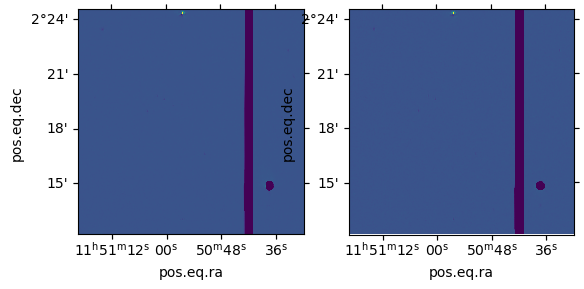

In [88]:
ax1 = plt.subplot(1,2,1, projection=WCS(hdu1.header))
ax1.imshow(hdu1.data, origin='lower', vmin=-700., vmax=2000.)

ax2 = plt.subplot(1,2,2, projection=WCS(hdu2.header))
ax2.imshow(hdu2.data, origin='lower', vmin=-700, vmax=2000)


In [89]:
array, footprint = reproject_interp(hdu2, hdu1.header)

EN                                                                               [astropy.io.fits.card]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]


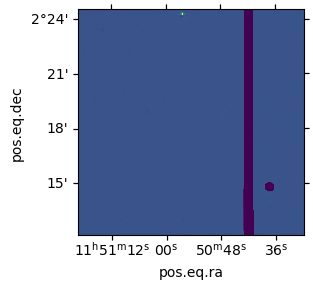

In [90]:
ax1 = plt.subplot(1,2,1, projection=WCS(hdu1.header))
ax1.imshow(array, origin='lower', vmin=-700, vmax=2000)

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

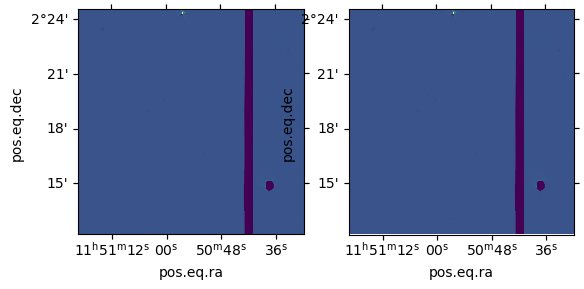

EN                                                                               [astropy.io.fits.card]
 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

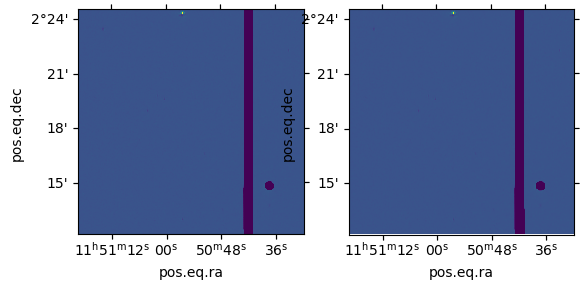

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

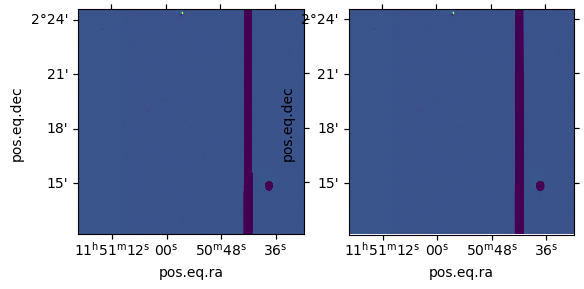

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

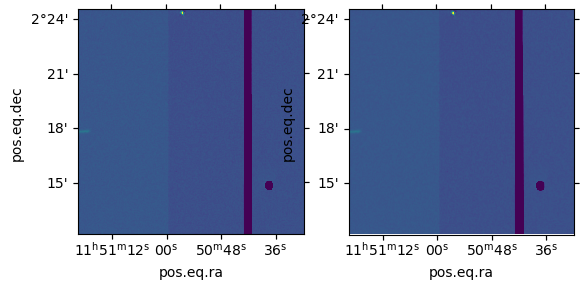

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

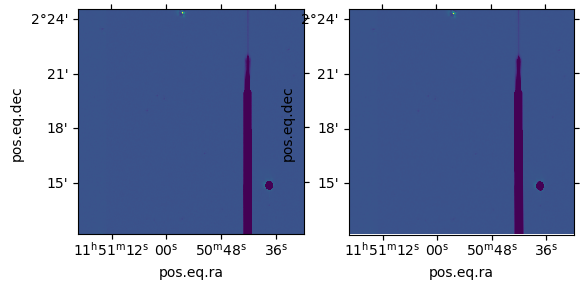

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

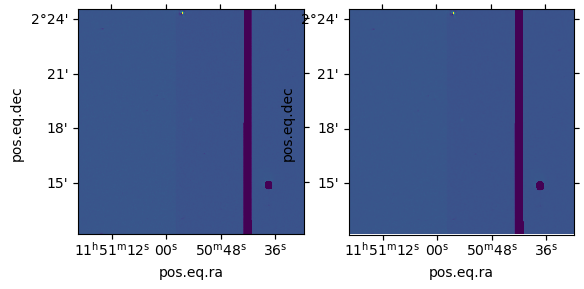

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

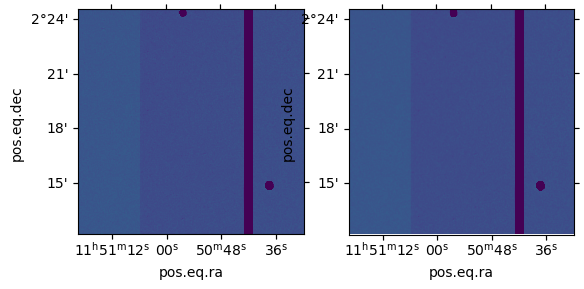

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

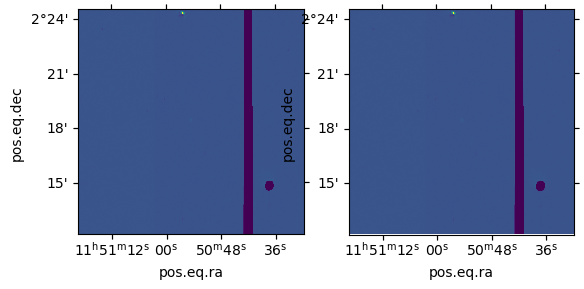

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

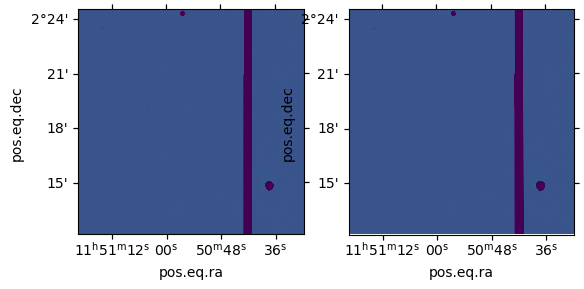

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

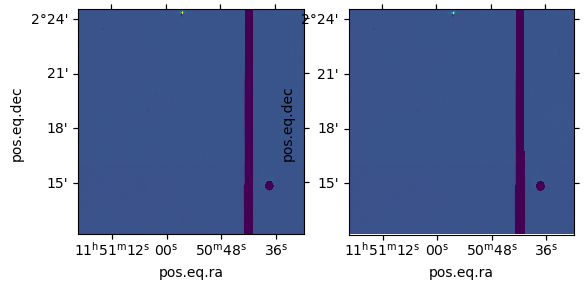

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

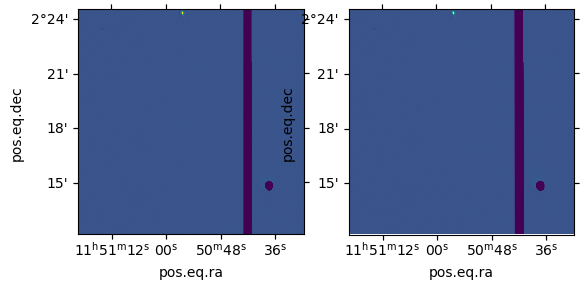

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

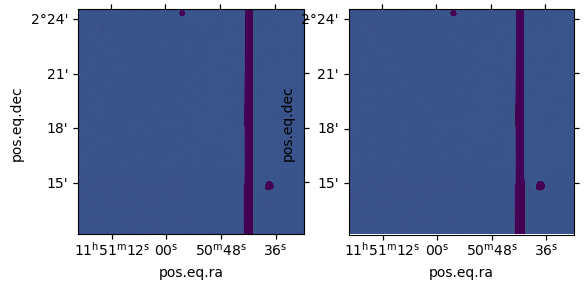

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

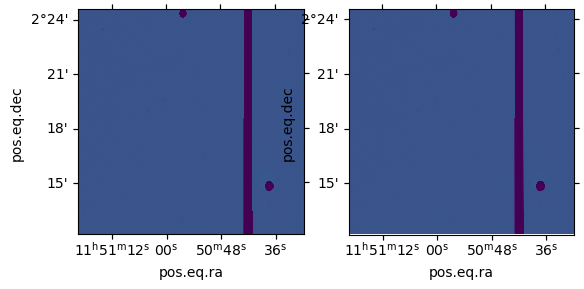

EN                                                                               [astropy.io.fits.card]
 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

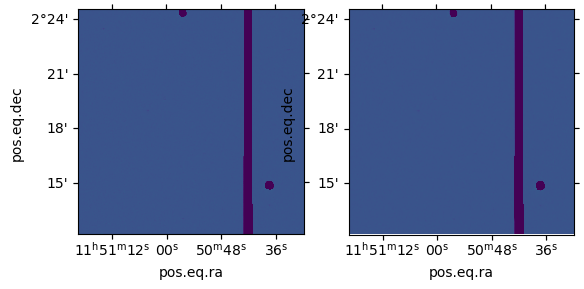

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

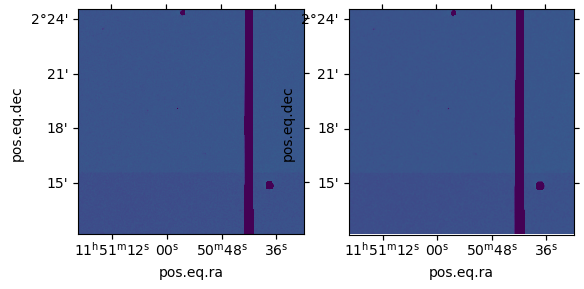

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

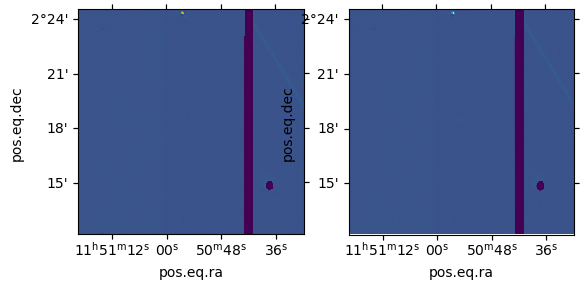

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

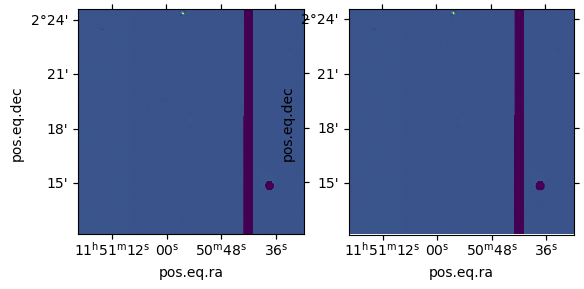

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

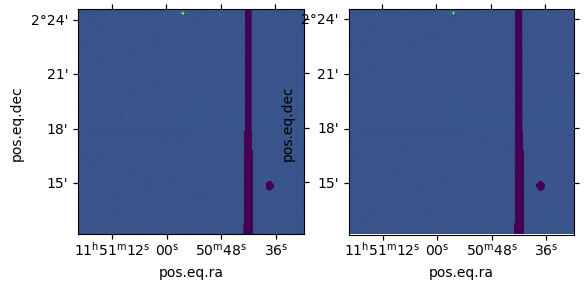

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

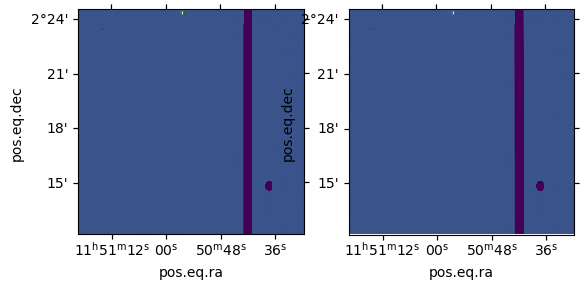

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

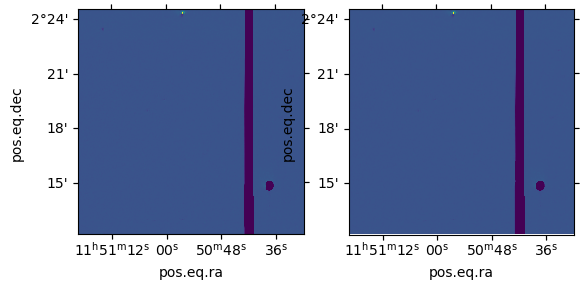

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

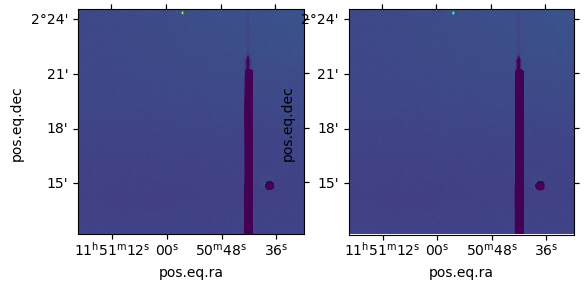

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

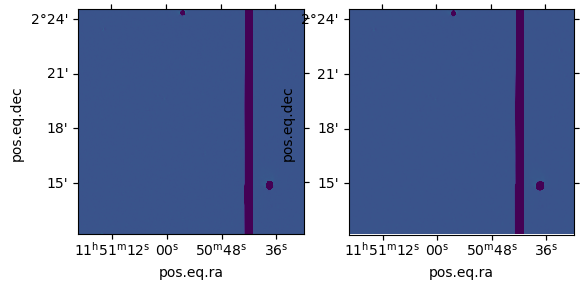

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

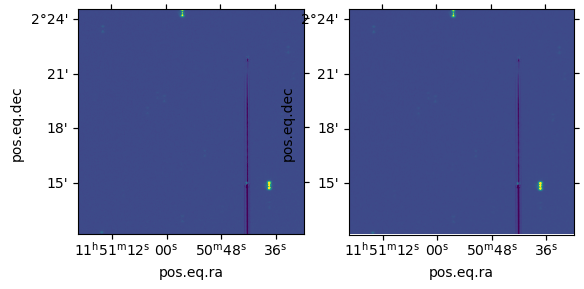

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

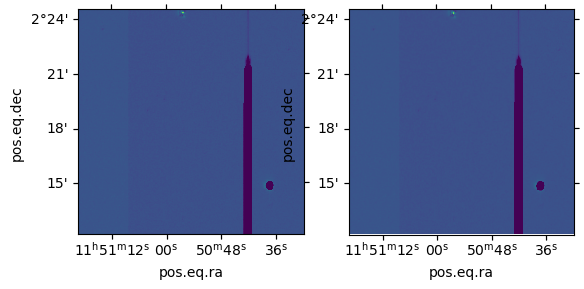

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

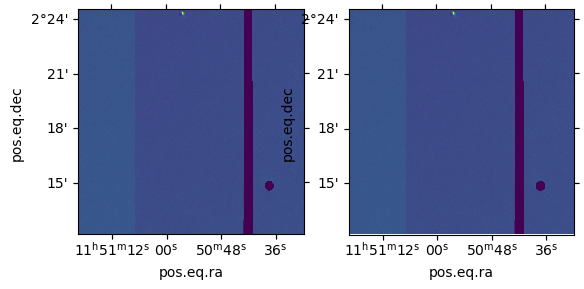

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

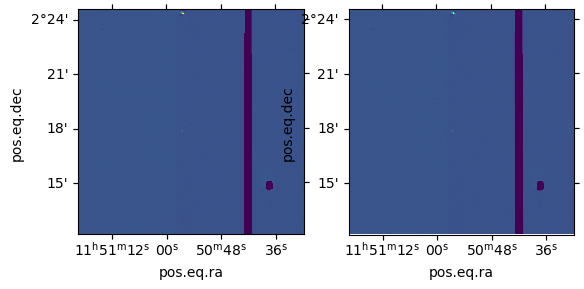

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

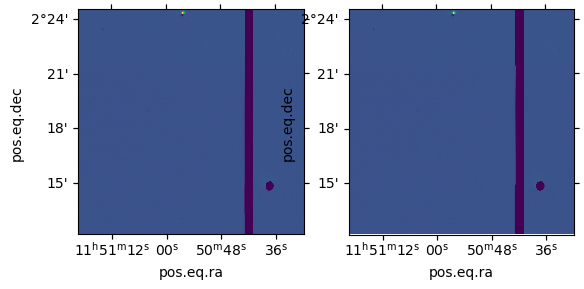

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

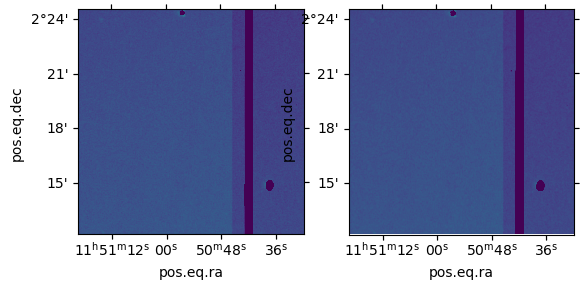

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

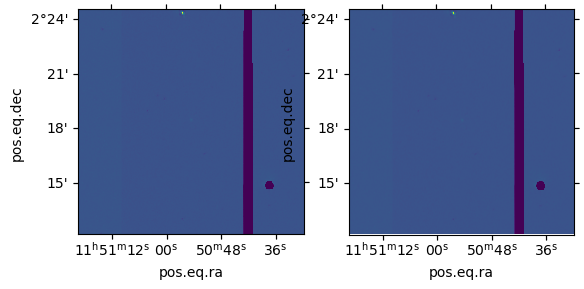

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

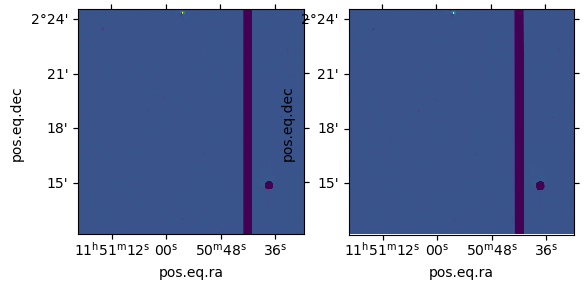

EN                                                                               [astropy.io.fits.card]
 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

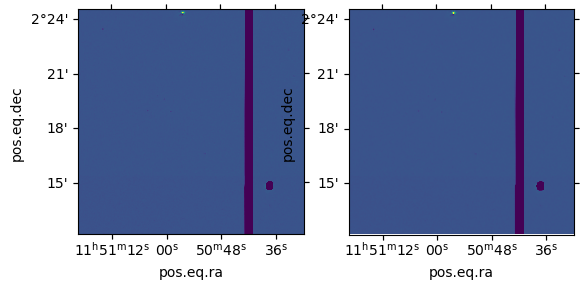

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

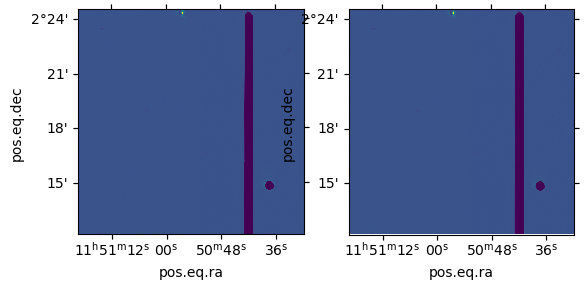

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

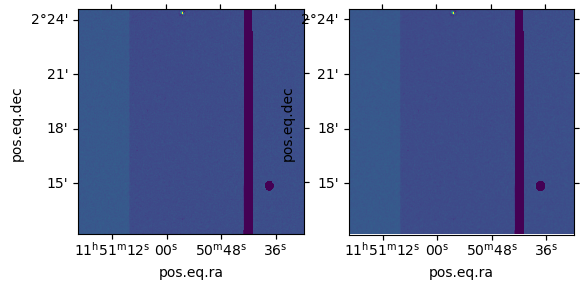

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

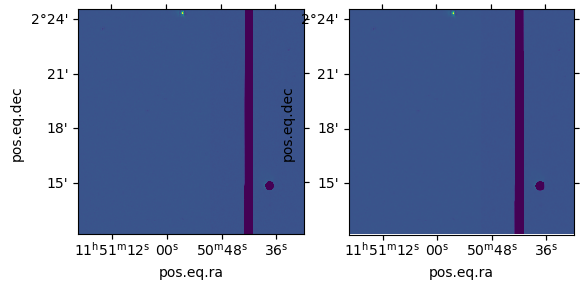

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

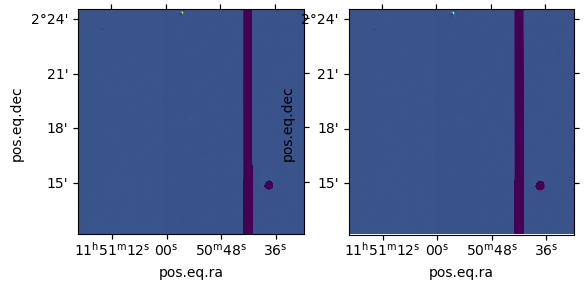

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

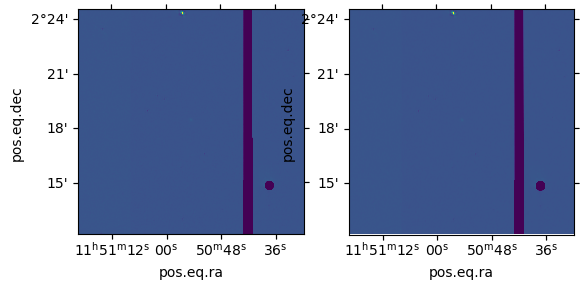

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

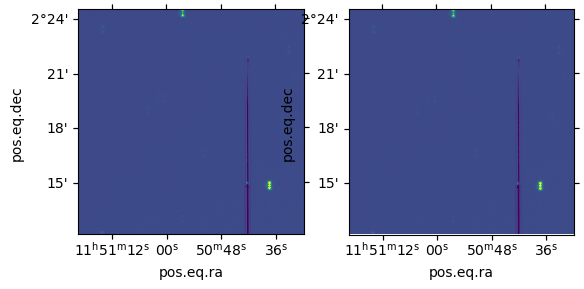

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

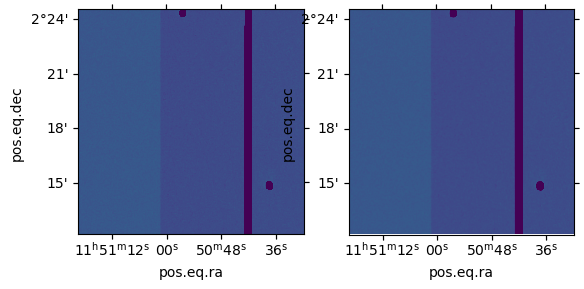

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

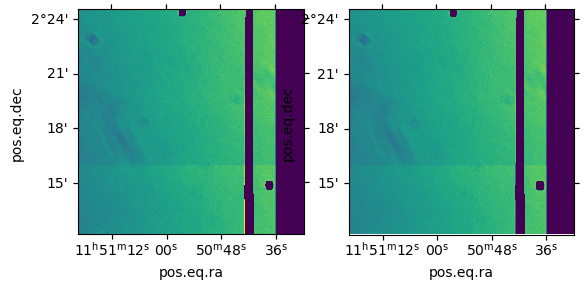

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

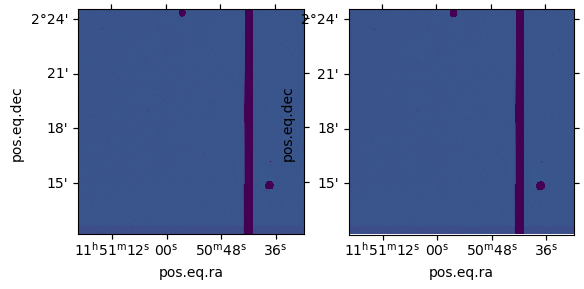

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

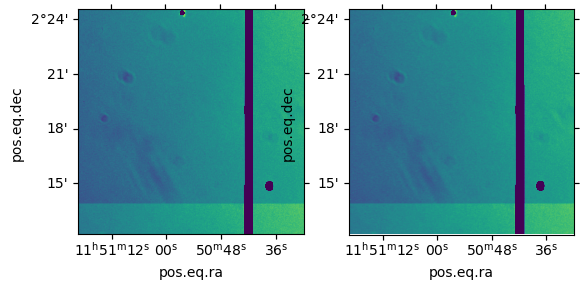

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

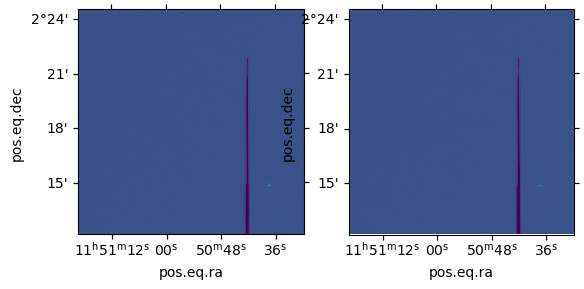

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

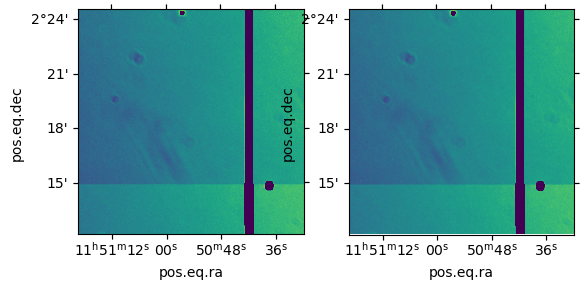

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

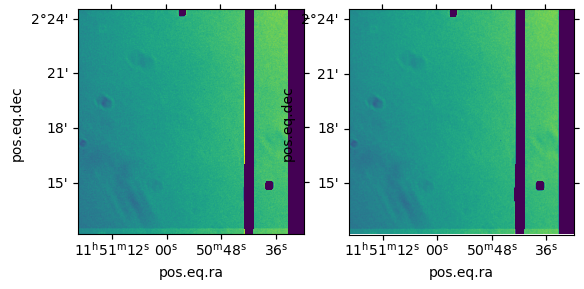

EN                                                                               [astropy.io.fits.card]
 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

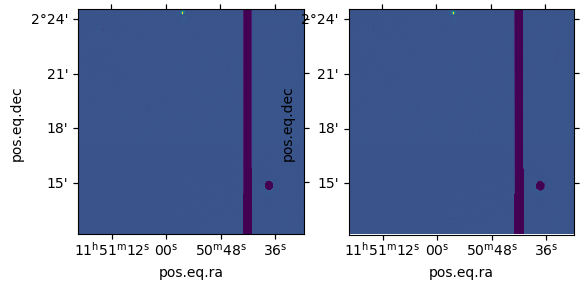

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

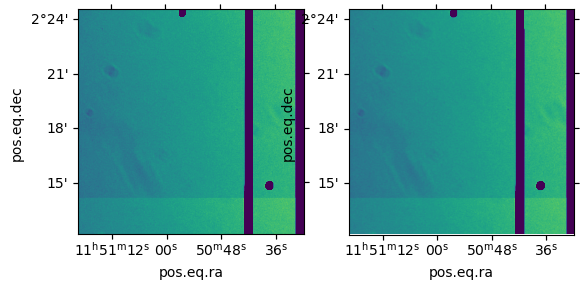

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

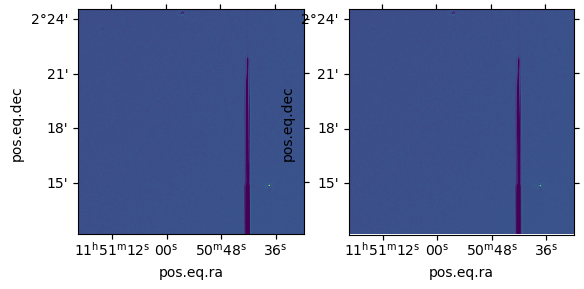

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

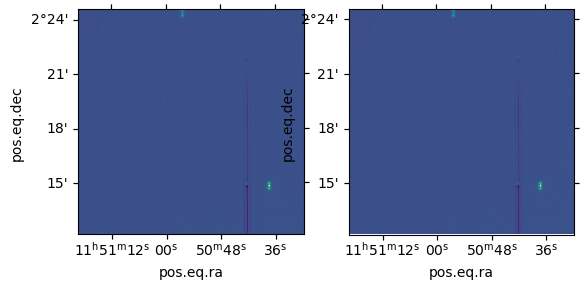

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

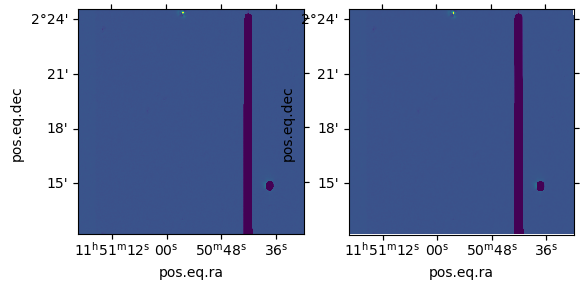

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

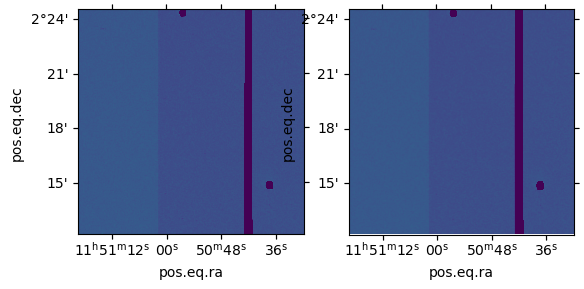

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

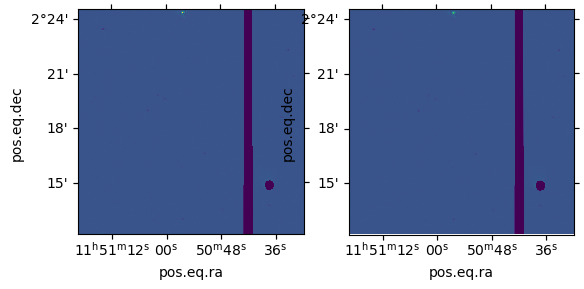

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

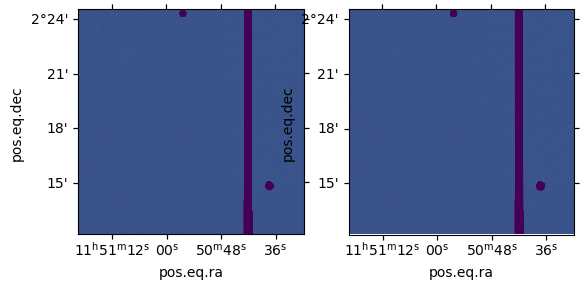

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

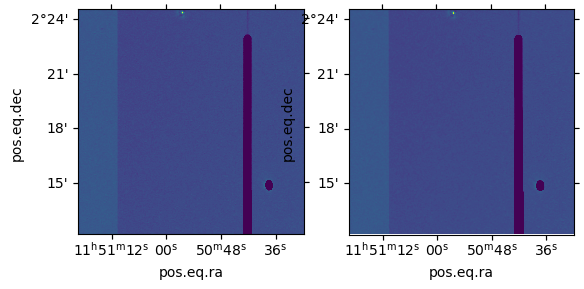

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

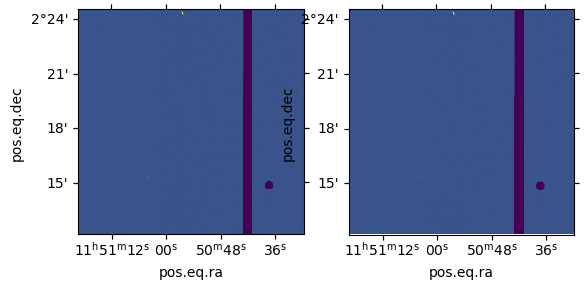

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

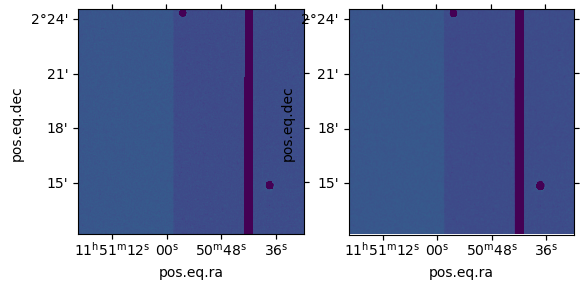

In [91]:
reprojected = []
for file in my_list_of_images_o:
    hdu1 = fits.open(get_pkg_data_filename(my_list_of_images_o[0]))[0]
    hdu2 = fits.open(get_pkg_data_filename(file))[0]
    hdu1_header = hdu1.header
    del hdu1_header['CNPIX1']
    del hdu1_header['CNPIX2']
    hdu2_header = hdu2.header
    del hdu2_header['CNPIX1']
    del hdu2_header['CNPIX2']
    array, footprint = reproject_interp(hdu2, hdu1.header)

    plt.figure()
    ax1 = plt.subplot(1,2,1, projection=WCS(hdu2.header))
    ax1.imshow(hdu2.data, origin='lower', vmin=-700, vmax=2000)

    ax2 = plt.subplot(1,2,2, projection=WCS(hdu1.header))
    ax2.imshow(array, origin='lower', vmin=-700, vmax=2000)
    plt.show()

    
    
    reprojected.append(array)


In [92]:
len(reprojected)

55

In [93]:
final_image = np.sum(reprojected, axis=0)
    

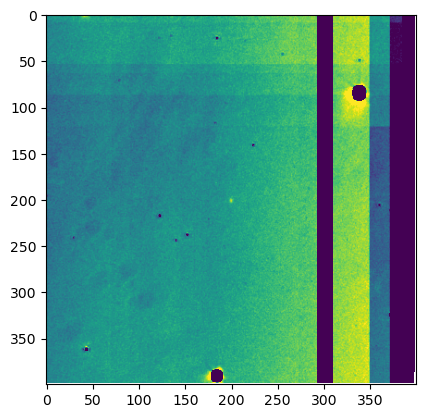

In [105]:
plt.imshow(final_image, vmin = -1000, vmax = 5000)

In [108]:
def centroid_gauss(data, error, mask):
    return phot.centroids.centroid_2dg(data, error, mask)

In [109]:
image_data = final_image
hdu1 = fits.open(get_pkg_data_filename(my_list_of_images_o[0]))[0]
header = hdu1.header
del header['CNPIX1']
del header['CNPIX2']
w = WCS(header)
x_in, y_in = (200,200)  # center x position (pixels)
RA_in, Dec_in = w.wcs_pix2world(x_in,y_in,0)
print("RA in: ", RA_in, "Dec in: ",Dec_in)

aperture = CircularAperture((x_in, y_in), 3)
annulus_aperture = CircularAnnulus([x_in,y_in],3,10)
sigclip = SigmaClip(sigma=3.0, maxiters=10)
aper_stats = ApertureStats(image_data, aperture, sigma_clip=None)
bkg_stats = ApertureStats(image_data, annulus_aperture, sigma_clip=sigclip)

phot_table = aperture_photometry(image_data, aperture)
aperture_sum = phot_table['aperture_sum']
noise_std = bkg_stats.std
SNR = aperture_sum.value[0]/noise_std

mask_array = []
for i in range(0,400):
    mask_row = []
    for j in range(0,400):
        pix_val = image_data[i,j]
        if (i >= 195 and i <= 205) and (j >= 195 and j <= 205):
            boolian = False
        else:
            boolian = True
        mask_row.append(boolian)
    mask_array.append(mask_row)

if SNR < 30:
    print('Fails SNR cut')
else:
    output = centroid_gauss(image_data, None, mask_array)
    x_out = output[0]
    y_out = output[1]
    print(x_out,y_out)

        
if math.isnan(x_out) or math.isnan(y_out):
    print('CENTER NOT FOUND')
else:
    RA, Dec = w.wcs_pix2world(x_out,y_out,0)
    print("RA out: ",RA,"Dec out: ",Dec)

 [astropy.io.fits.verify]
the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
RA in:  177.72715855

In [110]:
RA - RA_in, Dec - Dec_in

(0.0001448271756032682, 0.0005817900316453795)

In [16]:
df = pd.read_csv('/Users/lilahskye/Desktop/Cosmology_Research/ATLAS_Project/CENTROID/RAW_DATA/RAW_DATA_2/2015bz.csv', sep = ',')

20.56125
0.9674916558641043


''

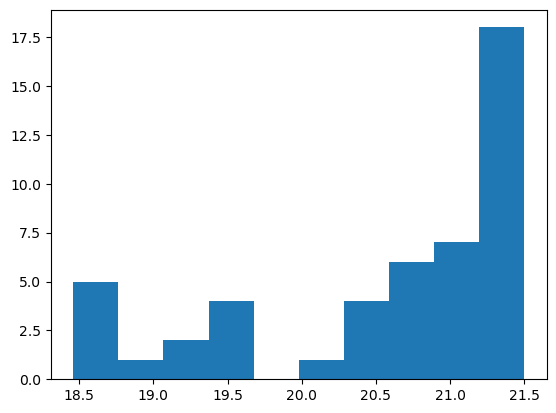

In [22]:
sky_vals = df['Sky']
print(np.mean(sky_vals)), print(np.std(sky_vals))

plt.hist(sky_vals)
;